In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from   IPython.display import display, HTML
from collections import deque
import random
import os
import sys
import pathlib
from collections import deque
from tqdm.notebook import tqdm, trange
import datetime
from scipy import interpolate
import math

import matplotlib.ticker as mtick
import matplotlib.dates as md

from IPython.display import clear_output

os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

import torch
import gpytorch
import matplotlib.dates as md

from AOE.plots import rescale_plot

In [234]:
# We will use the simplest form of GP model, exact inference
class ExactGPModel(gpytorch.models.ExactGP):
    def __init__(self, train_x, train_y, likelihood, training_iter=10, verbose=False):
#         likelihood = gpytorch.likelihoods.GaussianLikelihood()
        super(ExactGPModel, self).__init__(train_x, train_y, likelihood)
        self.mean_module  = gpytorch.means.ConstantMean()
        self.covar_module = gpytorch.kernels.ScaleKernel(gpytorch.kernels.RBFKernel())
        self.reward_observation_times = []
        self.training_iter = training_iter ## Number of epochs hyperparameter retraining
        self.verbose = verbose
        
    def forward(self, x):
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        return gpytorch.distributions.MultivariateNormal(mean_x, covar_x)

    def add_point(self, x_new, y_new):
        """Implement a finite replay buffer for non stationarity
        If limit buffer reached, delete oldest point
        """
        
        x_train = self.train_inputs[0]
        y_train = self.train_targets
        x_train = torch.cat((x_train, torch.tensor([x_new]).reshape(1,1)))
        y_train = torch.cat((y_train, torch.tensor([y_new])))
            
        self.set_train_data(x_train, y_train, strict=False)
    
    def train_grad(self, training_iter=None):

        #Get model and data
        model, likelihood = self, self.likelihood
        model.train()
        likelihood.train()

        x_train = model.train_inputs[0]
        y_train = model.train_targets

        if training_iter == None:
            training_iter = self.training_iter

        # Find optimal model hyperparameters
        optimizer = torch.optim.Adam(model.parameters(), lr=0.1)  # Includes GaussianLikelihood parameters            
        mll = gpytorch.mlls.ExactMarginalLogLikelihood(likelihood, model)

        for i in range(training_iter):
            # Zero gradients from previous iteration
            optimizer.zero_grad()
            # Output from model
            output = model(x_train)
            # Calc loss and backprop gradients

            loss = -mll(output, y_train)
            loss.backward()
            
            if self.verbose:
                print('Iter %d/%d - Loss: %.3f   lengthscale: %.3f   noise: %.3f' % (
                    i + 1, self.training_iter, loss.item(),
                    model.covar_module.base_kernel.lengthscale.item(),
                    model.likelihood.noise.item()
                ))
            
            optimizer.step()
            
    def build_plot(self, ax, lv=None, uv=None, n_test=100, xlabel=None, clr='tan'):
        """Build matplotlib graph for one strat

        Args:
            ax (matplotlib.axe): graph to plot on
            lv (int, optional): lower x value. Defaults to -1.
            uv (int, optional): upper x value. Defaults to 1.
            n_test (int, optional): number of test points. Defaults to 100.
            xlabel (String, optional): label for x axis. Defaults to None.

        Returns:
            matplotlib.axe: graph plotted
        """
        
        # Get model and predictions
        model, likelihood = self, self.likelihood
        model.eval()
        likelihood.eval()
        
        if lv is None:
            try:
                lv, uv = model.train_inputs[0].min().item(), model.train_inputs[0].max().item()
            except Exception as e:
                # Here, it's certainly because the train_inputs is empty !! and this method has been called right after a complete reset
                lv, uv = -1, 1
        
        with torch.no_grad(), gpytorch.settings.fast_pred_var():
            test_x = torch.linspace(lv, uv, n_test).double()
            observed_pred = likelihood(model(test_x))
        
        train_x = model.train_inputs[0]
        train_y = model.train_targets

        # Get upper and lower confidence bounds
        lower, upper = observed_pred.confidence_region()
        
        # Plot training data as black stars
        ax.plot(train_x.numpy(), train_y.numpy(), 'k*')

        # Plot predictive means as blue line
        ax.plot(test_x.numpy(), observed_pred.mean.numpy(), 'k', linewidth=3)
        
        # Shade between the lower and upper confidence bounds
        ax.fill_between(test_x.detach().numpy(), lower.detach().numpy(), upper.detach().numpy(), alpha=0.5, 
                          facecolor='silver', hatch="ooo", edgecolor=clr)

        ax.grid(axis='both', color='gainsboro', linestyle='-', linewidth=0.5)

        
        if xlabel:
            ax.set_xlabel(xlabel)
        return ax

In [235]:
parent_module_path = os.path.abspath(os.path.join('..'))
if parent_module_path not in sys.path:
    sys.path.append(parent_module_path)

In [236]:
pd.set_option('display.width', 1000)
display(HTML("<style>.container { width:100% !important; }</style>"))
pd.set_option('mode.chained_assignment', None)

In [223]:
def init_variables(all_data, o_bandit):
    bandit_rewards = pd.DataFrame(index=all_data.index)
    bandits = {'UCB_WAS': o_bandit}
    for bandit_k in bandits.keys(): 
        bandit_rewards[bandit_k] = np.nan
    bandit_rewards['oracle'] = np.nan
    for strat in strategies.keys():
        bandit_rewards[strat] = np.nan
    
    batch_times = list(all_data.index)
    # distances   = {bandit_k:{strat: [] for strat in strategies.keys()} for bandit_k in bandits.keys()}

    bandits_fin_info = {bandit_k:pd.DataFrame(index=all_data.index) for bandit_k in bandits.keys()}
    for bandit_k in bandits.keys(): 
        bandits_fin_info[bandit_k]['execPrice'] = np.nan
        bandits_fin_info[bandit_k]['S0']        = np.nan
        bandits_fin_info[bandit_k]['ST']        = np.nan
        bandits_fin_info[bandit_k]['twapPrice'] = np.nan
        
    return bandit_rewards, bandits_fin_info, batch_times

# Load Data & Signals

In [347]:
asset_name = 'BIDU'

In [348]:
all_data = None
for filename in os.listdir(f'../data/Rewards'):
    f = os.path.join(f'../data/Rewards', filename)
    # checking if it is a file
    if os.path.isfile(f):
        if asset_name in filename:
            trade_date = filename.split('_')[1]
            reward_fn = f'{asset_name}_{trade_date}_rewards.pkl'
            _all_data  = pd.read_pickle(f'../data/Rewards/{reward_fn}')
            _all_data  = _all_data[~_all_data.index.duplicated()]
            if all_data is None:
                all_data = _all_data 
            else:
                all_data = pd.concat((all_data, _all_data), axis=0)
all_data = all_data.sort_index()

In [350]:
all_data.tail(4)

,buyPrice_imbalance_1,buyPrice_MR,buyPrice_TF,sellPrice_imbalance_1,sellPrice_MR,sellPrice_TF,twapPrice,S0,ST,mid_price,imbalance_1,ba_spread,macd_120_260_90,macd_1200_2600_900,time_of_day,macd_12_26_9,TF,MR
2022-12-23 15:59:56.503771,111.595,111.595,111.600,111.600,111.600,111.595,111.59550,111.600,111.595,111.600,-0.108752,0.02,-2.420436,-0.003978,16.0,-0.042068,0.017198,0.017198
2022-12-23 15:59:57.205633,111.595,111.600,111.595,111.600,111.595,111.600,111.59875,111.595,111.600,111.595,0.137580,0.03,-3.230688,-0.004569,16.0,0.534064,0.447396,0.447396
2022-12-23 15:59:58.161941,111.590,111.590,111.600,111.600,111.600,111.590,111.59475,111.600,111.590,111.600,-0.474841,0.04,-2.306287,-0.005026,16.0,0.096310,0.878843,0.878843
2022-12-23 15:59:59.386629,111.590,111.590,111.605,111.605,111.605,111.590,111.59525,111.590,111.605,111.590,0.696929,0.04,-1.944418,-0.005511,16.0,-0.321777,-0.869675,-0.869675


# Test on some points

In [351]:
all_data.columns

Index(['buyPrice_imbalance_1', 'buyPrice_MR', 'buyPrice_TF', 'sellPrice_imbalance_1', 'sellPrice_MR', 'sellPrice_TF', 'twapPrice', 'S0', 'ST', 'mid_price', 'imbalance_1', 'ba_spread', 'macd_120_260_90', 'macd_1200_2600_900', 'time_of_day', 'macd_12_26_9', 'TF', 'MR'], dtype='object')

In [459]:
all_data_test_1 = all_data.iloc[:1000].dropna()
all_data_test_2 = all_data.iloc[:2000].dropna()

ref_price   = 'twapPrice' #ST
signal_name = 'MR' #imbalance_1

all_data_test_1['reward_ex']     = (all_data_test_1[ref_price] - all_data_test_1[f'buyPrice_{signal_name}'])/all_data_test_1.ba_spread
all_data_test_1['signal_name_r'] = all_data_test_1[signal_name].round(0)
all_data_test_1 = all_data_test_1[['signal_name_r', 'reward_ex']]

all_data_test_2['reward_ex']     = (all_data_test_2[ref_price] - all_data_test_2[f'buyPrice_{signal_name}'])/all_data_test_2.ba_spread
all_data_test_2['signal_name_r'] = all_data_test_2[signal_name].round(0)
all_data_test_2 = all_data_test_2[['signal_name_r', 'reward_ex']]


In [460]:
if False:
    fig, ax = plt.subplots(1, 1)

    pred_mean = all_data_test[['signal_name_r', 'reward_ex']].groupby('signal_name_r').mean()
    pred_std  = all_data_test[['signal_name_r', 'reward_ex']].groupby('signal_name_r').std()

    ax.plot(pred_mean, color='k', lw=3, linestyle='-.')
    ax.fill_between(pred_std.index, 
                    -pred_std.iloc[:,0].values, 
                    pred_std.iloc[:,0].values)

In [461]:
#all_data_test
#
#all_data_test_.loc[_x]

In [472]:
# initialise a GP
noiseLikelihood = 0.5

likelihood = gpytorch.likelihoods.GaussianLikelihood() 
likelihood.noise = noiseLikelihood
GP1         = ExactGPModel(torch.zeros((0, 1), dtype=torch.float64), 
                              torch.zeros(0, dtype=torch.float64), 
                              likelihood)

likelihood2 = gpytorch.likelihoods.GaussianLikelihood() 
likelihood2.noise = noiseLikelihood
GP2         = ExactGPModel(torch.zeros((0, 1), dtype=torch.float64), 
                              torch.zeros(0, dtype=torch.float64), 
                              likelihood)
GP1.eval(); GP2.eval()

all_data_test_1_ = all_data_test_1.groupby('signal_name_r').mean()
all_data_test_2_ = all_data_test_2.groupby('signal_name_r').mean()

for _x in all_data_test_1_.index:
    GP1.add_point(_x, all_data_test_1_.loc[_x][0])
    GP1.train_grad()
    
for _x in all_data_test_2_.index:
    GP2.add_point(_x, all_data_test_2_.loc[_x][0])
    GP2.train_grad()

In [473]:
print('From:', all_data_test_1.index[0], ' to ', all_data_test_1.index[-1])

From: 2022-10-03 09:30:01.977734  to  2022-10-03 10:00:35.058823


In [474]:
print('From:', all_data_test_2.index[0], ' to ', all_data_test_2.index[-1])

From: 2022-10-03 09:30:01.977734  to  2022-10-03 10:24:06.204765


<AxesSubplot: >

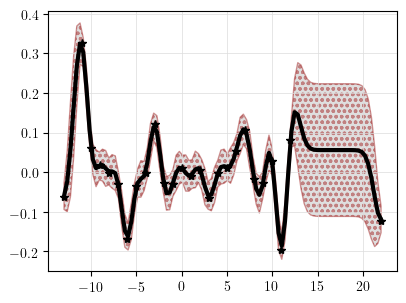

In [475]:
rescale_plot(W=4.5, l=4, w=3)
fig, ax = plt.subplots(1, 1)
GP1.build_plot(ax, clr='brown')

<AxesSubplot: >

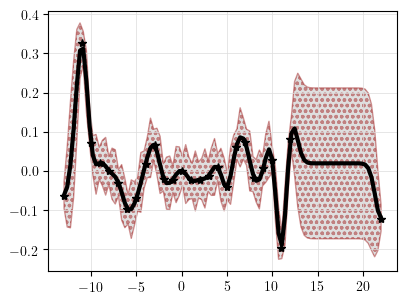

In [476]:
fig, ax = plt.subplots(1, 1)
GP2.build_plot(ax, clr='brown')

# GP bandits

In [9]:
from AOE.utils import verbose_print
from AOE.bandit_plots import hit_ratio_analysis, reward_distribution_analysis, regret_plots
from AOE.gp_bandit_finance import gp_bandit_finance, Wasserstein_GP_mean#, Wasserstein_GP
from AOE.plots import rescale_plot

The Zen of Python, by Tim Peters

Beautiful is better than ugly.
Explicit is better than implicit.
Simple is better than complex.
Complex is better than complicated.
Flat is better than nested.
Sparse is better than dense.
Readability counts.
Special cases aren't special enough to break the rules.
Although practicality beats purity.
Errors should never pass silently.
Unless explicitly silenced.
In the face of ambiguity, refuse the temptation to guess.
There should be one-- and preferably only one --obvious way to do it.
Although that way may not be obvious at first unless you're Dutch.
Now is better than never.
Although never is often better than *right* now.
If the implementation is hard to explain, it's a bad idea.
If the implementation is easy to explain, it may be a good idea.
Namespaces are one honking great idea -- let's do more of those!


In [10]:
strategies  = {'imbalance_1' : {'name'             : 'imbalance_1',
                                     'params'           : {'feature_name'     : 'imbalance_1'},
                                     'contextual_params': {'feature_name'     : 'imbalance_1'}},

               'MR' : {'name'             : 'MR',
                                  'params'           : {'feature_name'     : 'MR'},
                                  'contextual_params': {'feature_name'     : 'MR'}},

               'TF' : {'name'             : 'TF',
                                  'params'           : {'feature_name'     : 'TF'},
                                  'contextual_params': {'feature_name'     : 'TF'}}
              }

In [11]:
features = all_data[[s for s in all_data.columns if (('buyPrice' not in s)&('sellPrice' not in s))]]

In [12]:
# Likelihood models & non stationarity params
likelihood              = gpytorch.likelihoods.GaussianLikelihood()
size_buffer             = 30 # in terms of number of rewards to sample from
size_buffer_2           = 30 # in terms of number of rewards to sample from
size_window             = 15 # for non statonarity
bandit_params = {'size_buffer': size_buffer_2, 
                 'size_window': size_window,
                 'threshold'  : 0.002,
                 'lambda'     : 0.6,
                 'delta'      : 0.6,# Delta is bound on type 1 error
                 'reinit'     : False} 

# Bandit objects
o_bandit = gp_bandit_finance(strategies, bandit_algo='UCB_WAS', likelihood=likelihood, 
                                         bandit_params=bandit_params, verbose=True)

INTIALIZING!


# Other control parameters and variables

In [13]:
# variables for historical trading data
i_order                   = 0
nb_added_rewards          = 0
verbose_level             = 1
ref_price                 = 'S0'
nb_orders                 = 0

In [14]:
import gpytorch
o_ = gpytorch.likelihoods.GaussianLikelihood()
o_.noise = 0.05
o_.noise

tensor([0.0500], grad_fn=<AddBackward0>)

# Trading simulation

In [15]:
def alpha(gamma, sigma, V, nu, dt):
    cosh_alpha_dt = 1 + (gamma * V * (dt*sigma)**2) / (4 * nu)
    return (1/dt) * np.arccosh(cosh_alpha_dt)

def q_star(x, q0, T, gamma, sigma, V, nu, dt):
    alpha_ = alpha(gamma, sigma, V, nu, dt)
    return q0 * np.sinh(alpha_*(T - x))/np.sinh(alpha_*T)

S0        = 100
sigma     = 5
V         = 15000000 #TransactionTape.set_index('time').traded_quantity.rolling('1h').sum().mean()
nu        = 10 # 0.1 dollar per contract for AC style.
gamma     = 10**1 #per dollar
T         = 5/60/24

timesteps = np.linspace(0, T, 100)
q0        = 100 #int(0.1 * V) # nb of shares to liquidate : 10% of total traded volume
dt        = T/100

In [16]:
programme_horizon = '10min'

i_start = int(np.random.rand(1)*(9*len(all_data)/10))

programme_data = all_data.iloc[i_start:].first(programme_horizon)

# Fill na exec prices accordingly
for col in programme_data.columns:
    if 'Price_' in col:
        programme_data[col].fillna(programme_data[ref_price], inplace=True)
        
bandit_rewards, bandits_fin_info, batch_times = init_variables(programme_data, o_bandit)
buysell          = 2*np.random.randint(0, 2, size=None, dtype=int) - 1


*******  None  *******
I received an order at None with quantity 1

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Selected strategy: MR
Oracle strategy: imbalance_

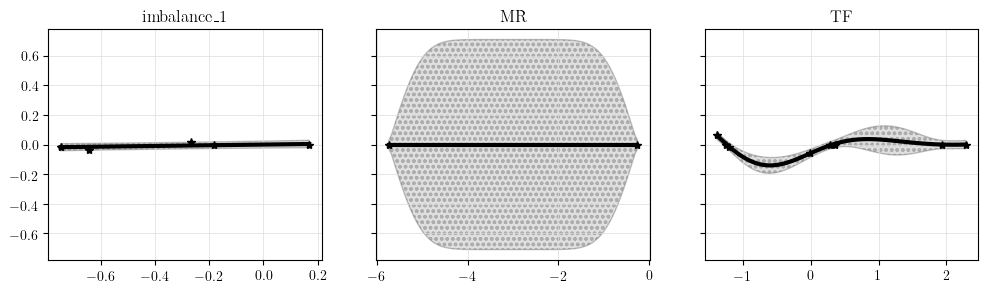

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


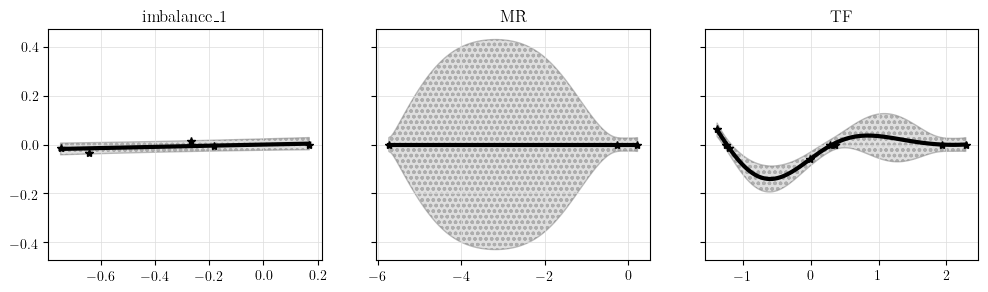

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


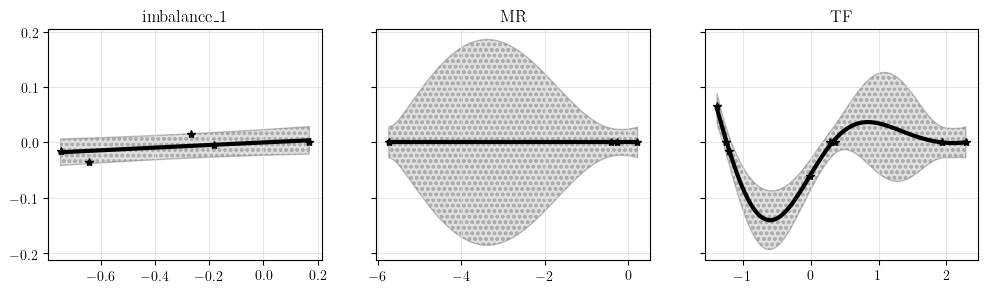

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


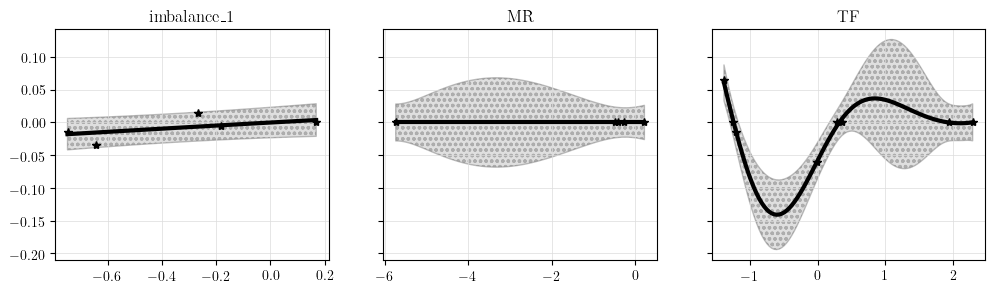

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


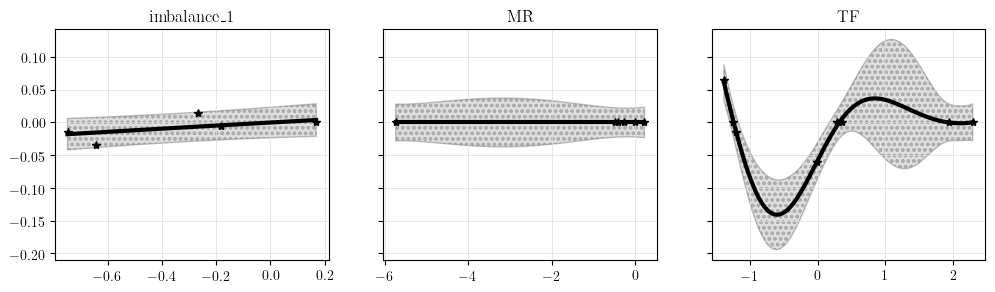

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


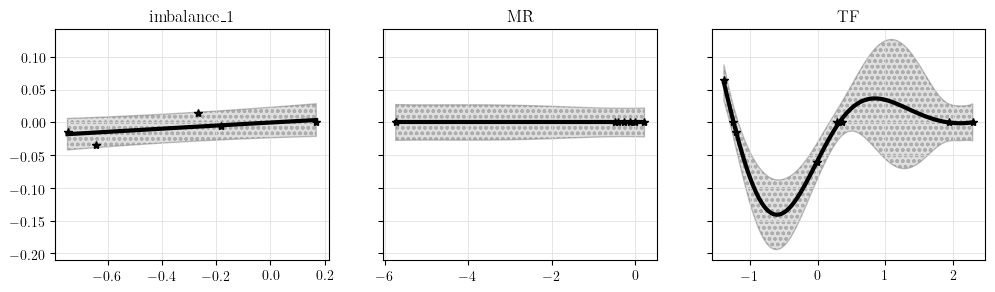

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


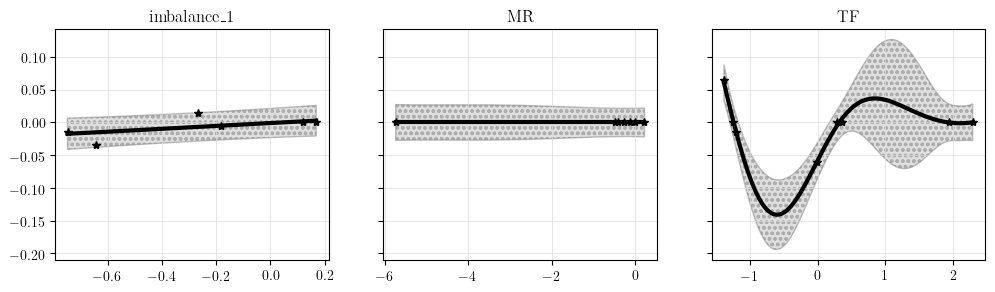

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


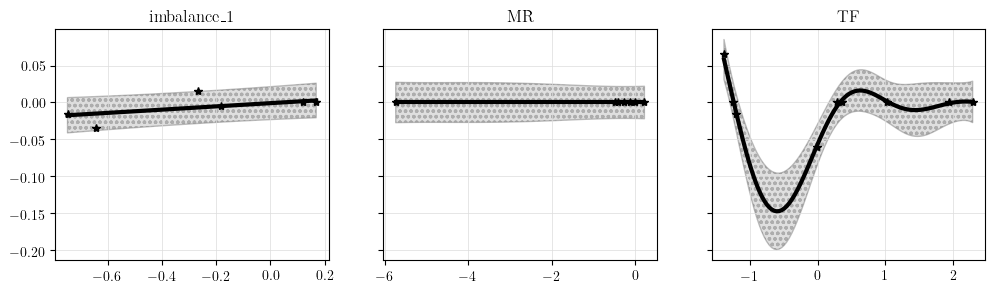

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


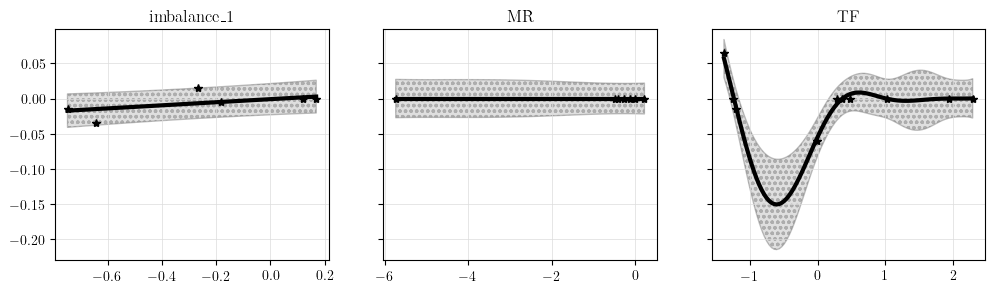

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


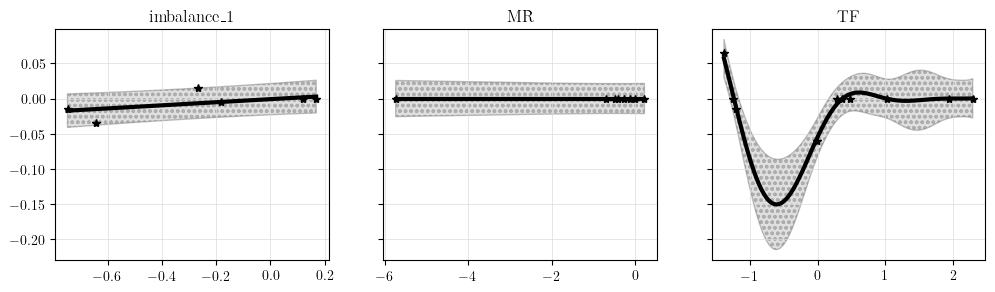

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


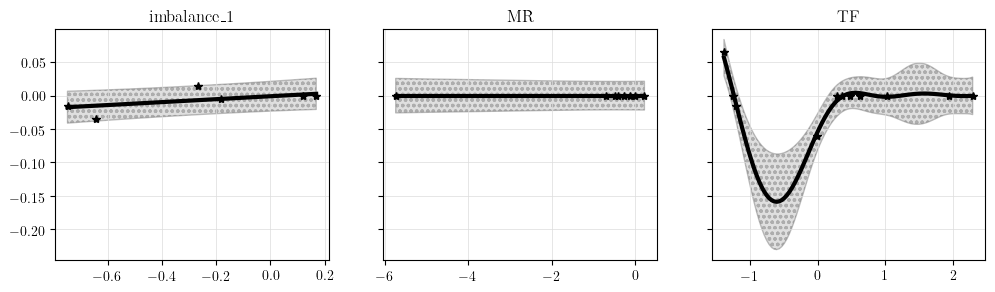

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


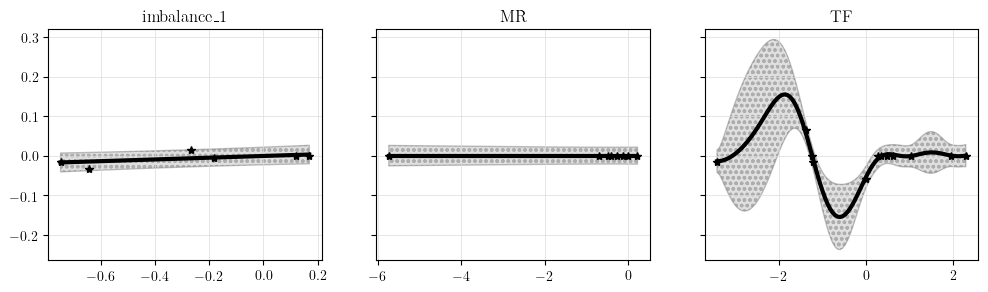

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


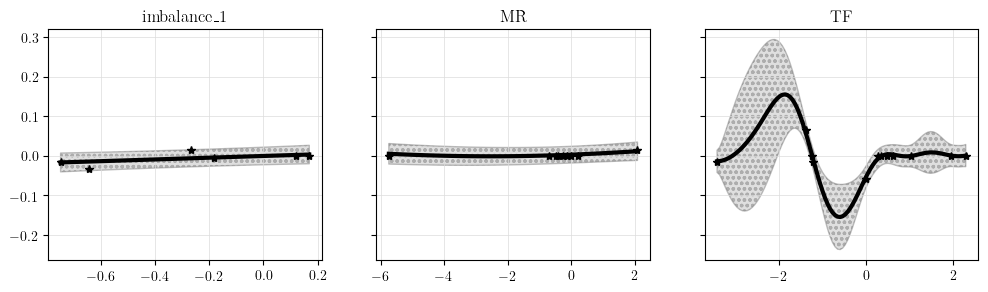

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


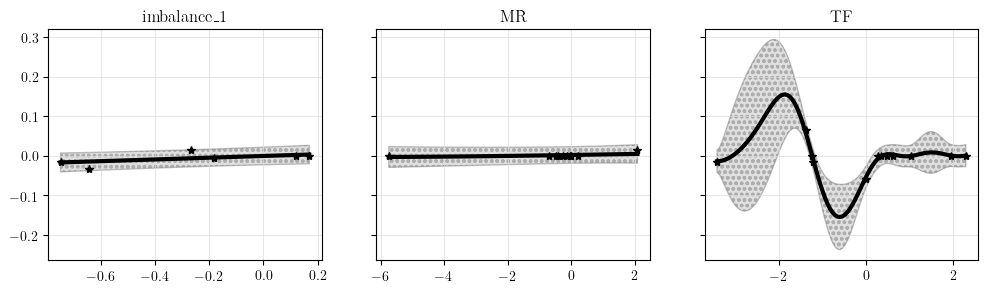

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


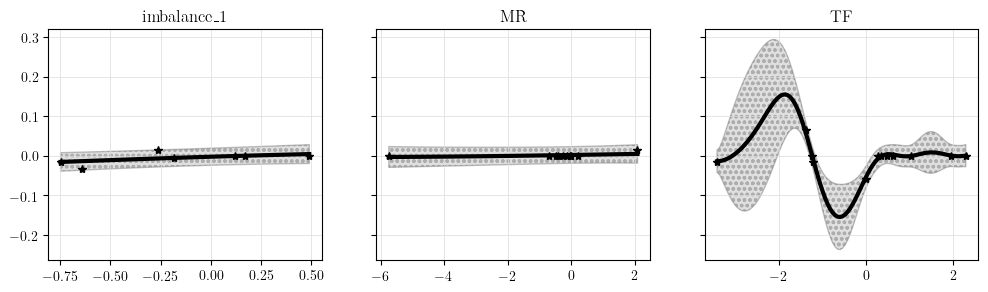

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


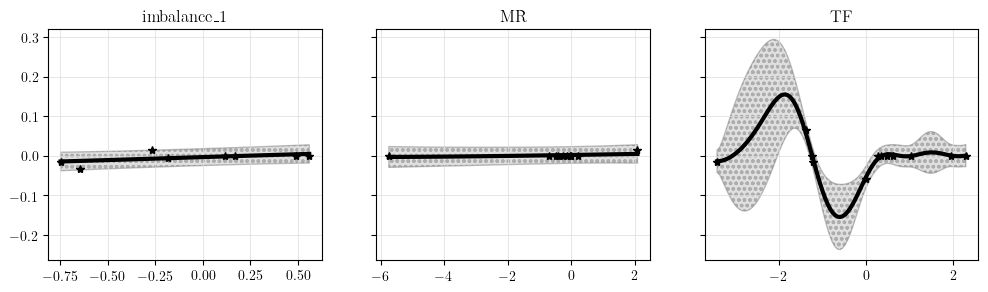

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


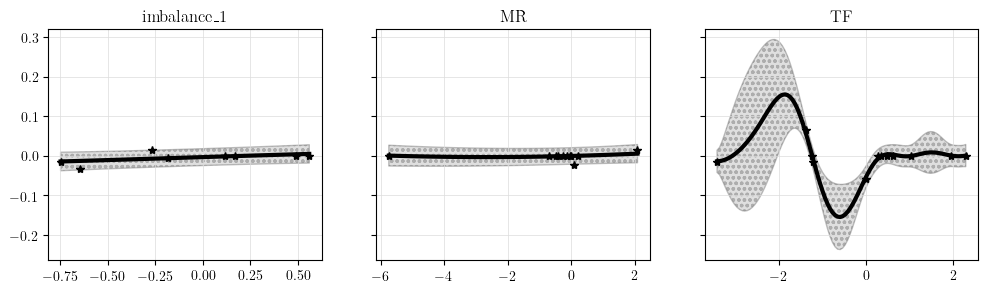

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


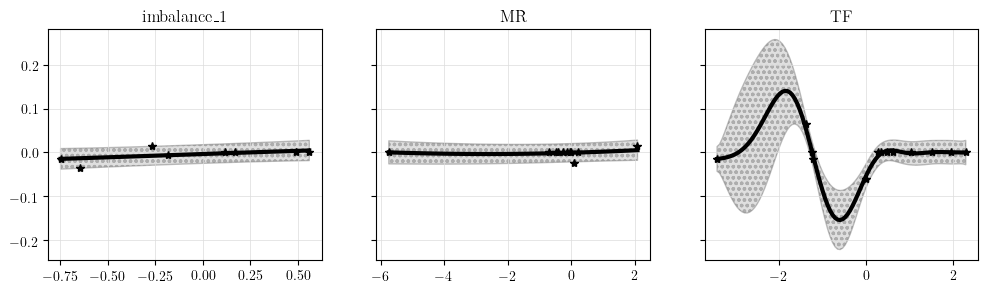

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


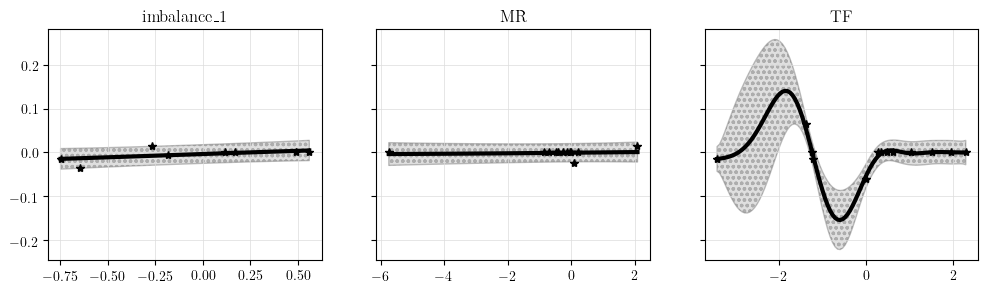

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


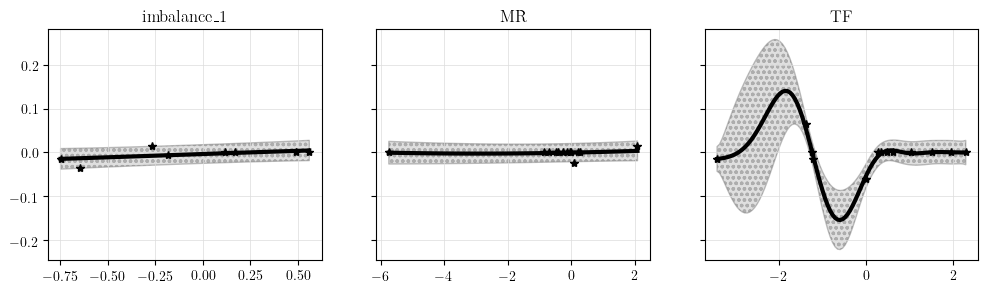

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


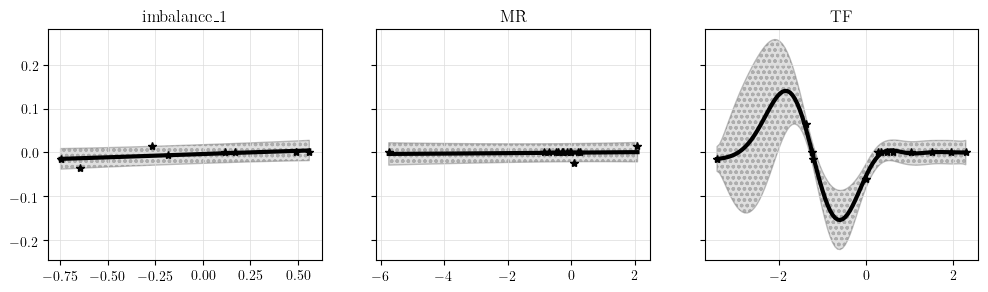

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


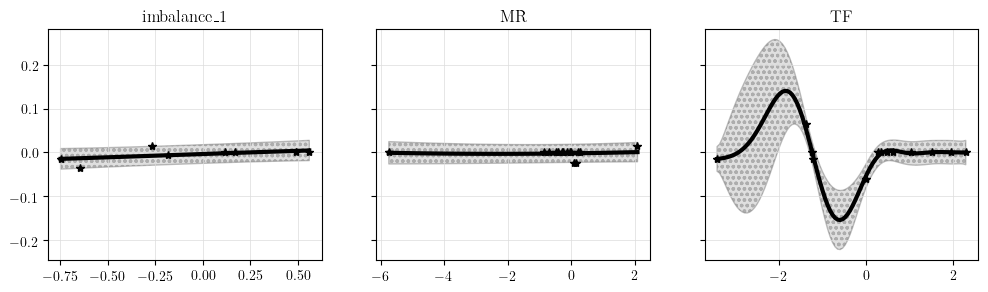

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


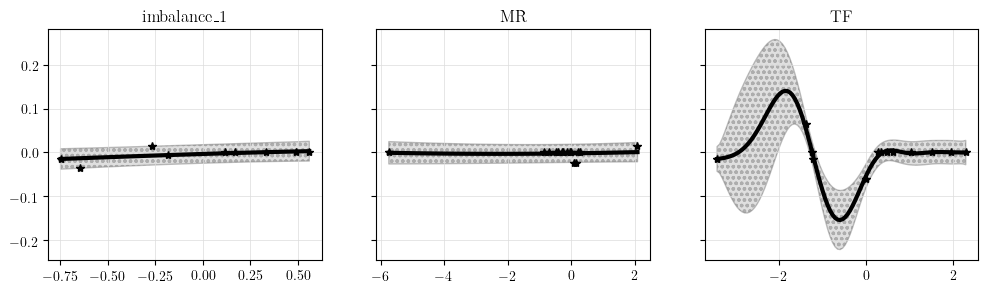

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


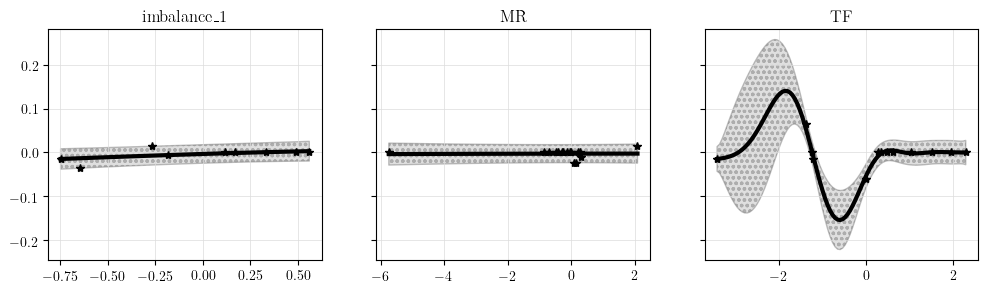

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.04255  Threshold: 0.002
Average performance GP1: tensor(-0.0056, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


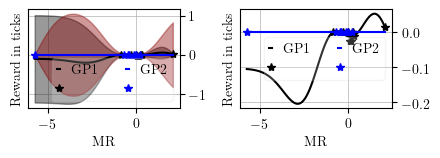

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


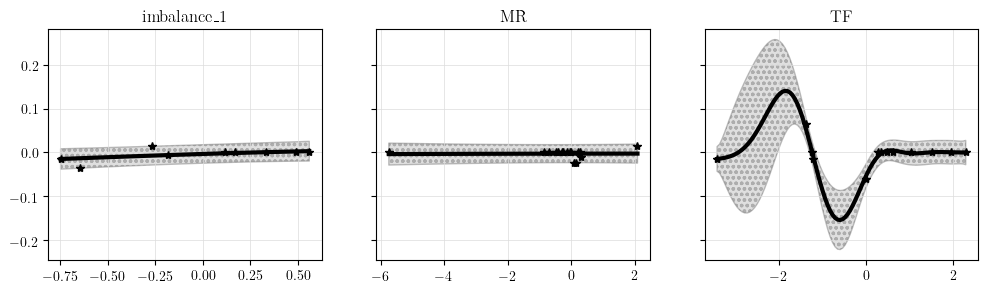

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


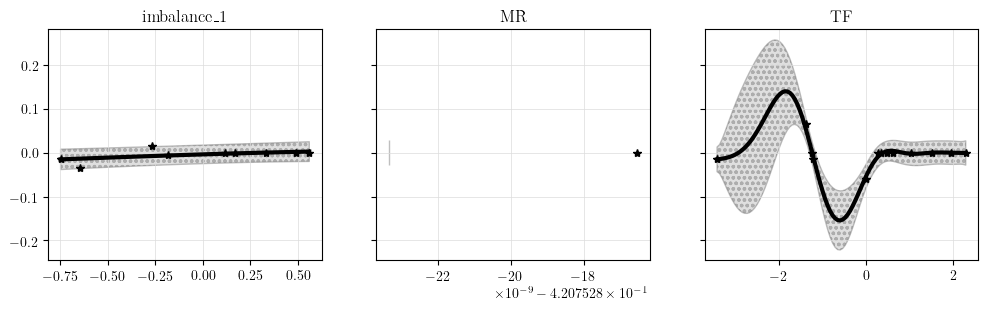

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


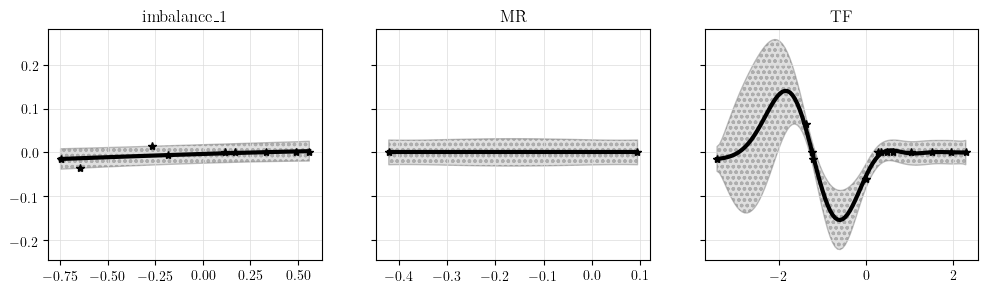

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


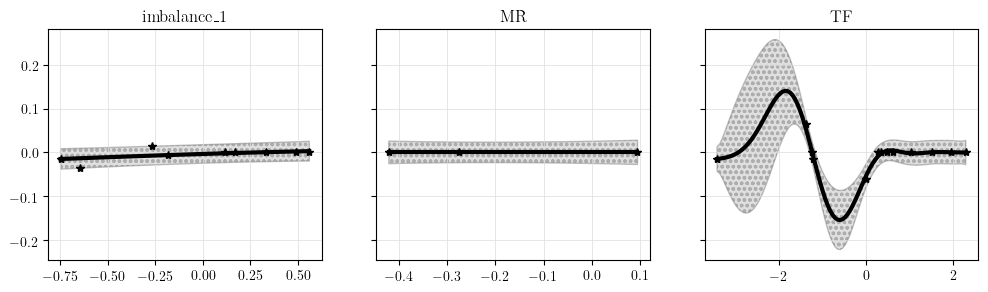

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


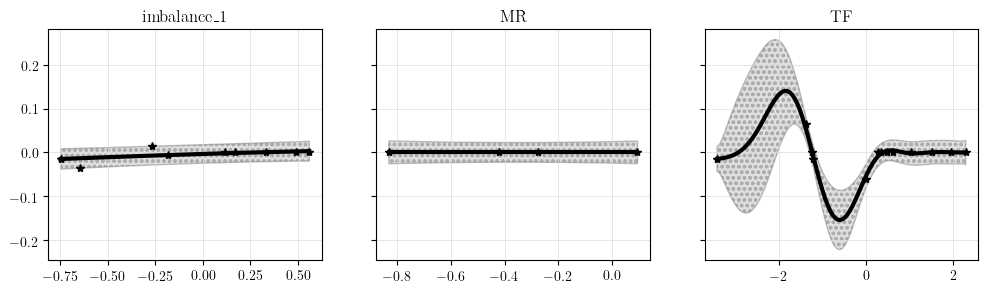

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


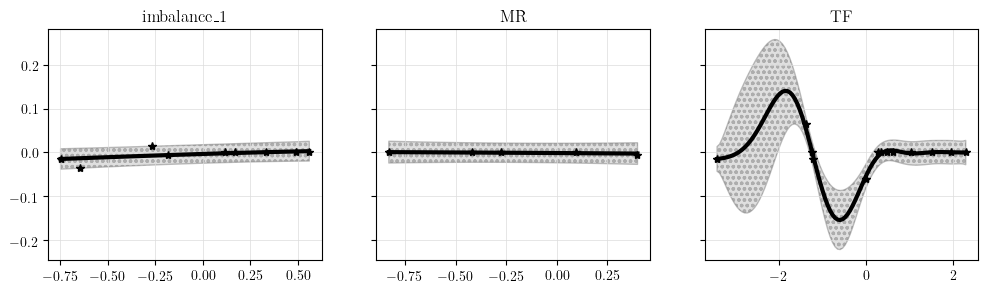

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


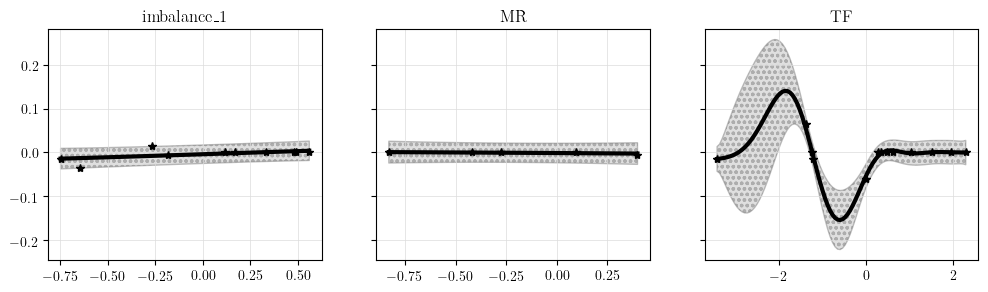

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


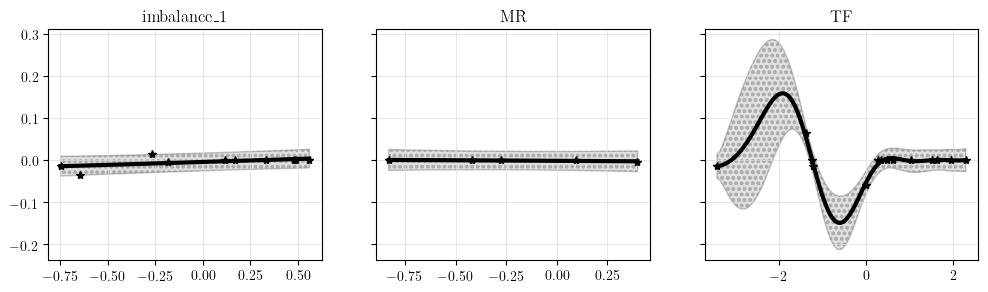

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


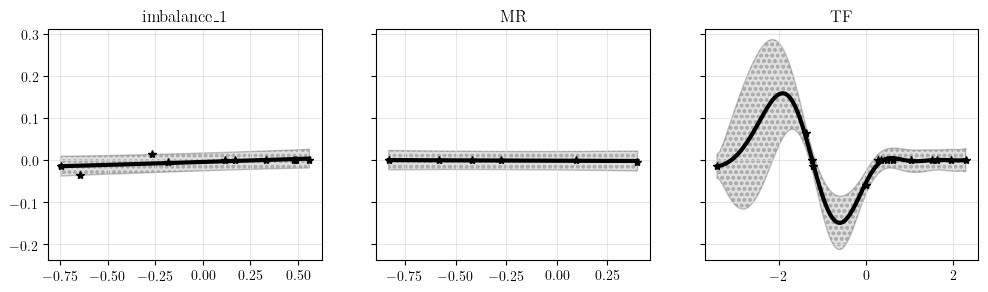

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


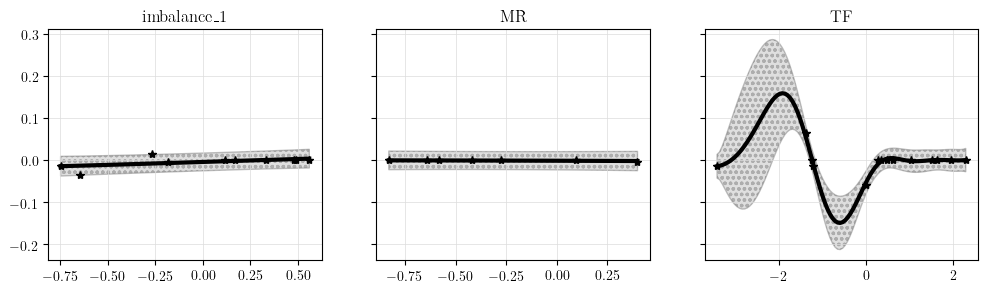

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


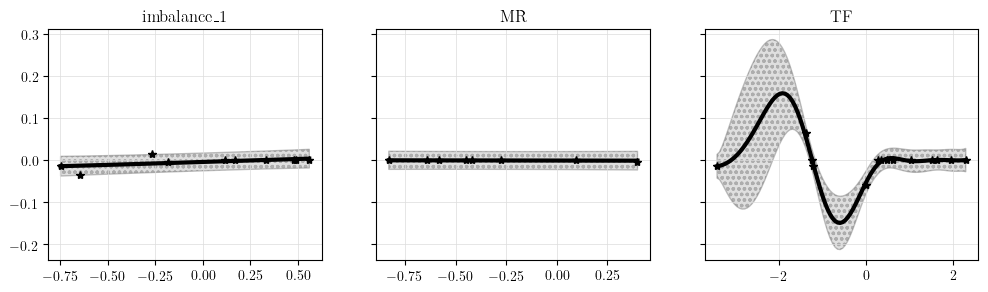

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


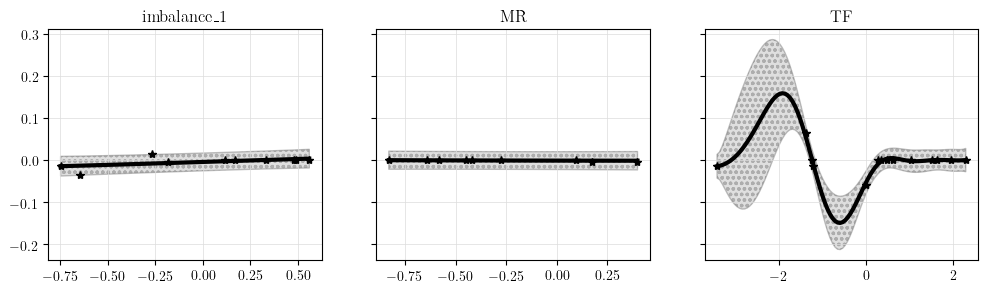

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


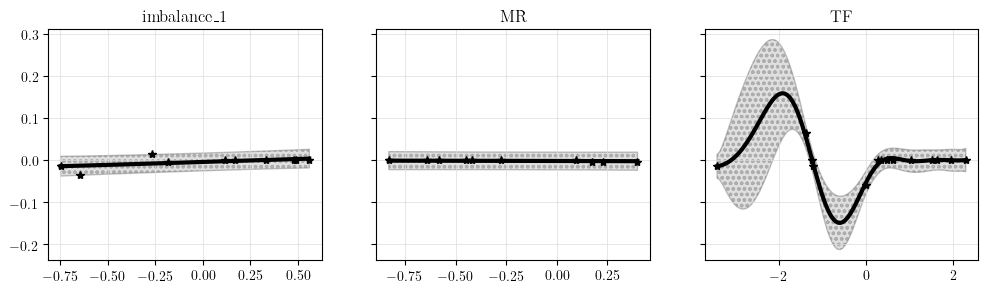

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


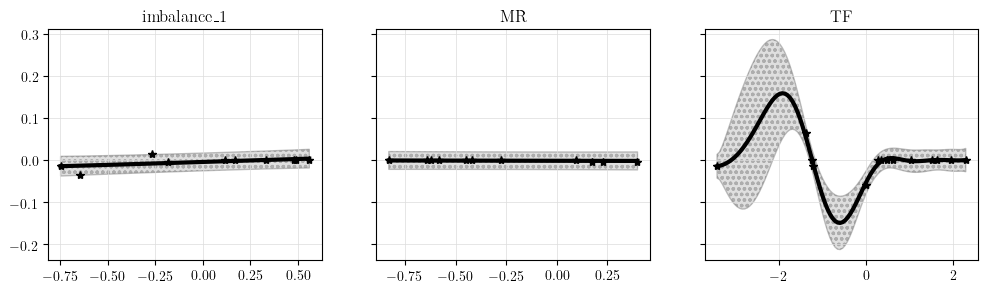

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


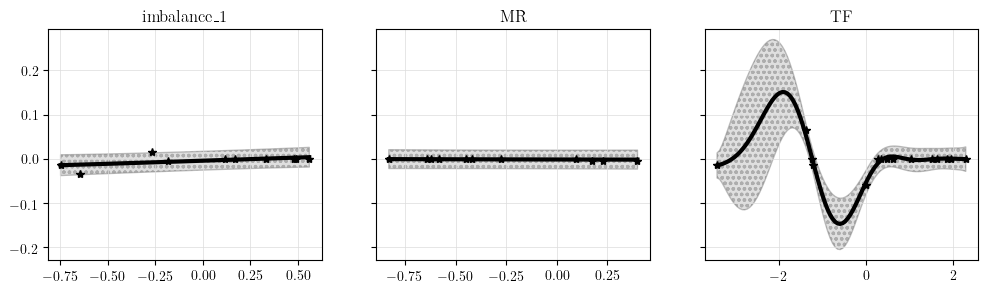

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


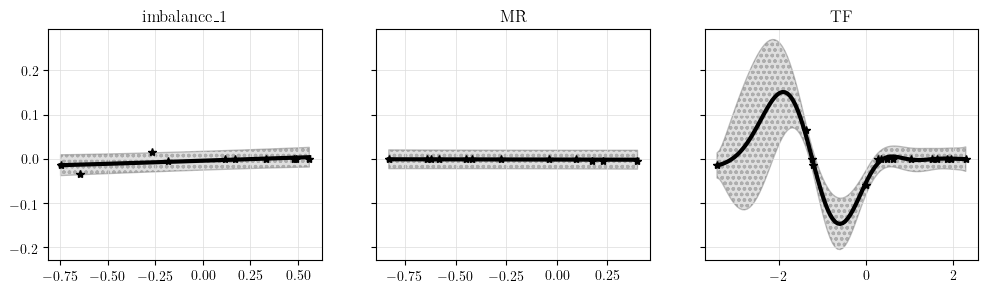

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


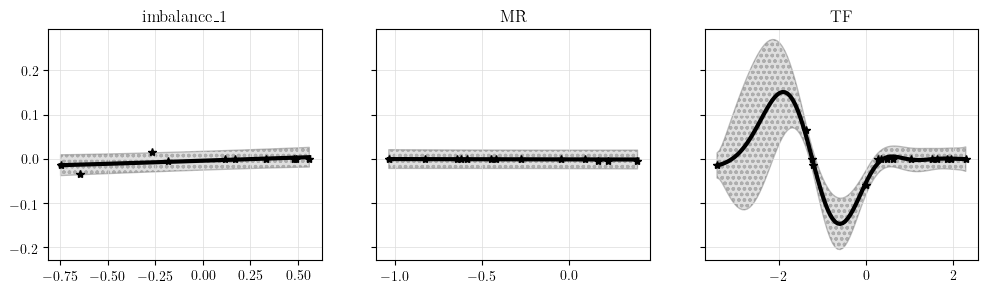

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


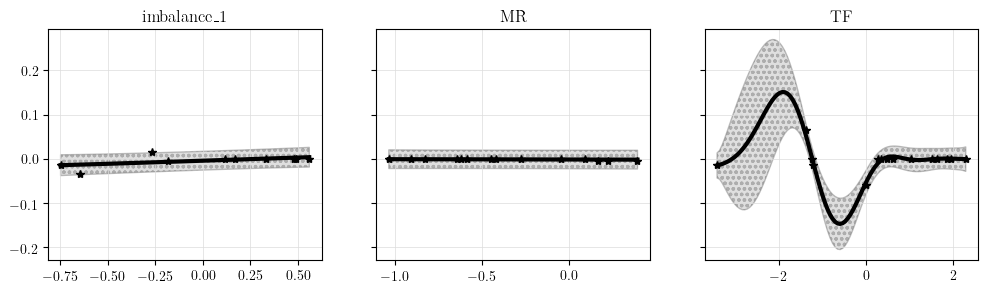

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


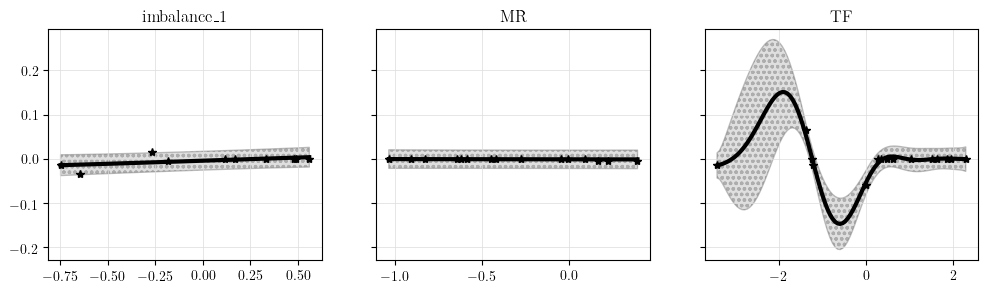

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


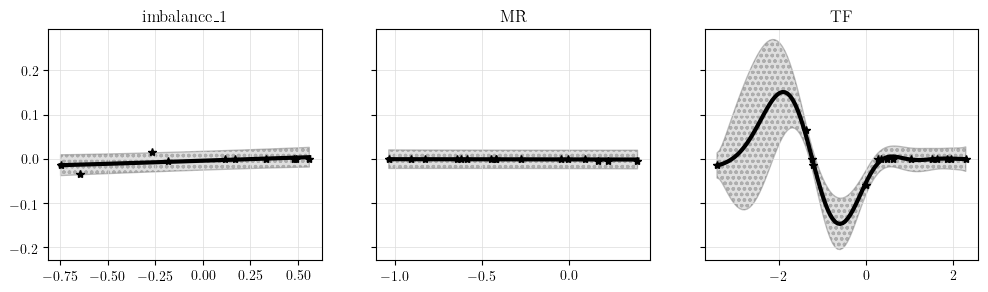

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  3e-05  Threshold: 0.002
Average performance GP1: tensor(-0.0013, dtype=torch.float64)
Average performance GP2: tensor(-0.0007, dtype=torch.float64)


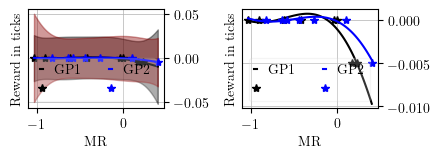

I am storing the change point test results for  MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
I am deleting the change point results of  MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


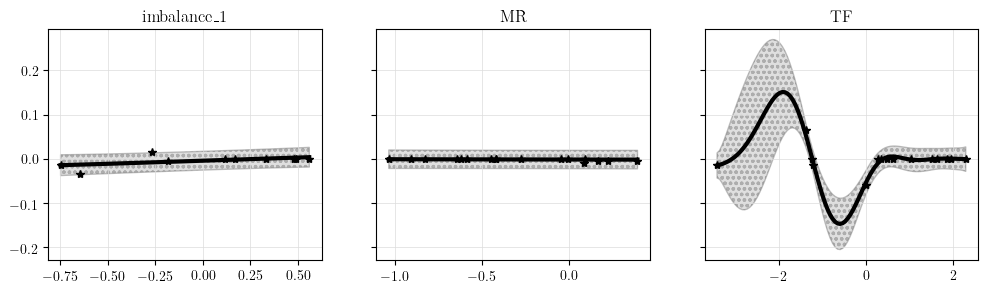

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  3e-05  Threshold: 0.002
Average performance GP1: tensor(-0.0019, dtype=torch.float64)
Average performance GP2: tensor(-0.0014, dtype=torch.float64)


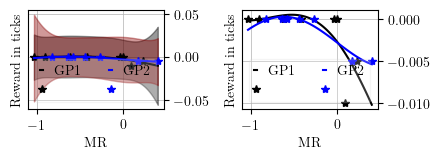

I am storing the change point test results for  MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
I am deleting the change point results of  MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


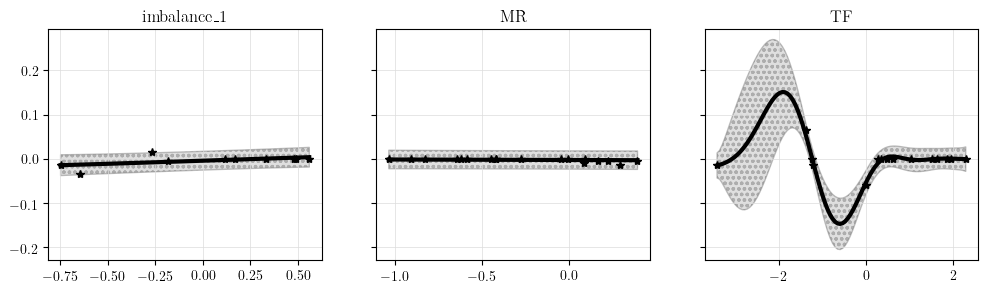

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  4e-05  Threshold: 0.002
Average performance GP1: tensor(-0.0031, dtype=torch.float64)
Average performance GP2: tensor(-0.0021, dtype=torch.float64)


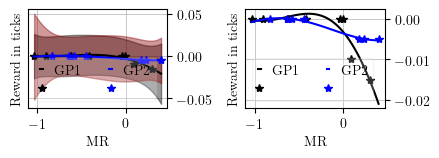

I am storing the change point test results for  MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


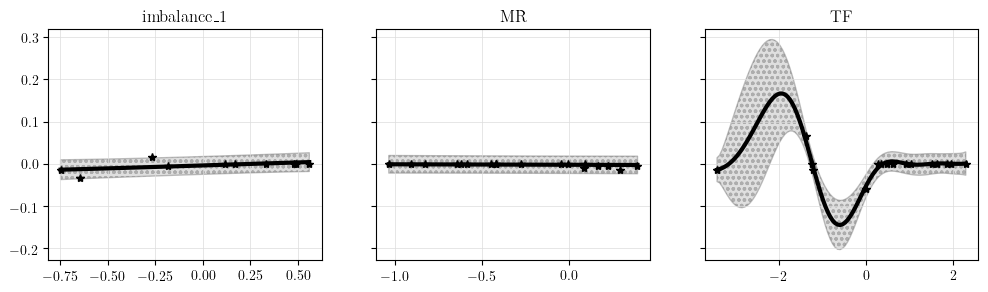

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.13005  Threshold: 0.002
Average performance GP1: tensor(-0.0019, dtype=torch.float64)
Average performance GP2: tensor(-0.0014, dtype=torch.float64)


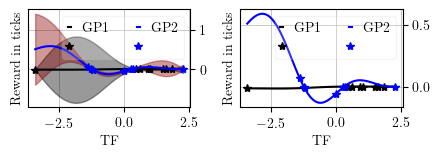

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


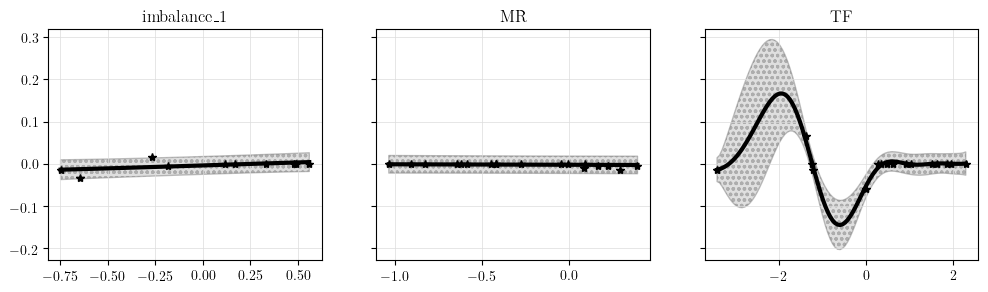

Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


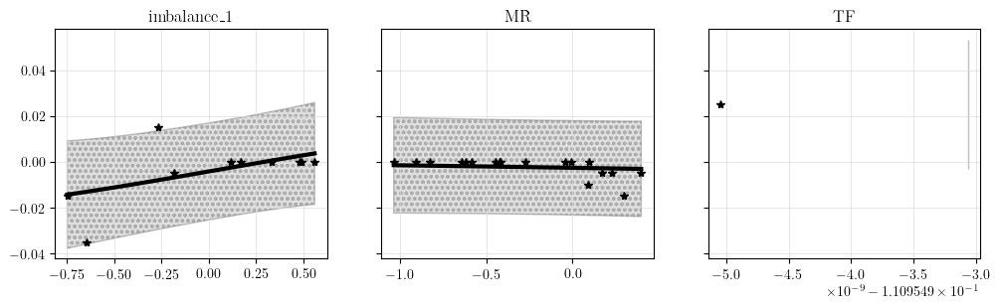

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


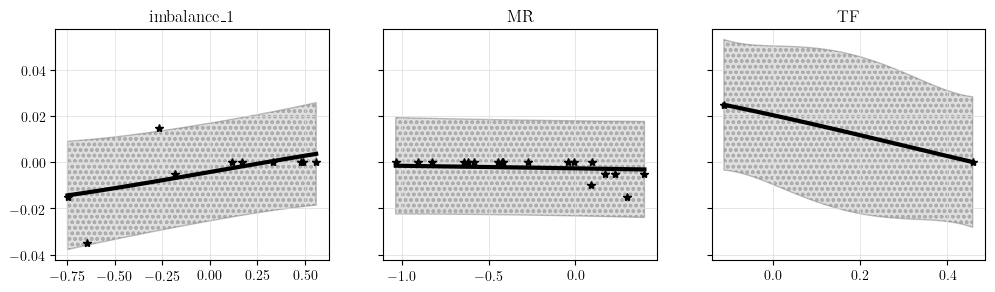

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


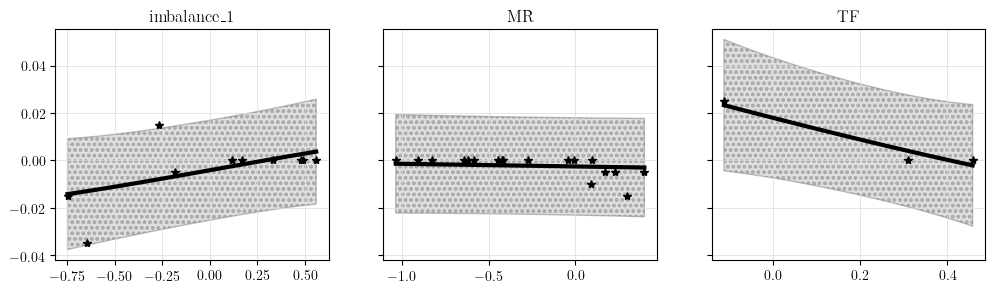

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


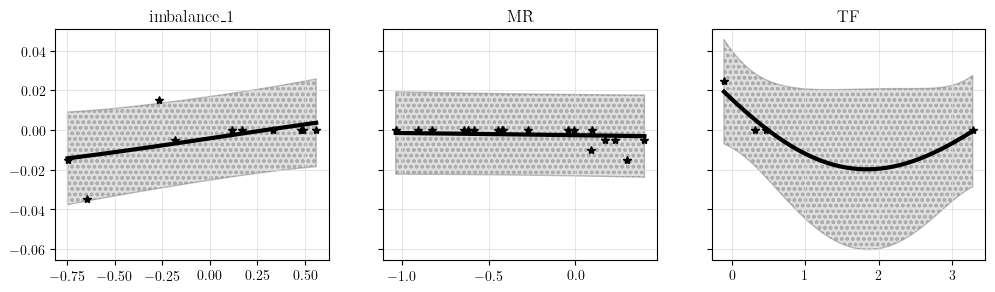

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


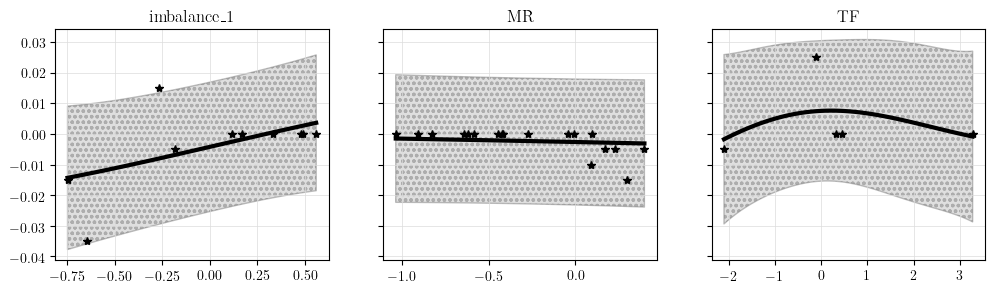

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


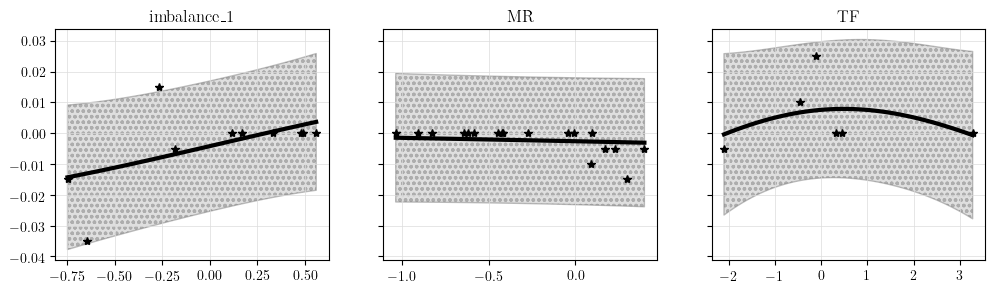

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


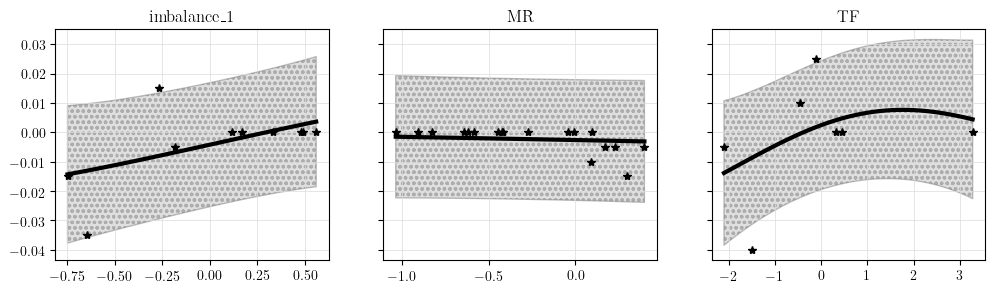

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


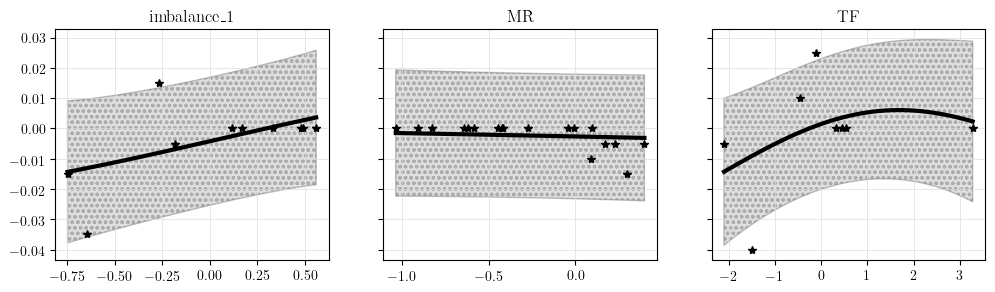

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


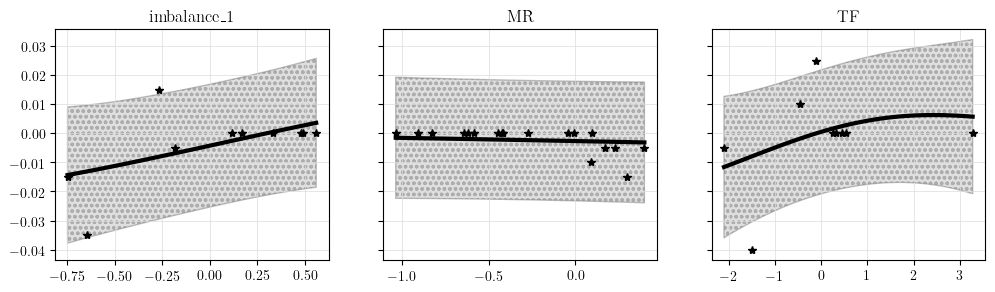

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


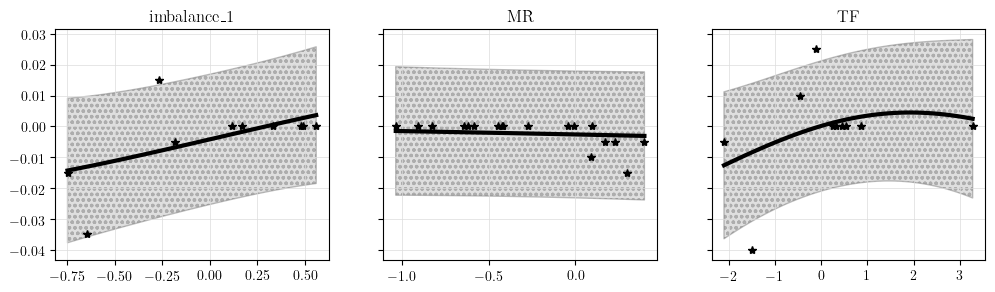

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


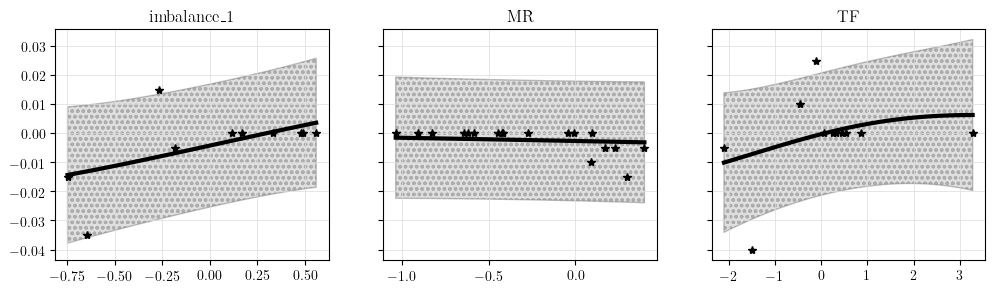

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


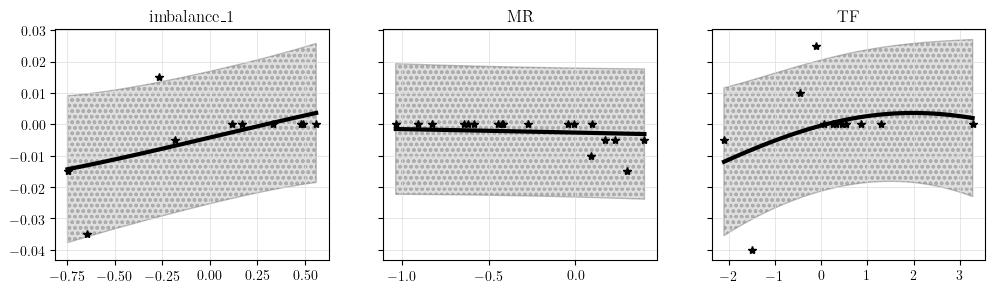

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
I am deleting the change point results of  MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


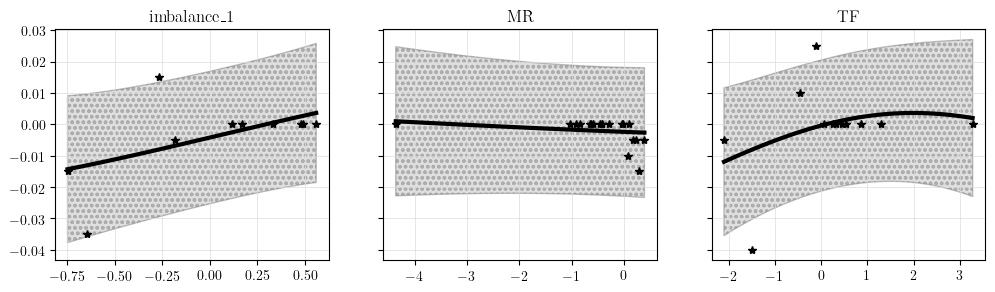

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.04158  Threshold: 0.002
Average performance GP1: tensor(-0.0031, dtype=torch.float64)
Average performance GP2: tensor(-0.0021, dtype=torch.float64)


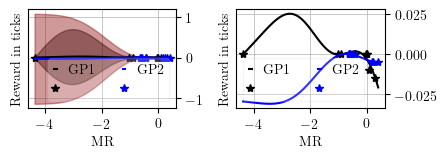

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


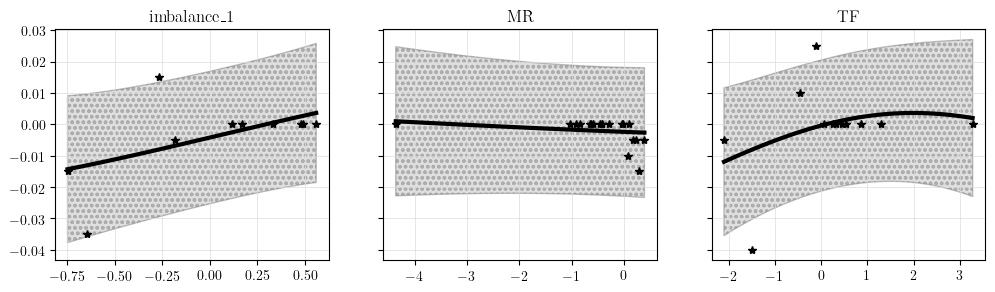

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


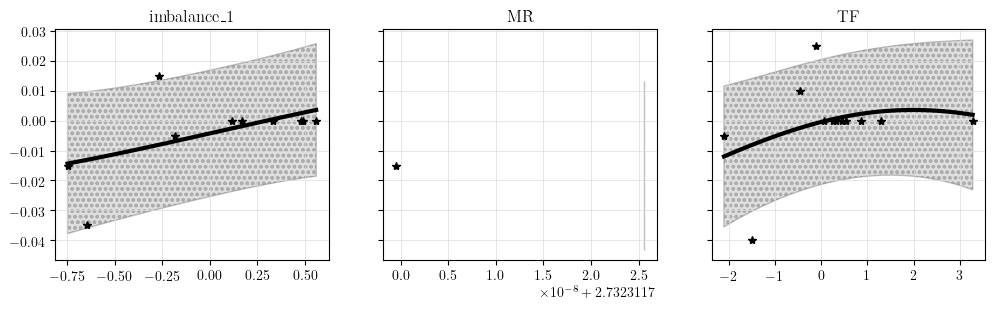

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


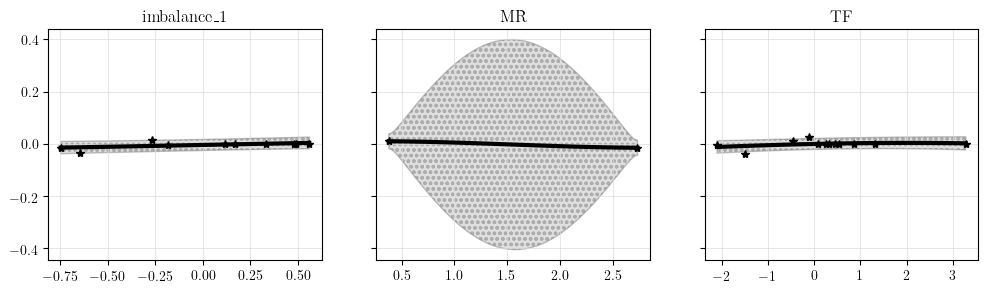

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


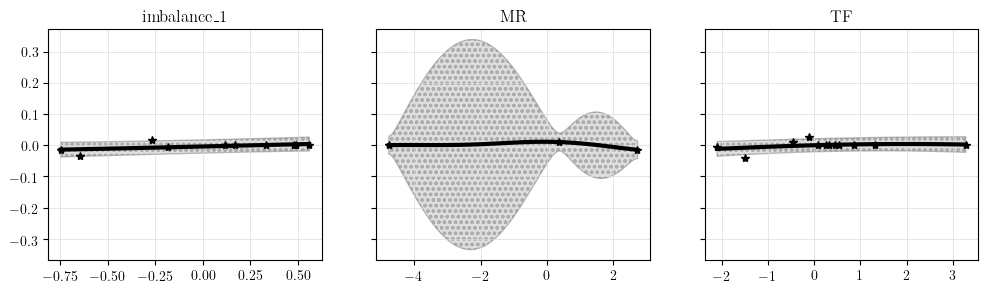

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


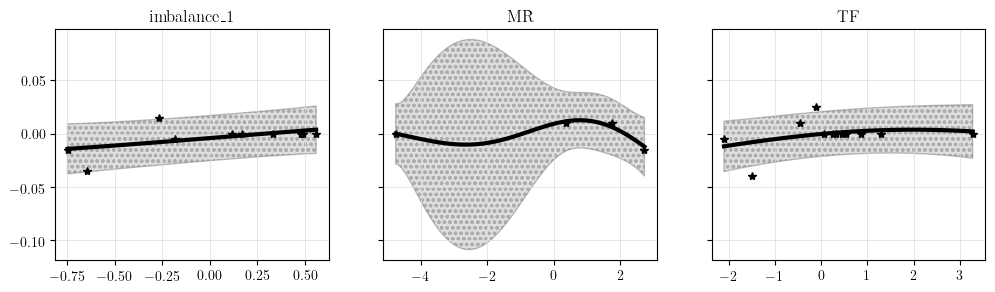

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


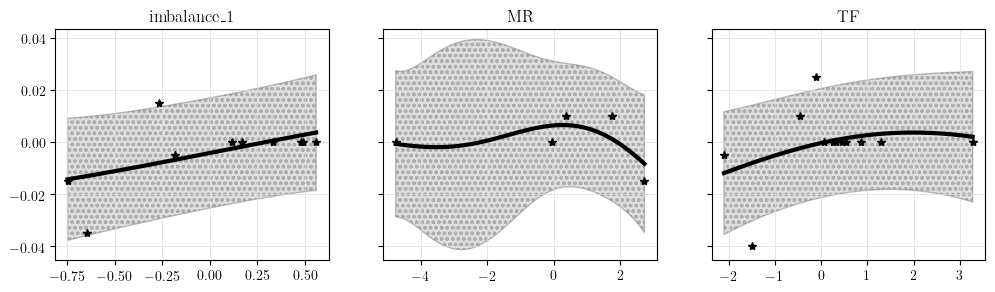

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


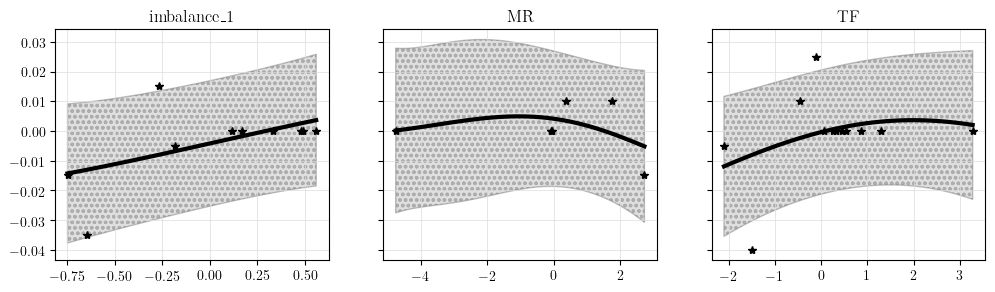

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


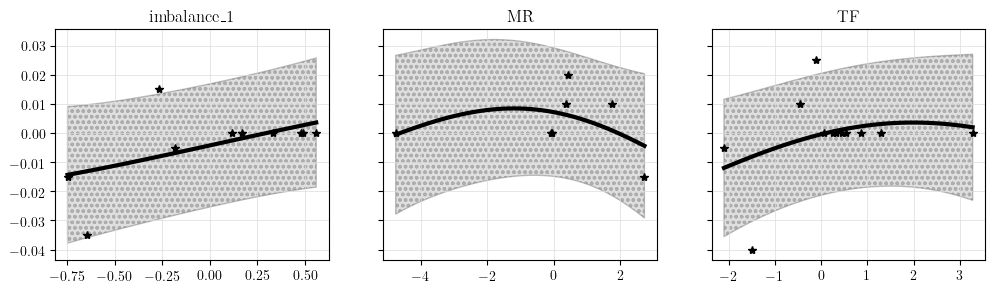

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


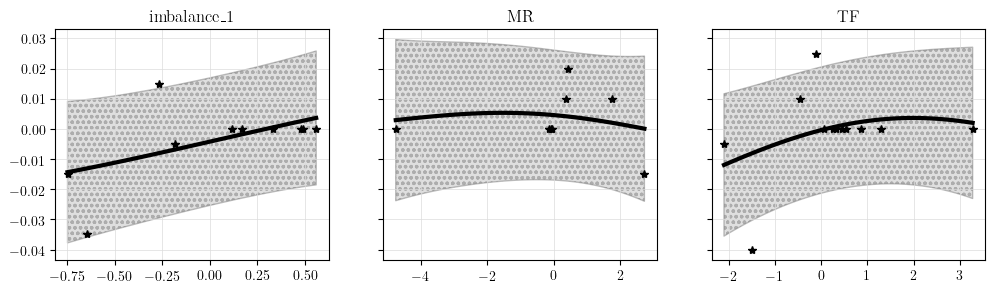

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


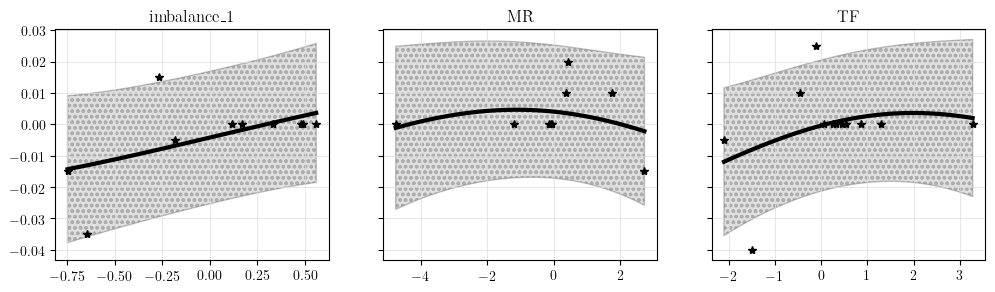

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


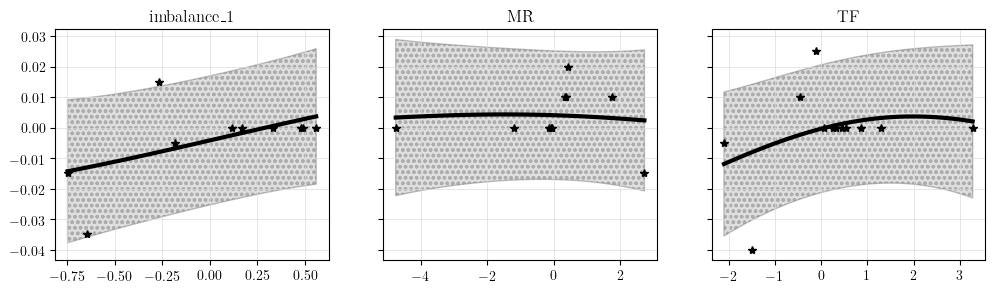

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


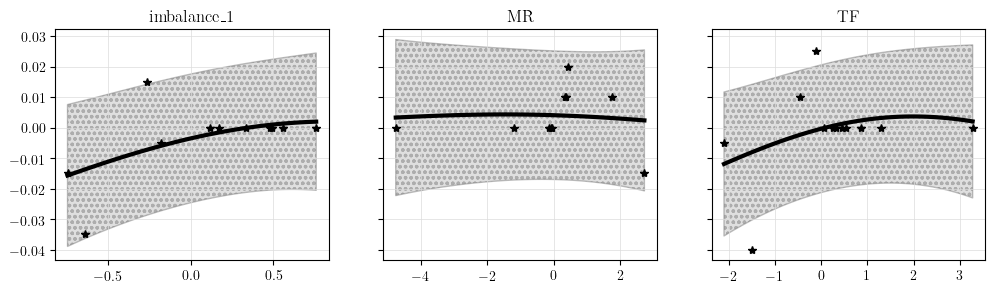

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


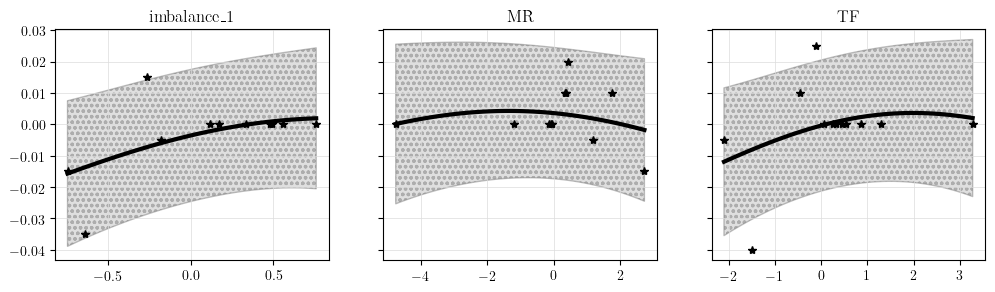

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


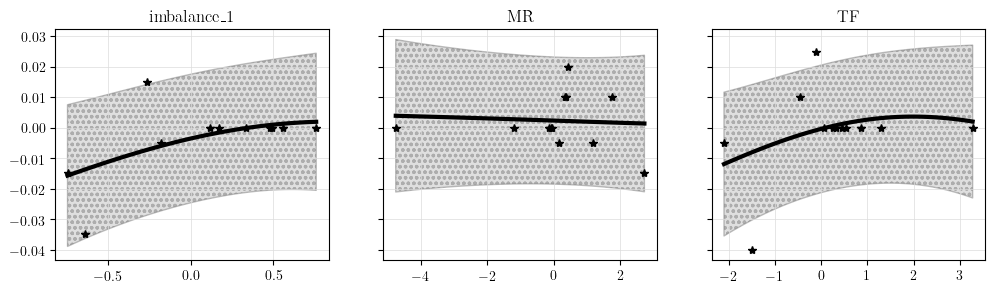

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


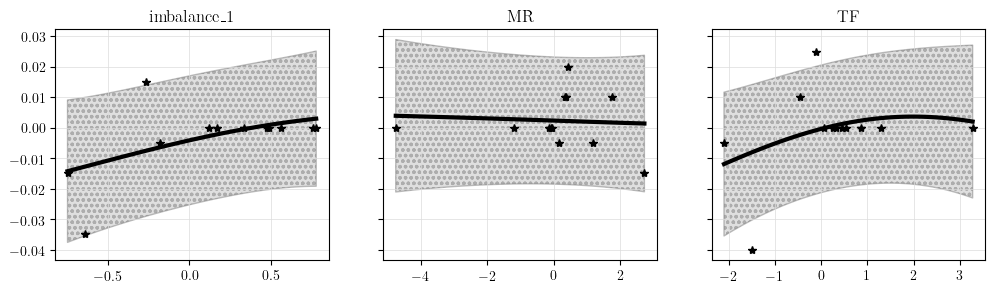

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


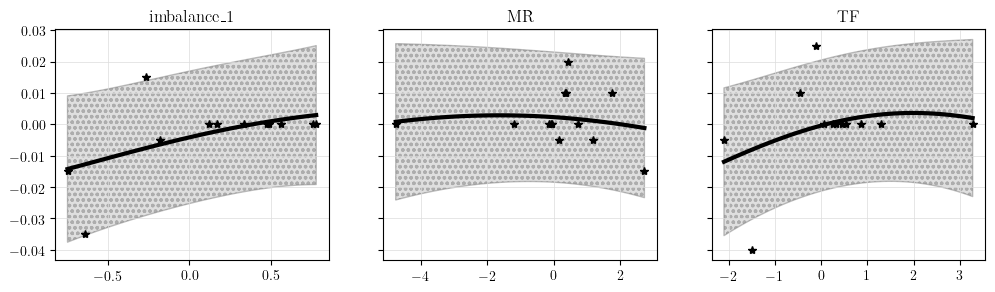

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


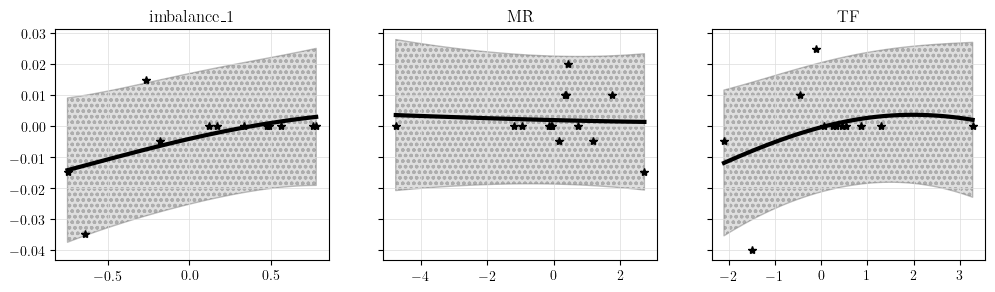

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


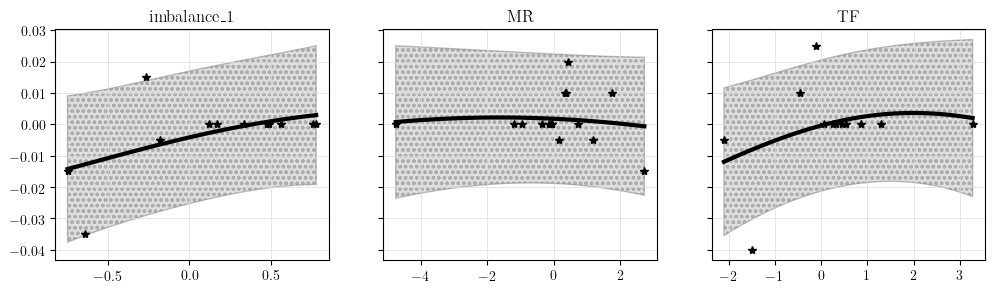

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


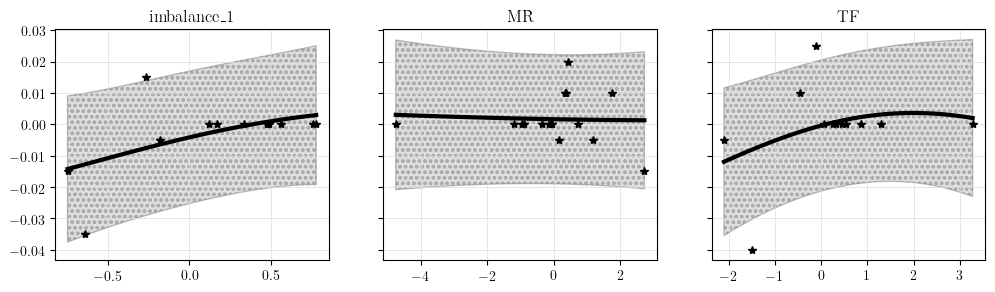

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.04192  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(0.0057, dtype=torch.float64)


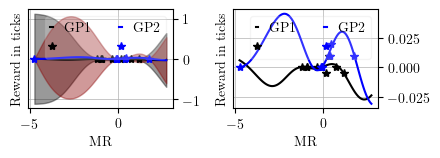

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


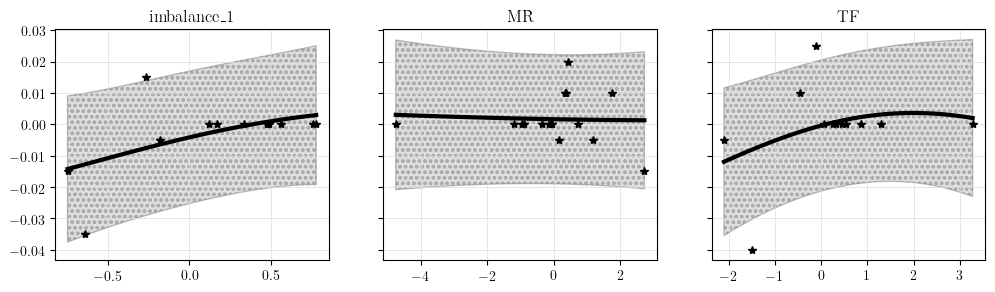

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


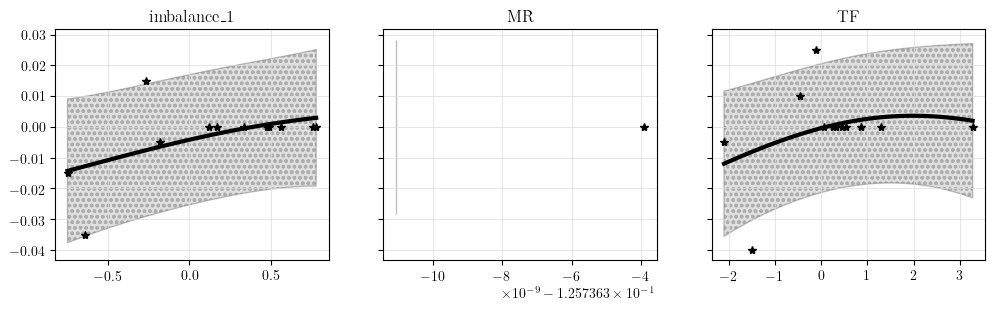

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


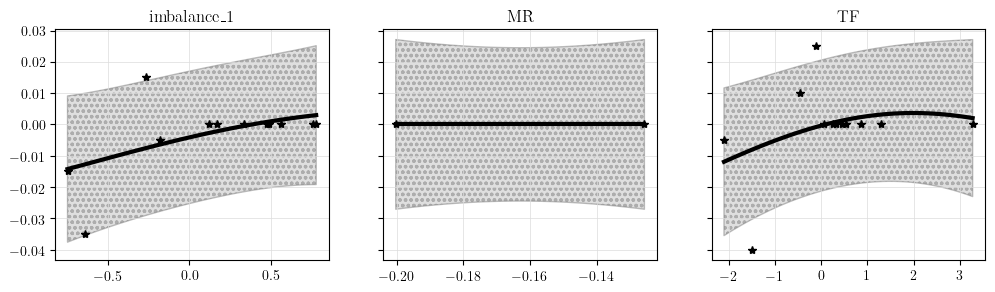

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


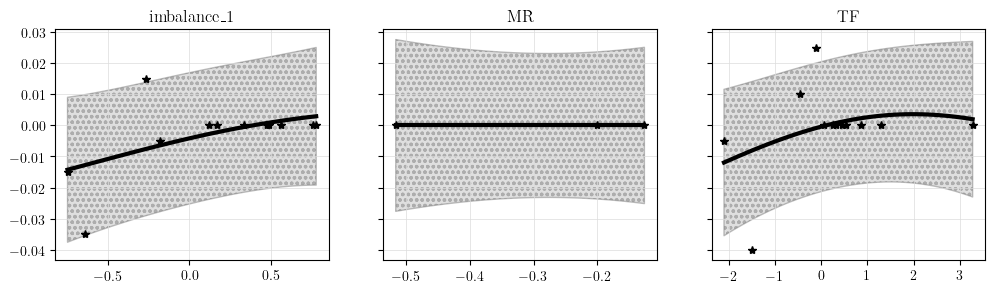

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


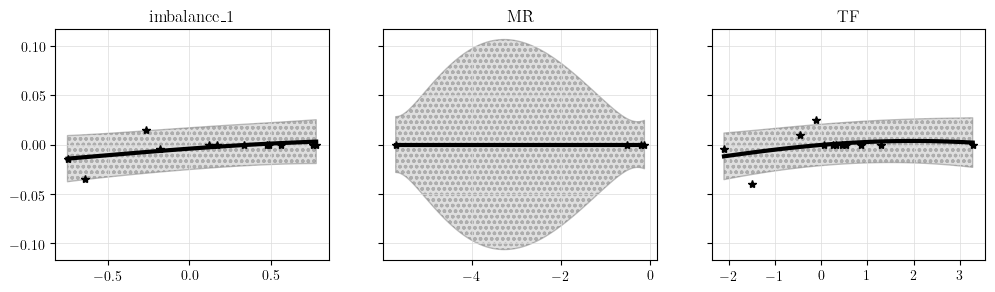

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


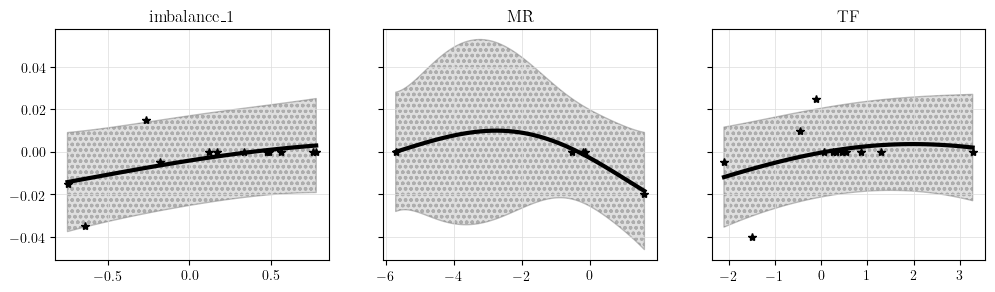

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


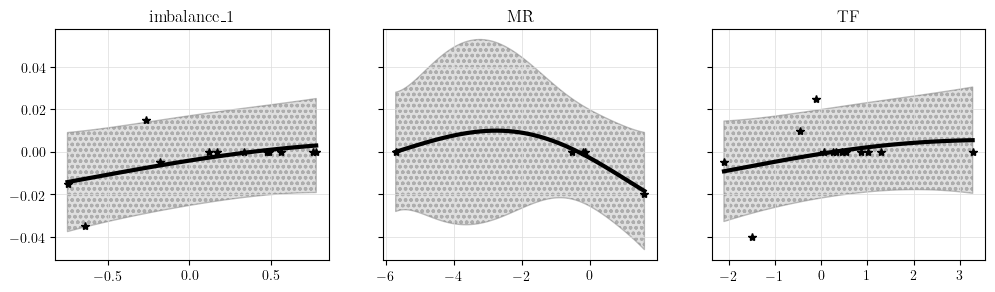

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


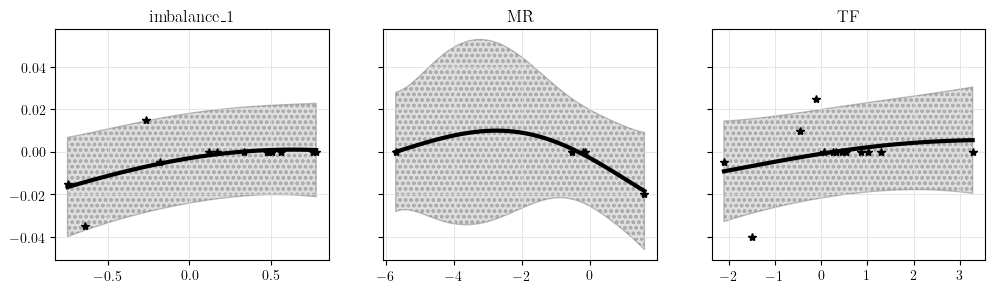

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


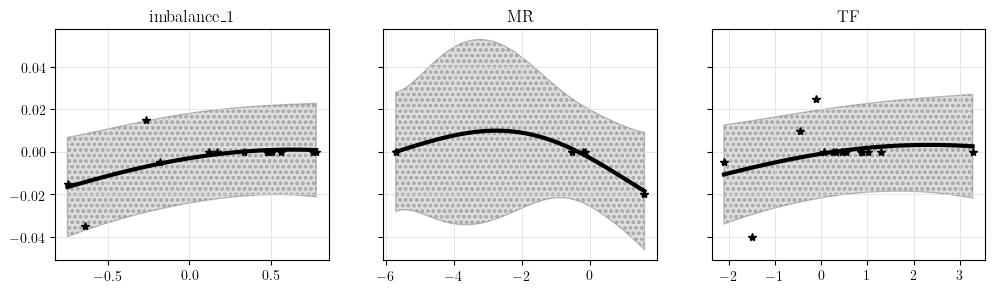

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


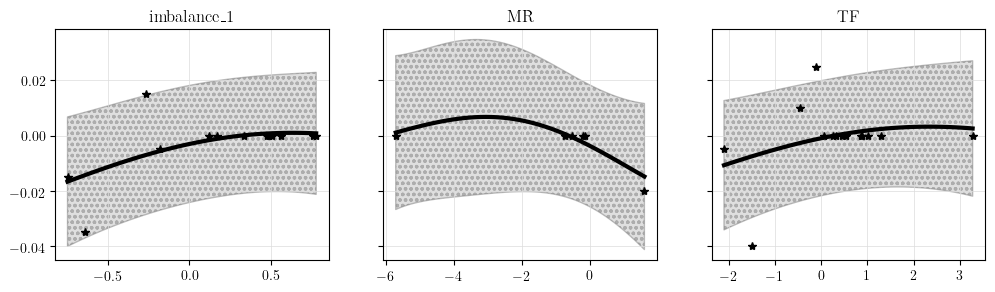

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


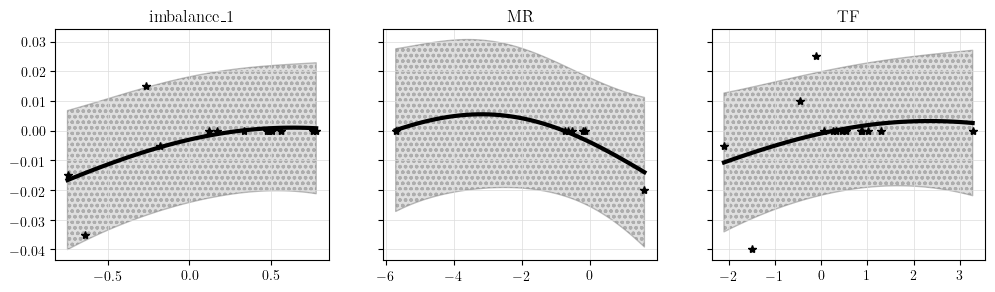

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


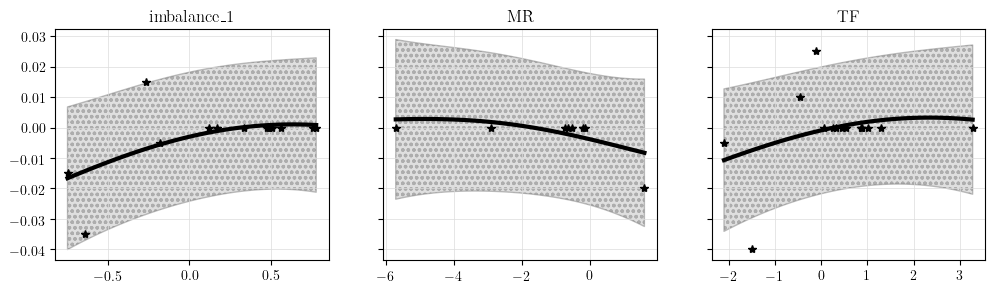

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


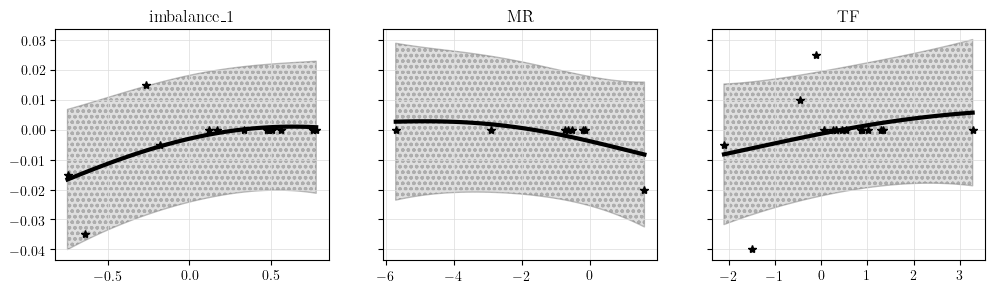

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


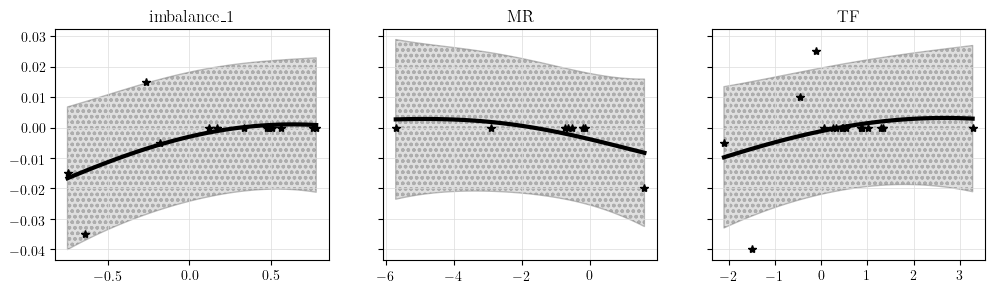

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.0402  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(-0.0050, dtype=torch.float64)


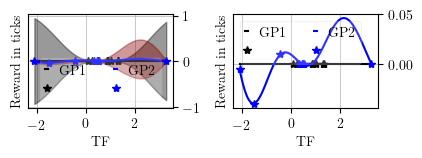

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


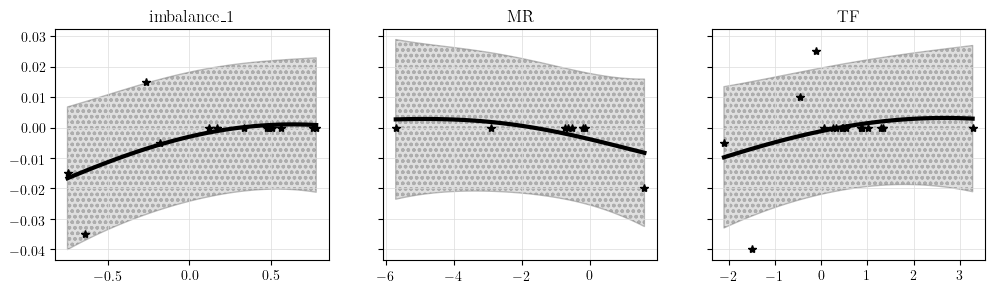

Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


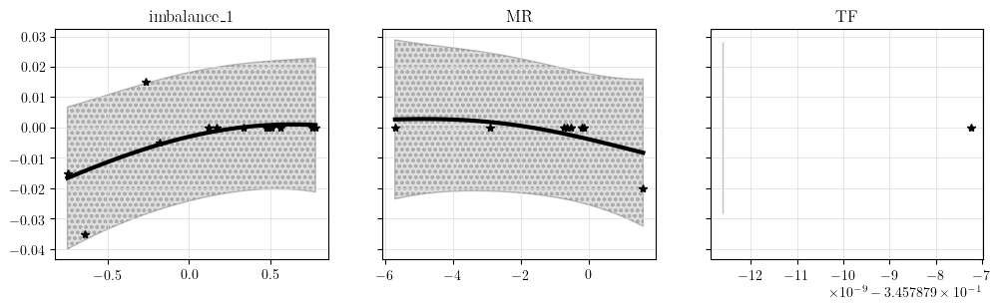

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


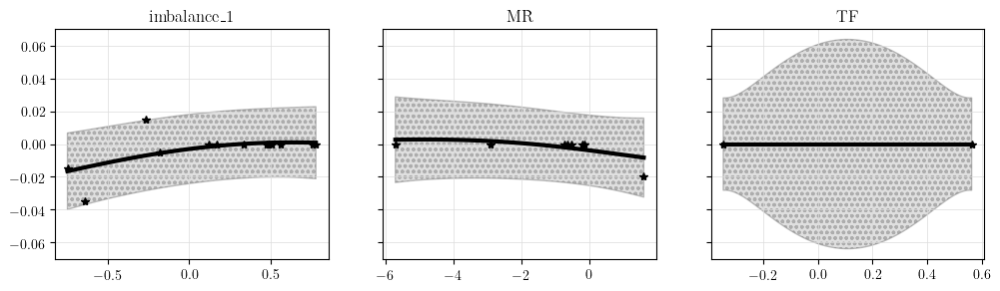

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


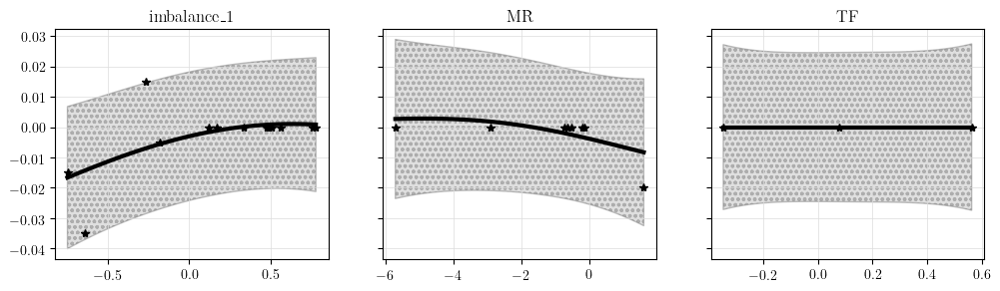

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


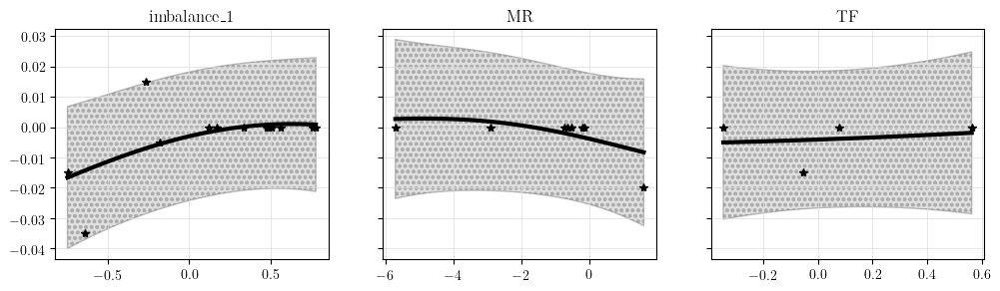

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


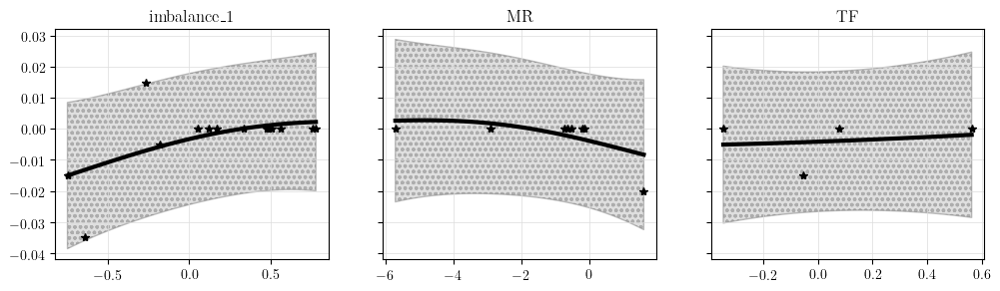

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


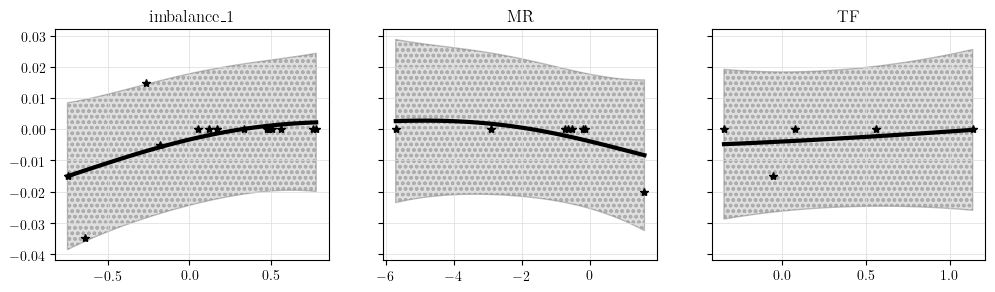

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


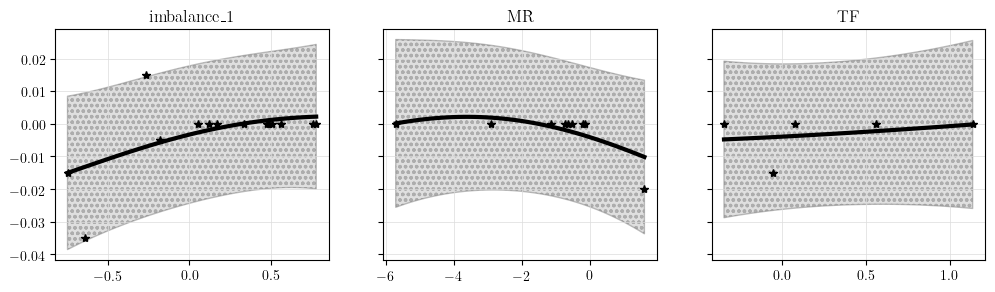

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


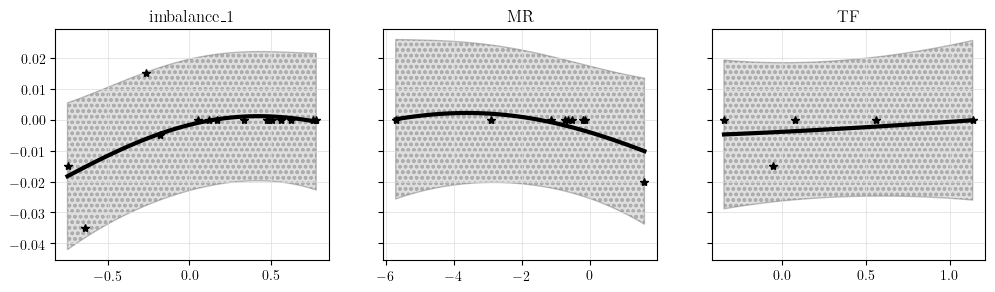

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


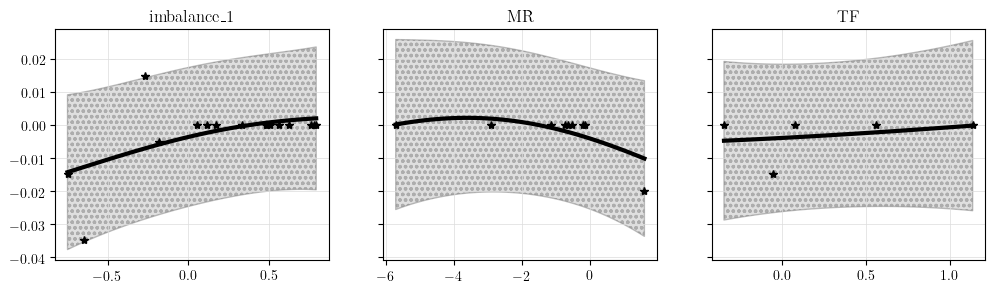

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00198  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(-0.0050, dtype=torch.float64)


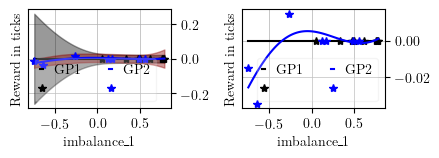

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


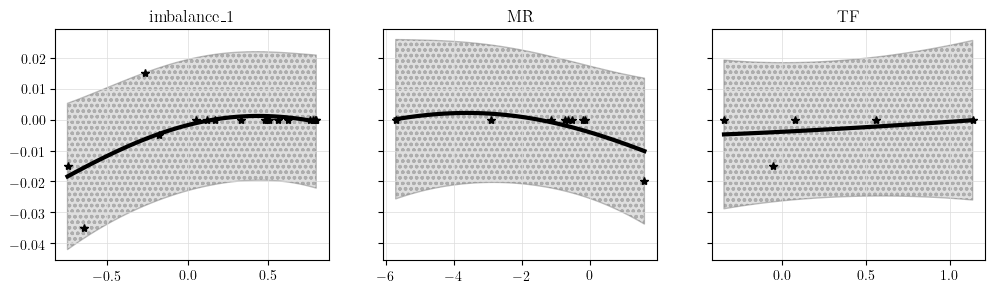

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00217  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(-0.0029, dtype=torch.float64)


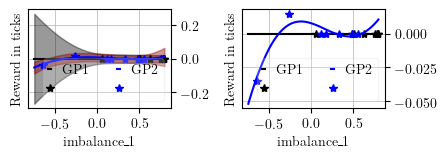

I am storing the change point test results for  imbalance_1
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


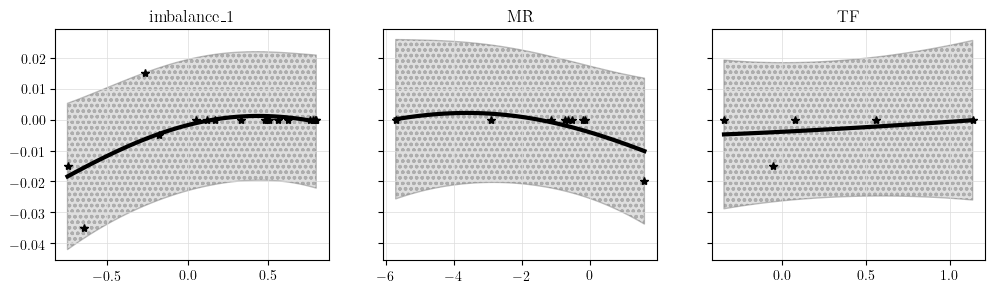

Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


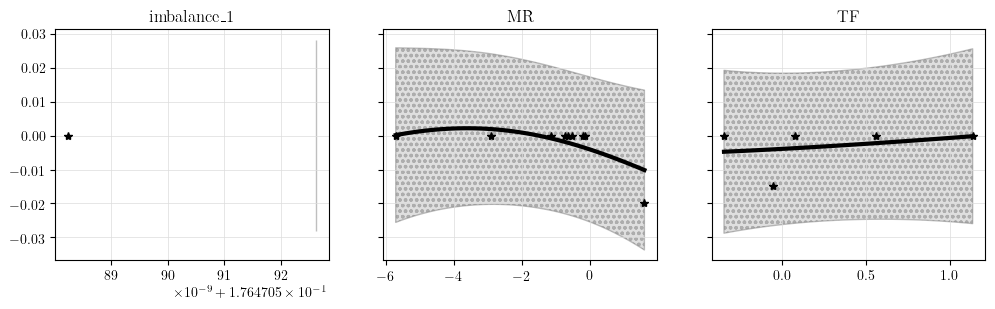

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


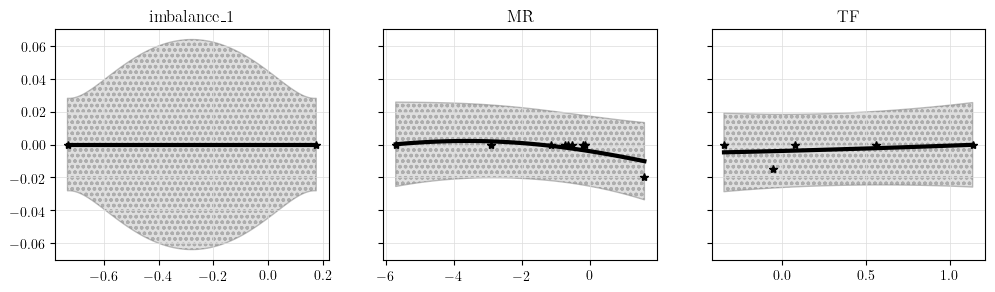

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


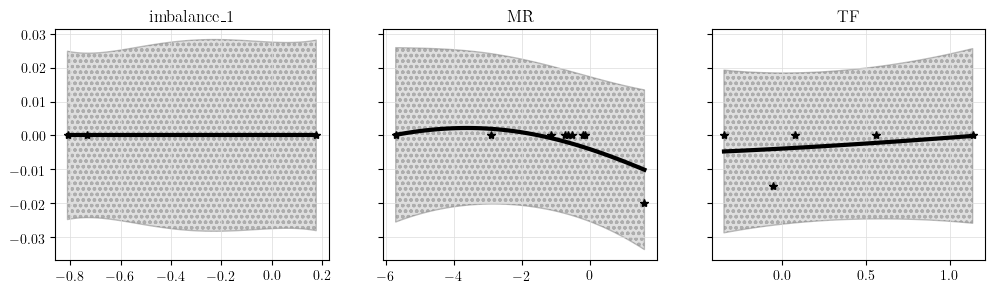

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


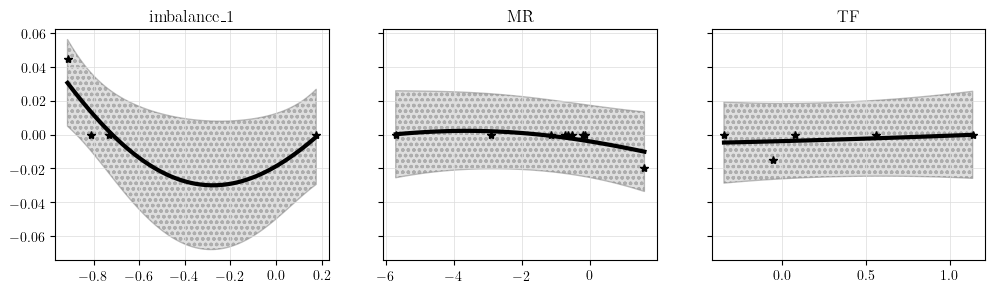

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


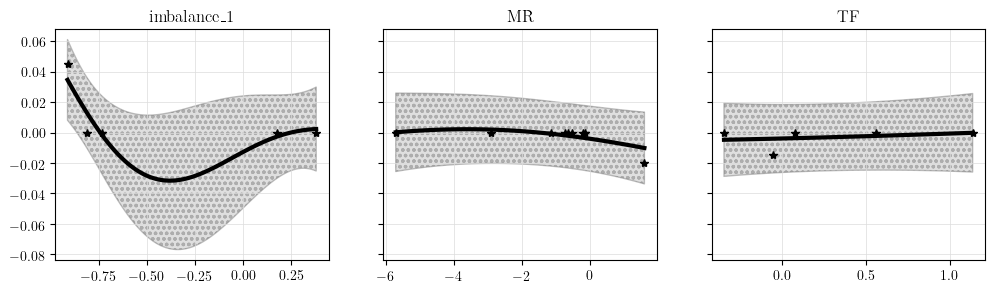

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


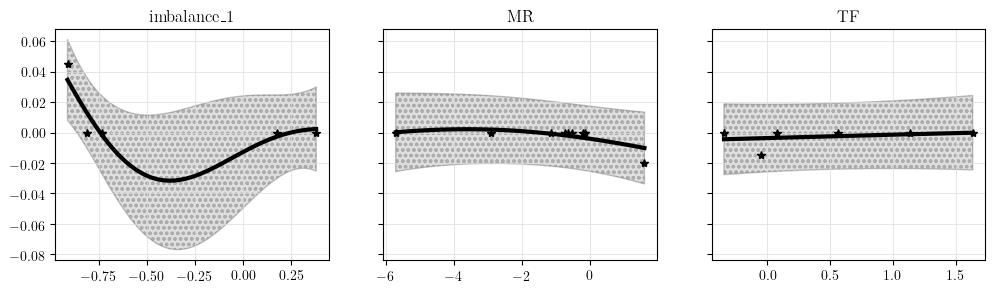

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


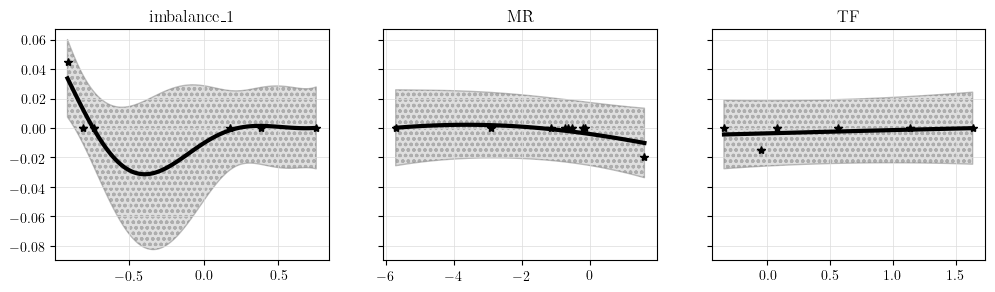

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


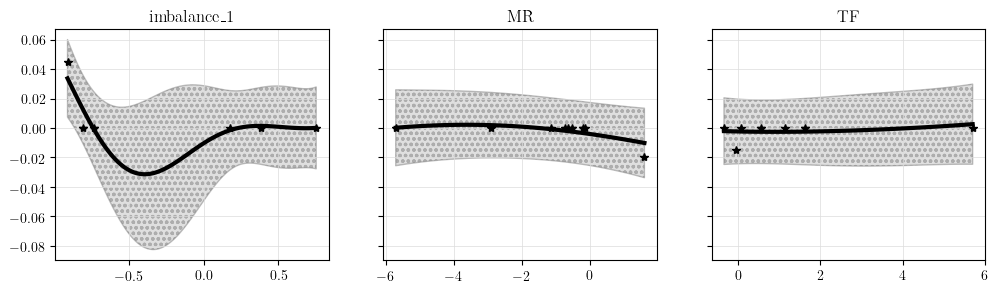

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


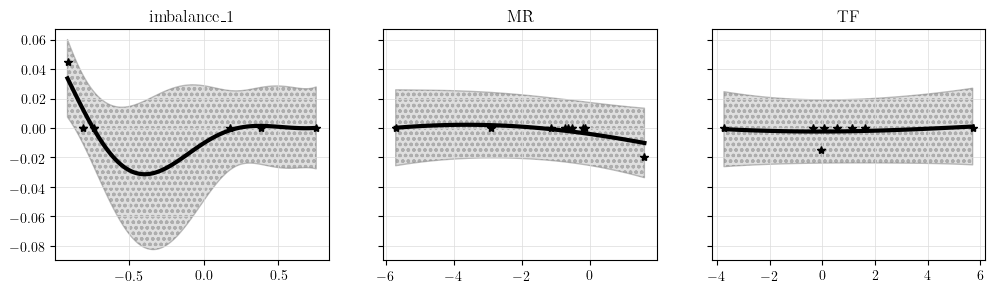

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


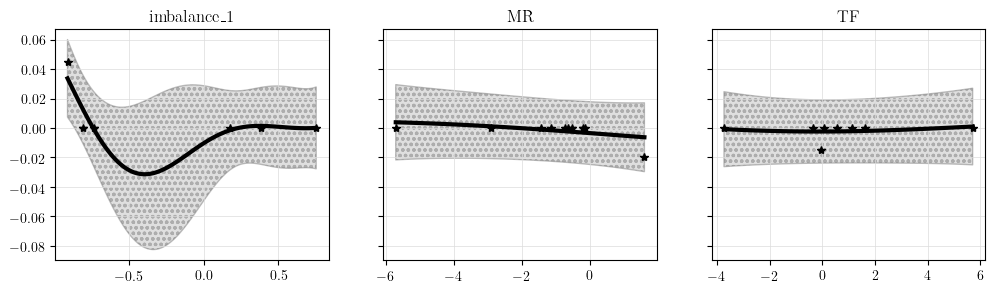

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


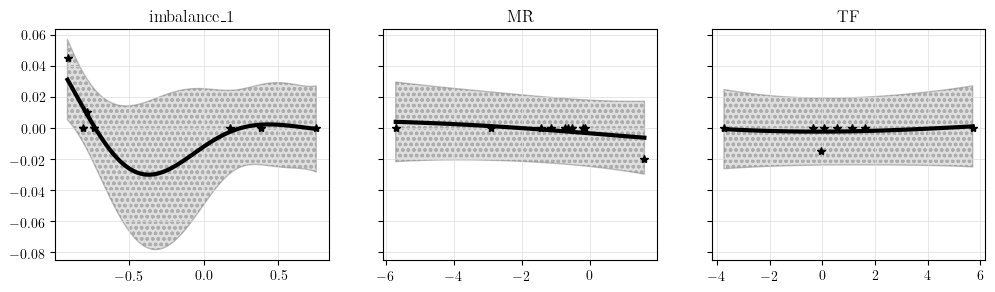

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


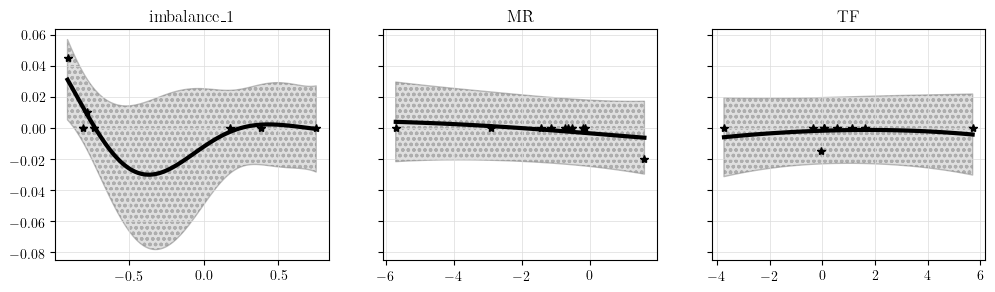

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


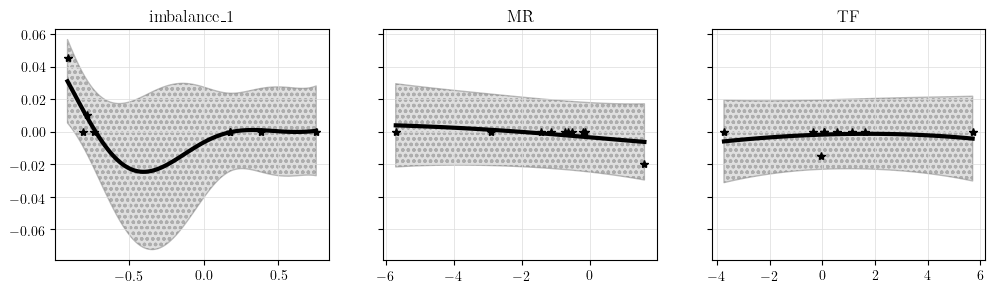

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


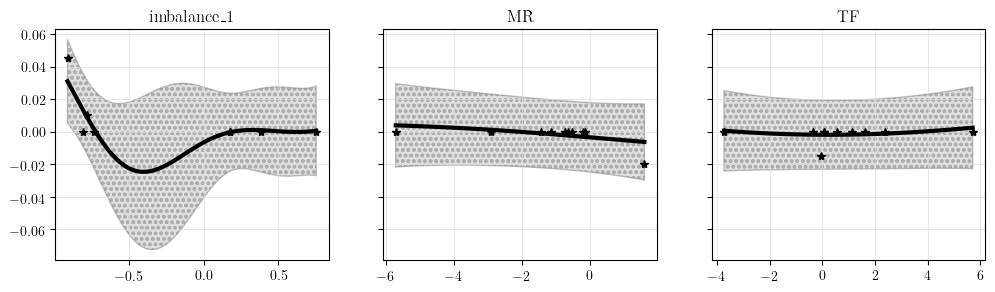

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


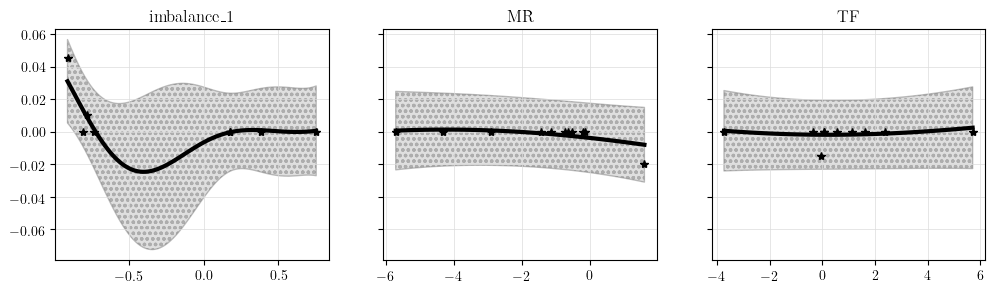

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


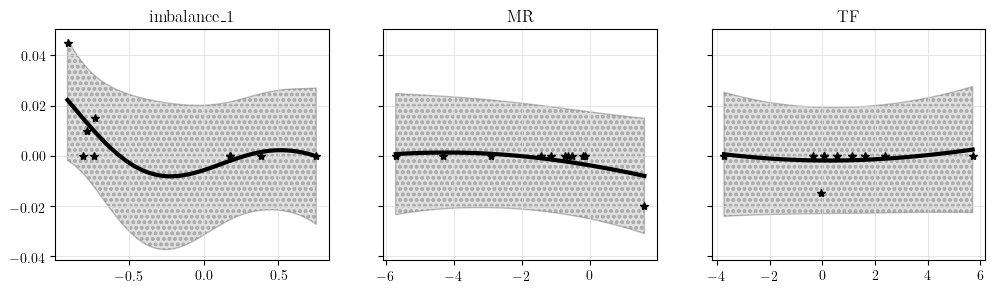

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


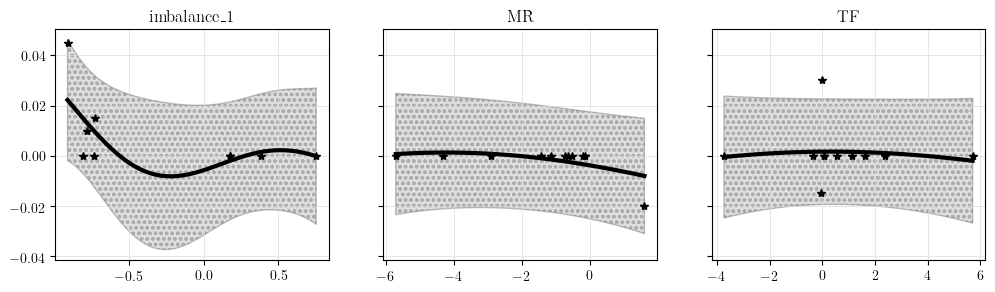

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


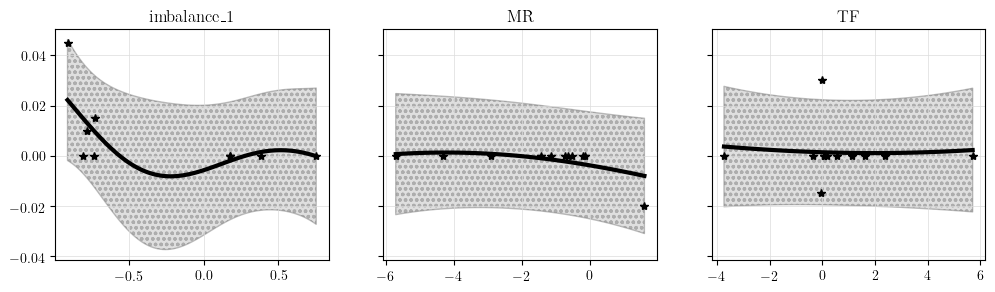

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


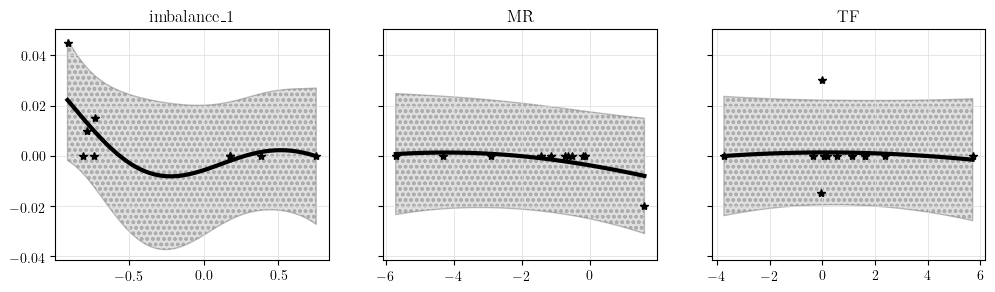

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


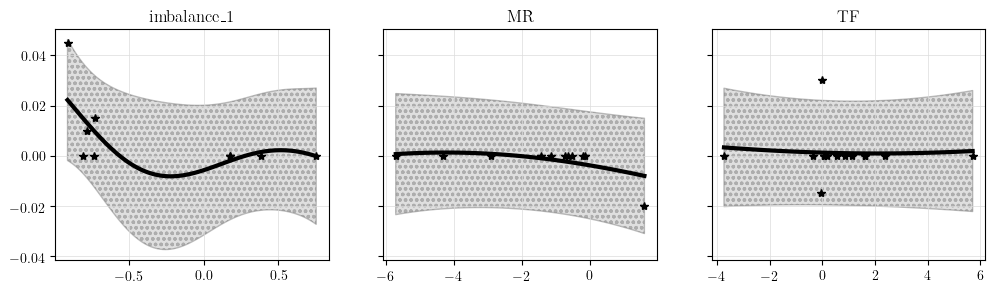

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


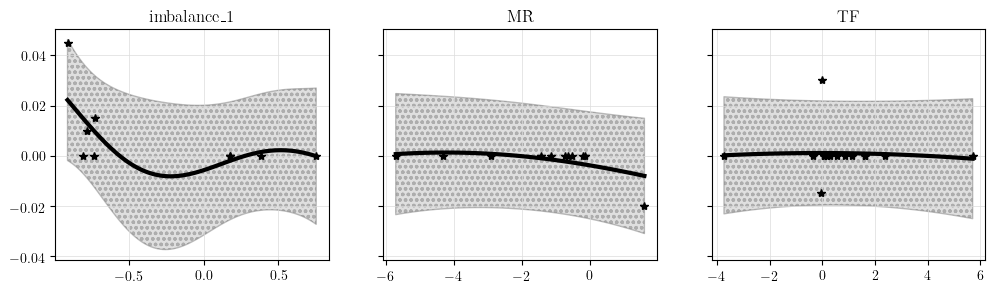

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


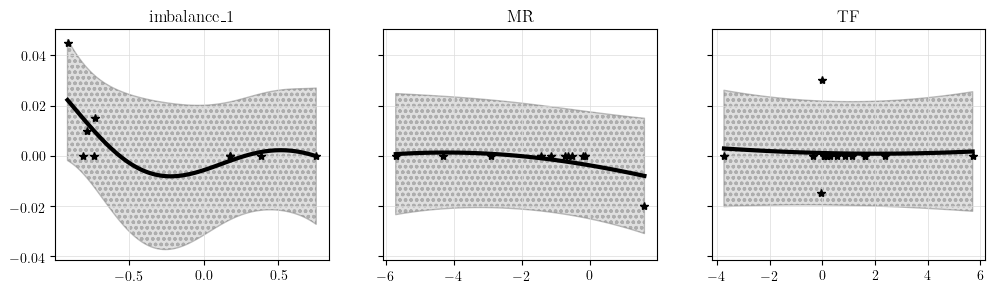

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.08834  Threshold: 0.002
Average performance GP1: tensor(0.0038, dtype=torch.float64)
Average performance GP2: tensor(-0.0021, dtype=torch.float64)


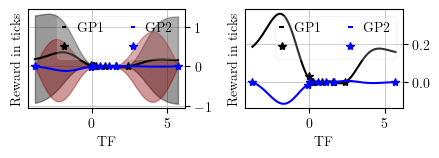

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


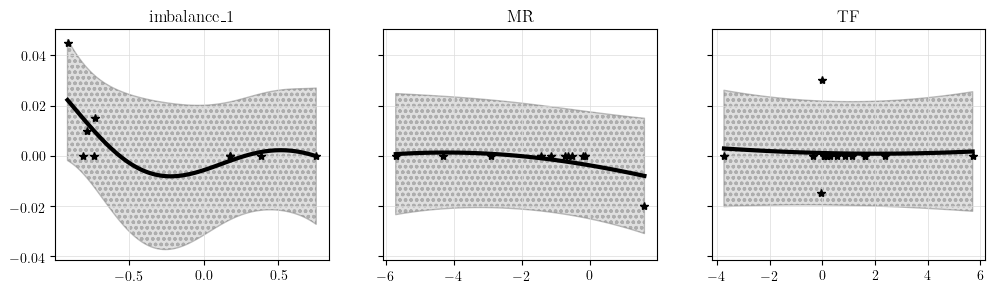

Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


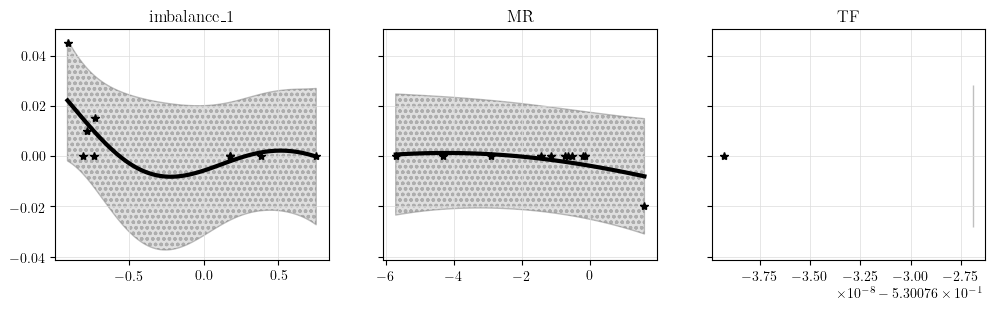

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


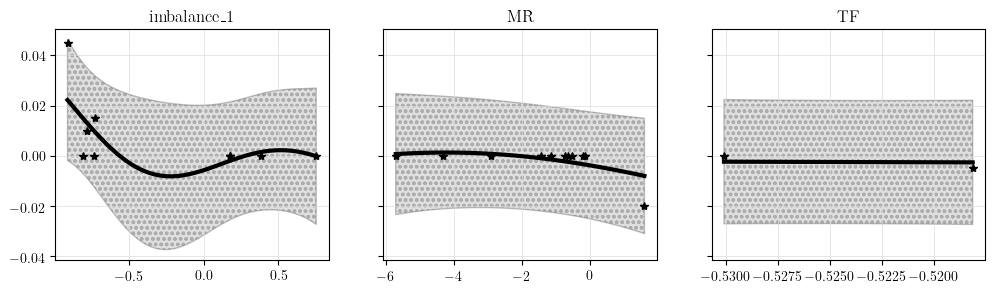

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


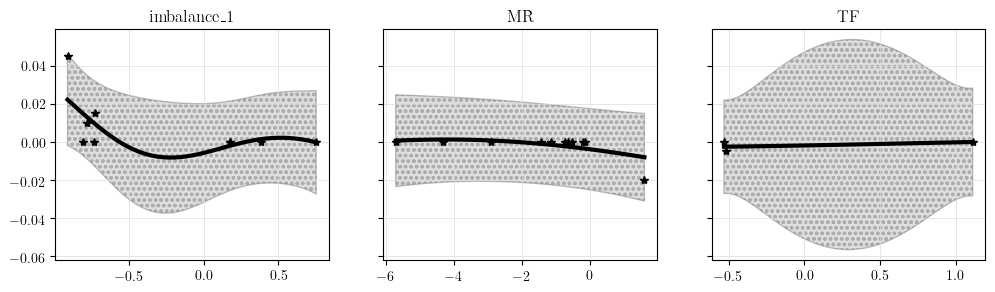

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


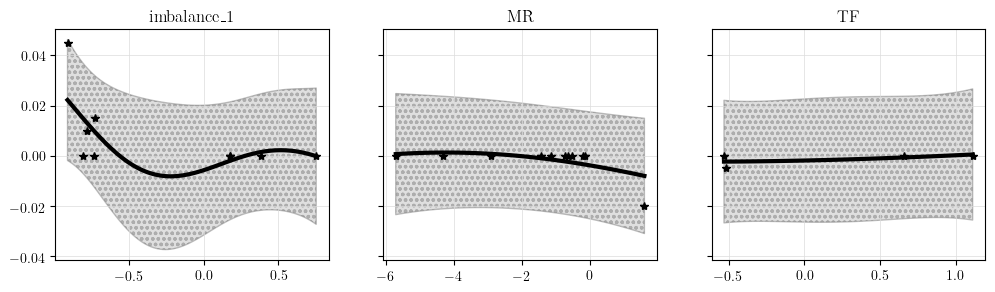

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


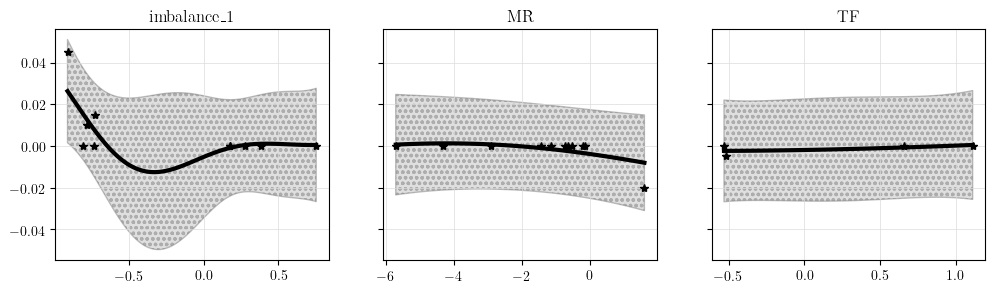

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


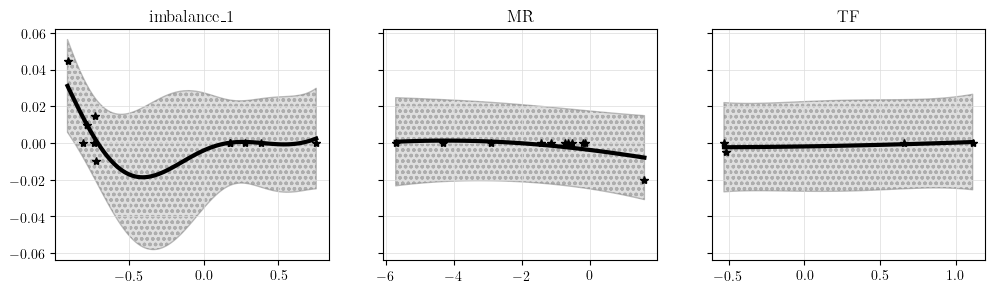

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


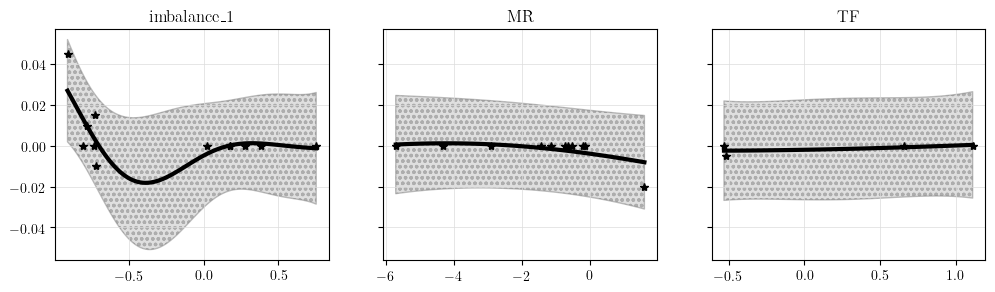

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


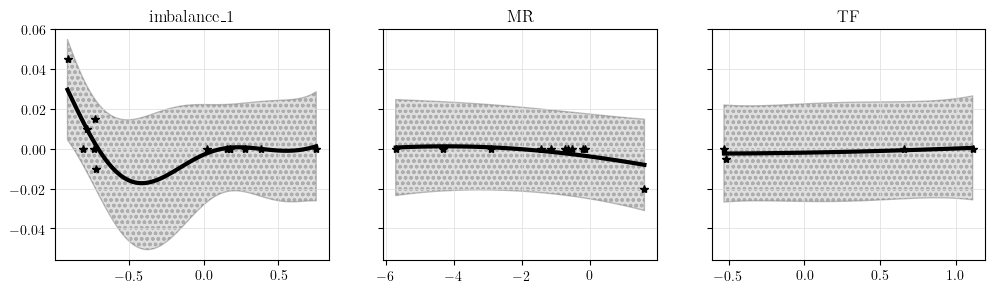

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


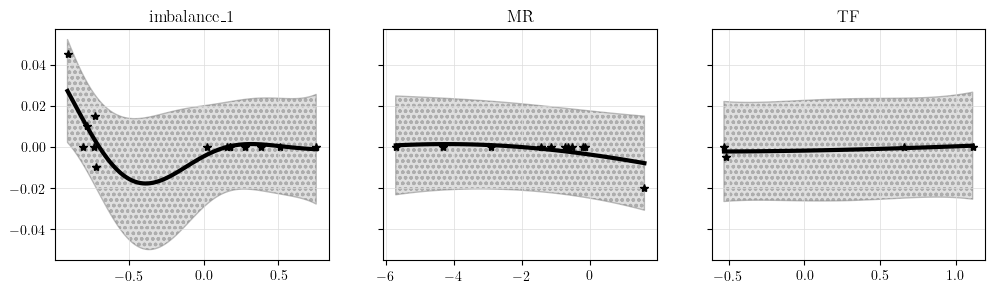

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


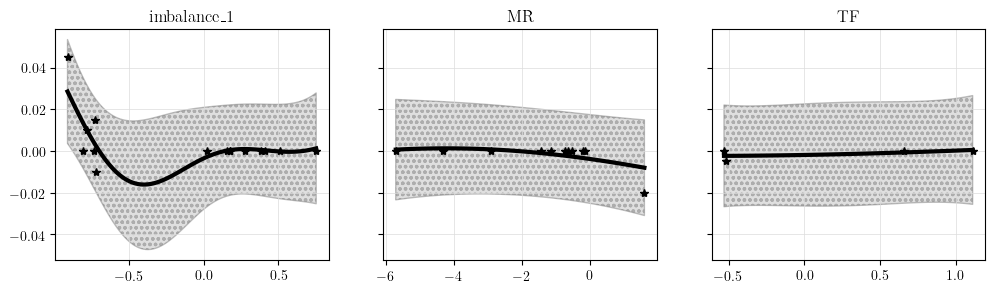

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


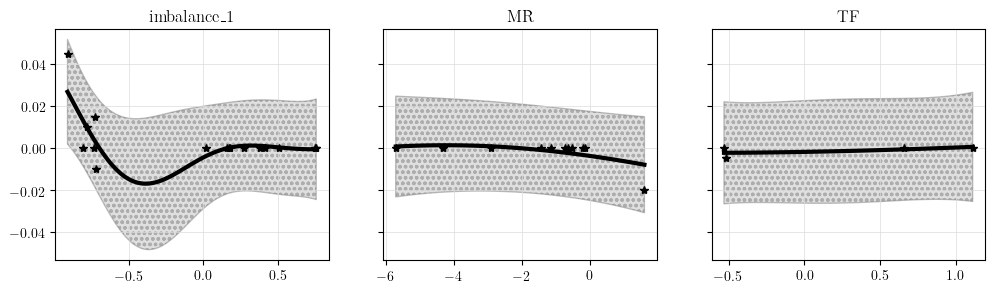

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.0003  Threshold: 0.002
Average performance GP1: tensor(0.0006, dtype=torch.float64)
Average performance GP2: tensor(0.0079, dtype=torch.float64)


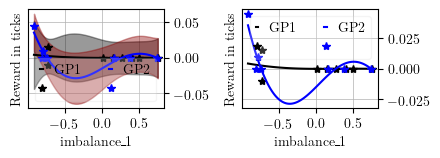

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


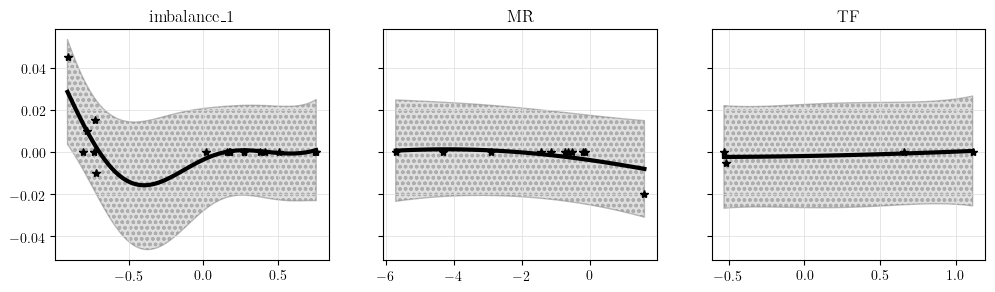

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.0002  Threshold: 0.002
Average performance GP1: tensor(-0.0013, dtype=torch.float64)
Average performance GP2: tensor(0.0100, dtype=torch.float64)


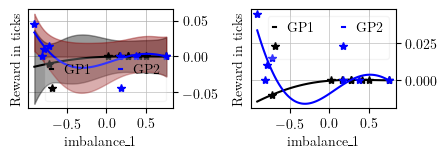

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


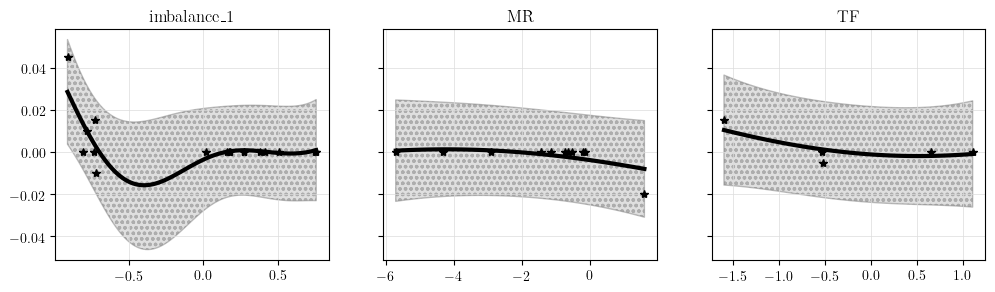

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


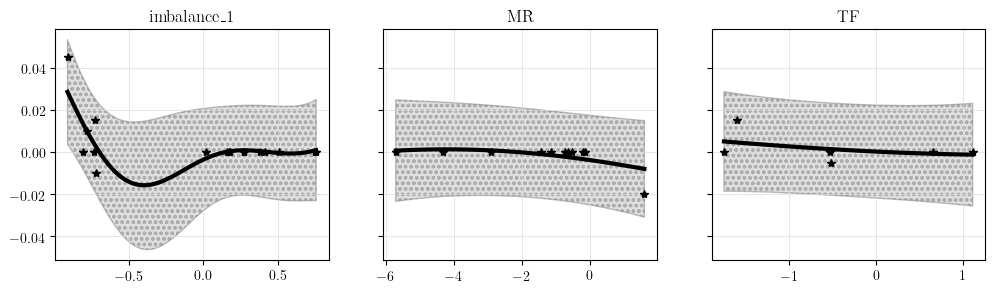

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


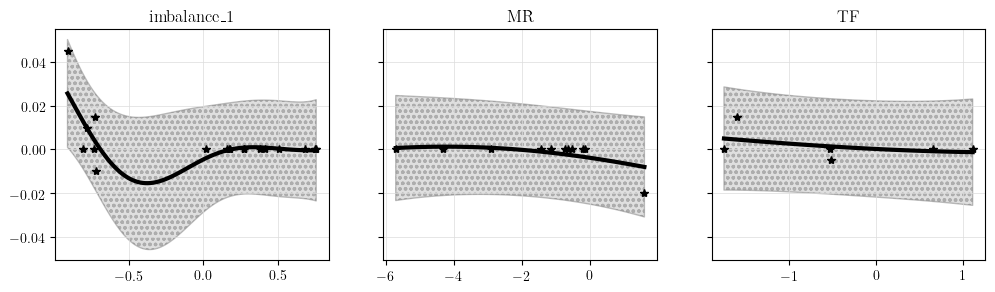

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00024  Threshold: 0.002
Average performance GP1: tensor(-0.0013, dtype=torch.float64)
Average performance GP2: tensor(0.0100, dtype=torch.float64)


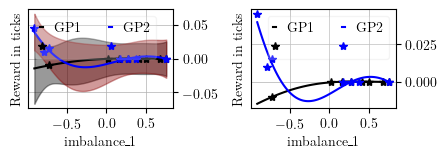

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


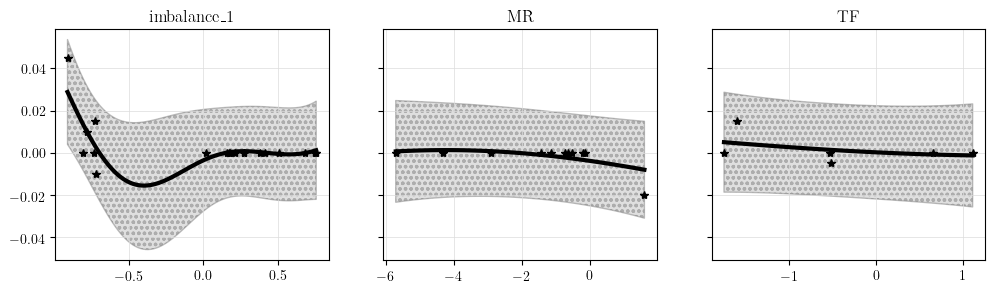

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00334  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(0.0021, dtype=torch.float64)


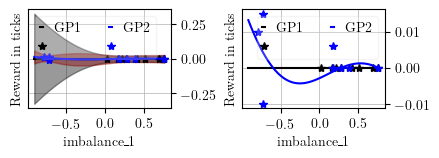

I am storing the change point test results for  imbalance_1
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


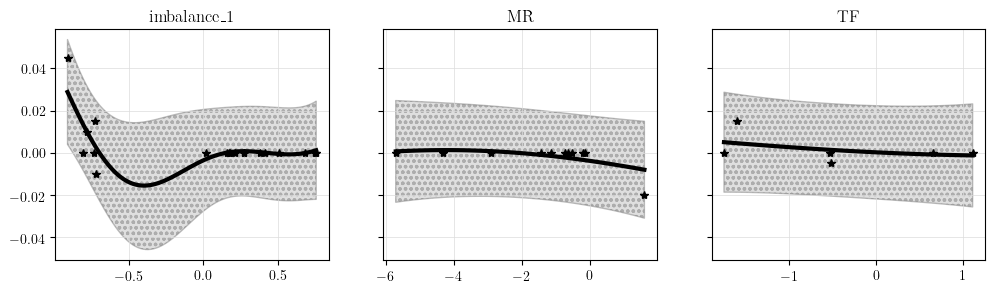

Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


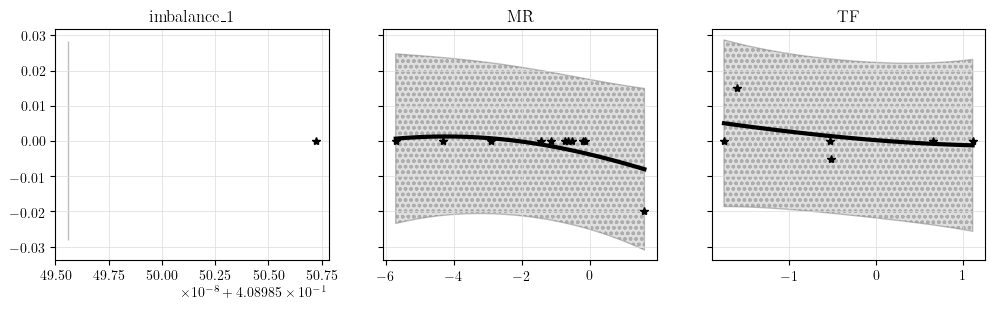

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


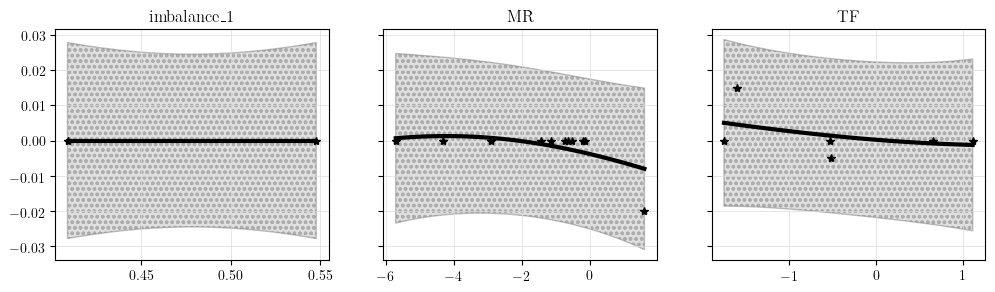

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


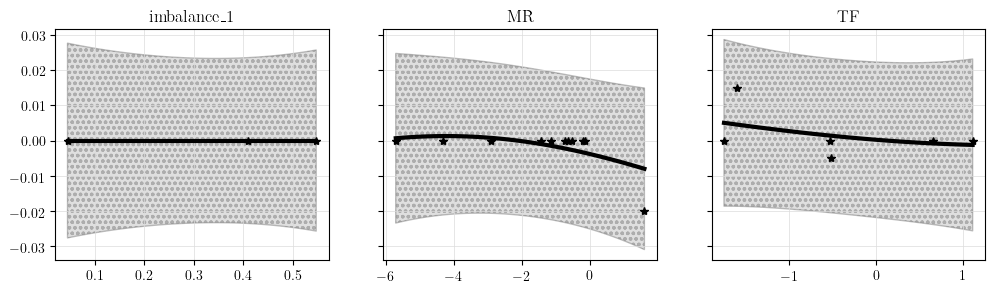

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


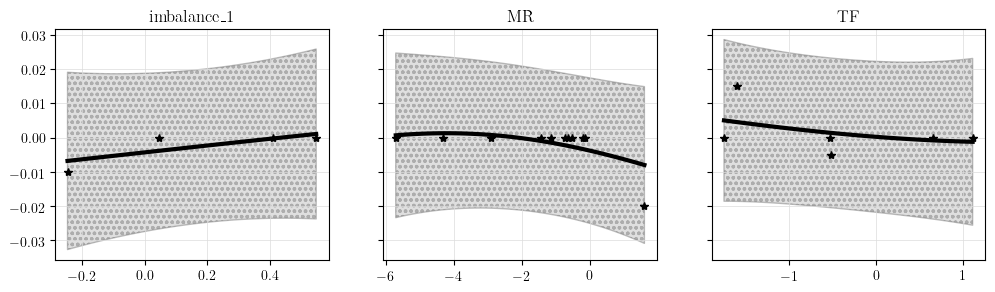

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


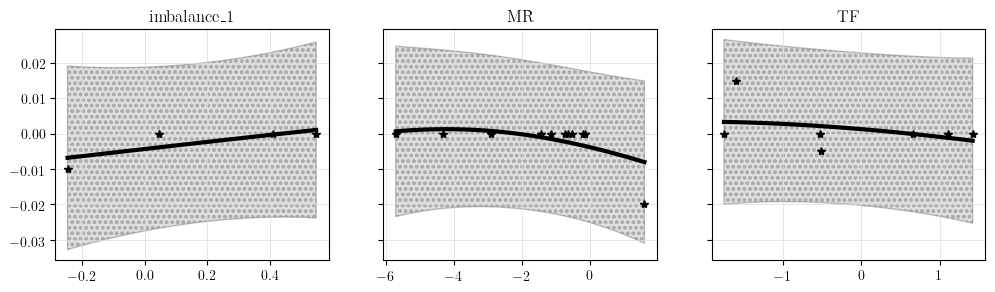

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


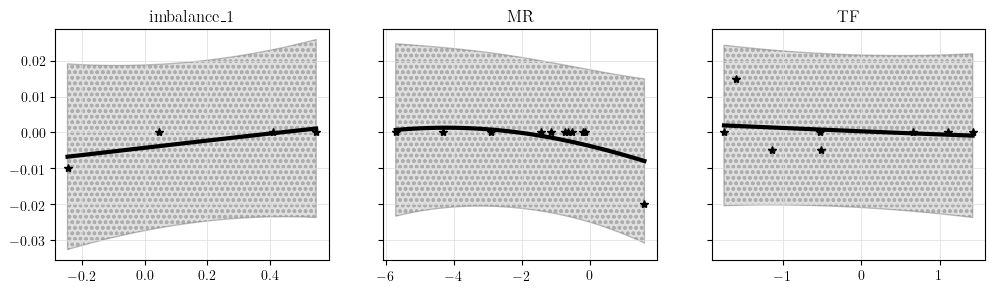

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


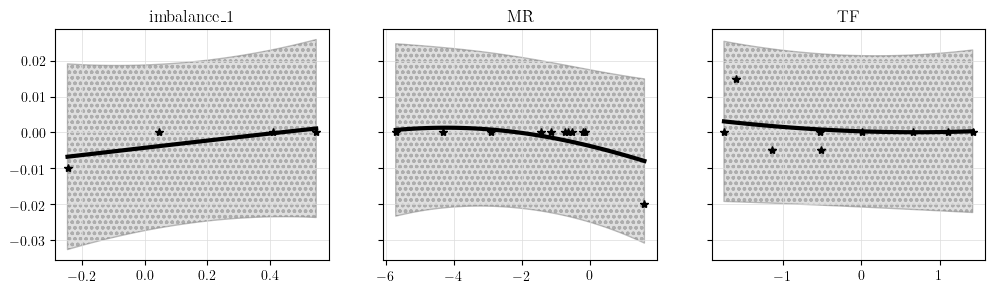

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


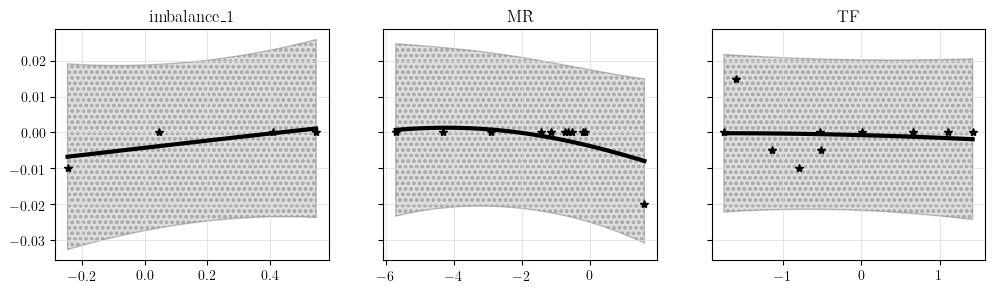

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


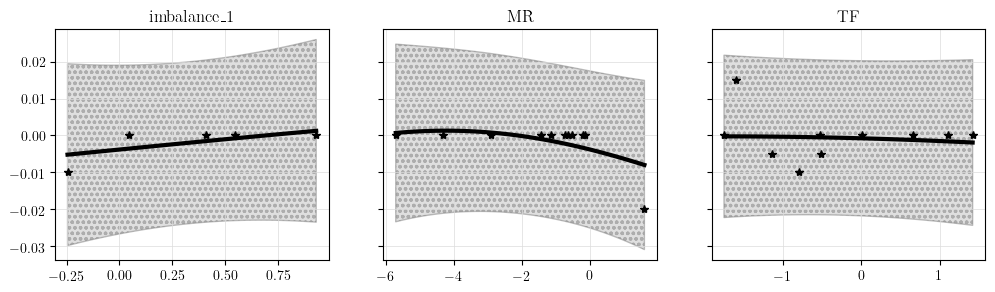

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


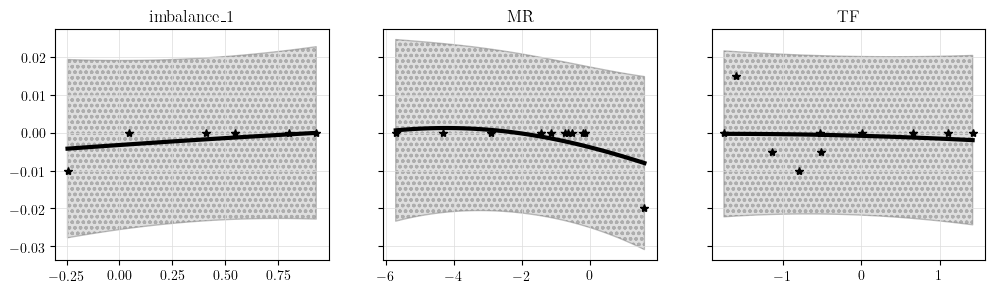

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


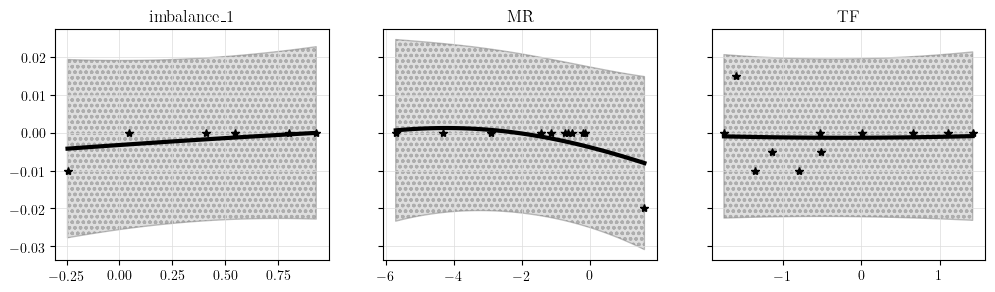

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


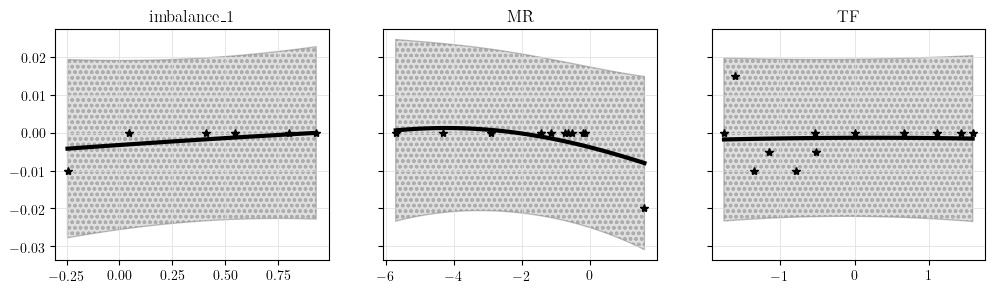

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


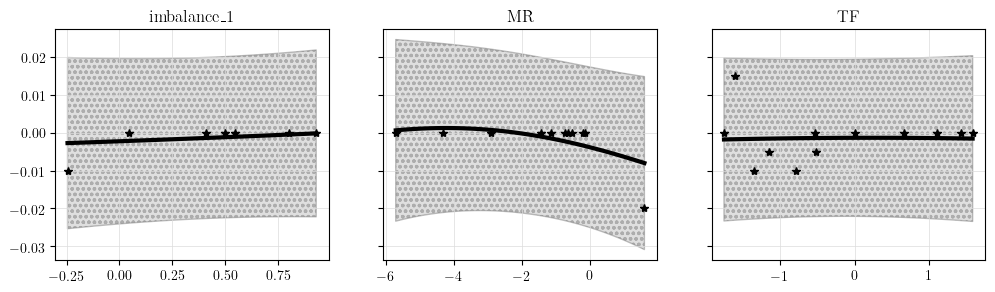

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


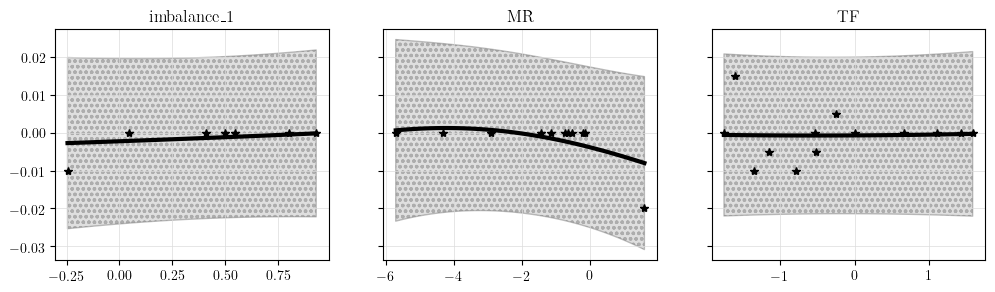

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


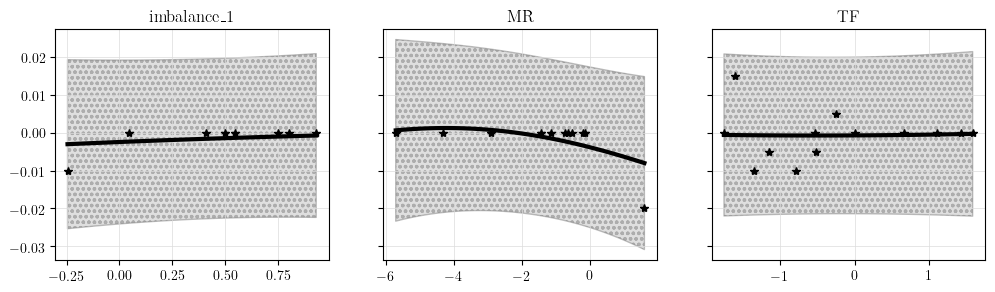

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


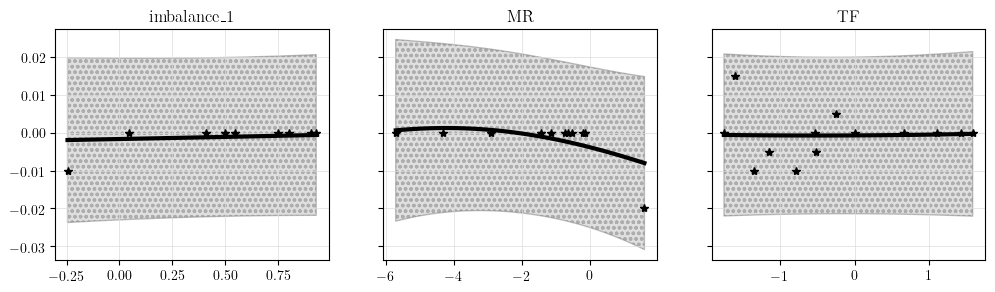

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


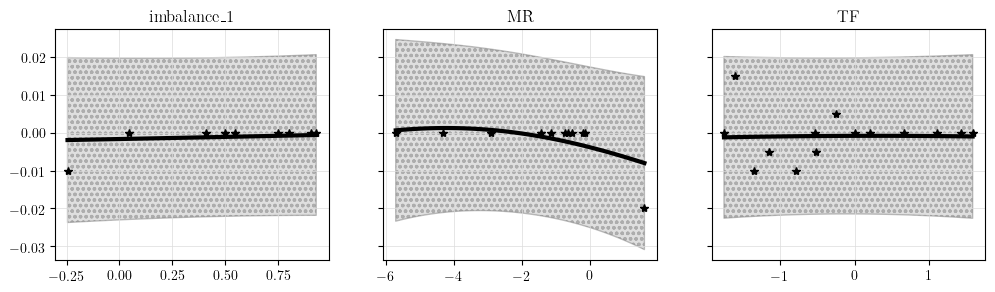

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


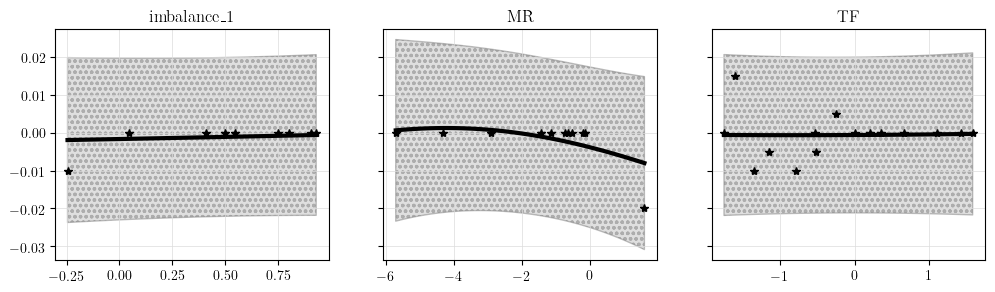

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


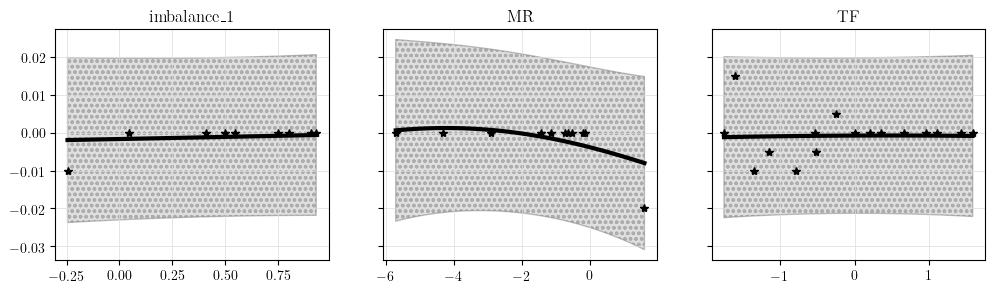

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.00012  Threshold: 0.002
Average performance GP1: tensor(-0.0019, dtype=torch.float64)
Average performance GP2: tensor(0.0007, dtype=torch.float64)


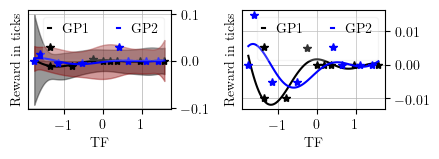

I am storing the change point test results for  TF
Selected strategy: TF
I am deleting the change point results of  TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


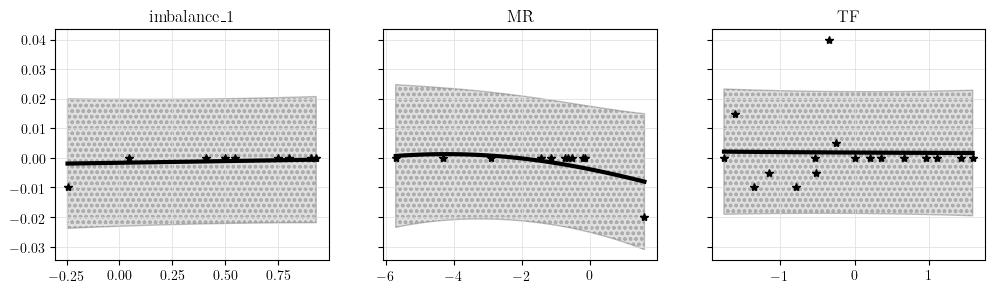

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.00021  Threshold: 0.002
Average performance GP1: tensor(0.0031, dtype=torch.float64)
Average performance GP2: tensor(0.0014, dtype=torch.float64)


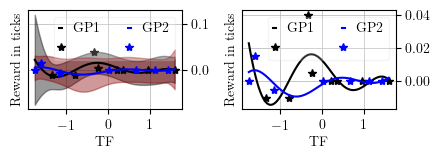

I am storing the change point test results for  TF
Selected strategy: TF
I am deleting the change point results of  TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


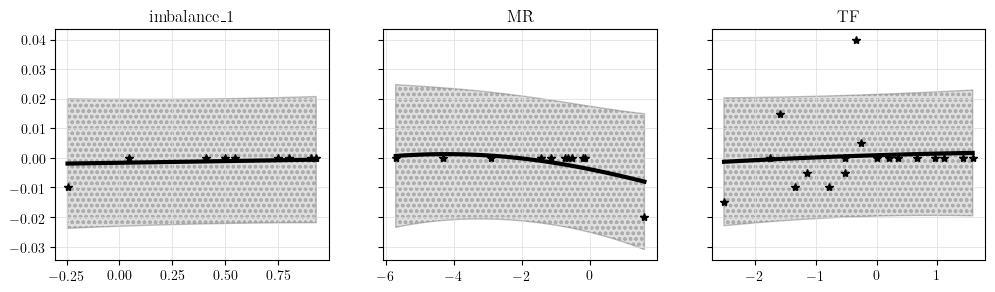

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.00112  Threshold: 0.002
Average performance GP1: tensor(0.0025, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


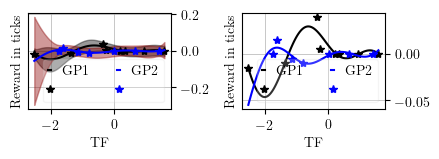

I am storing the change point test results for  TF
Selected strategy: TF
I am deleting the change point results of  TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


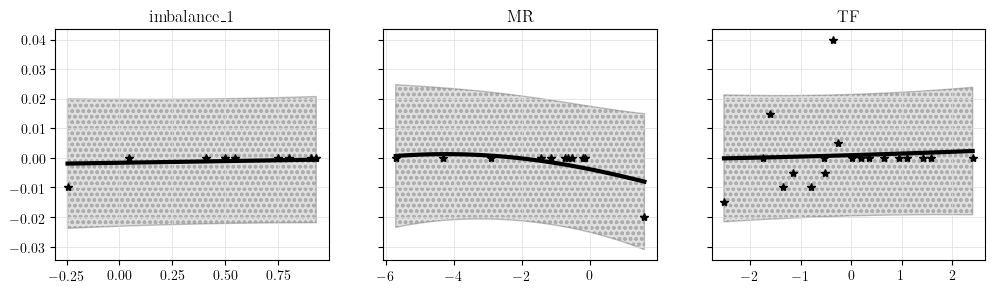

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.01072  Threshold: 0.002
Average performance GP1: tensor(0.0038, dtype=torch.float64)
Average performance GP2: tensor(-0.0014, dtype=torch.float64)


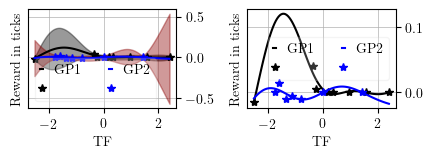

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


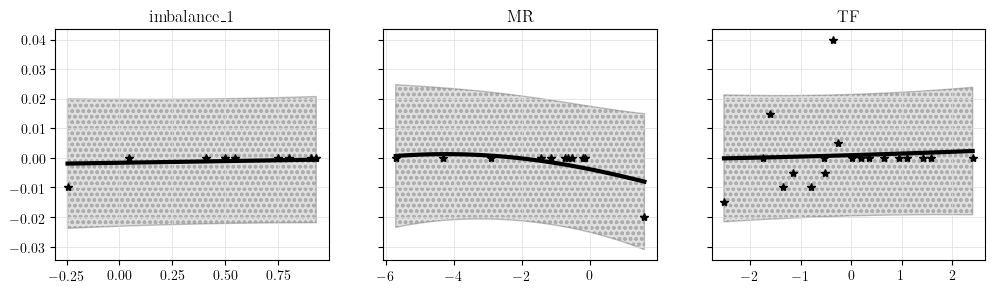

Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


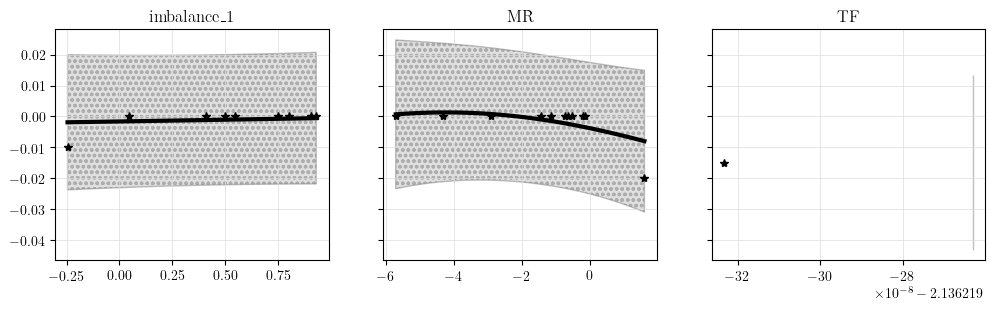

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


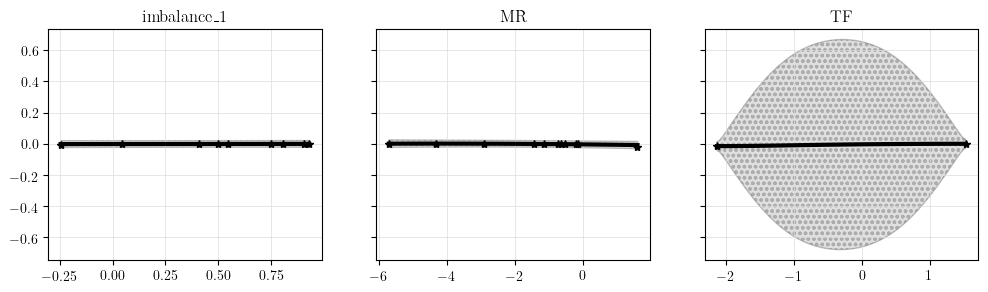

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


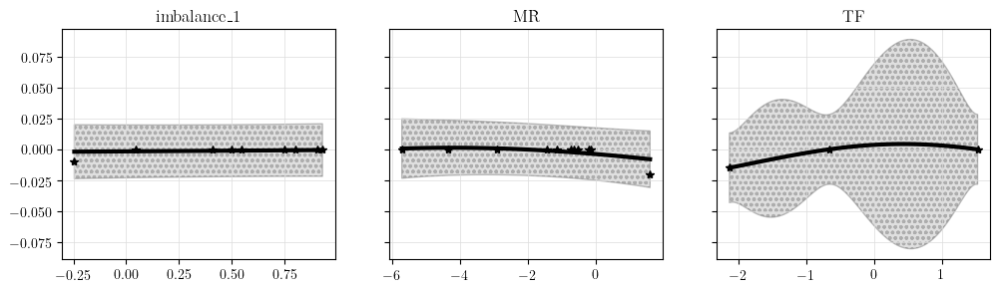

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


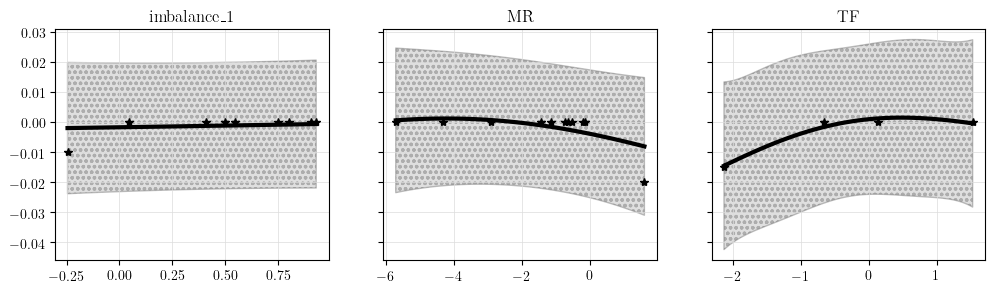

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


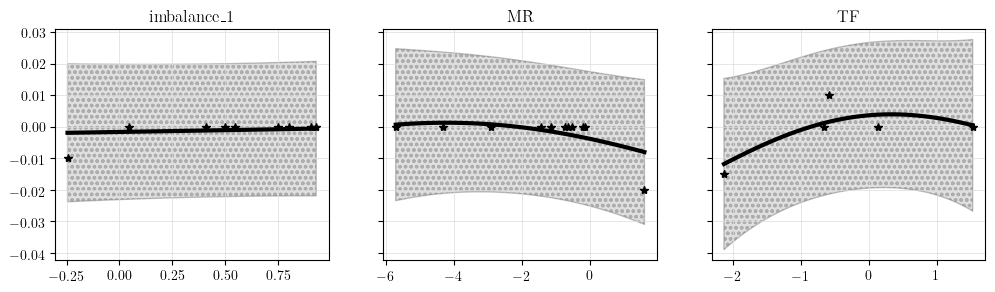

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


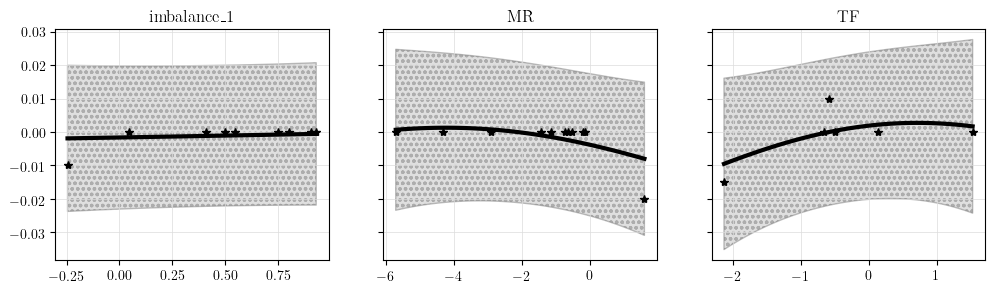

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


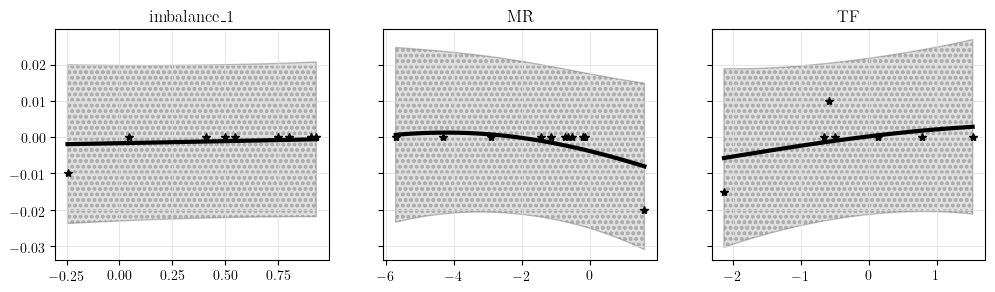

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


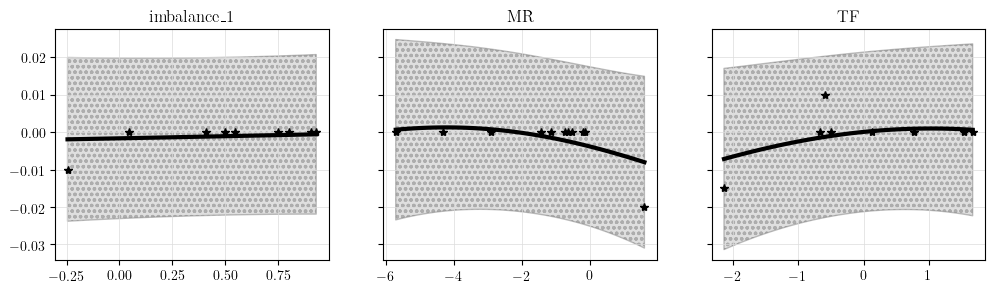

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


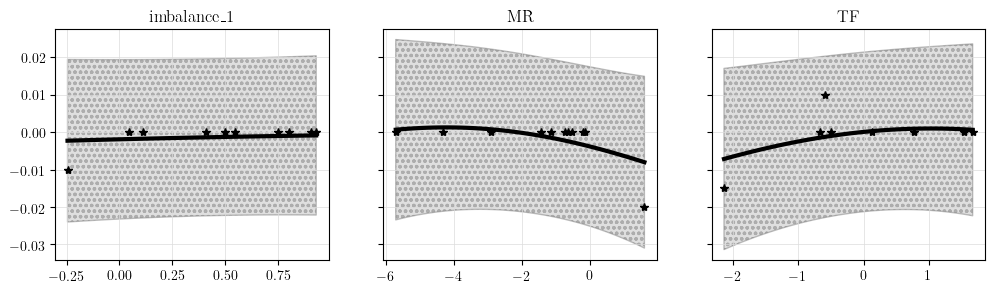

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


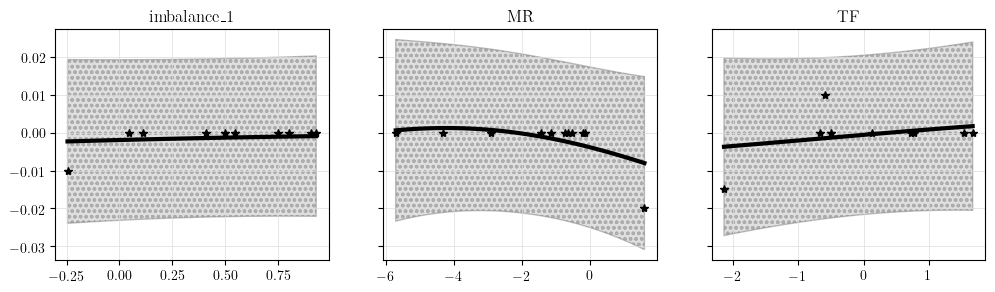

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


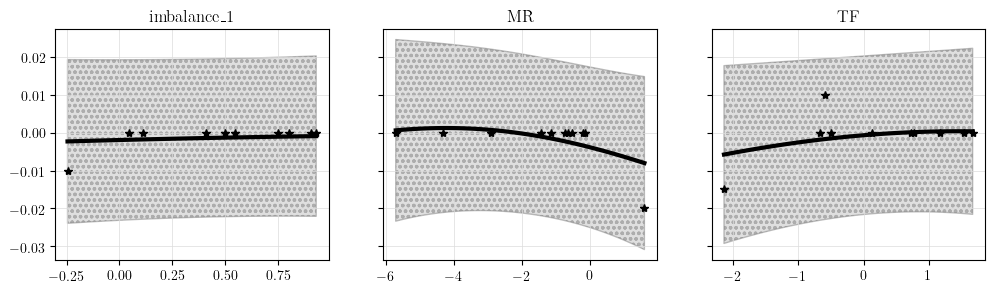

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


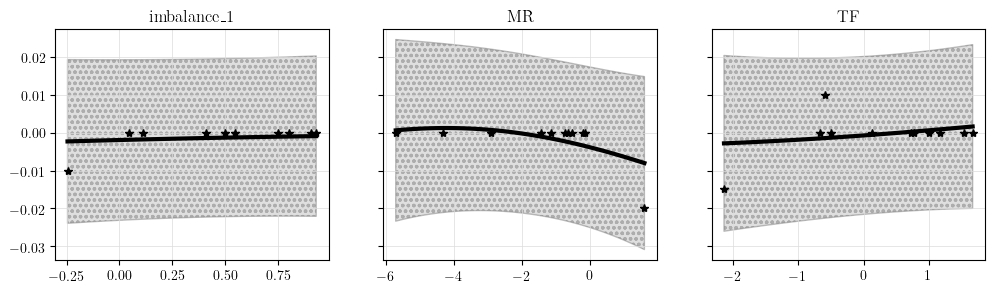

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


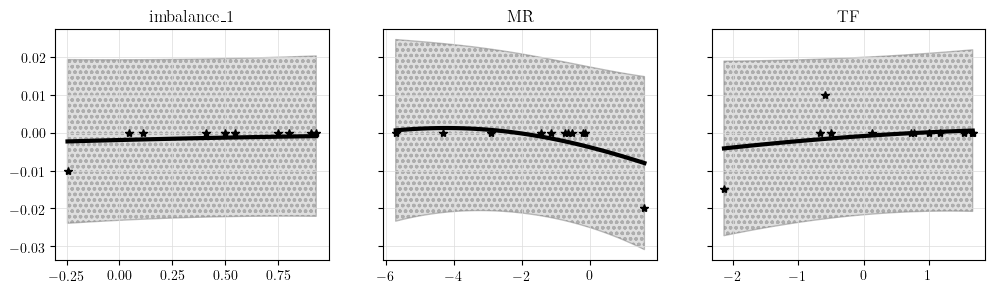

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


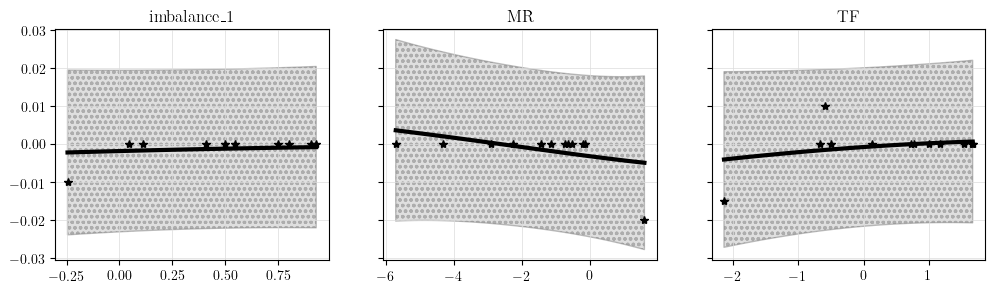

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


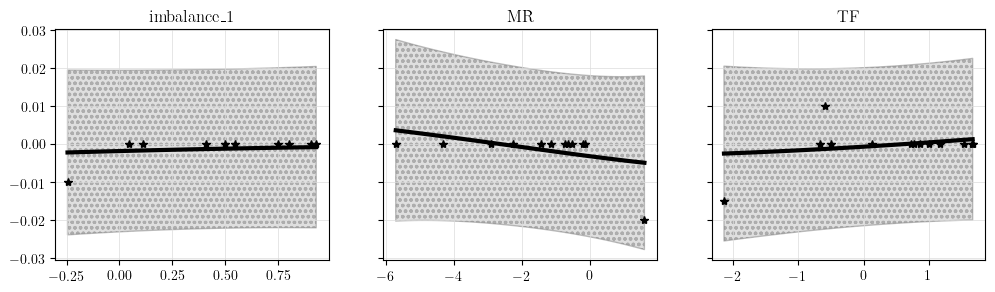

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


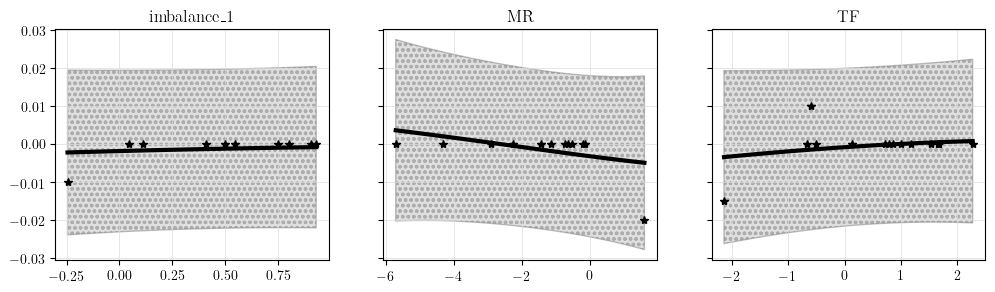

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


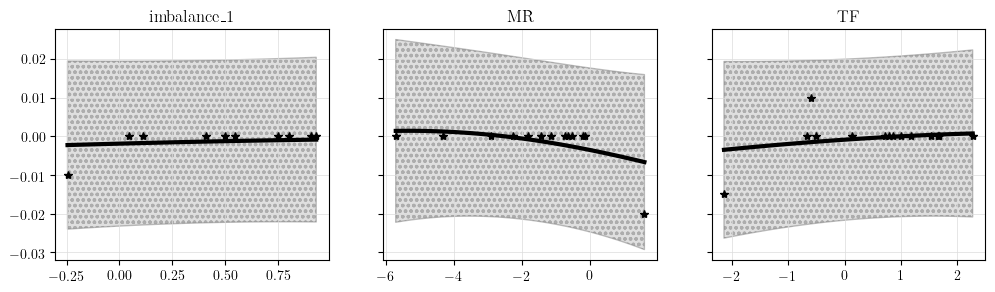

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


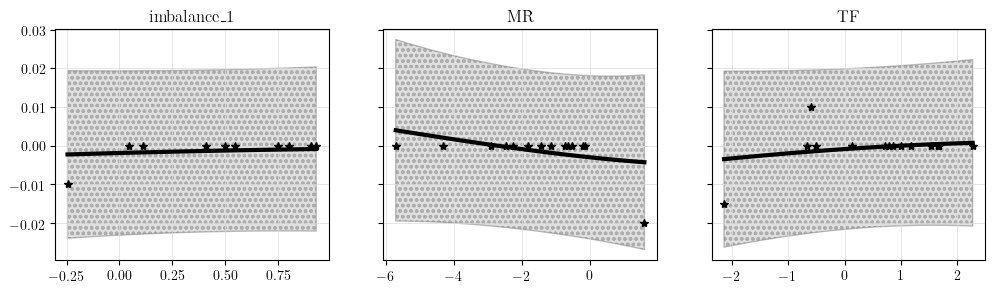

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


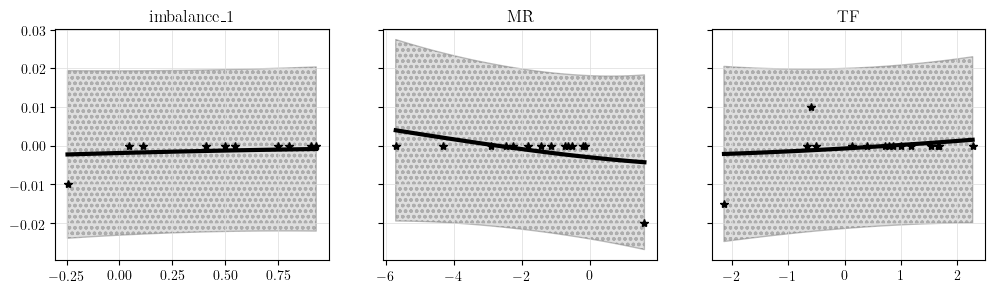

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


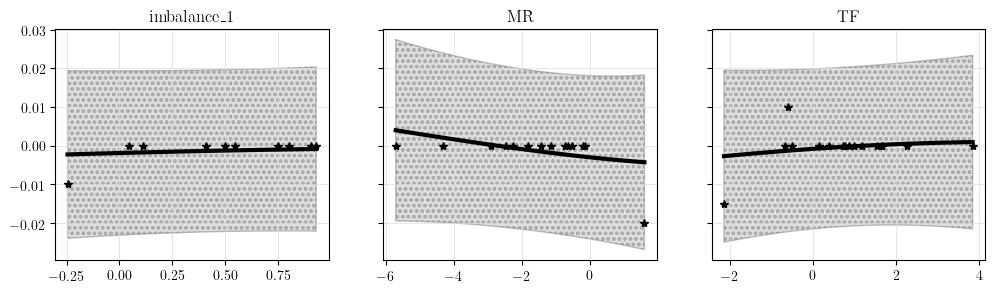

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.03845  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(0.0014, dtype=torch.float64)


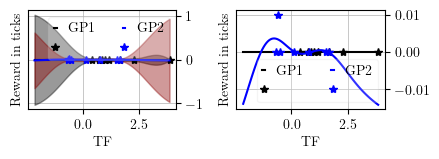

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


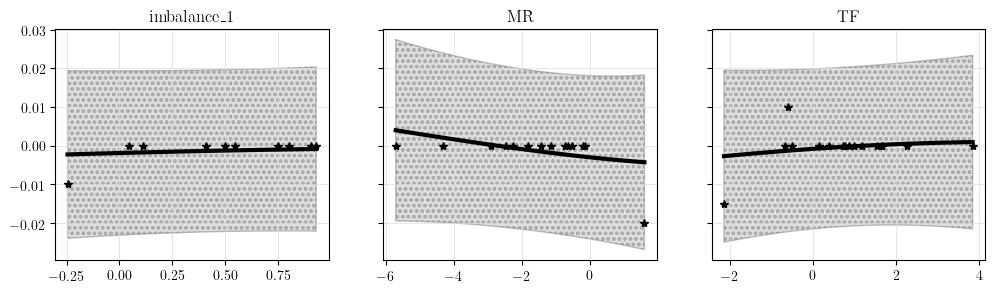

Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


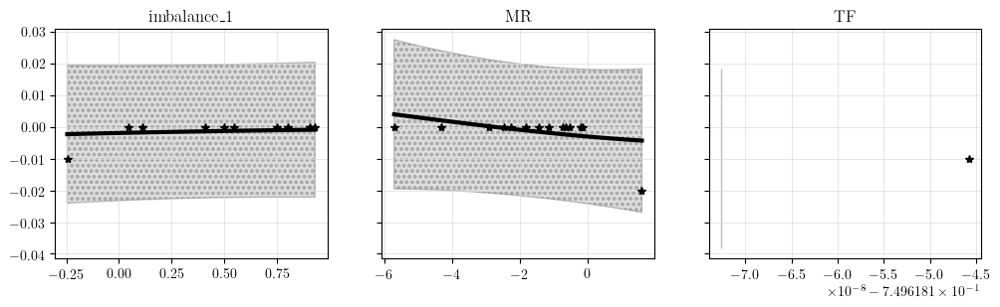

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


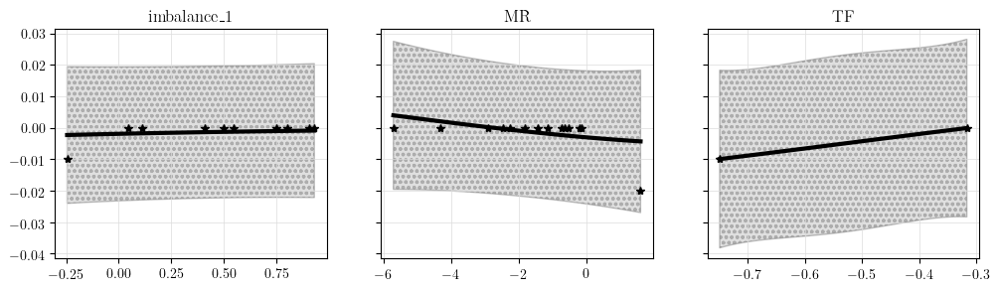

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


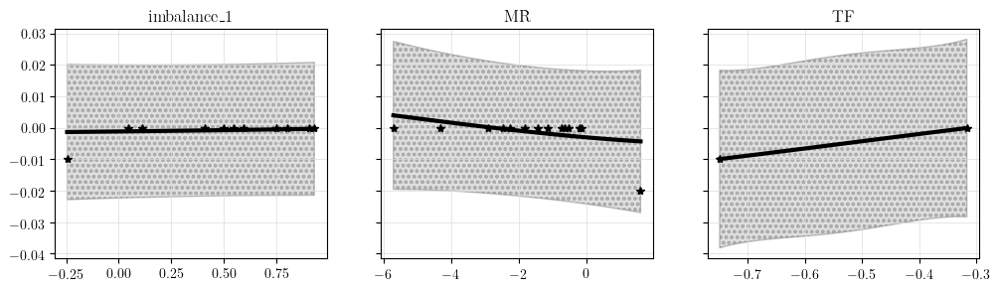

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


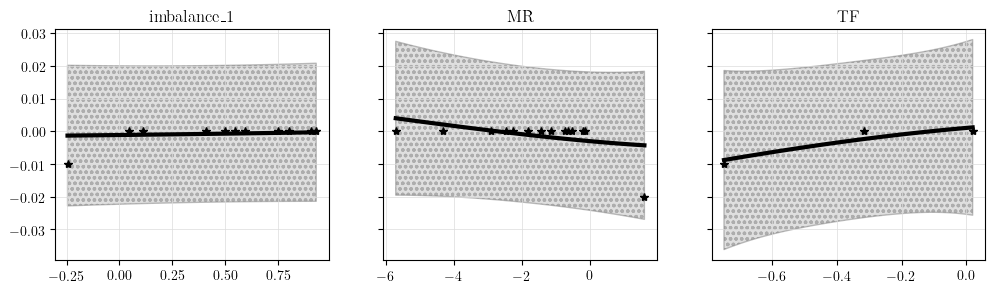

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


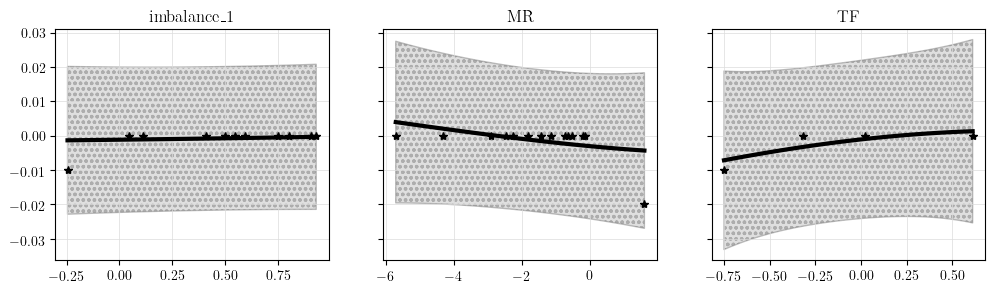

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


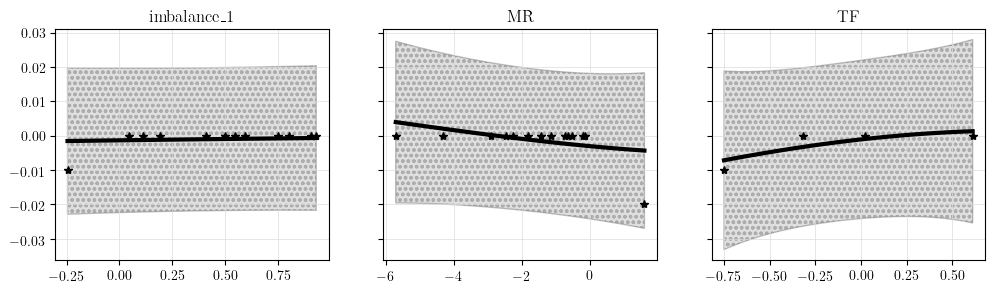

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


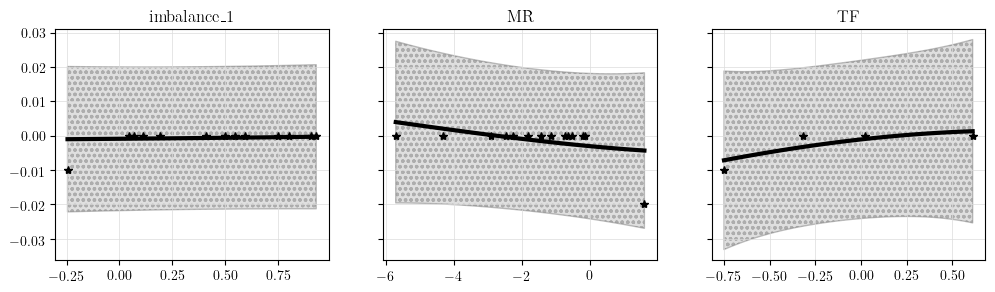

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


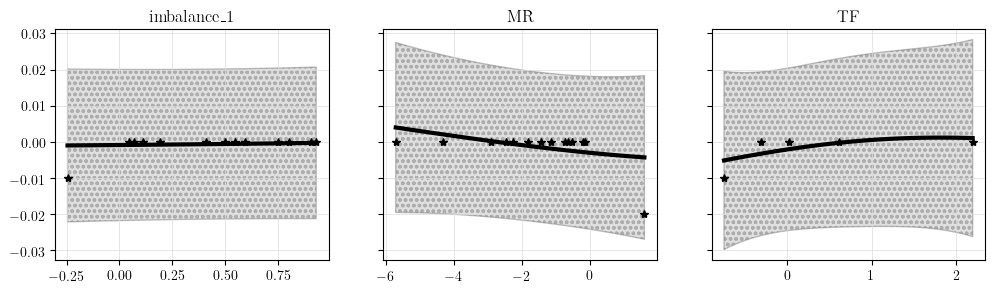

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


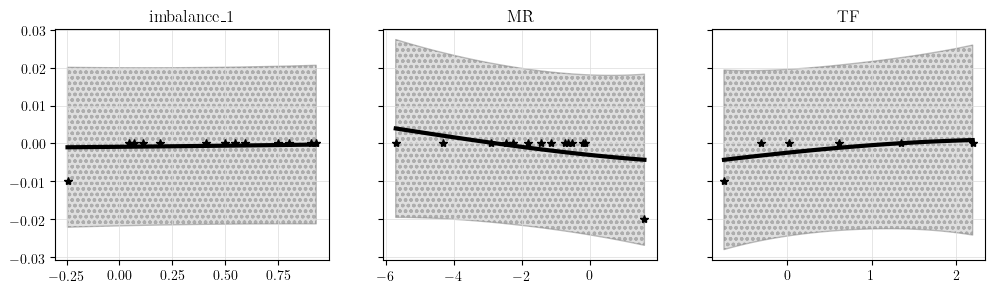

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


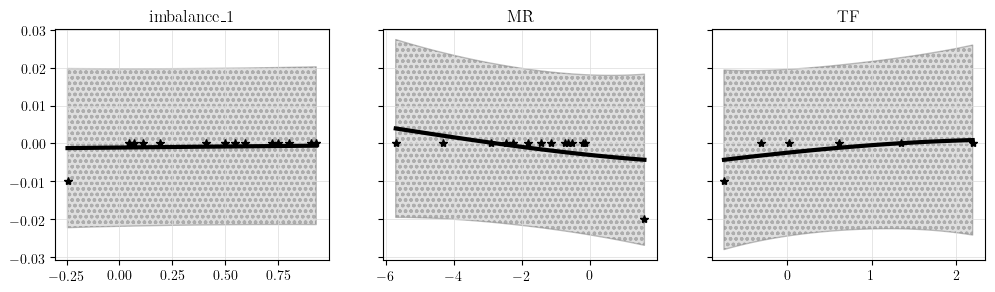

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


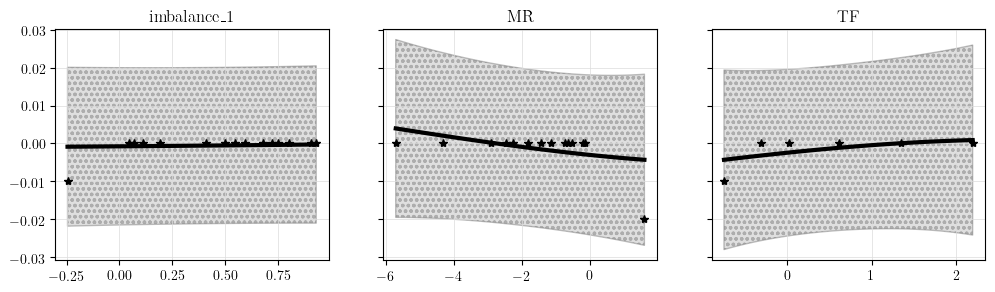

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


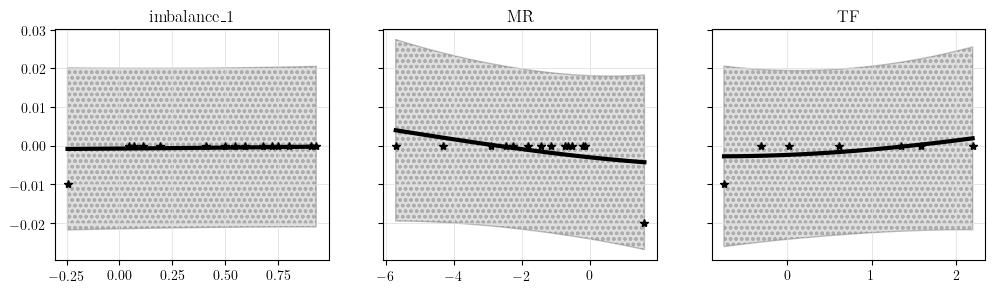

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


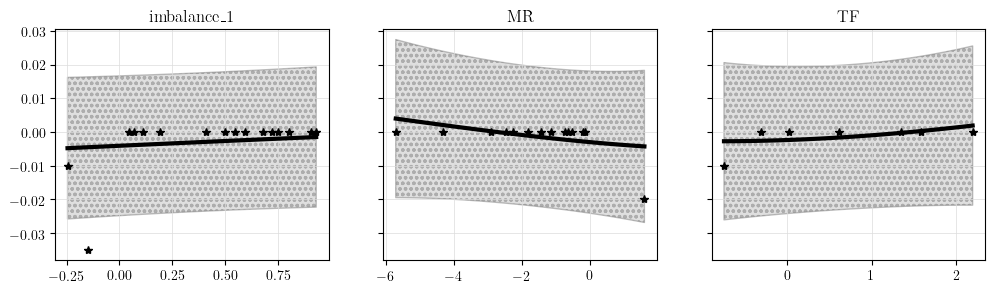

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00013  Threshold: 0.002
Average performance GP1: tensor(-0.0044, dtype=torch.float64)
Average performance GP2: tensor(-0.0014, dtype=torch.float64)


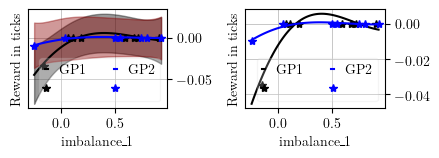

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


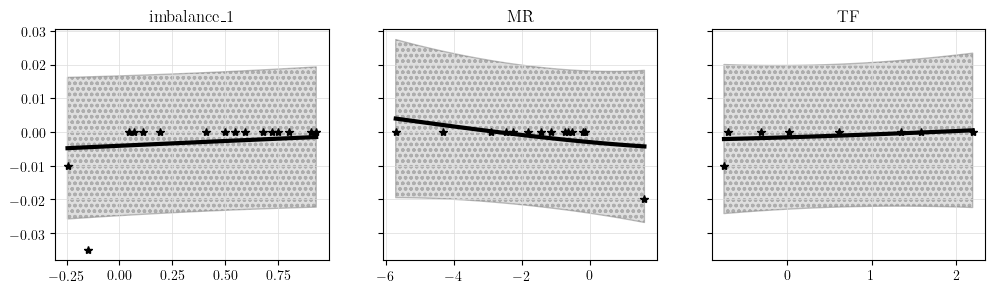

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


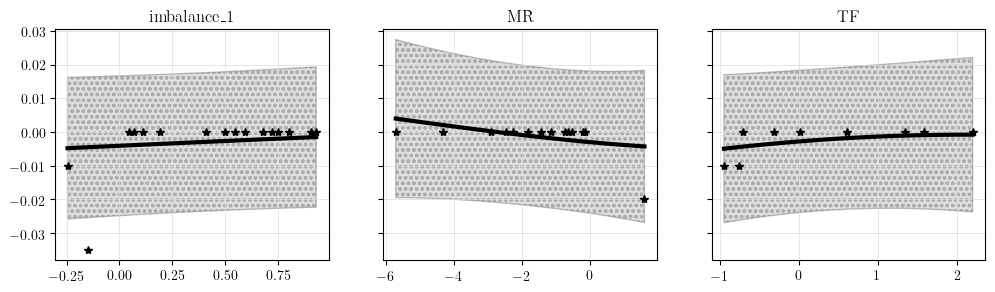

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


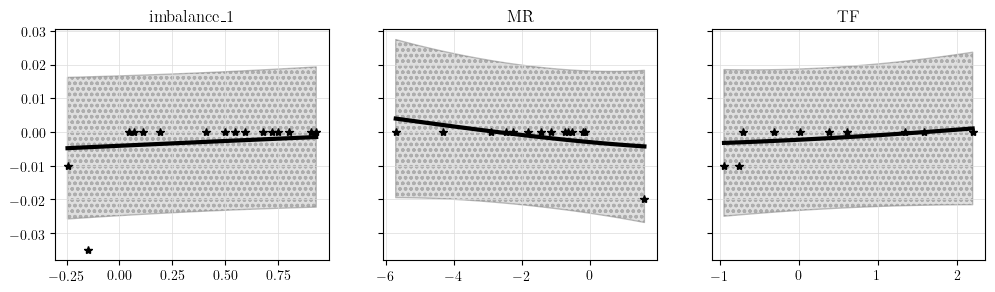

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


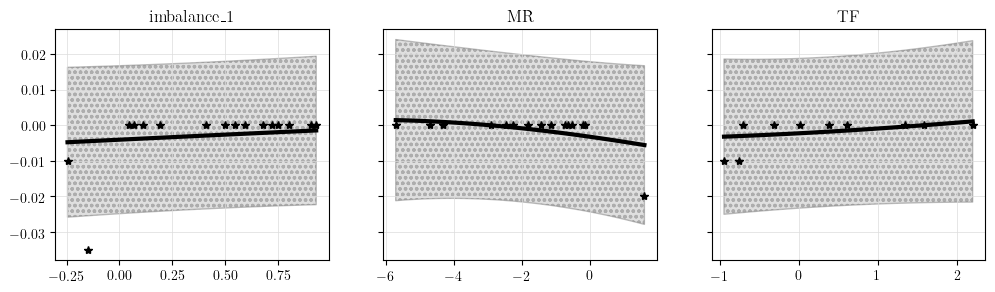

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


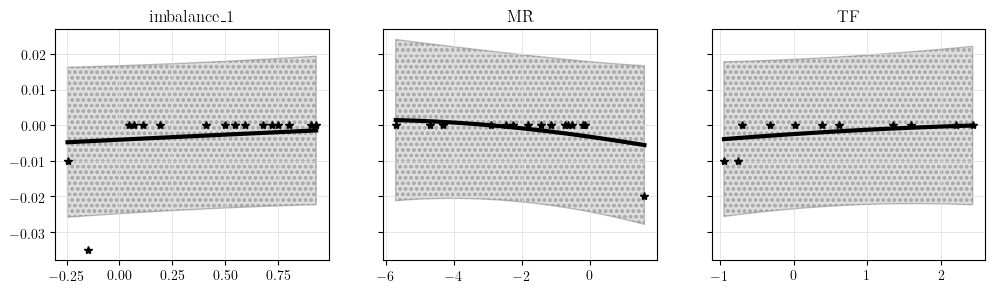

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


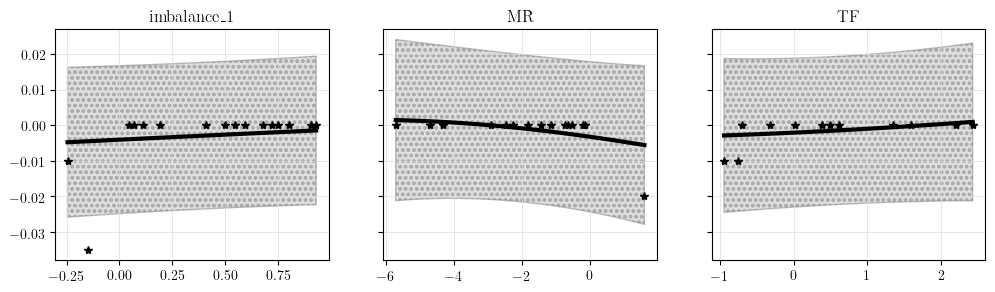

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


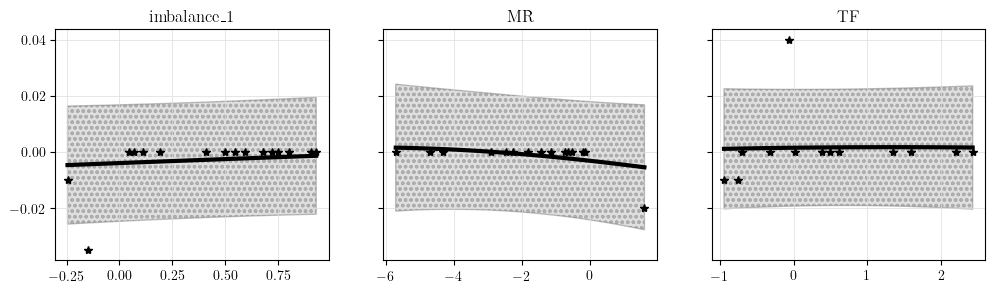

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


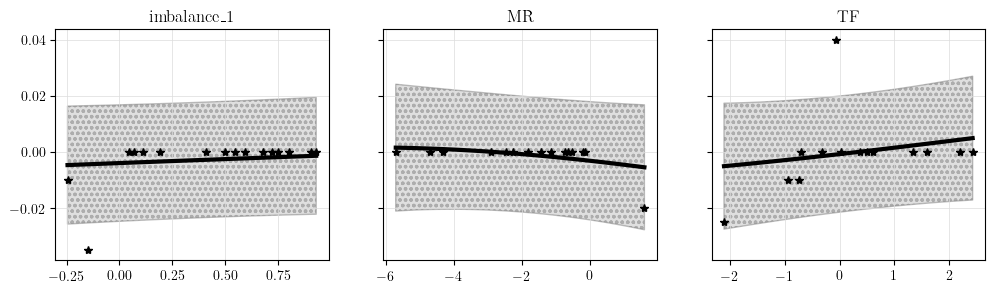

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


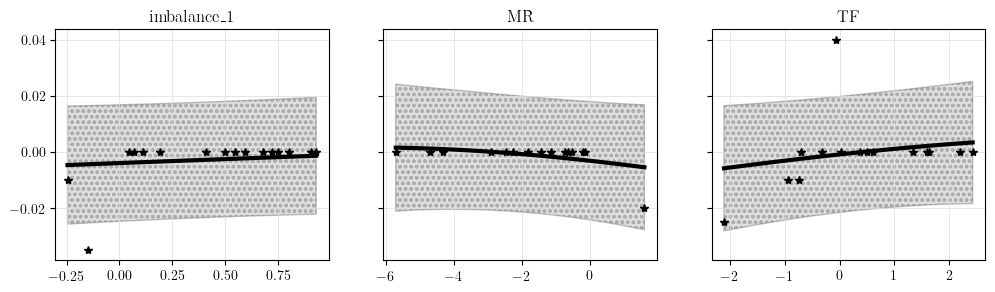

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


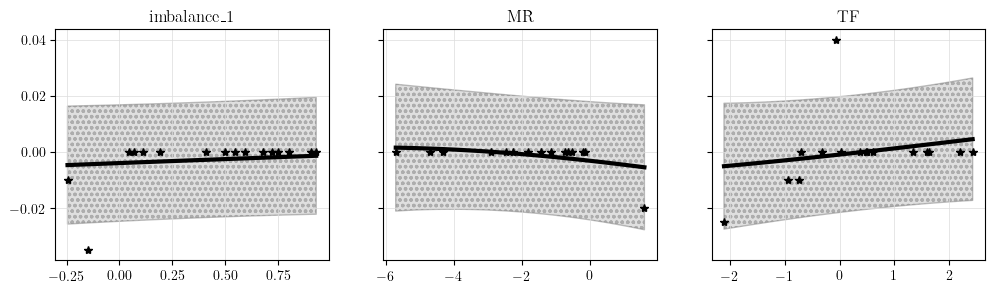

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.0065  Threshold: 0.002
Average performance GP1: tensor(0.0006, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


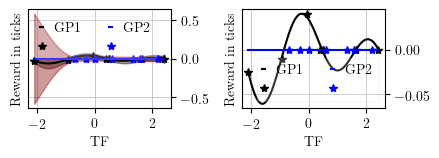

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


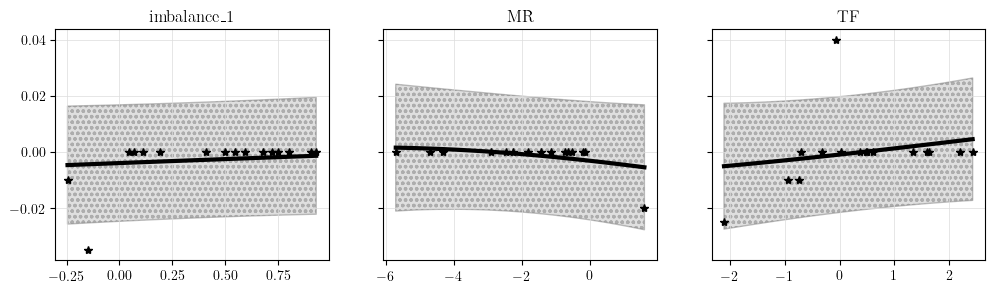

Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


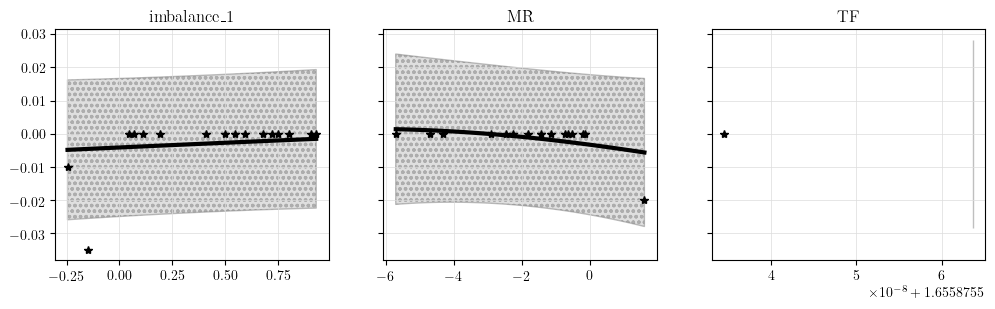

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


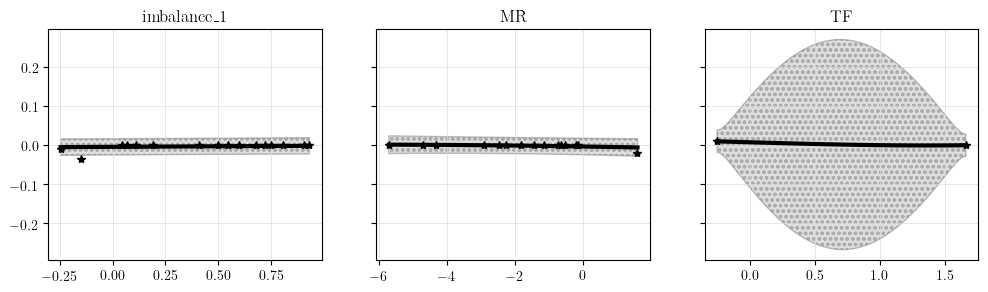

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


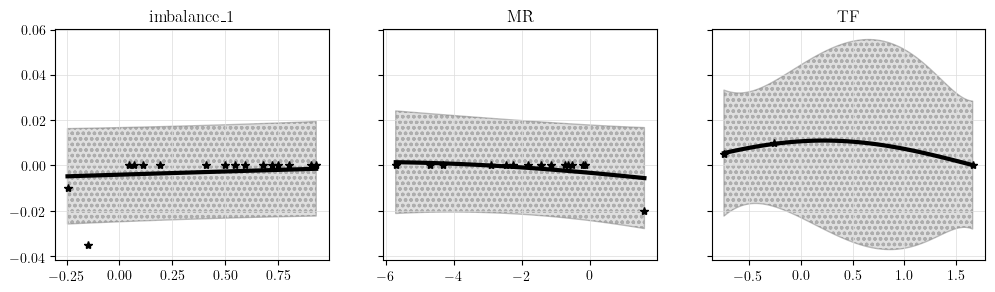

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


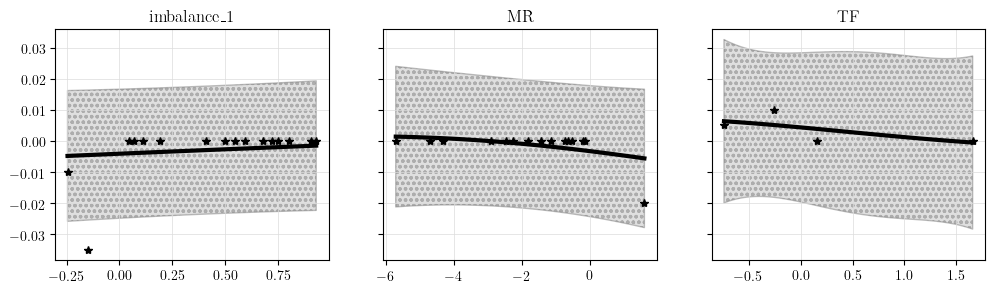

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


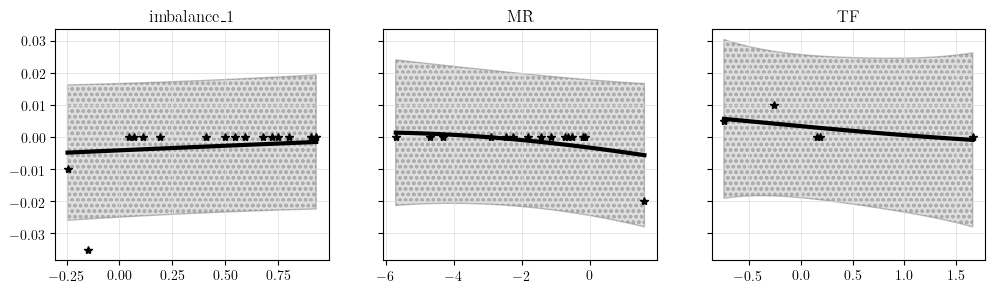

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


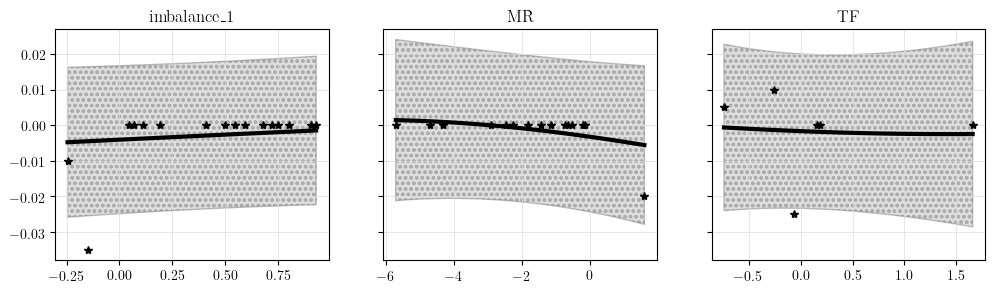

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


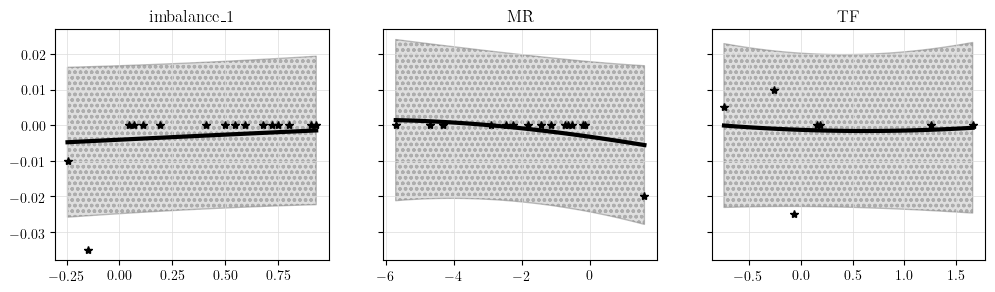

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


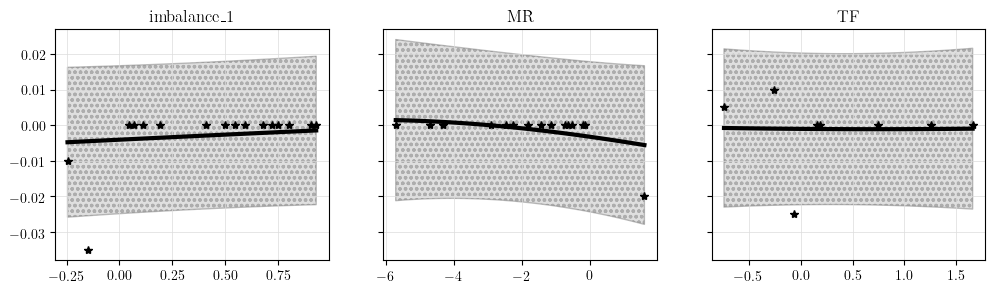

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


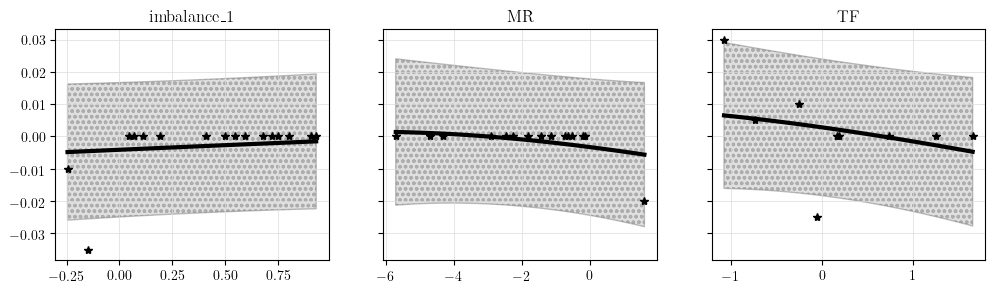

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


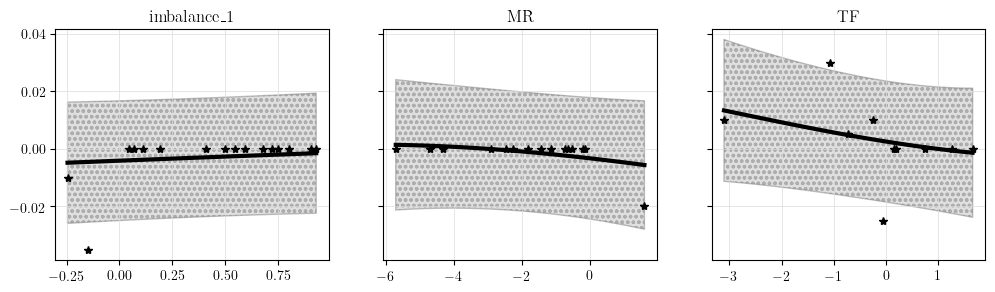

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


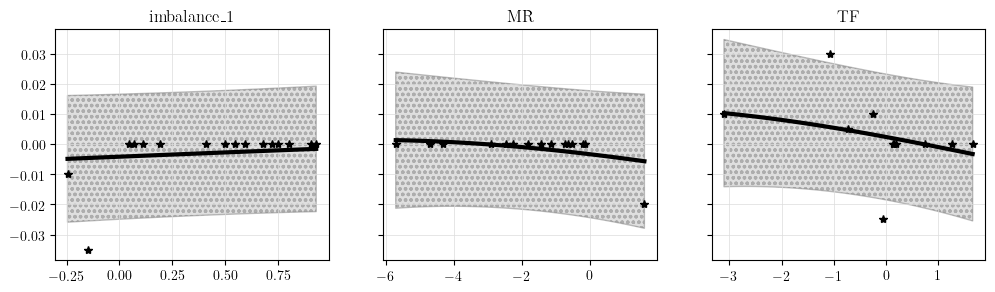

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


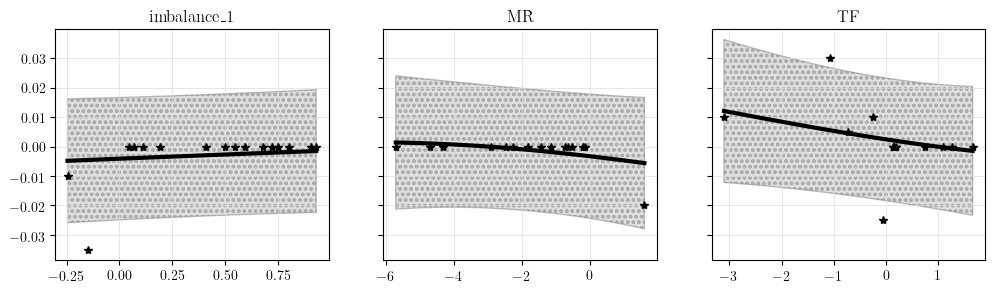

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


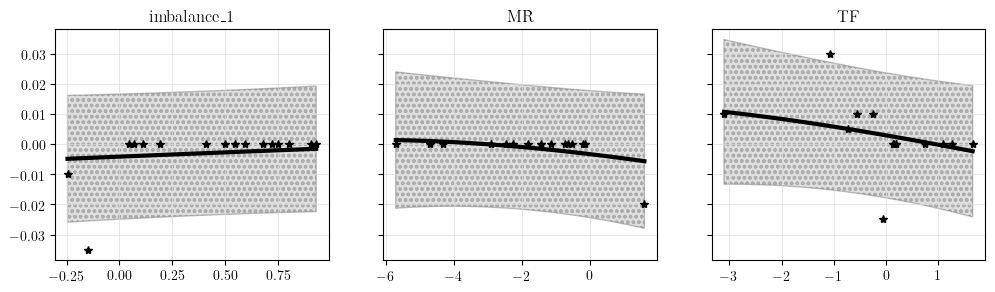

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


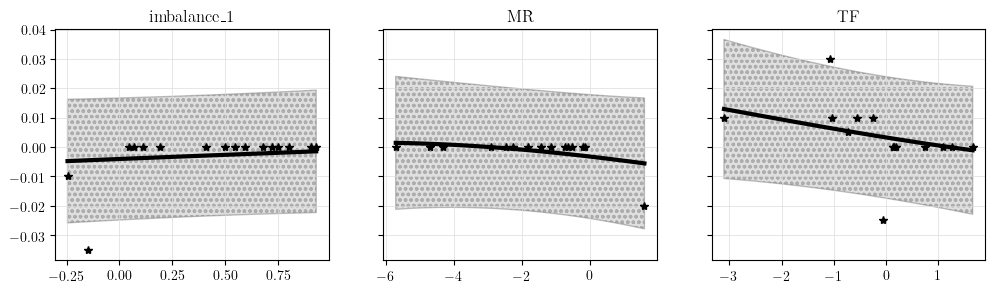

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


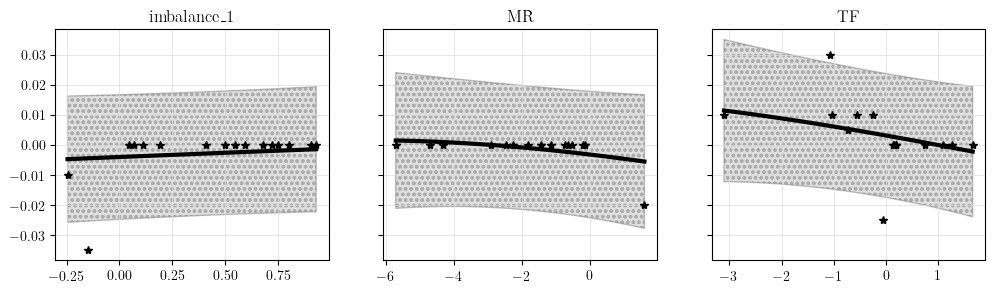

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


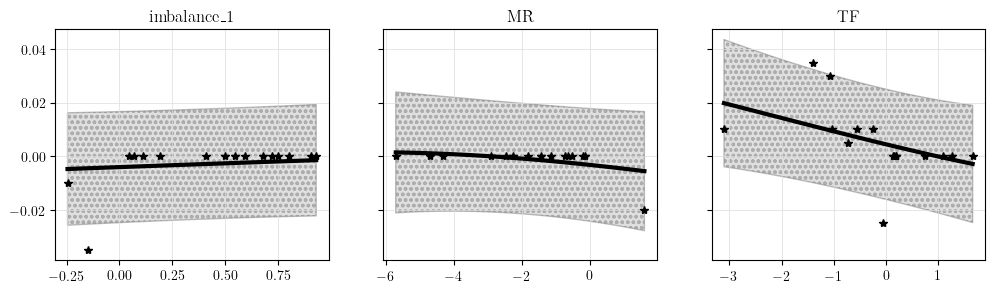

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.03476  Threshold: 0.002
Average performance GP1: tensor(0.0119, dtype=torch.float64)
Average performance GP2: tensor(-0.0014, dtype=torch.float64)


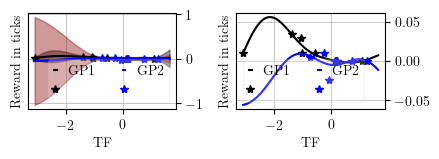

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


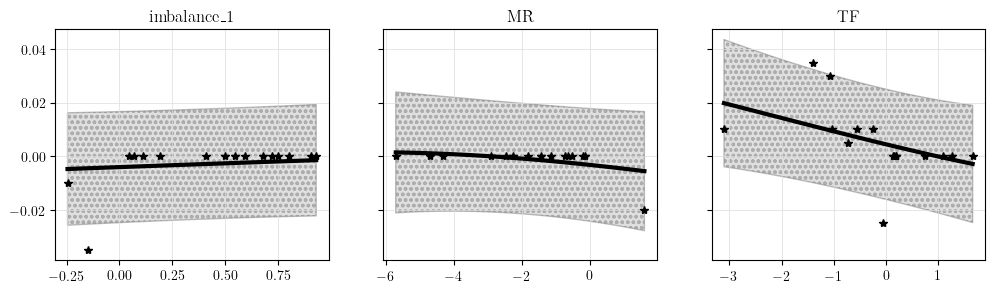

Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


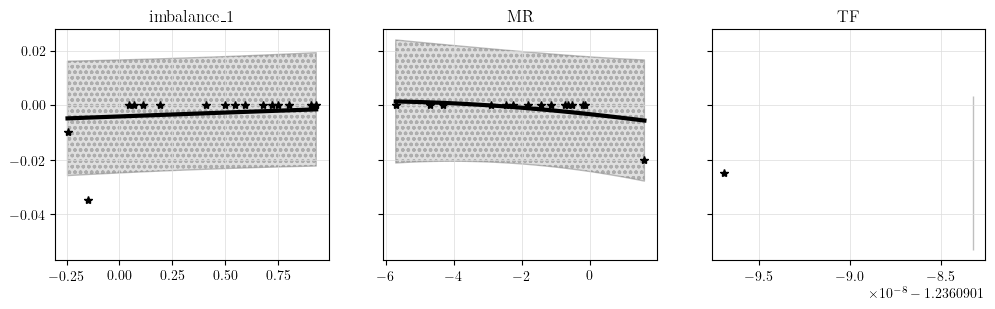

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


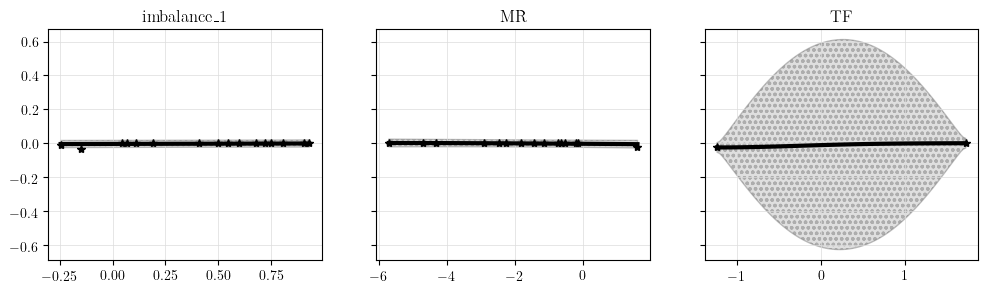

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


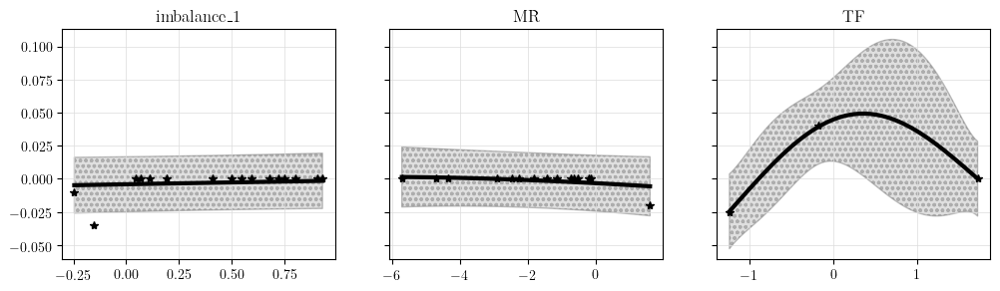

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


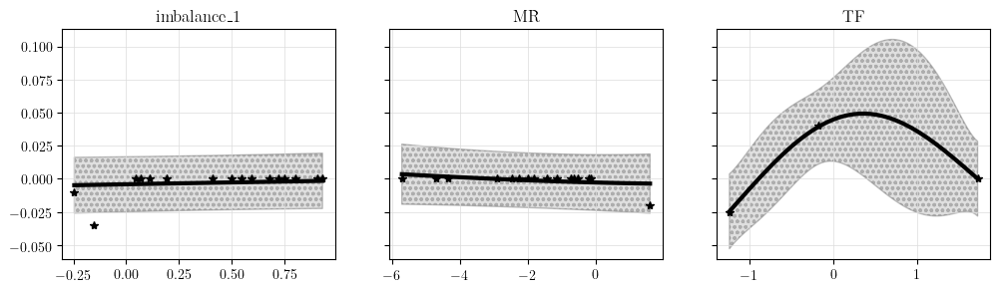

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.05209  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(-0.0029, dtype=torch.float64)


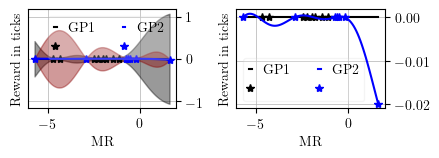

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


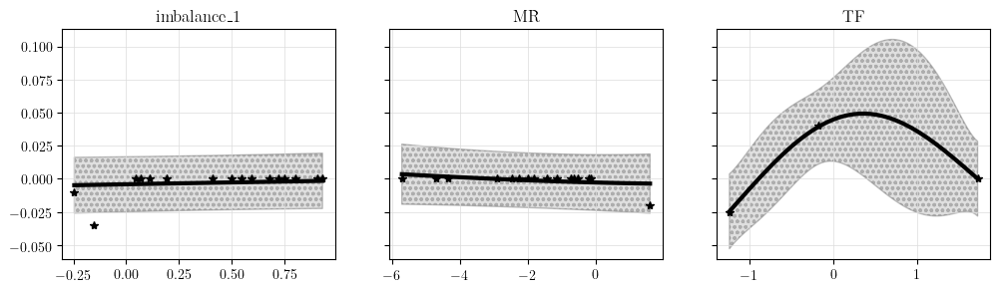

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


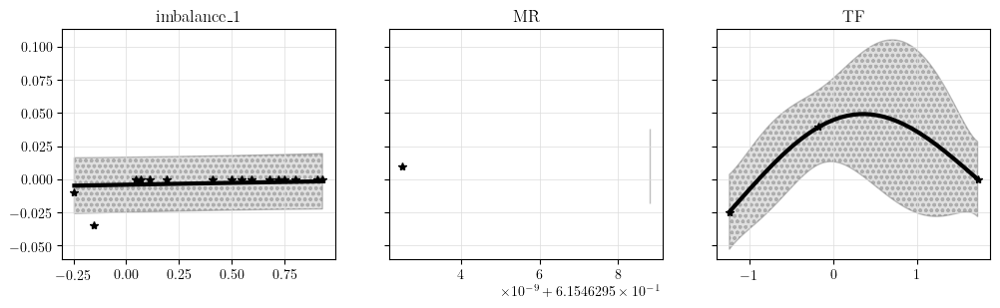

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


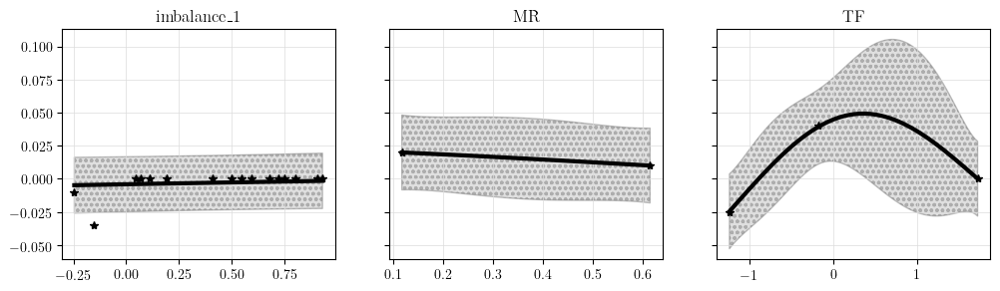

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


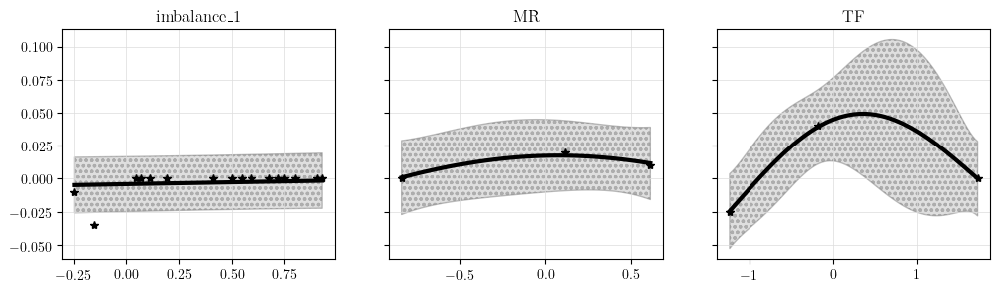

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


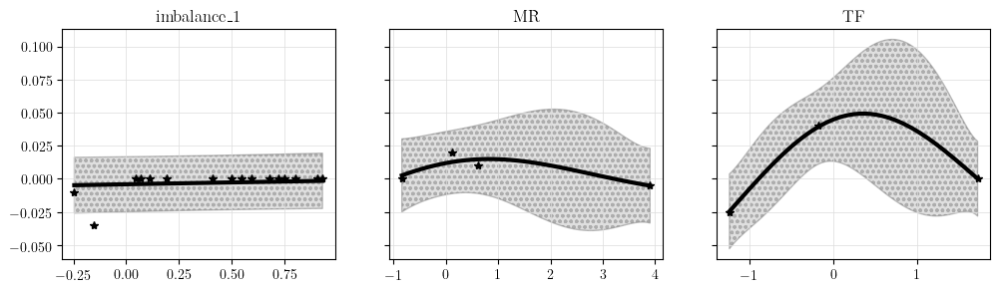

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


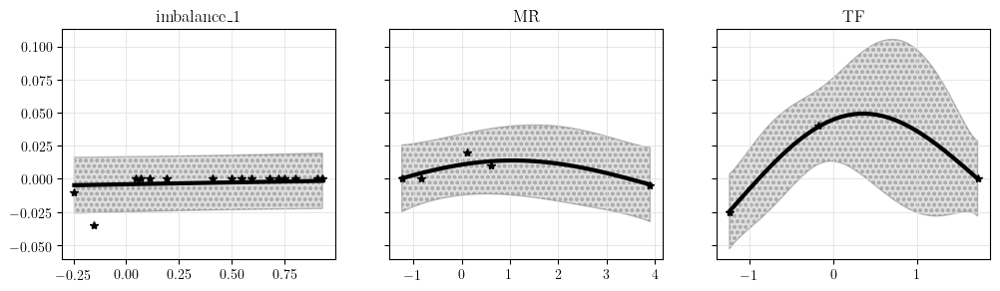

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


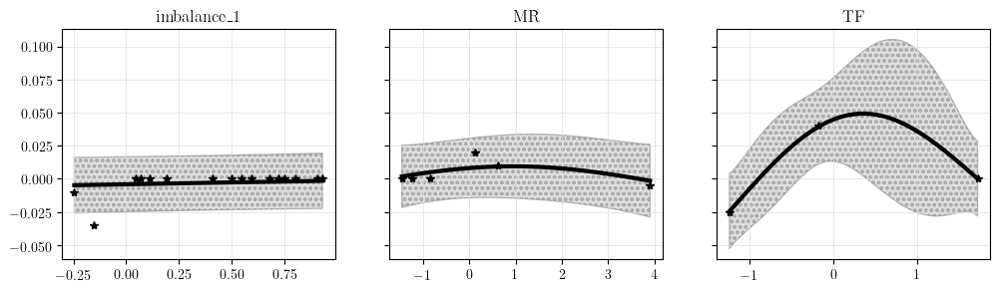

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


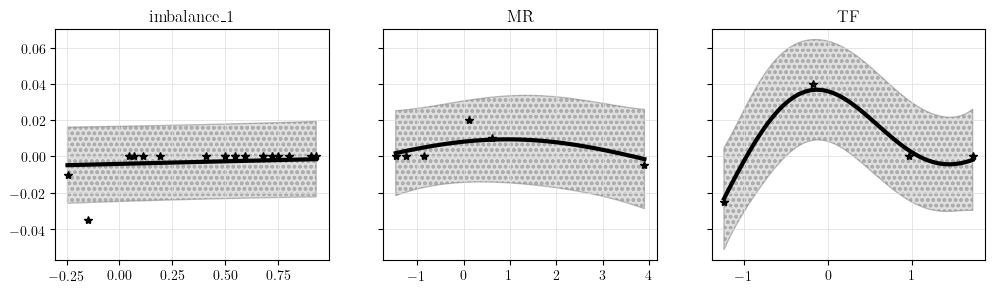

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


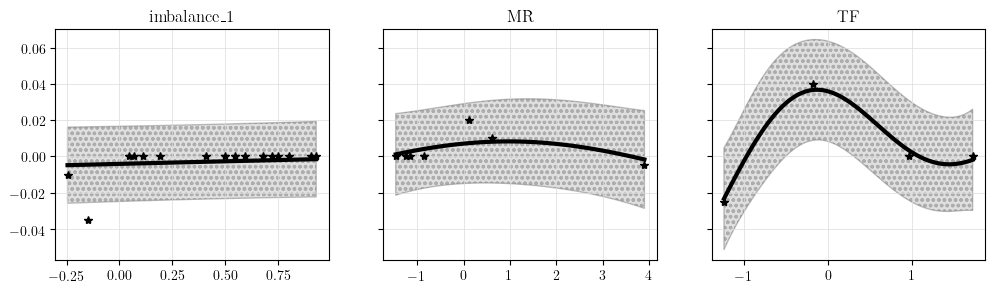

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


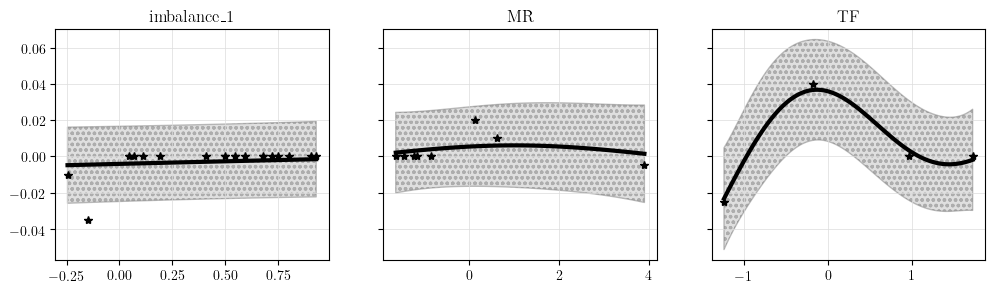

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


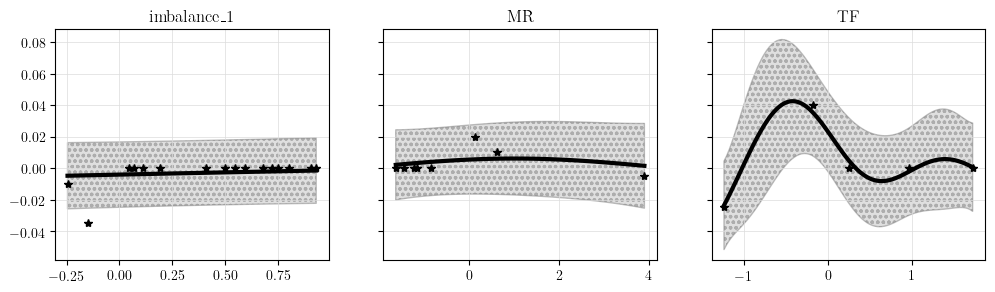

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


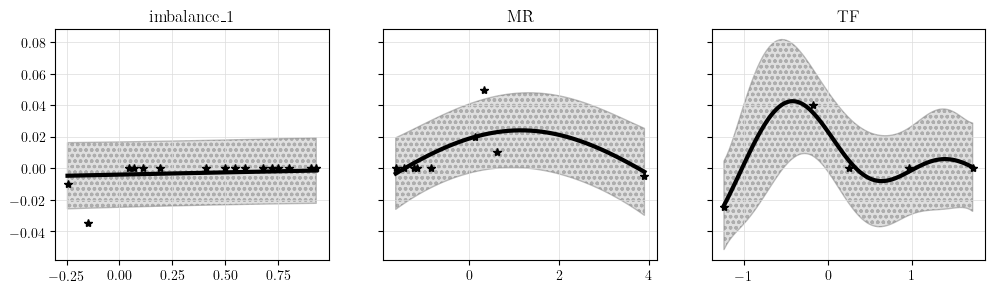

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


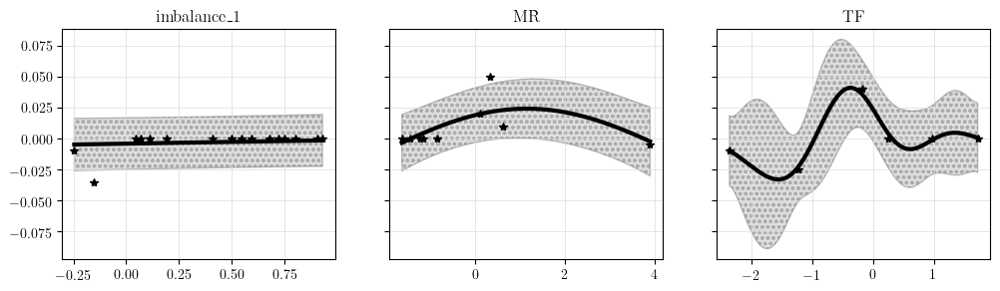

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


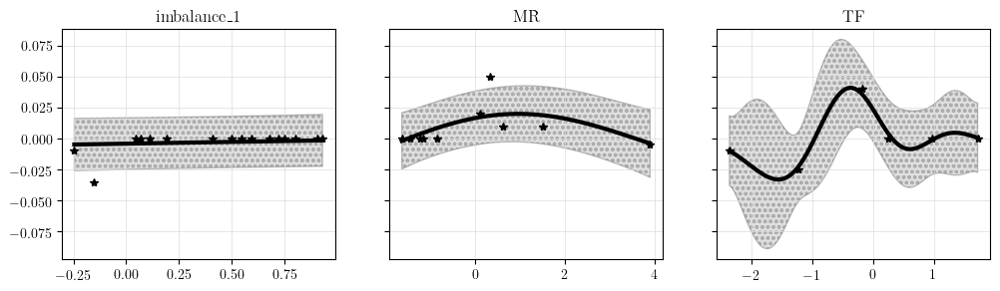

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


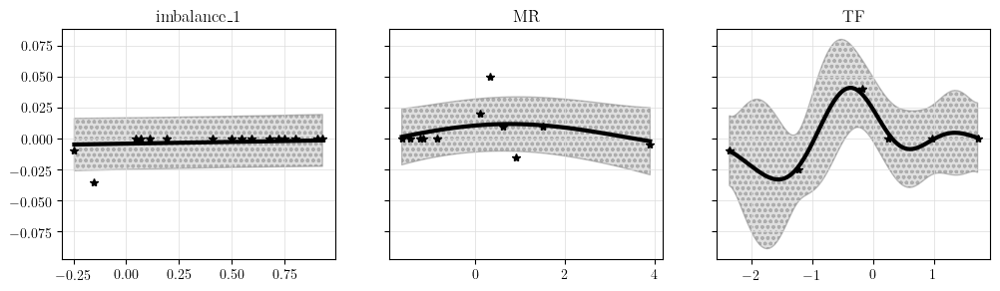

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


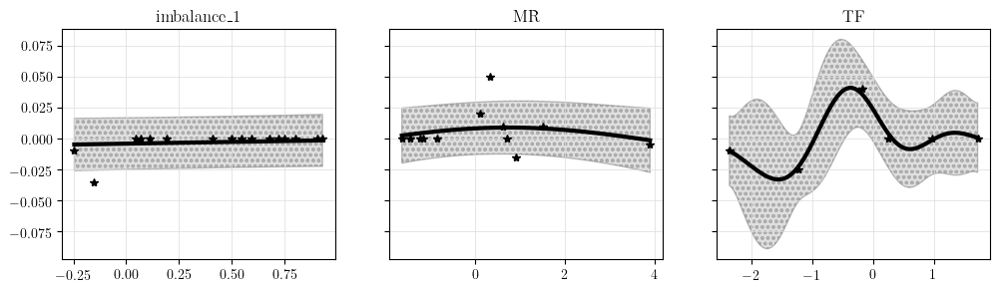

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


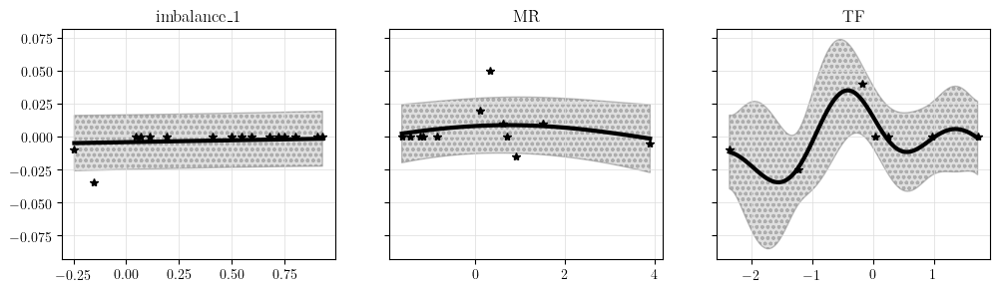

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


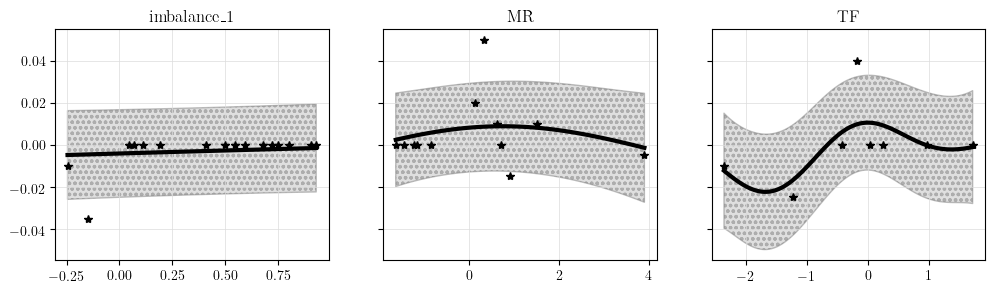

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


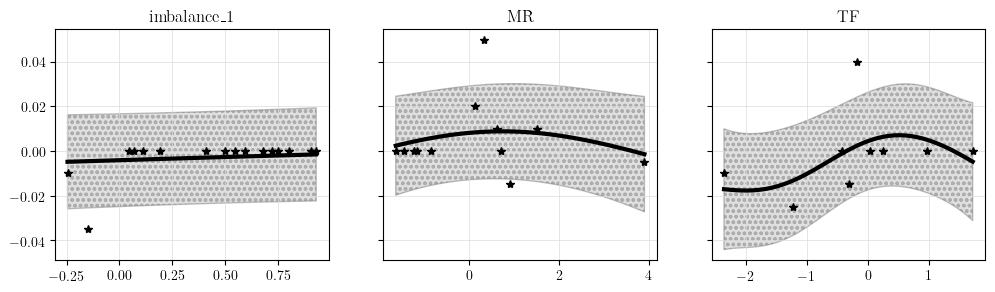

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


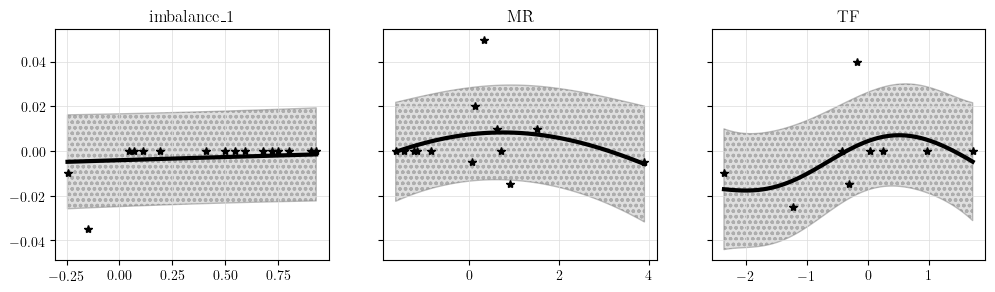

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


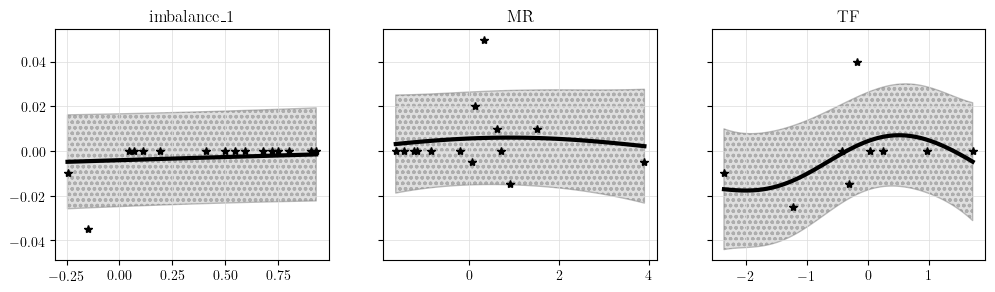

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


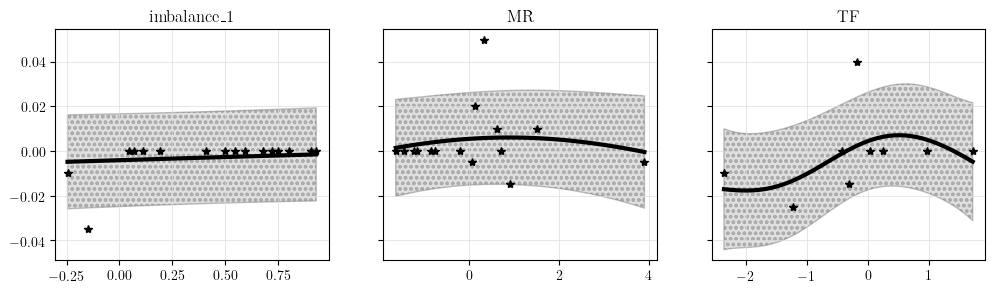

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


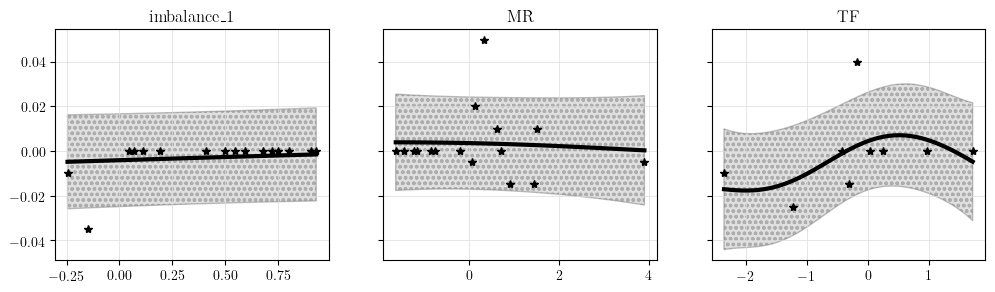

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.13974  Threshold: 0.002
Average performance GP1: tensor(0.0031, dtype=torch.float64)
Average performance GP2: tensor(0.0021, dtype=torch.float64)


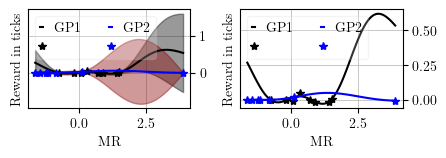

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


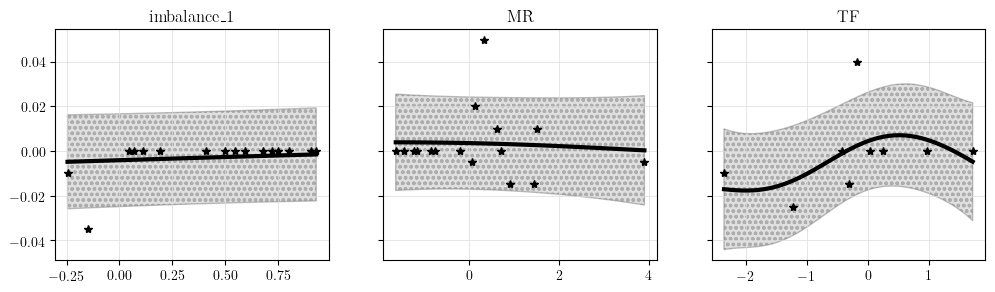

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


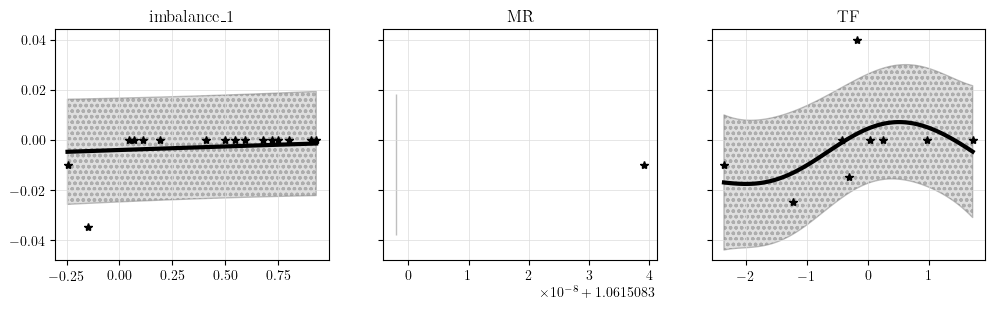

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


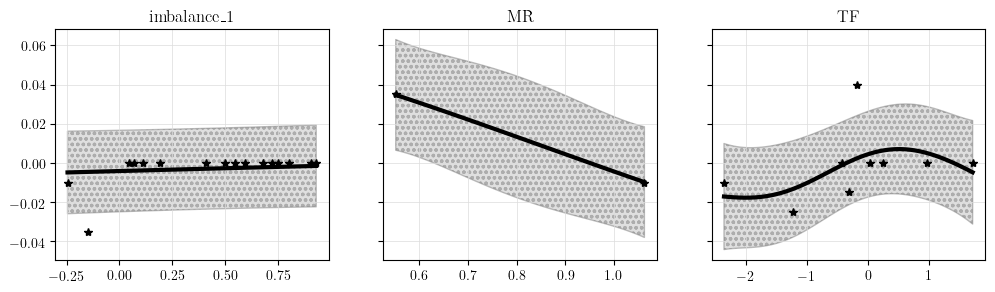

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


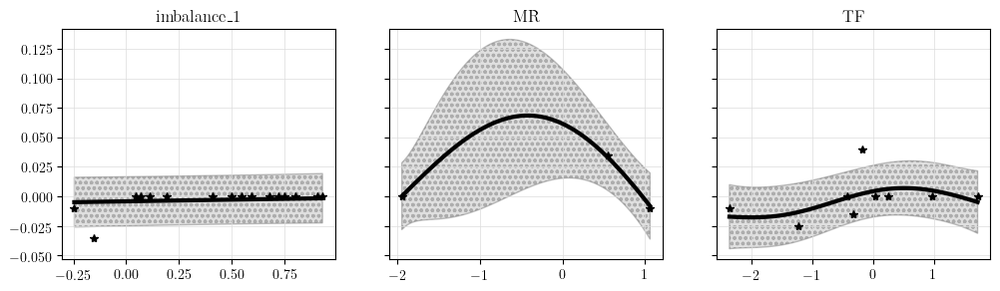

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


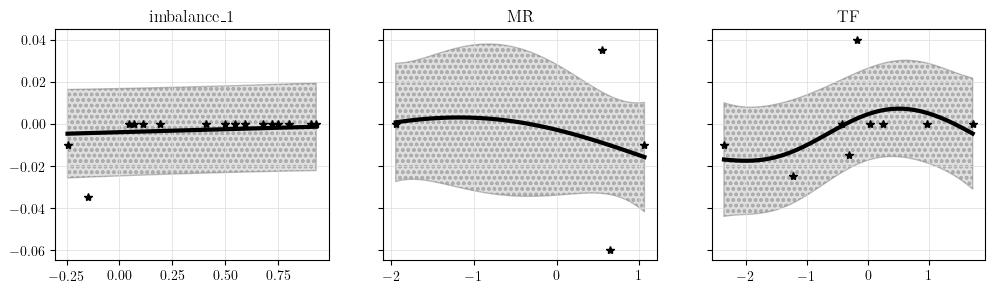

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


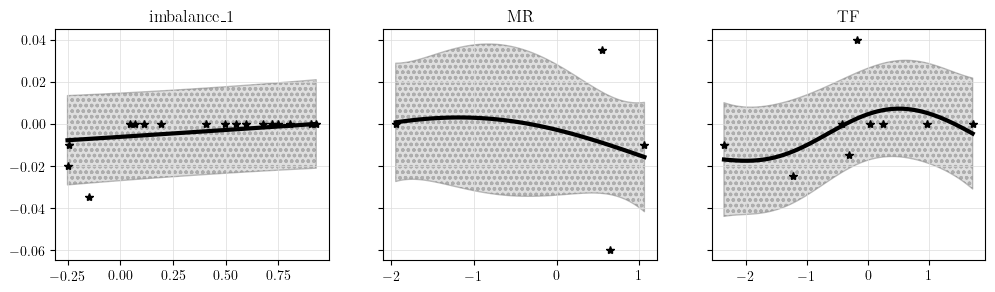

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  8e-05  Threshold: 0.002
Average performance GP1: tensor(-0.0069, dtype=torch.float64)
Average performance GP2: tensor(-0.0014, dtype=torch.float64)


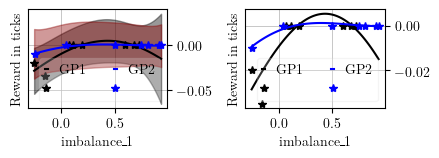

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


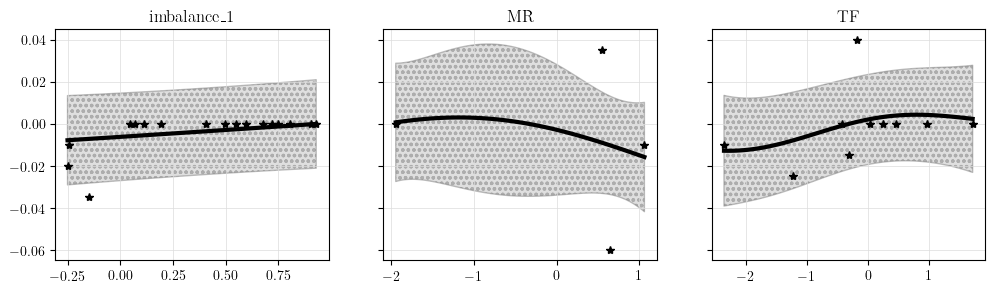

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


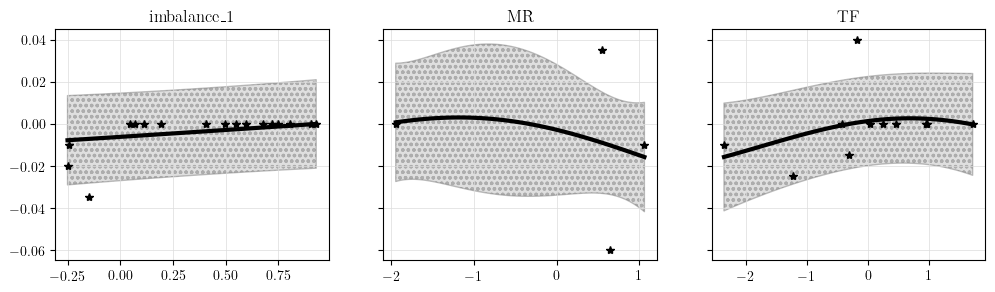

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


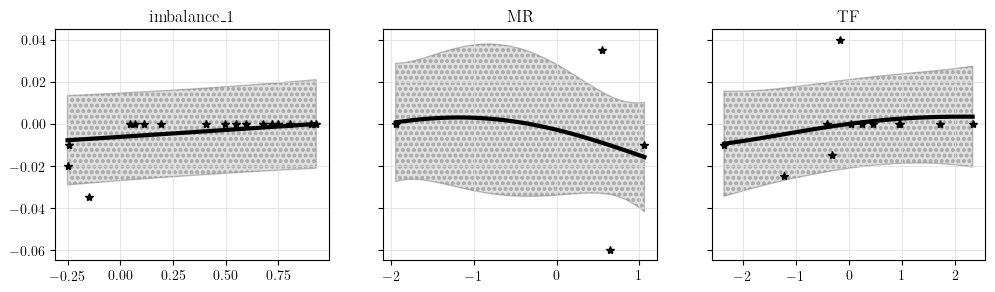

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


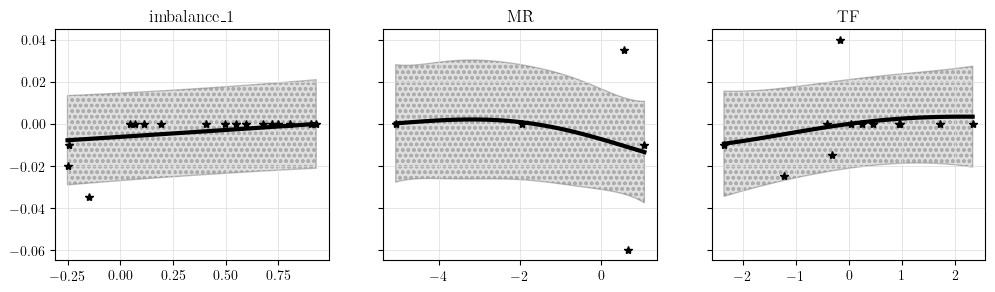

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


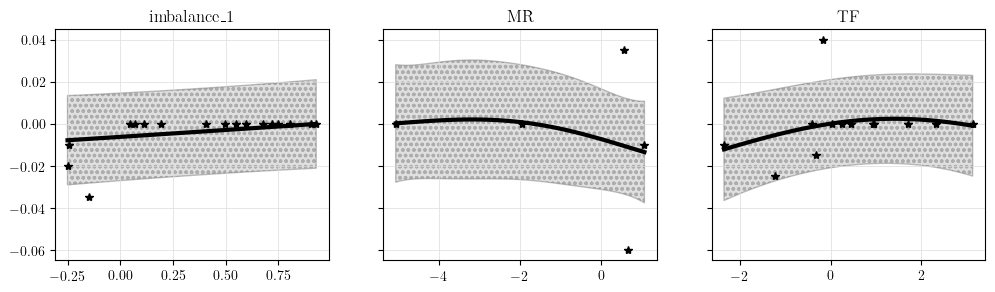

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


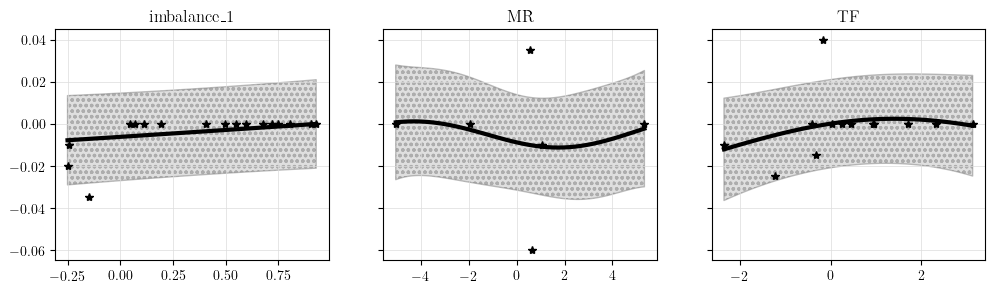

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


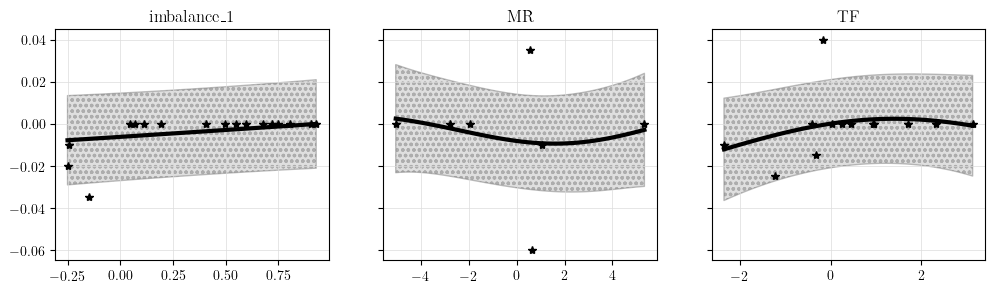

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


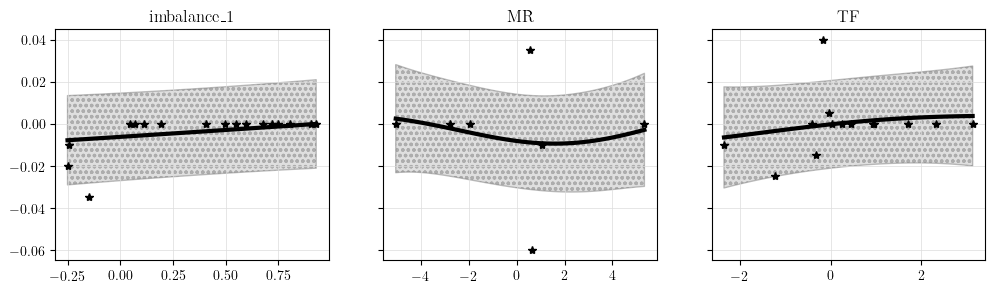

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


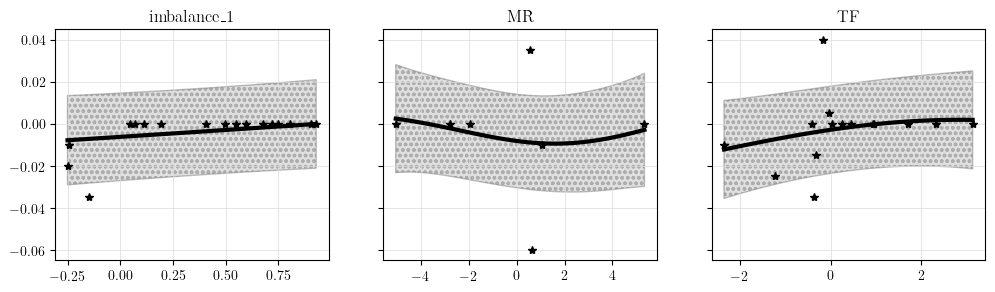

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


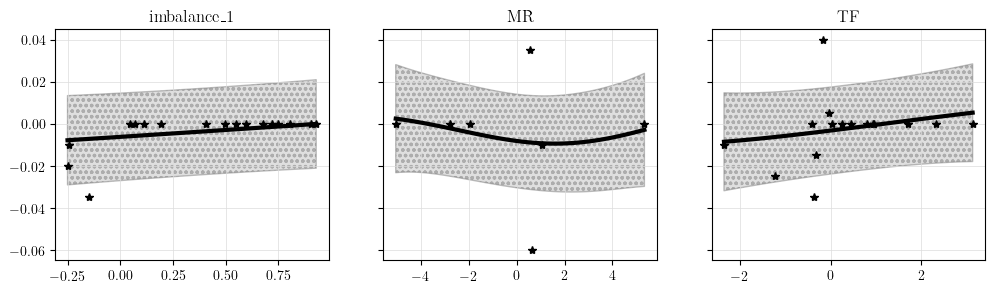

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.03669  Threshold: 0.002
Average performance GP1: tensor(-0.0056, dtype=torch.float64)
Average performance GP2: tensor(0.0043, dtype=torch.float64)


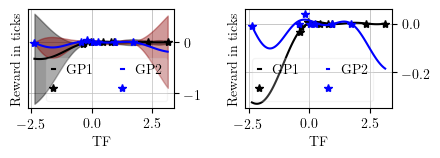

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


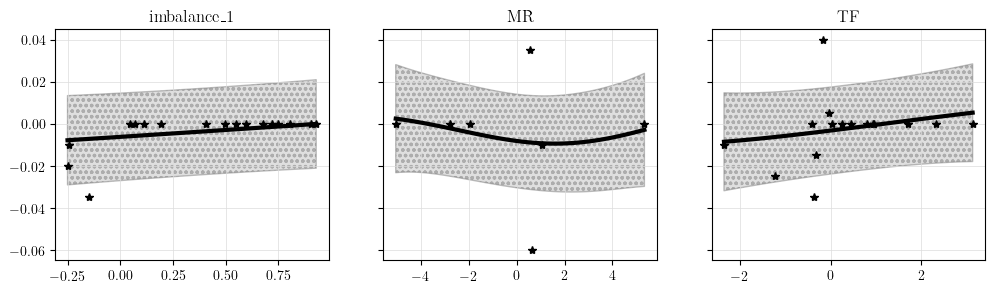

Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


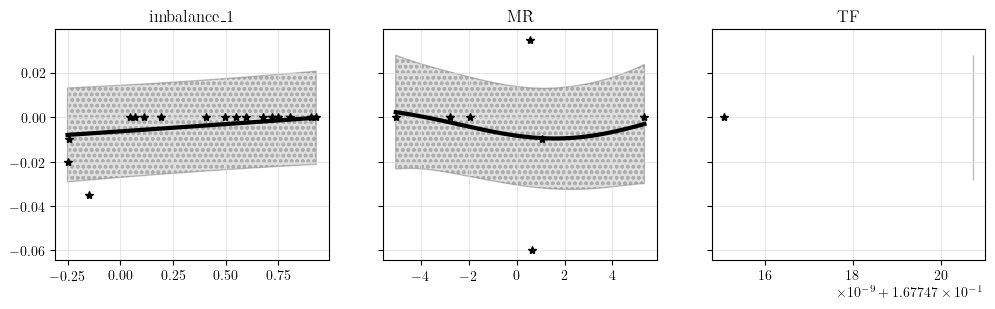

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


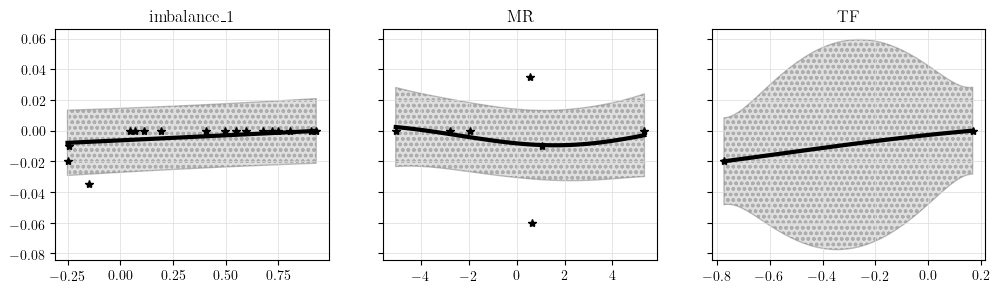

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


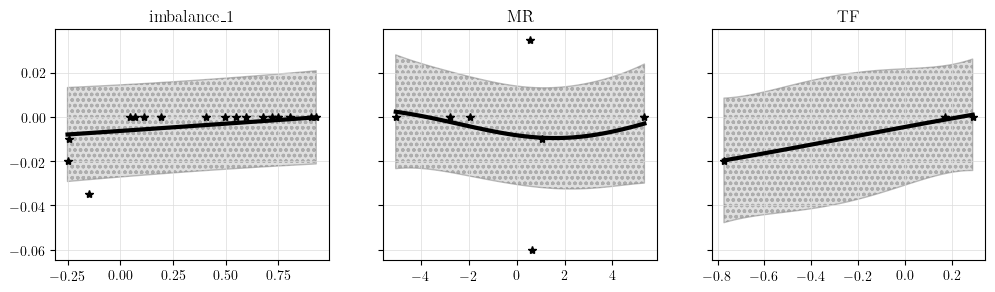

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


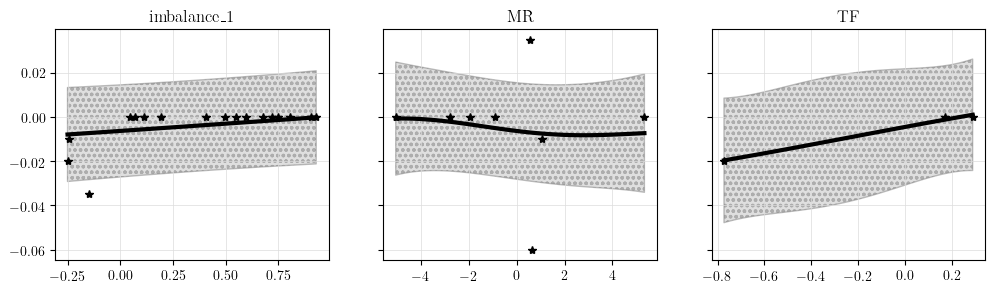

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


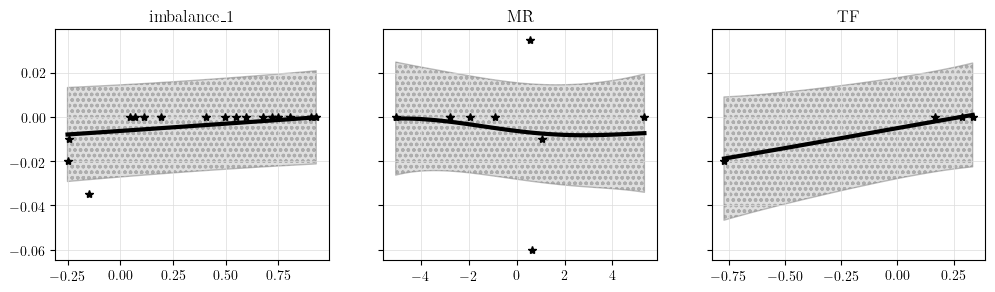

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


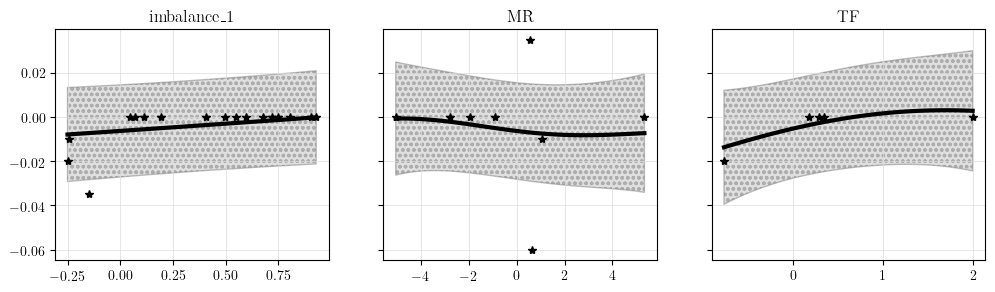

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


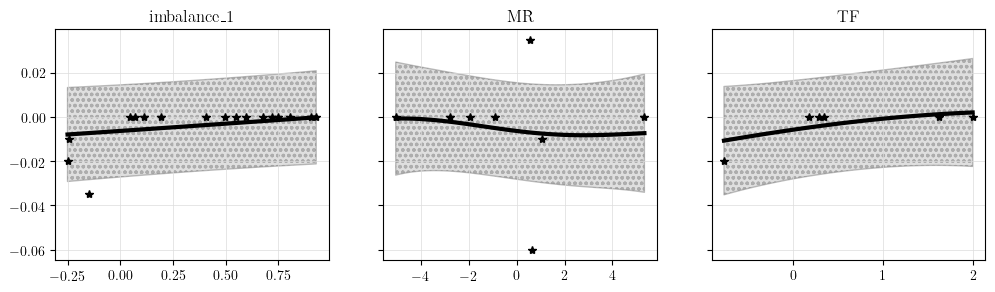

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


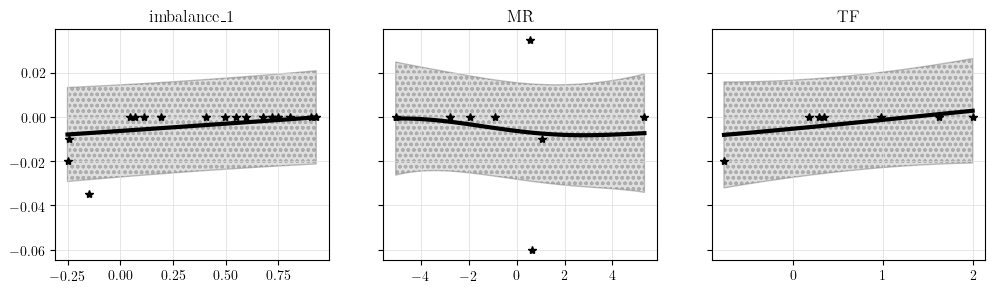

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


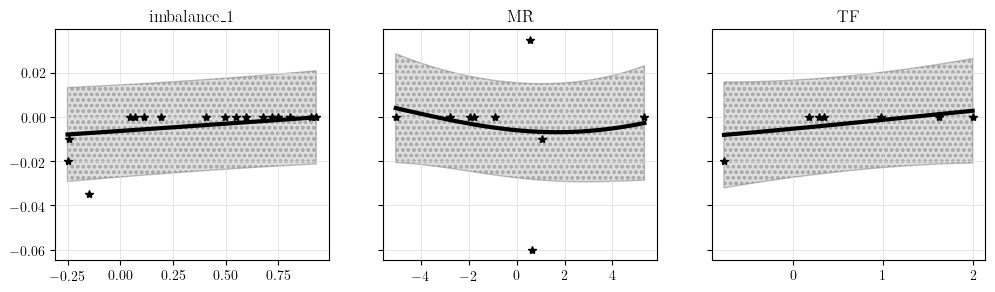

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


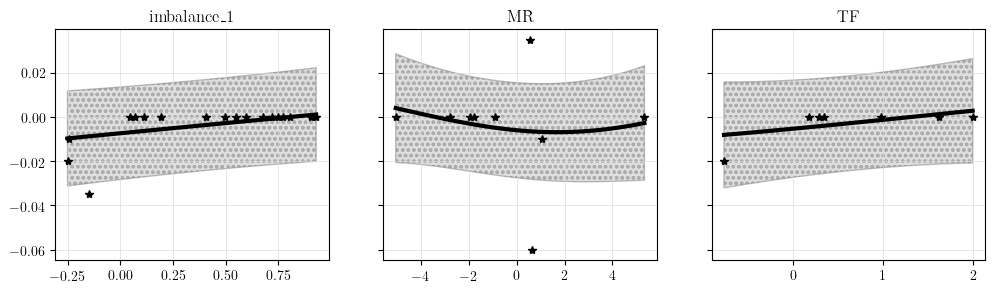

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  6e-05  Threshold: 0.002
Average performance GP1: tensor(-0.0069, dtype=torch.float64)
Average performance GP2: tensor(-0.0014, dtype=torch.float64)


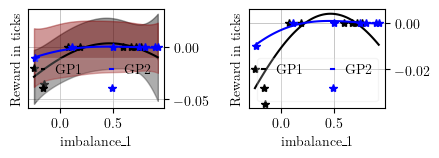

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


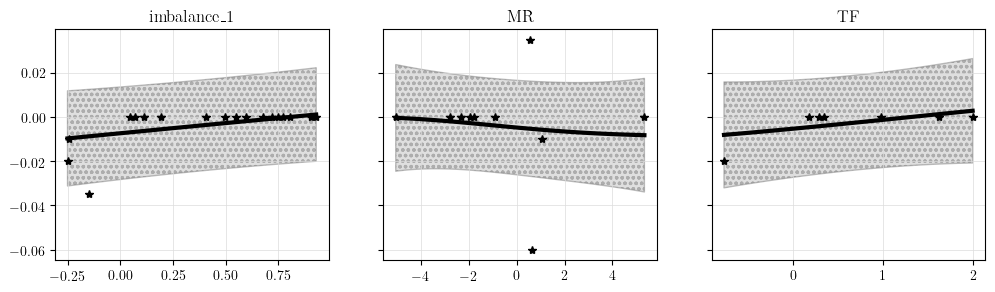

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


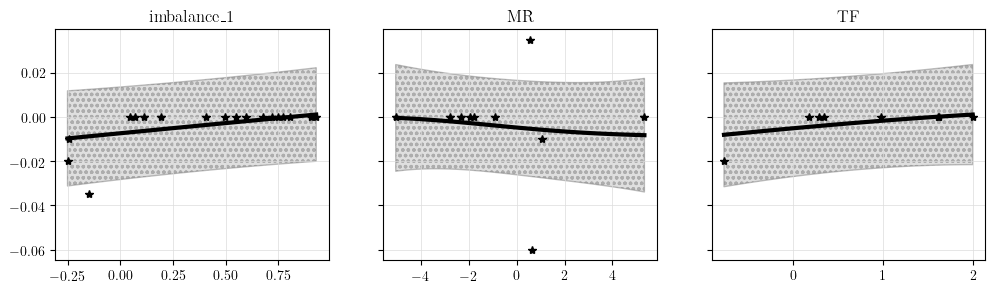

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


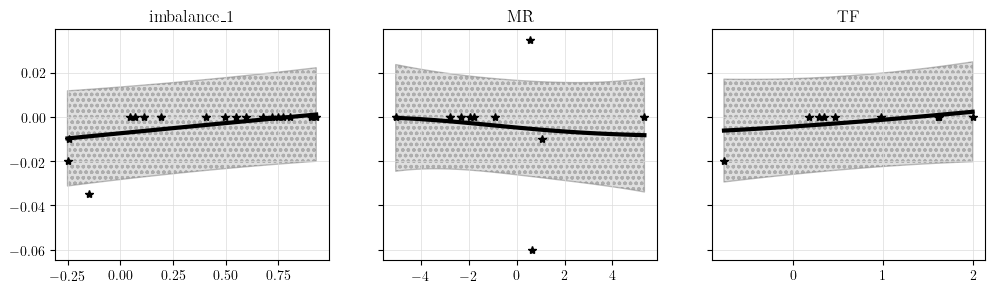

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


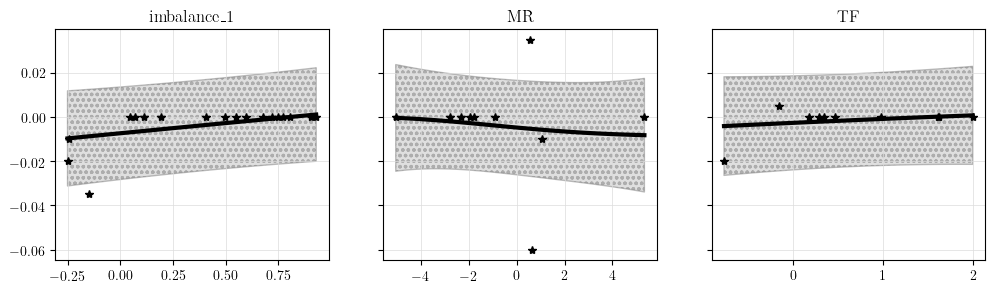

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


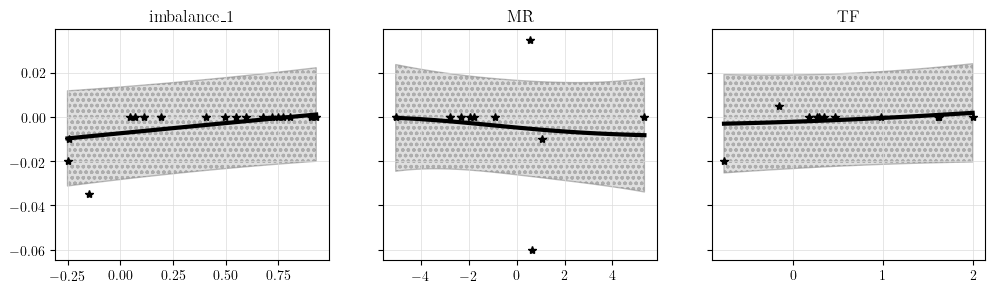

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


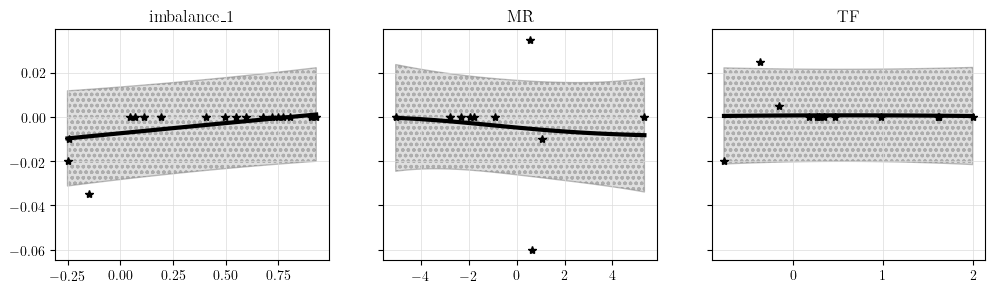

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


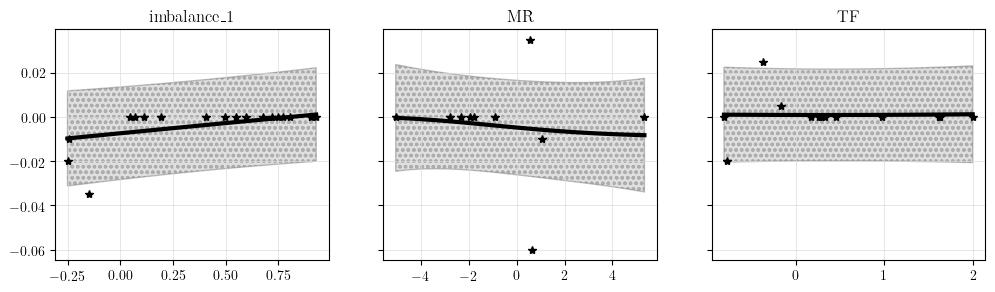

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


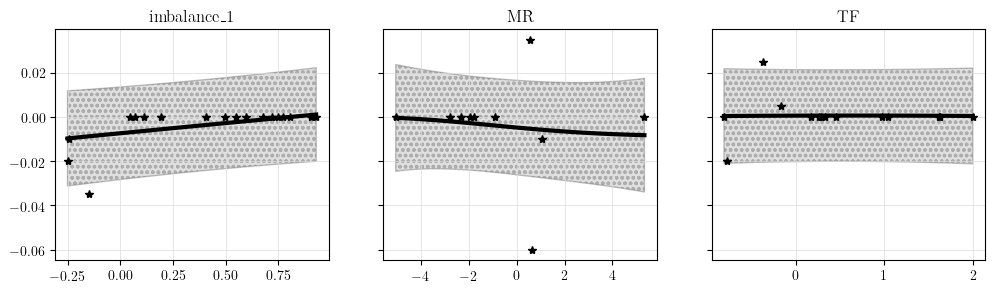

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


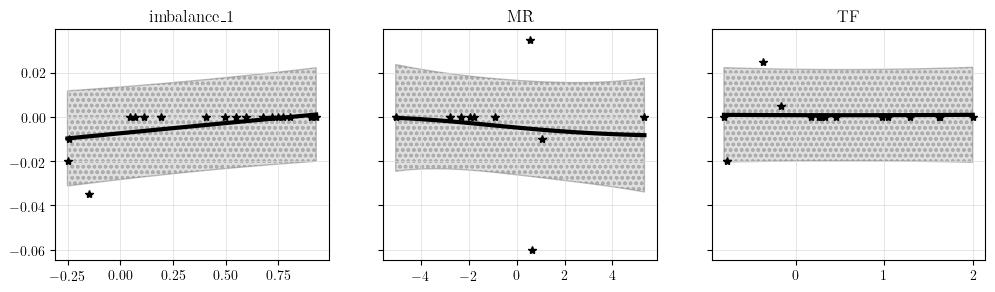

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


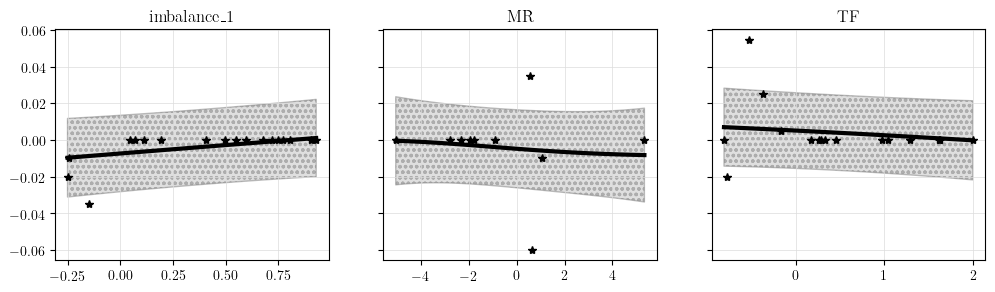

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.00158  Threshold: 0.002
Average performance GP1: tensor(0.0106, dtype=torch.float64)
Average performance GP2: tensor(-0.0029, dtype=torch.float64)


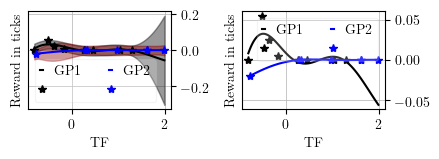

I am storing the change point test results for  TF
Selected strategy: TF
I am deleting the change point results of  TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


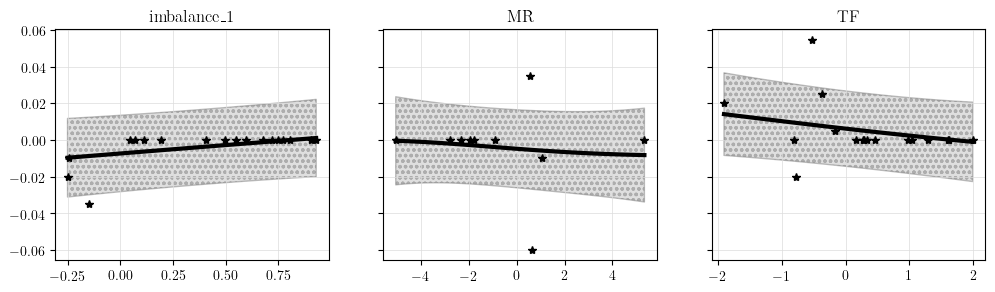

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.03838  Threshold: 0.002
Average performance GP1: tensor(0.0131, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


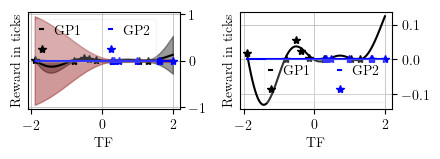

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


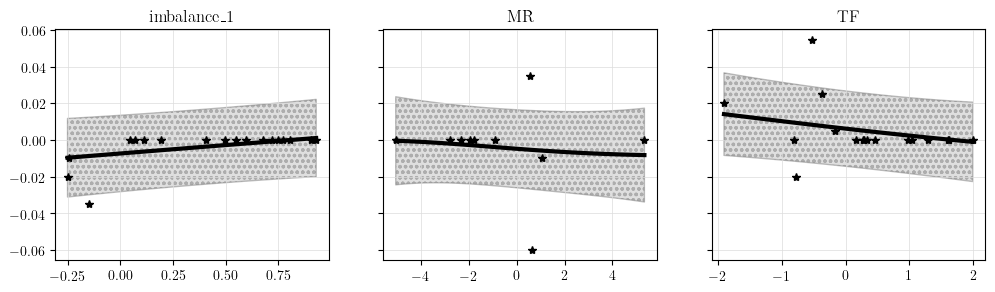

Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


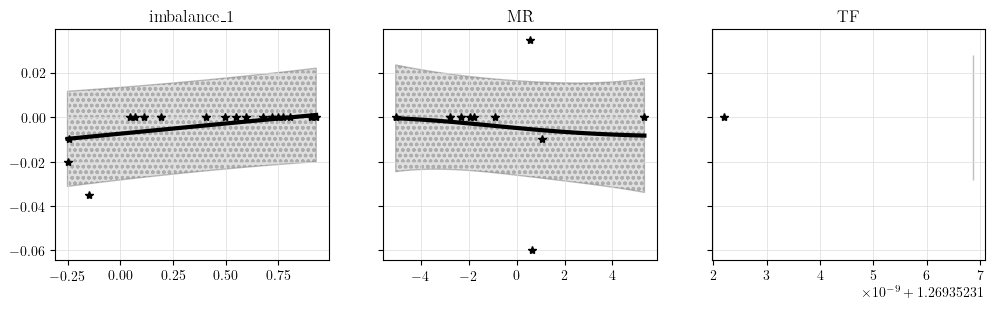

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


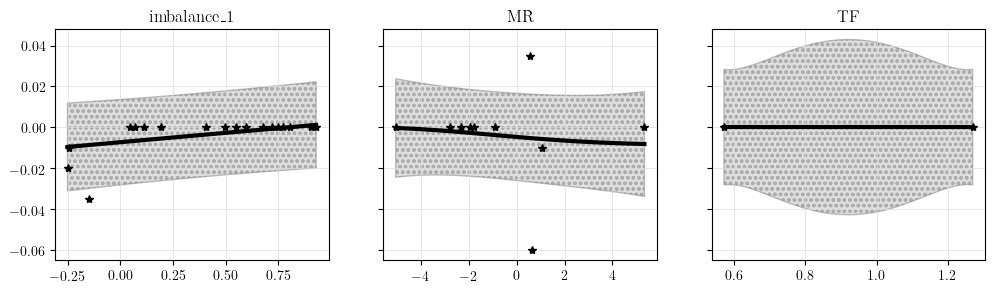

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


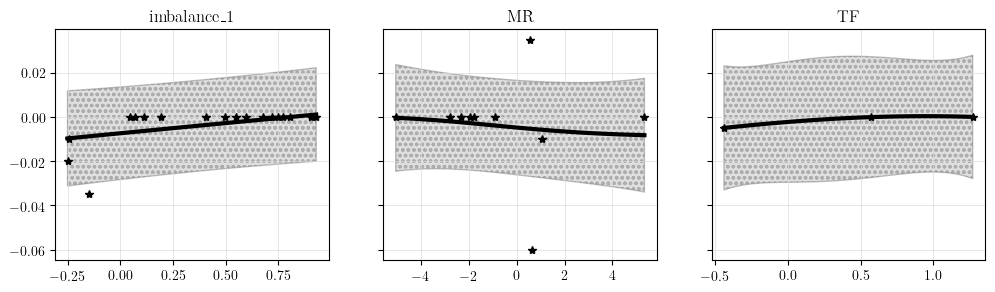

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


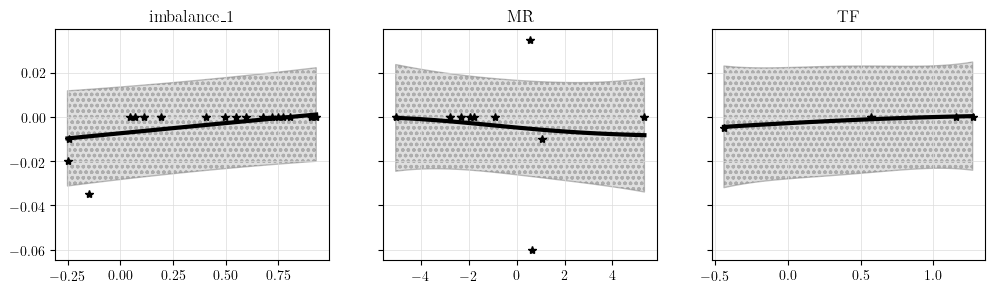

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


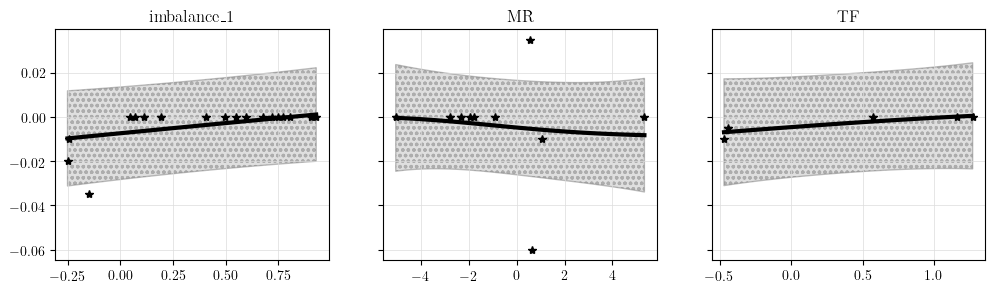

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


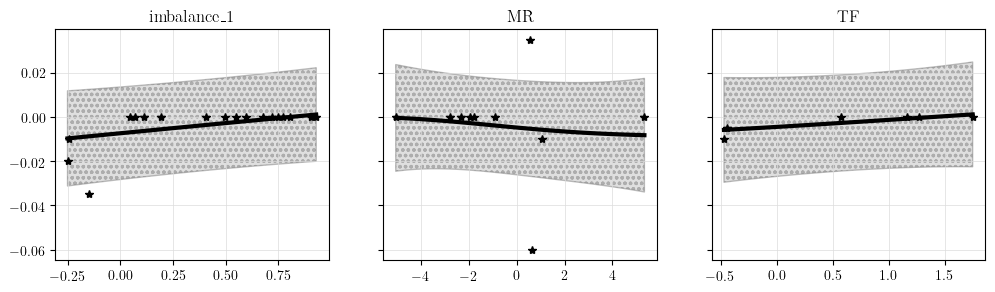

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


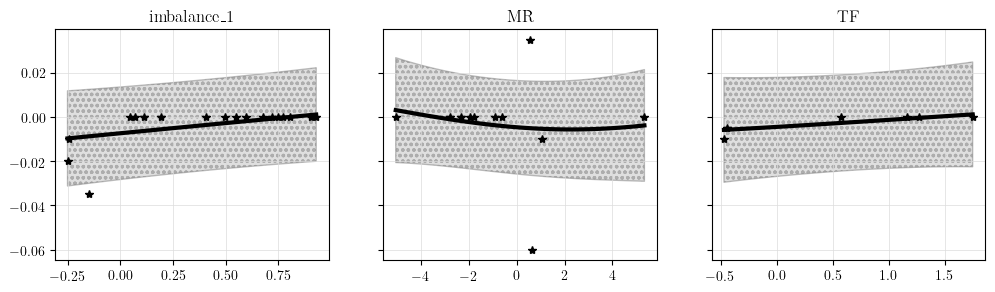

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


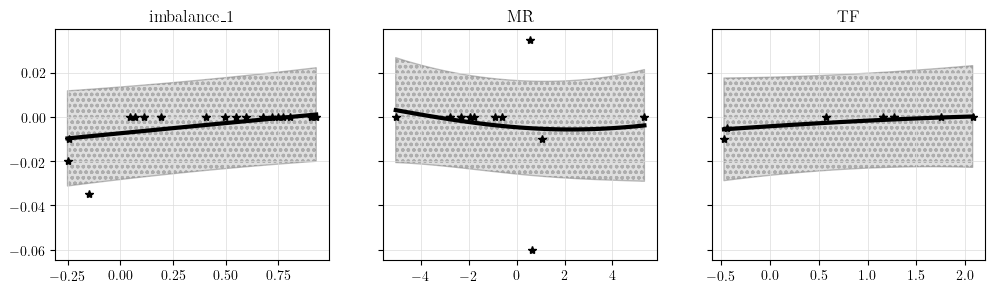

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


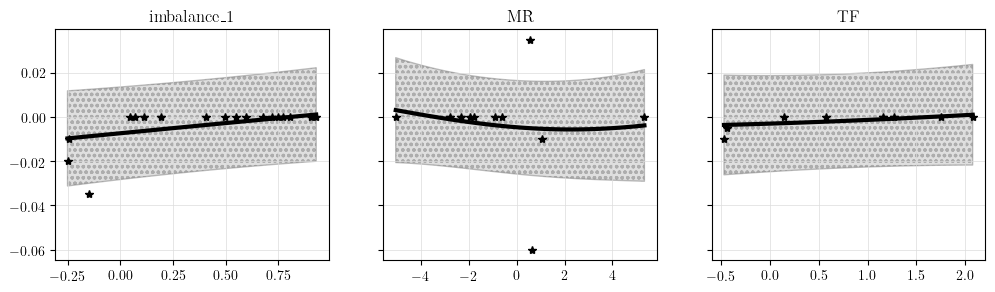

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


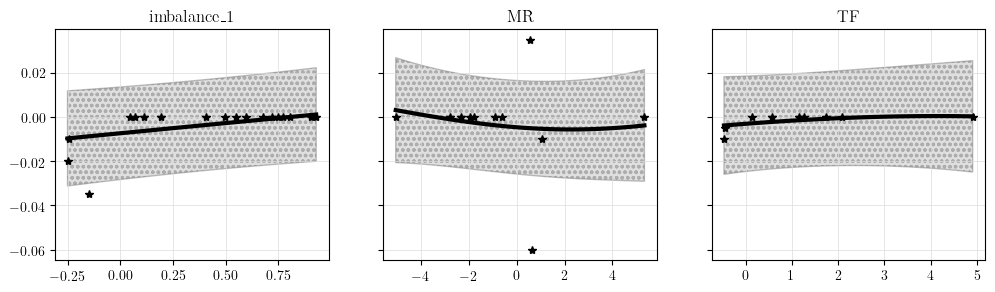

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


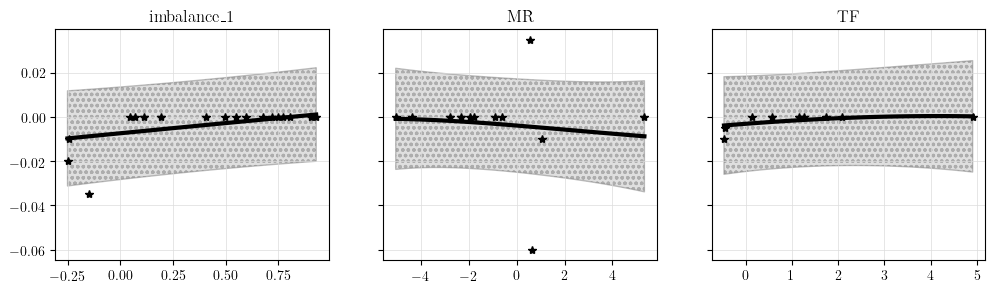

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


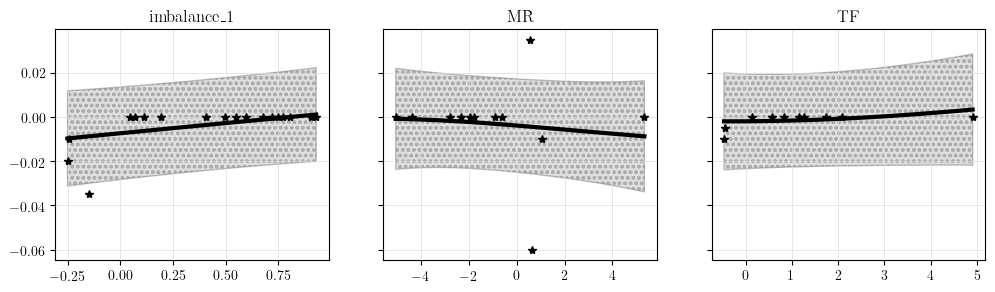

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


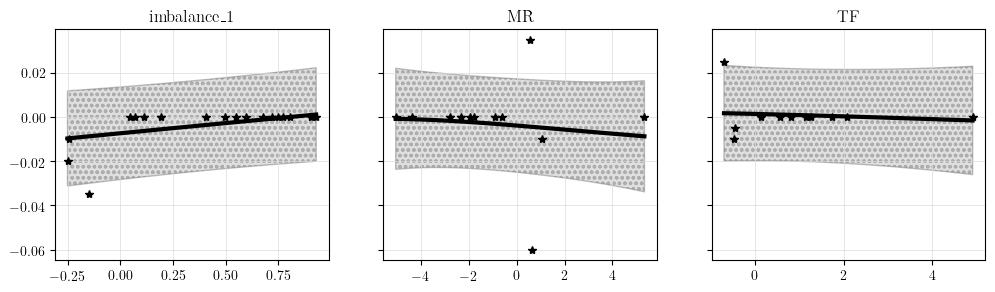

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


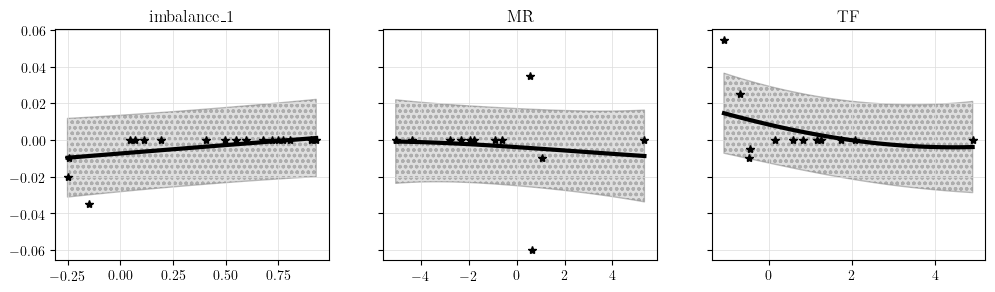

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


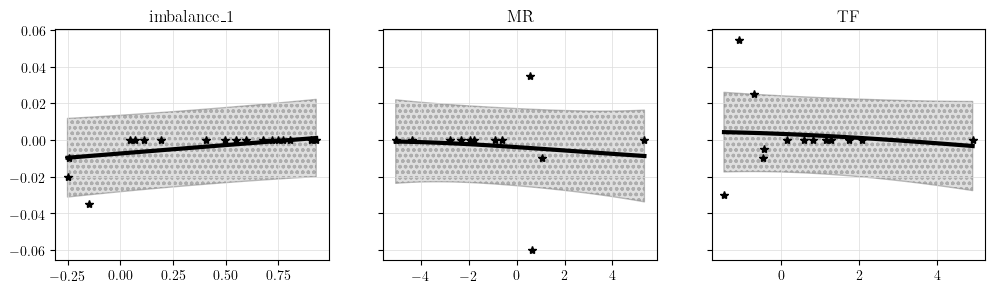

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


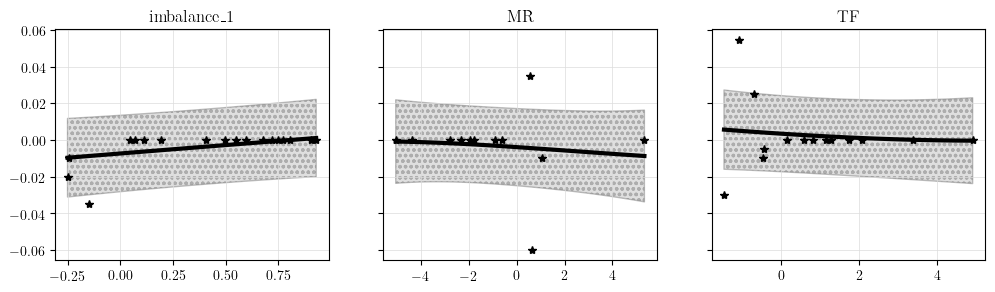

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


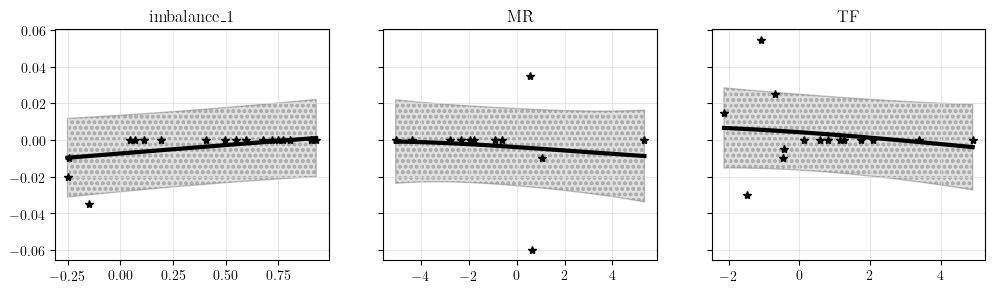

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


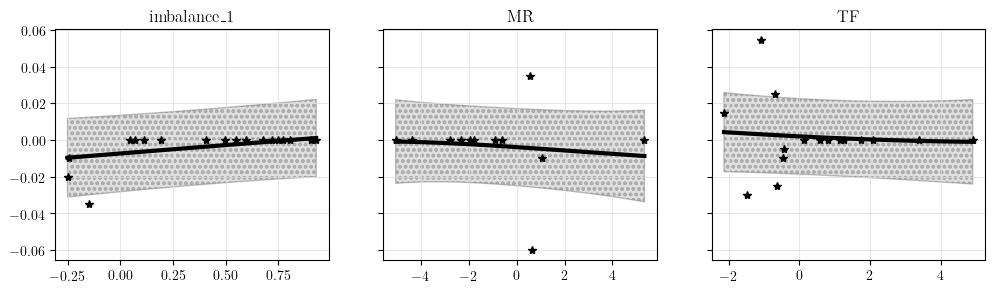

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
** performing change point test for strategy : TF **
Distance:  0.0952  Threshold: 0.002
Average performance GP1: tensor(0.0050, dtype=torch.float64)
Average performance GP2: tensor(-0.0021, dtype=torch.float64)


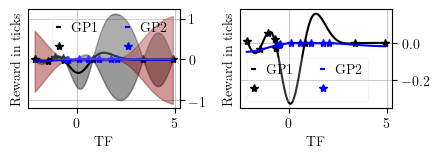

I am storing the change point test results for  TF
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


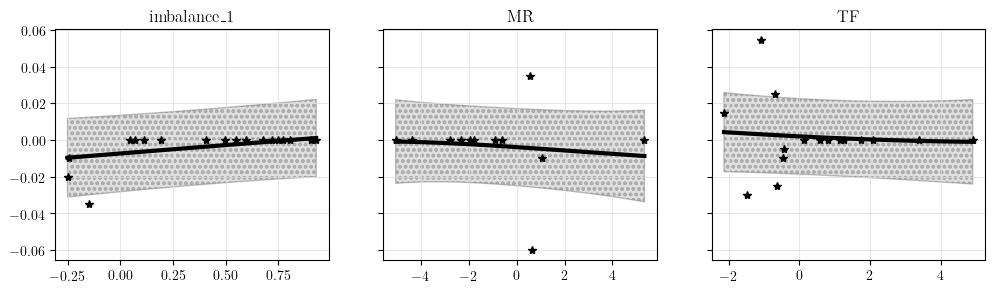

Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


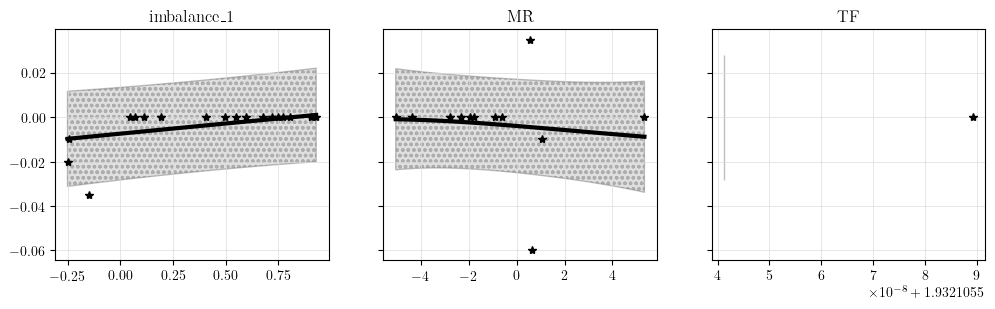

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


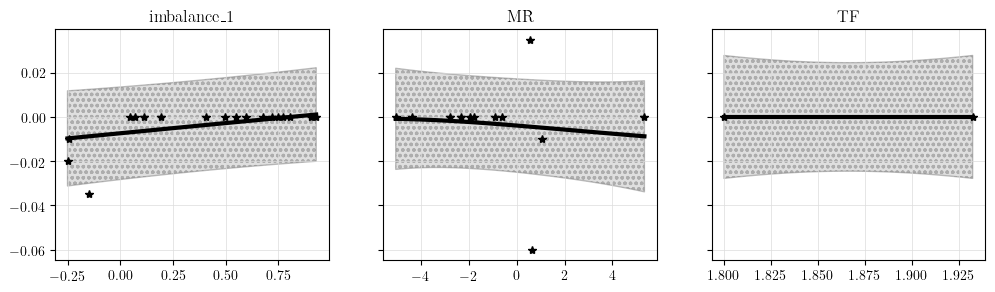

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


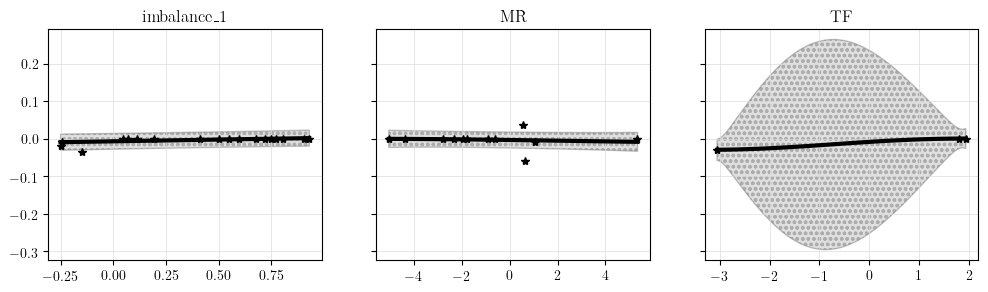

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


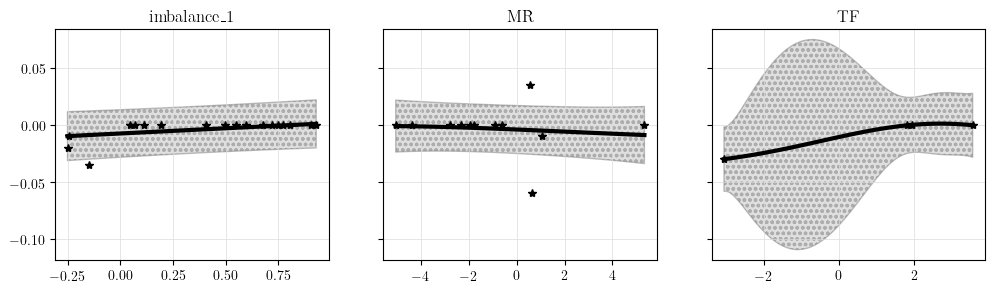

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


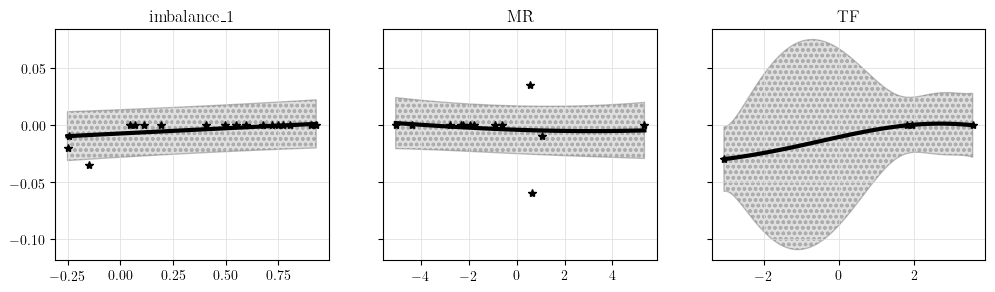

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


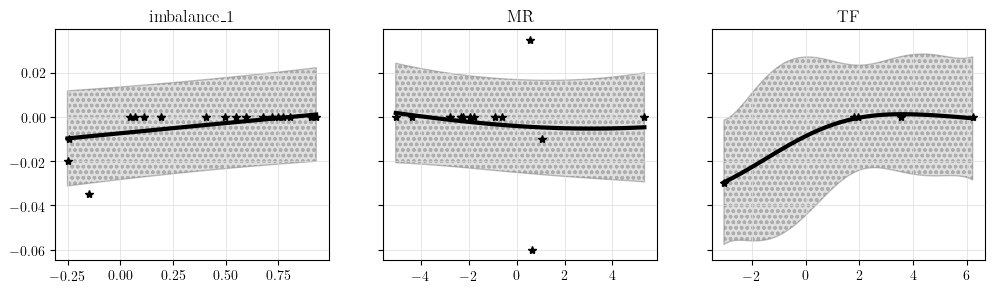

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


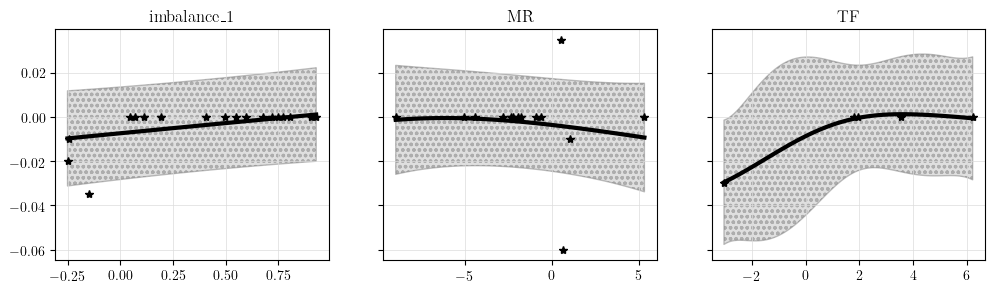

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


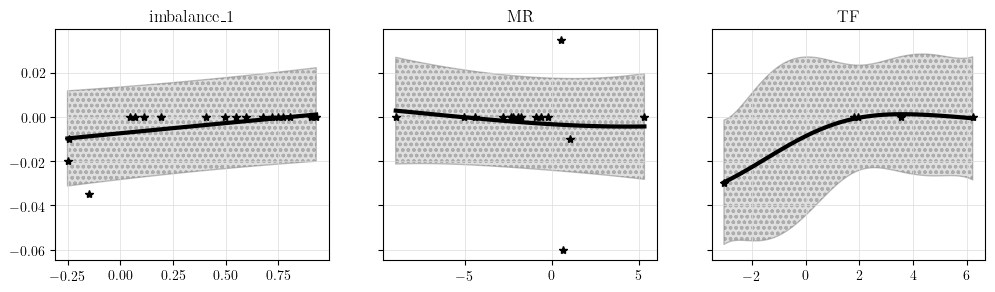

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


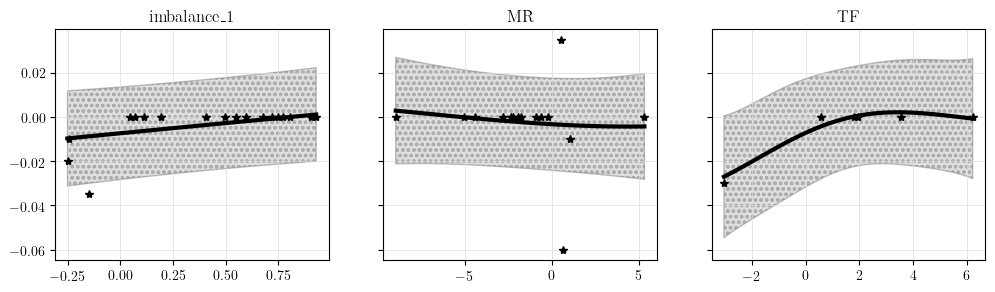

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


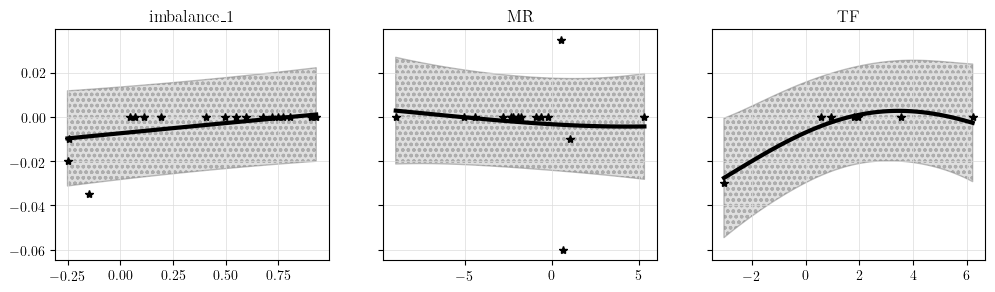

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


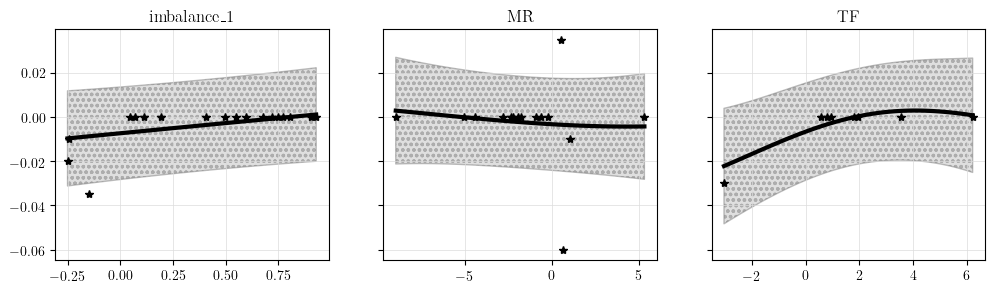

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


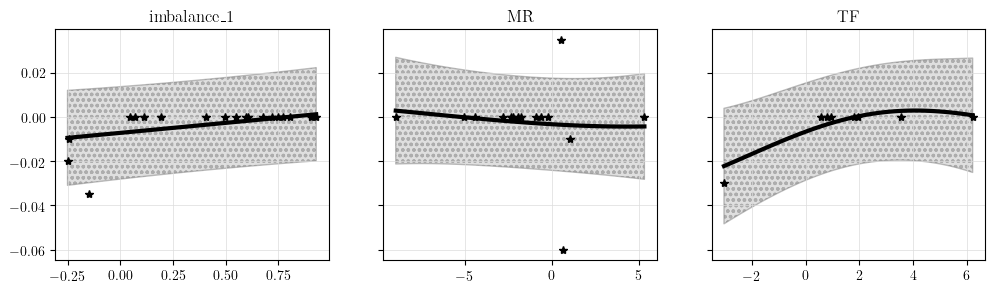

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00023  Threshold: 0.002
Average performance GP1: tensor(-0.0069, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


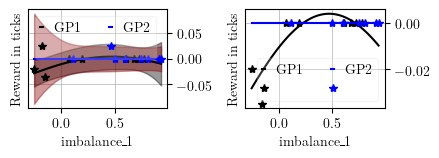

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


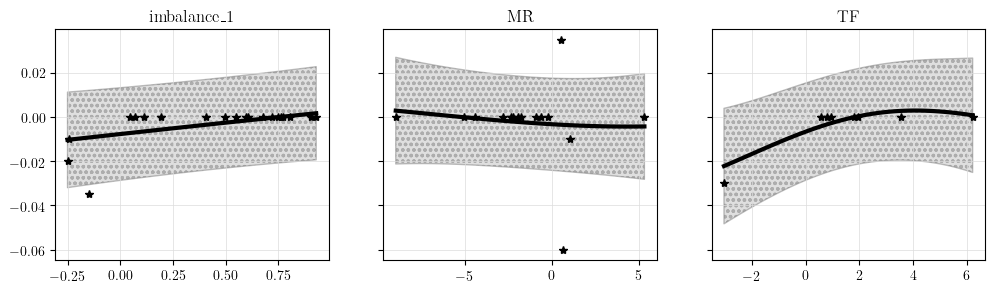

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00023  Threshold: 0.002
Average performance GP1: tensor(-0.0069, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


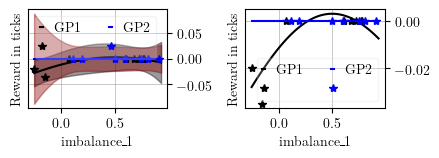

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


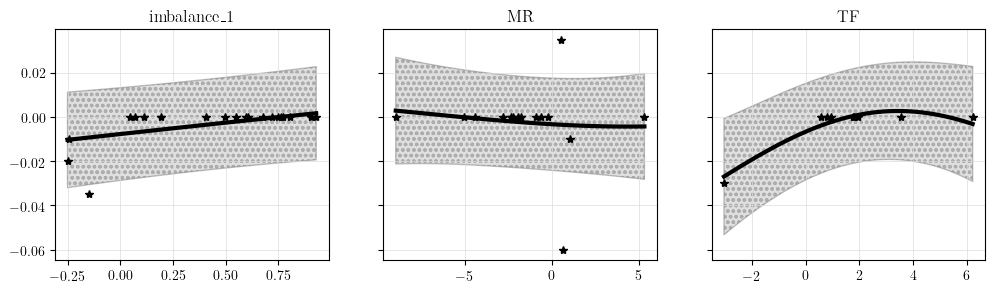

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


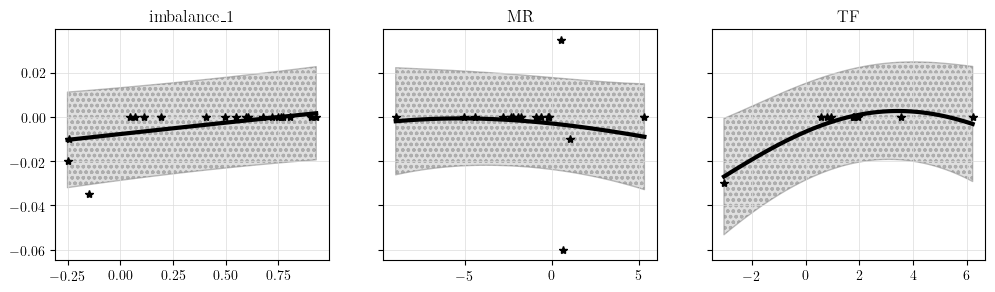

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.08115  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(-0.0036, dtype=torch.float64)


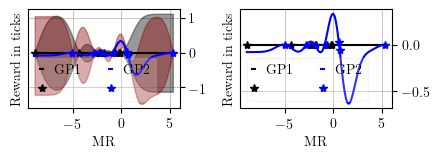

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


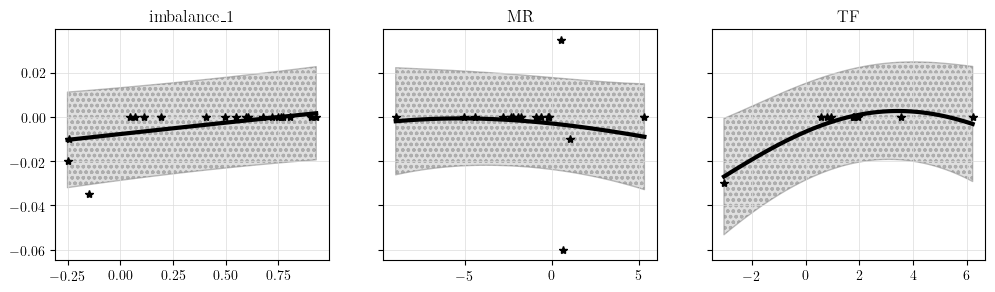

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


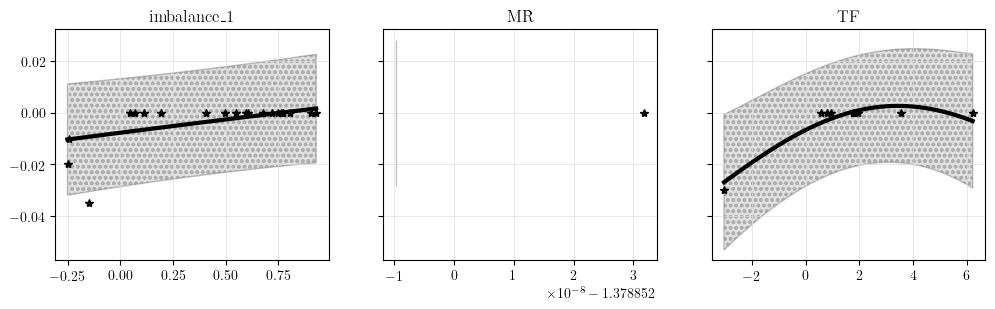

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


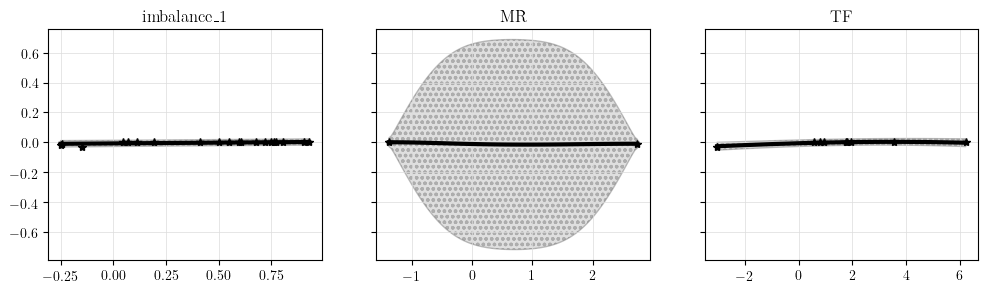

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


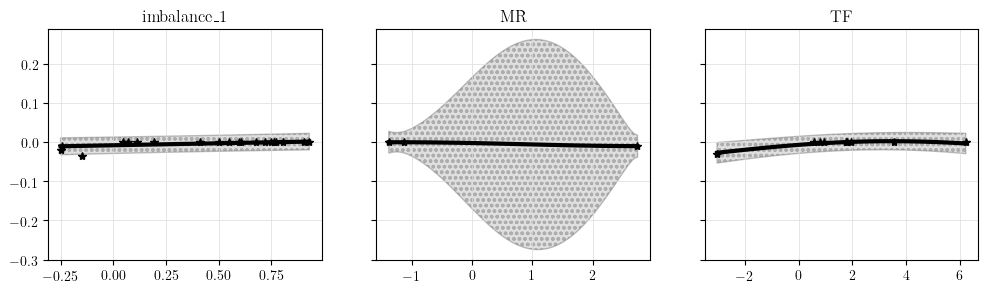

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


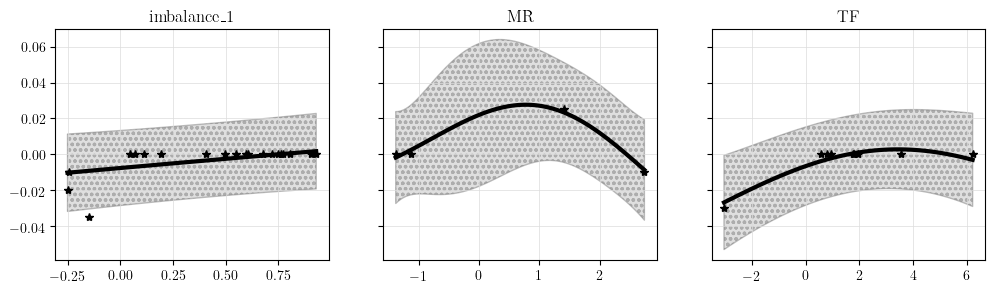

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


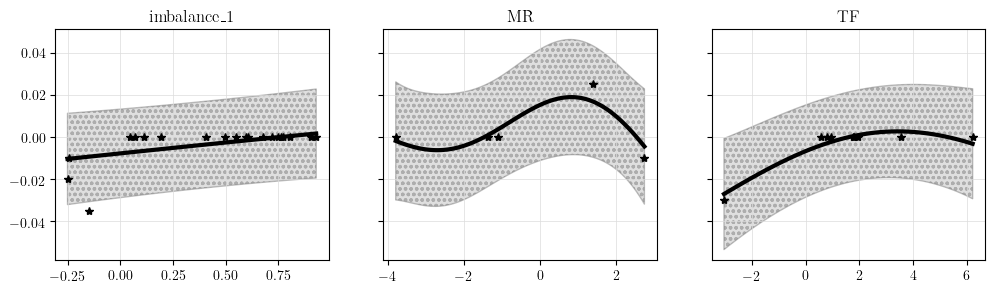

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


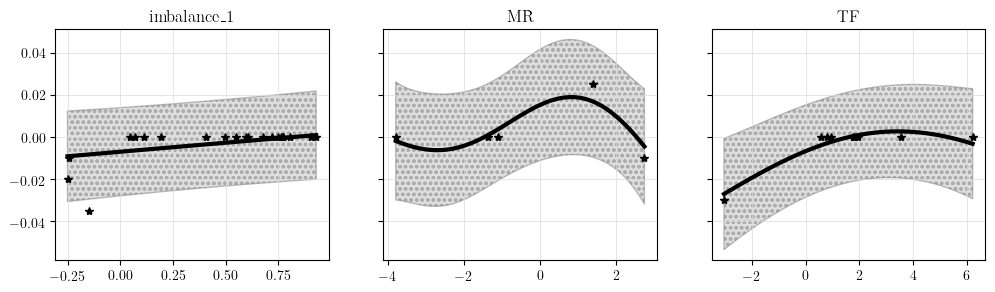

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00045  Threshold: 0.002
Average performance GP1: tensor(-0.0069, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


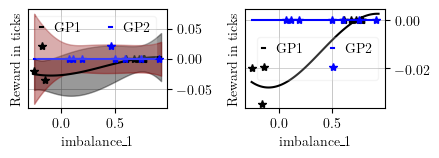

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


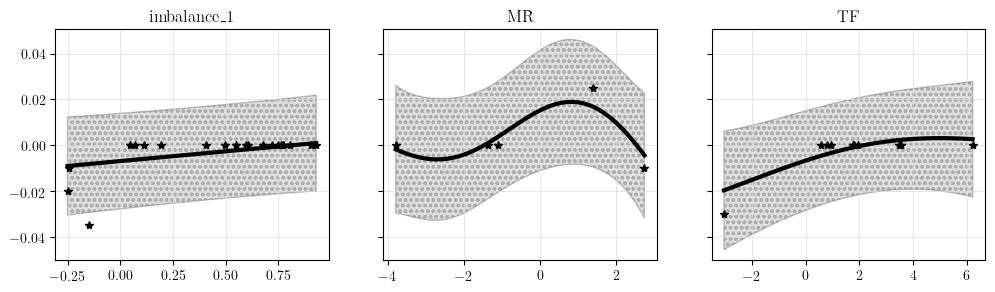

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


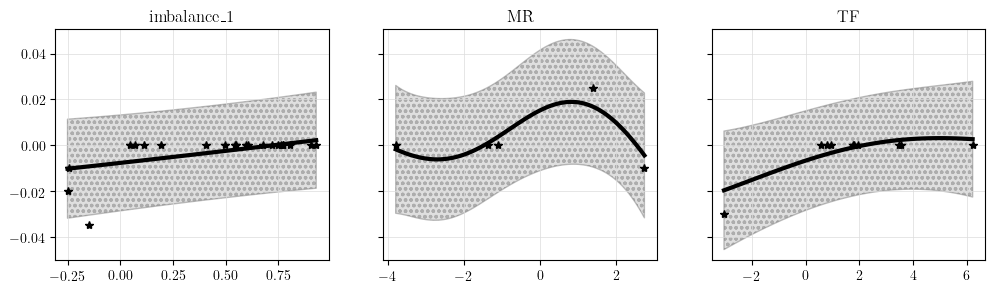

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00037  Threshold: 0.002
Average performance GP1: tensor(-0.0069, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


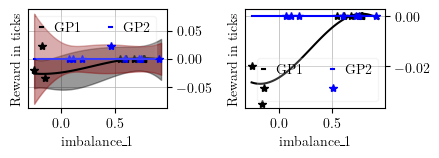

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


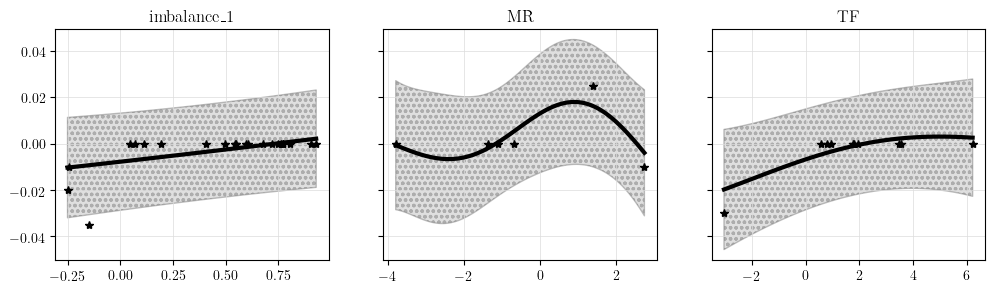

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


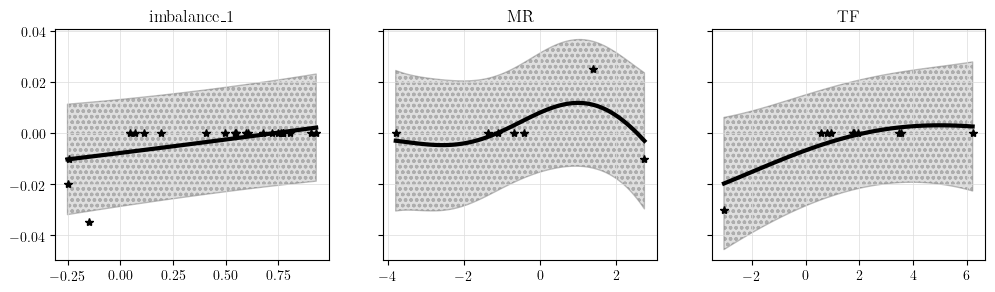

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


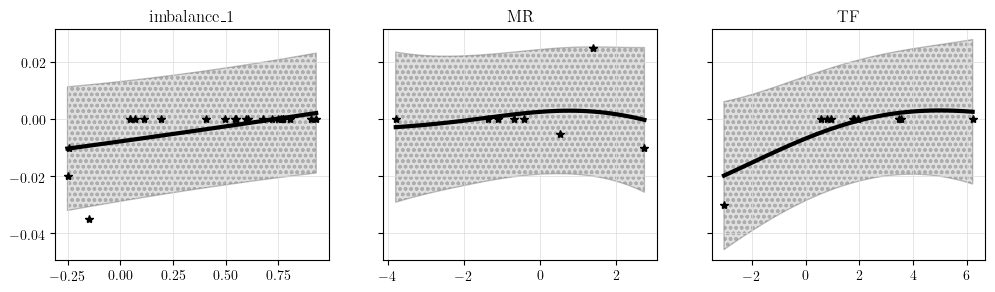

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


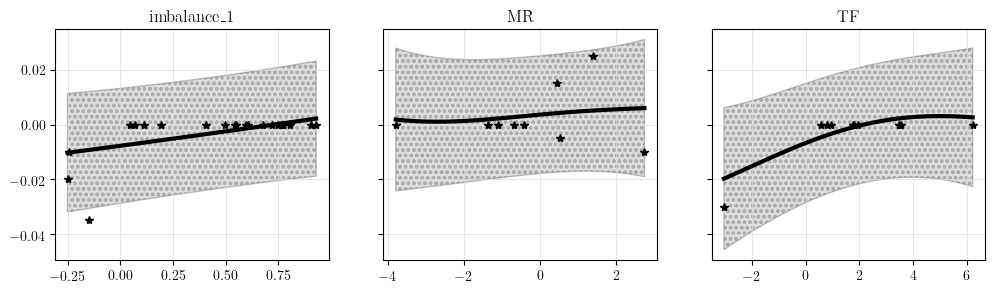

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


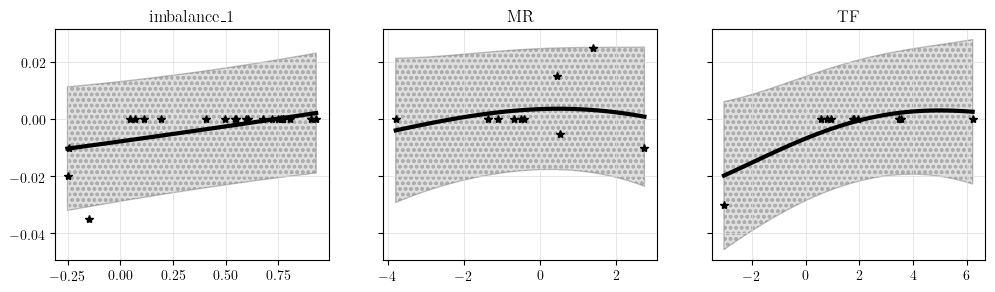

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


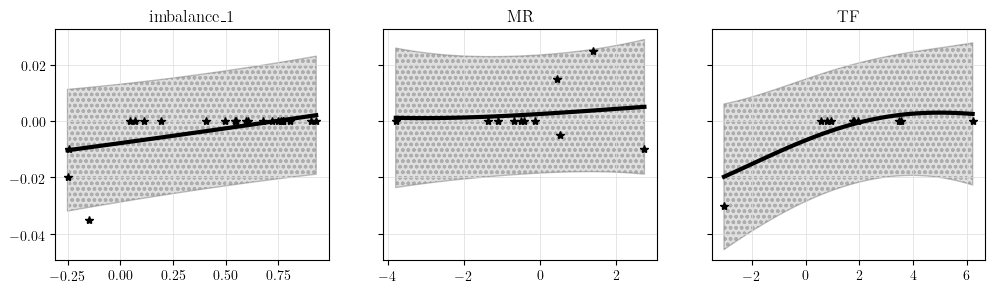

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


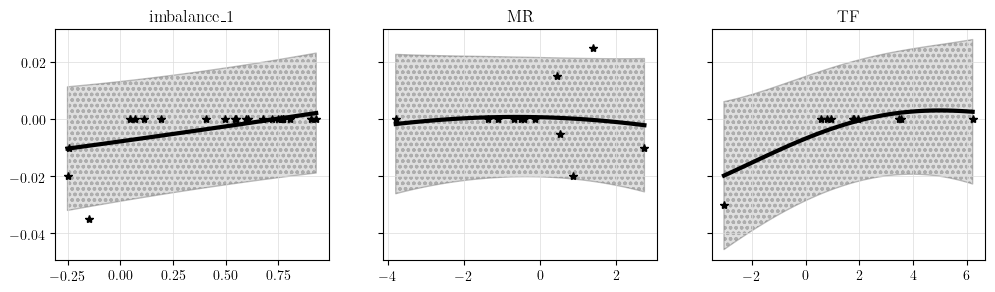

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


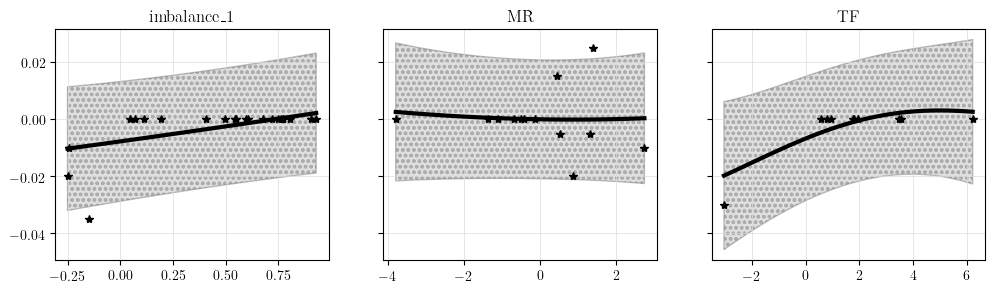

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


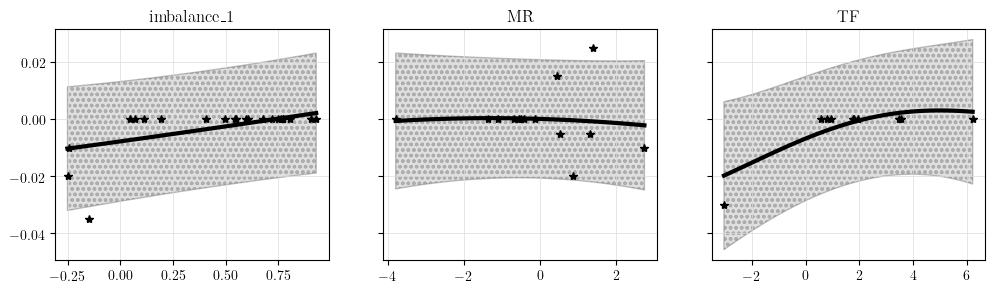

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


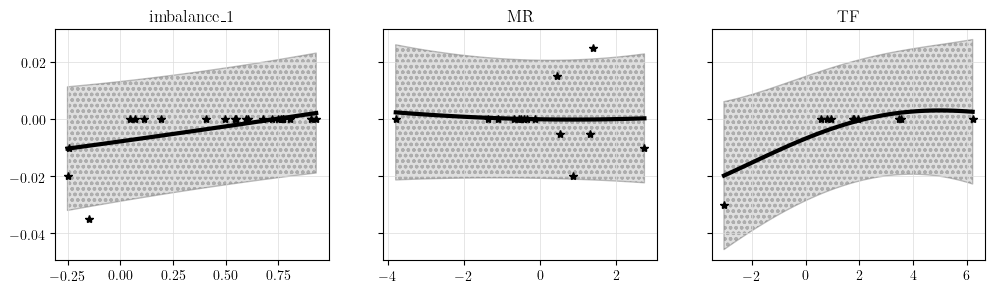

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


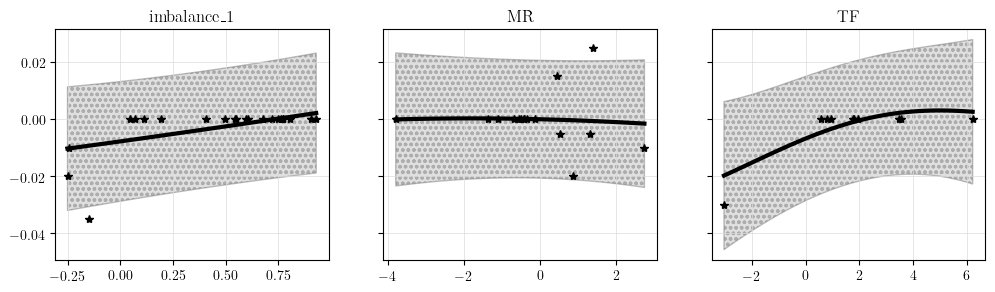

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.07001  Threshold: 0.002
Average performance GP1: tensor(-0.0013, dtype=torch.float64)
Average performance GP2: tensor(0.0014, dtype=torch.float64)


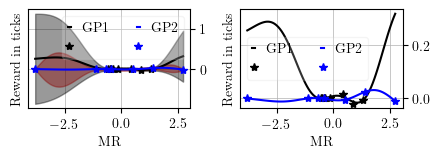

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


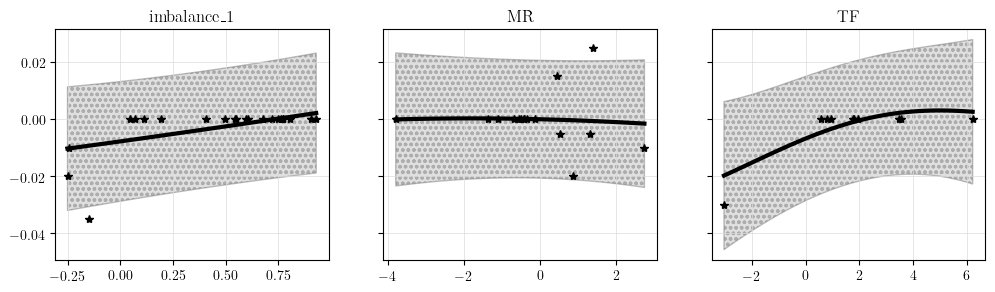

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


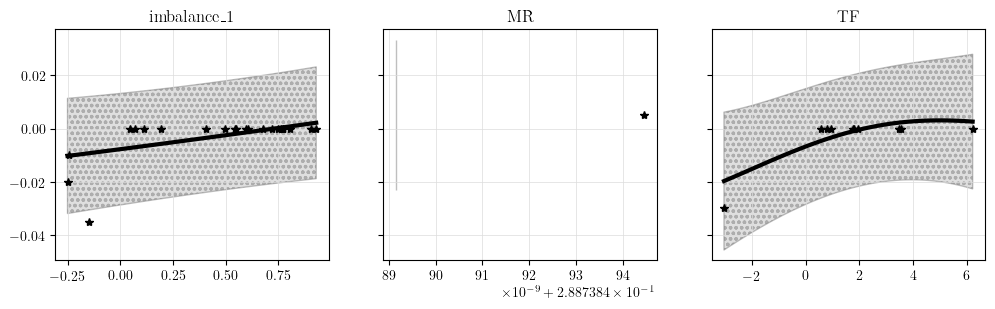

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


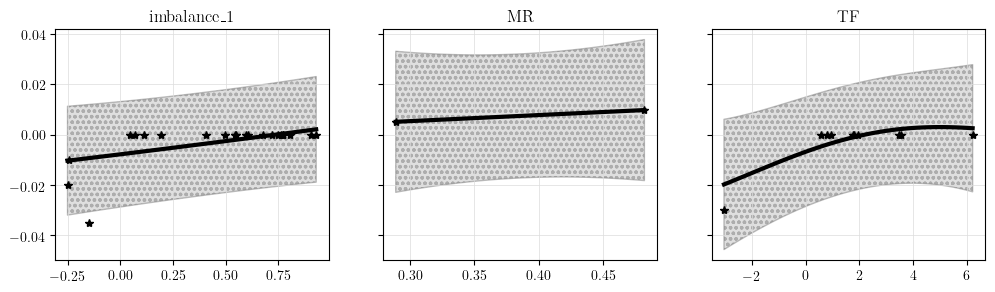

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


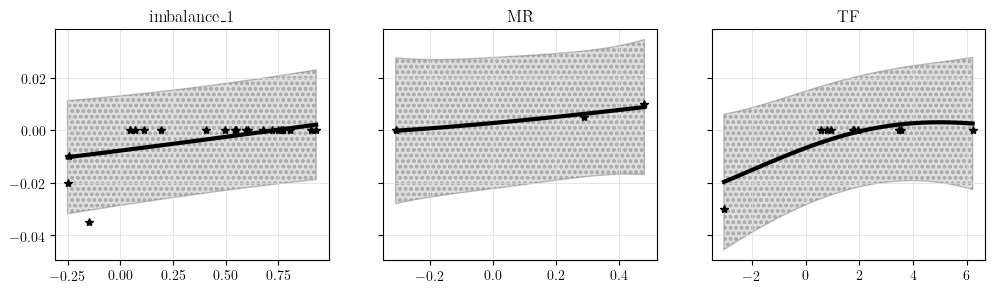

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


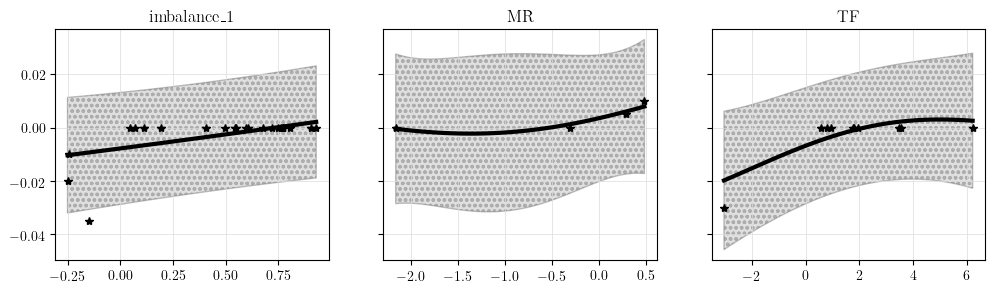

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


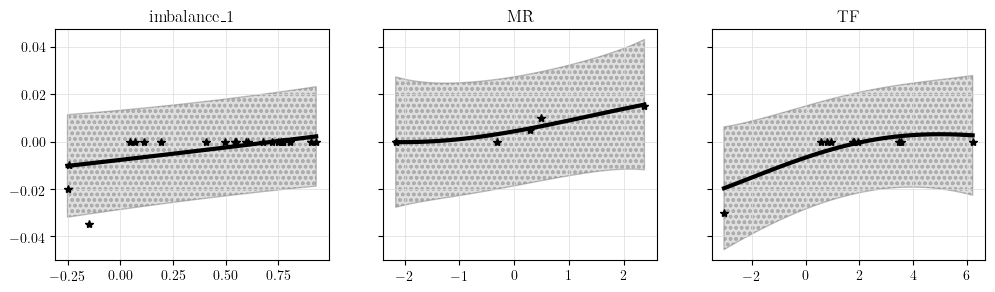

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


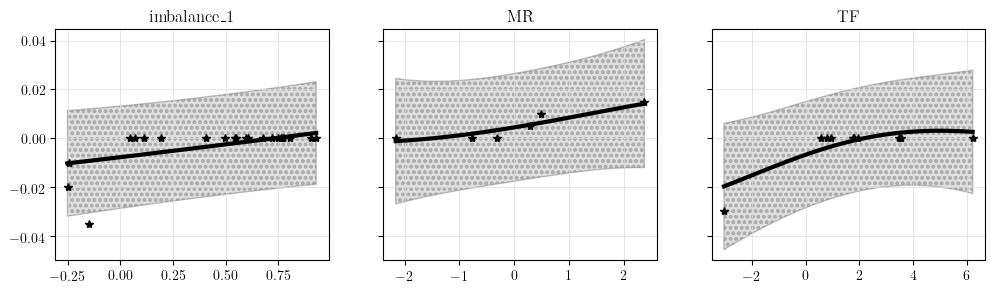

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


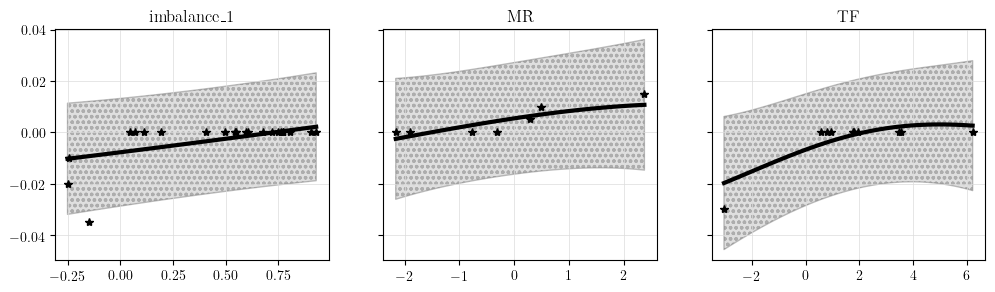

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


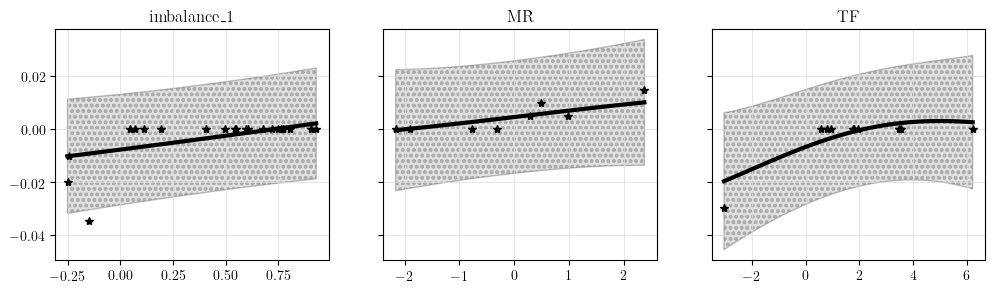

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


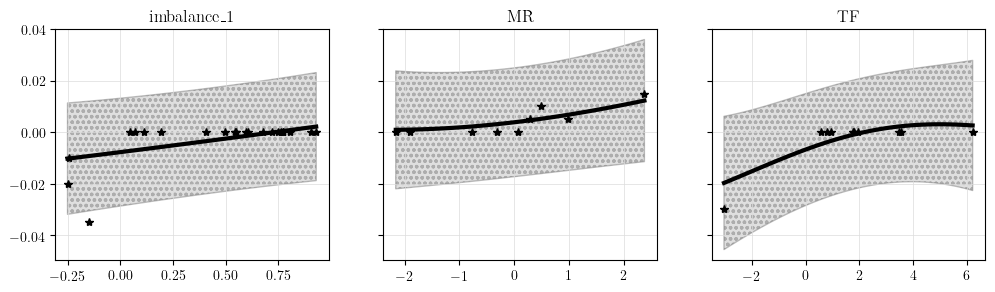

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


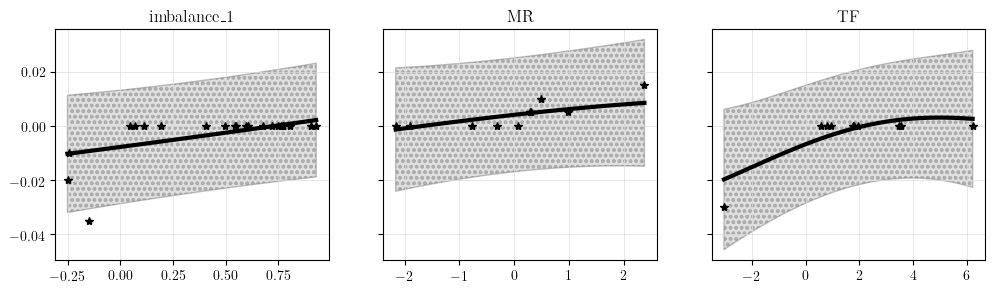

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


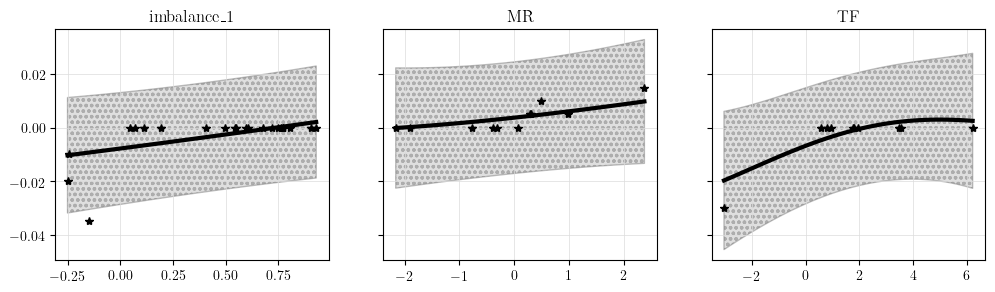

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


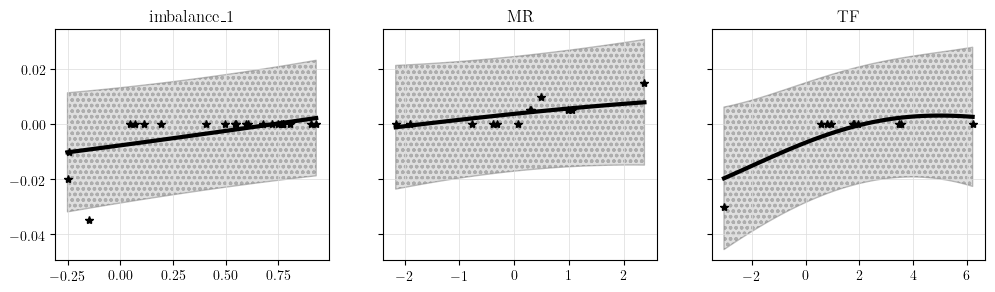

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


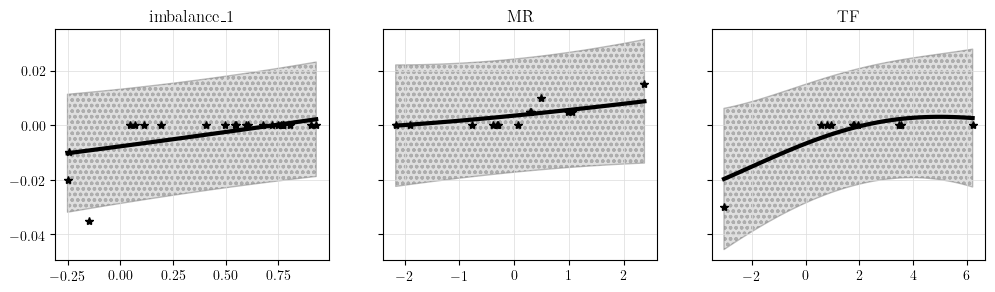

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


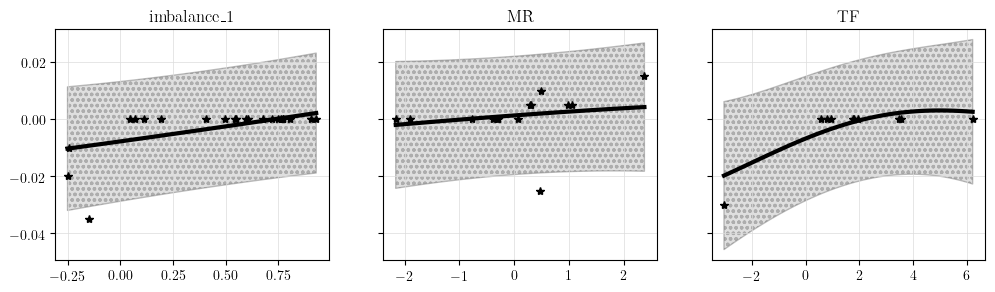

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


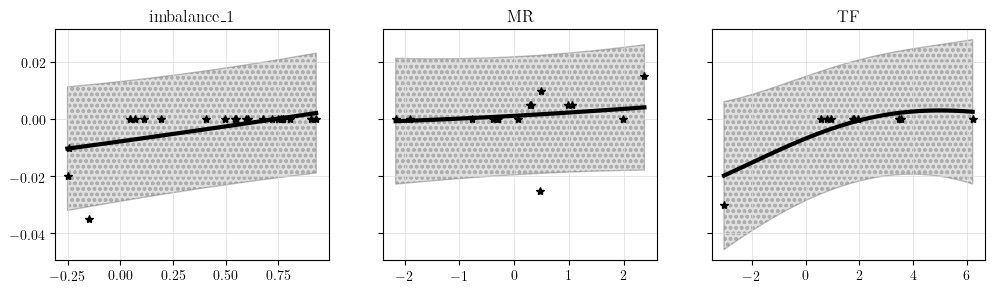

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


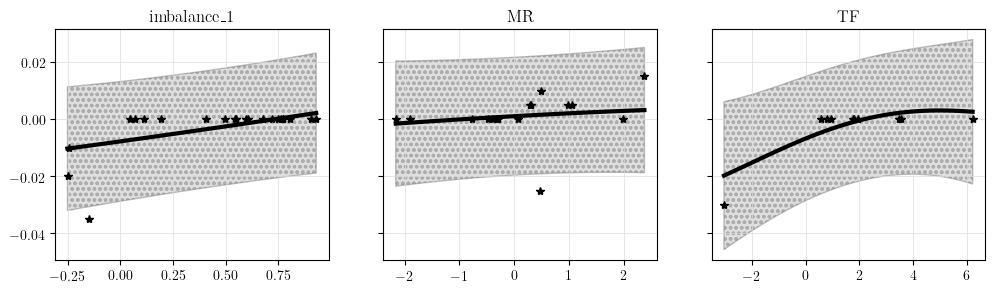

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.0173  Threshold: 0.002
Average performance GP1: tensor(-0.0019, dtype=torch.float64)
Average performance GP2: tensor(0.0043, dtype=torch.float64)


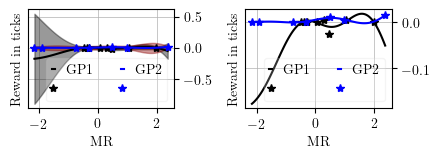

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


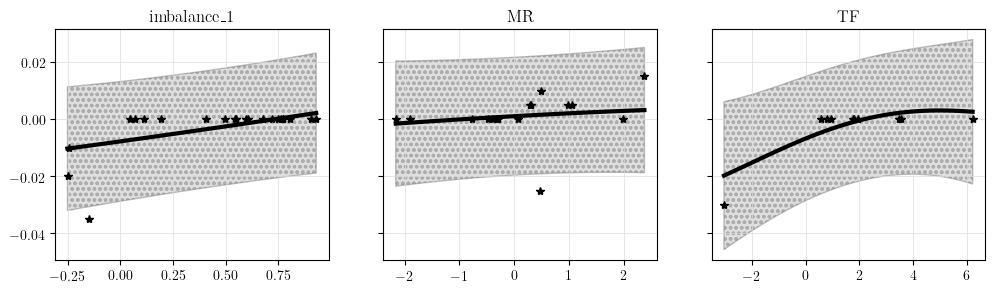

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


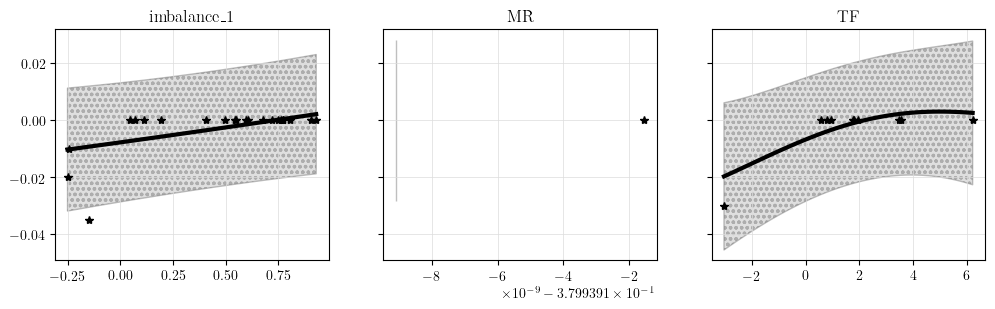

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


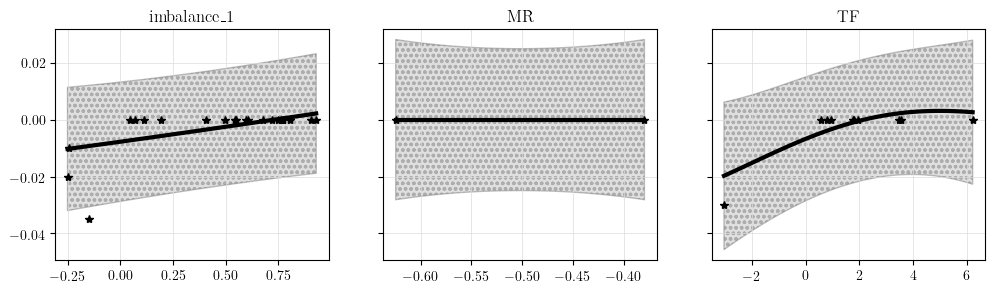

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


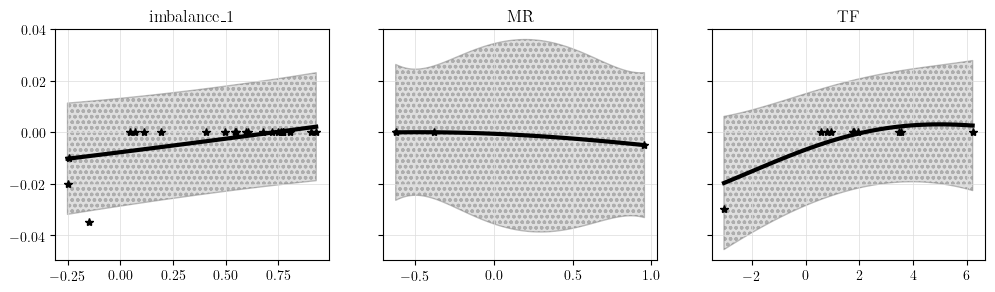

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


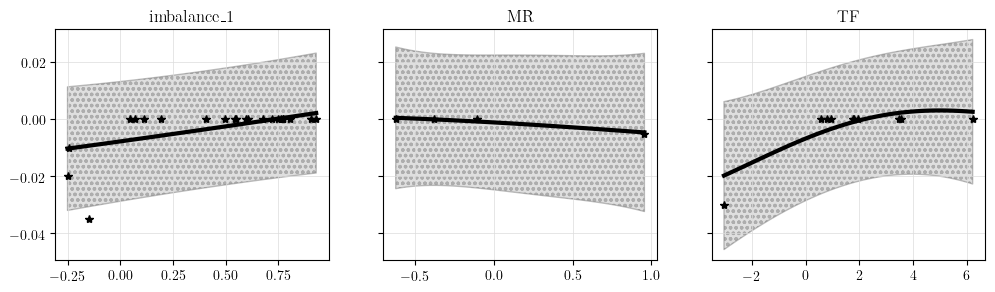

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


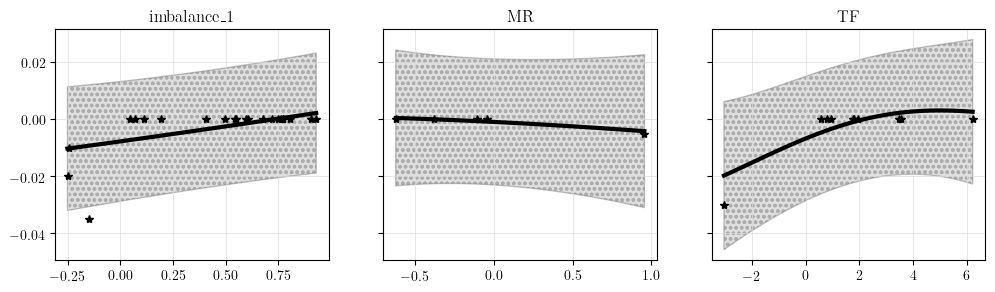

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


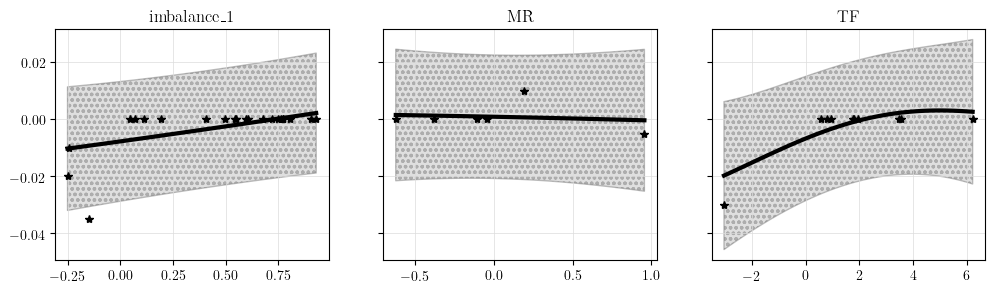

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


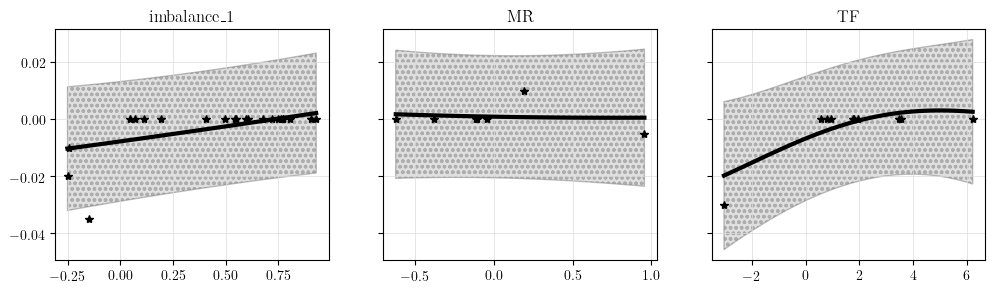

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


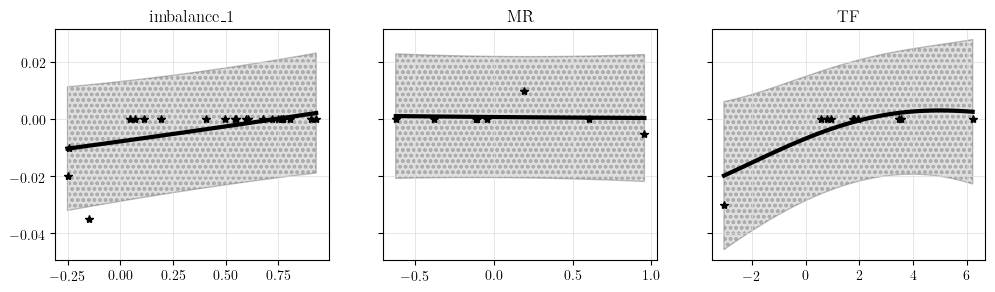

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


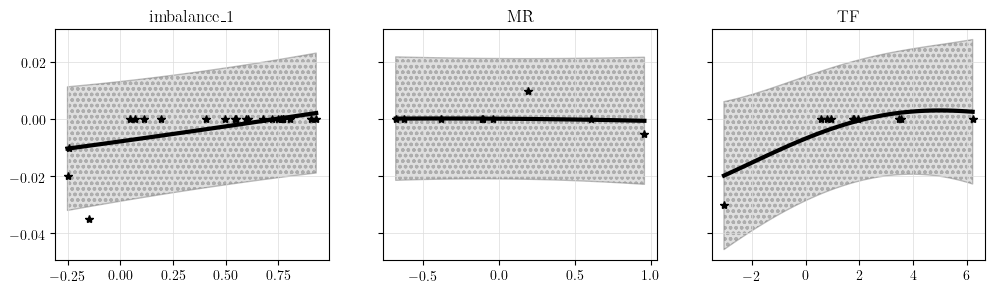

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


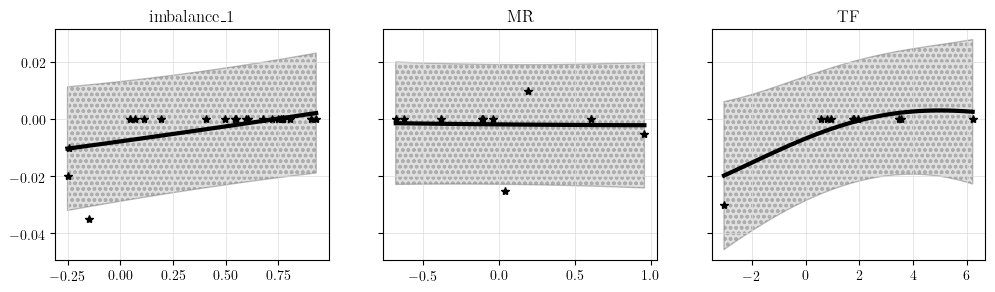

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


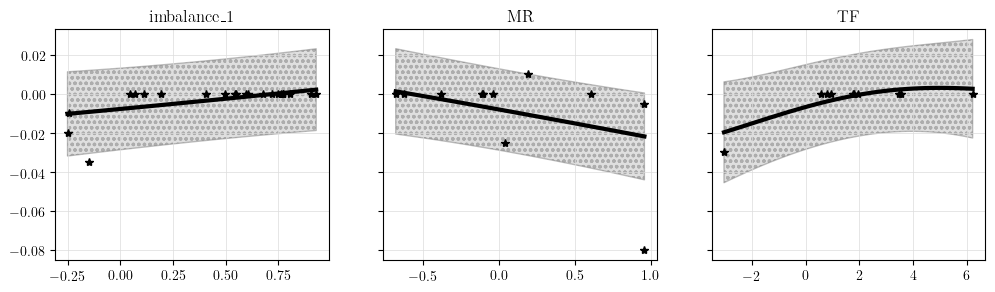

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


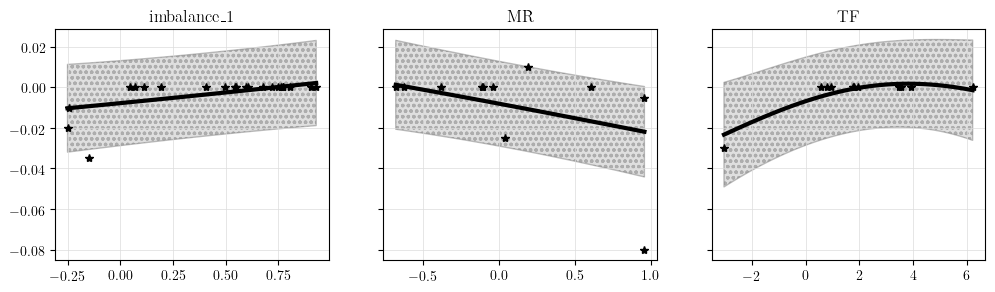

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


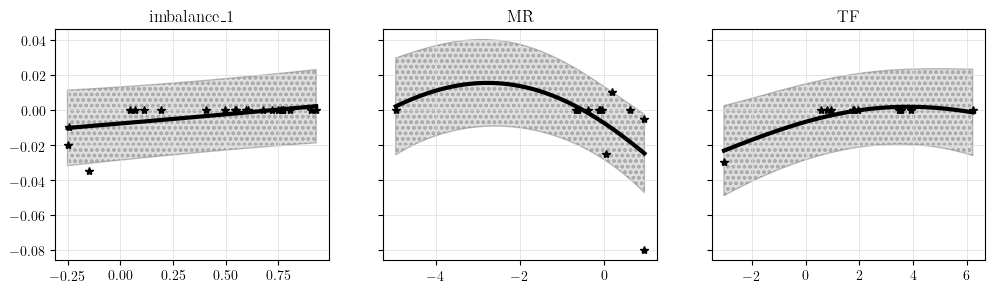

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


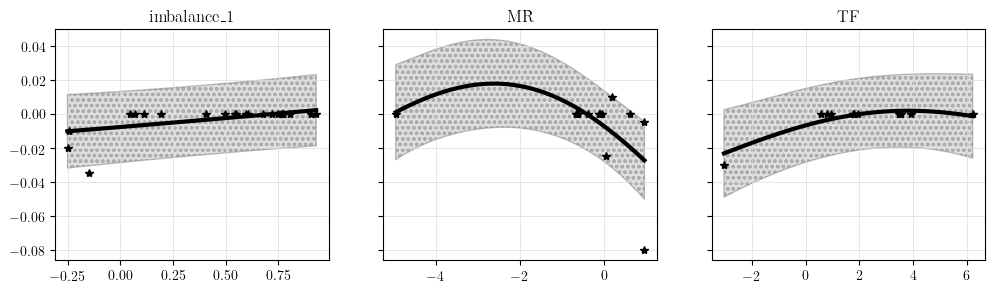

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


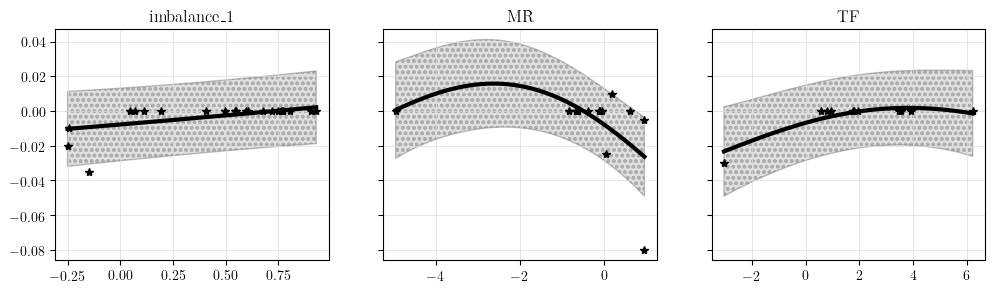

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


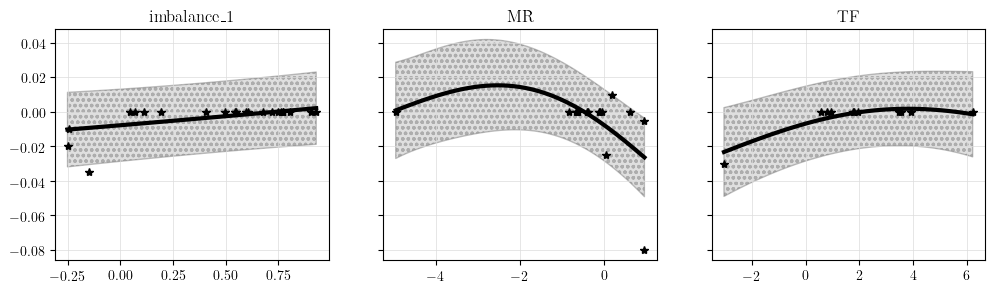

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


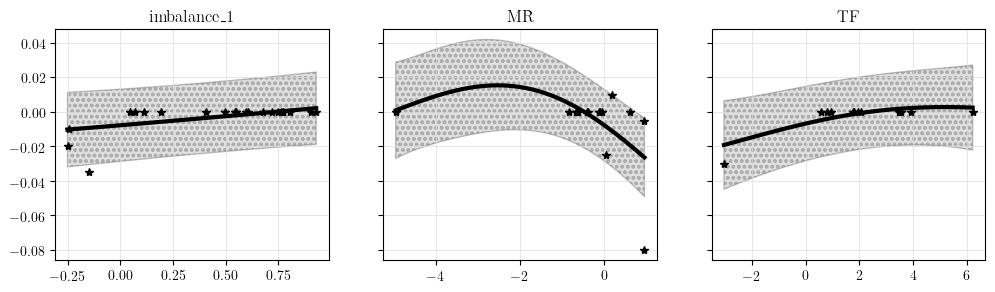

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


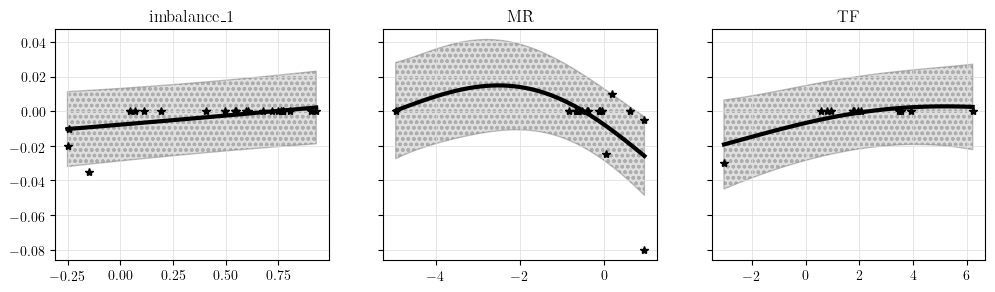

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.03498  Threshold: 0.002
Average performance GP1: tensor(-0.0131, dtype=torch.float64)
Average performance GP2: tensor(0.0007, dtype=torch.float64)


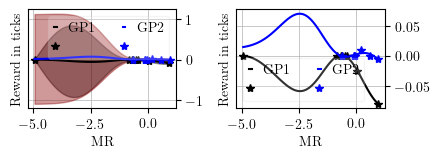

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


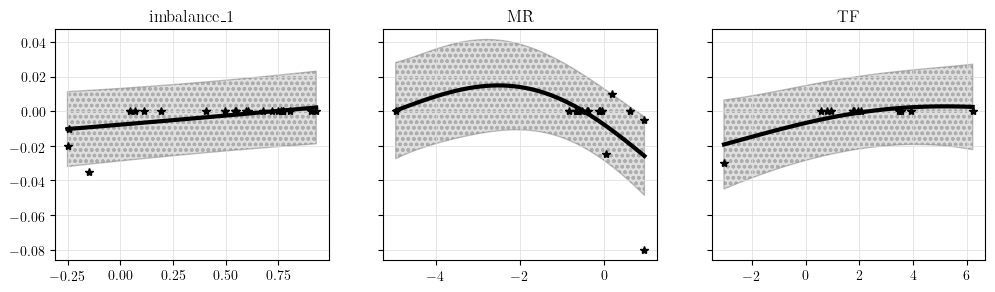

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


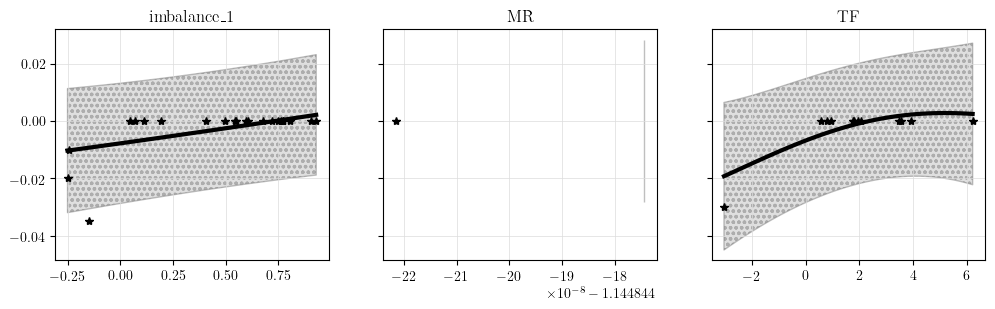

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


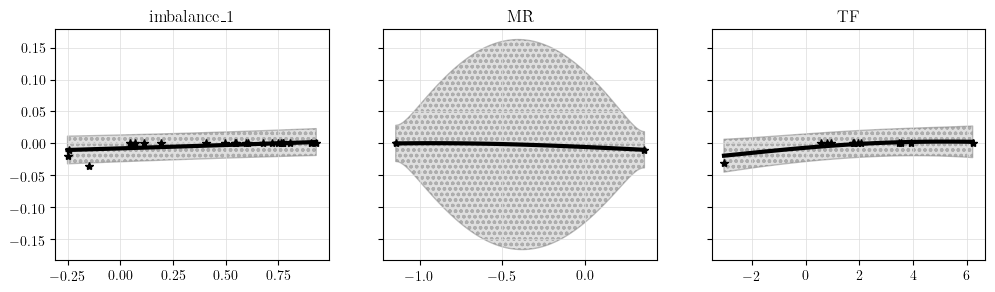

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


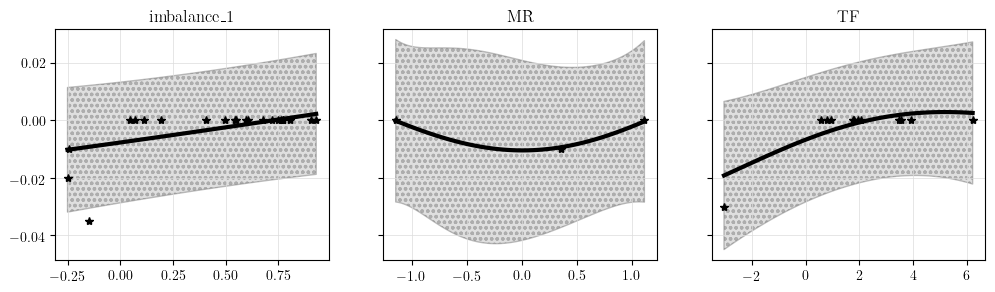

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


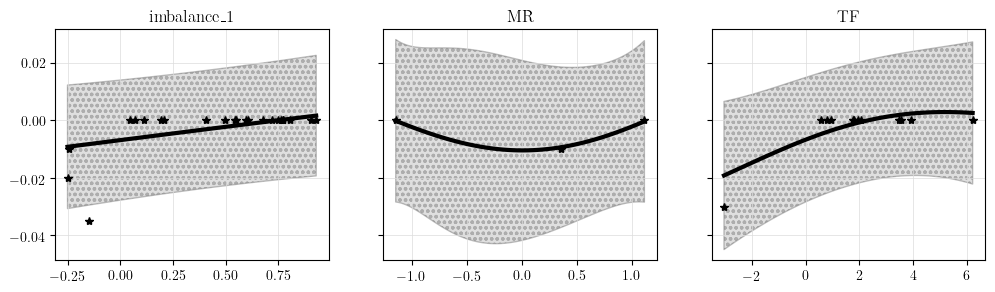

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00021  Threshold: 0.002
Average performance GP1: tensor(-0.0069, dtype=torch.float64)
Average performance GP2: tensor(0., dtype=torch.float64)


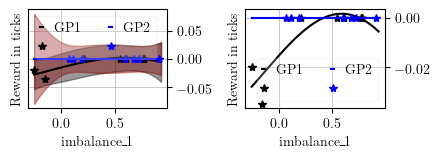

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


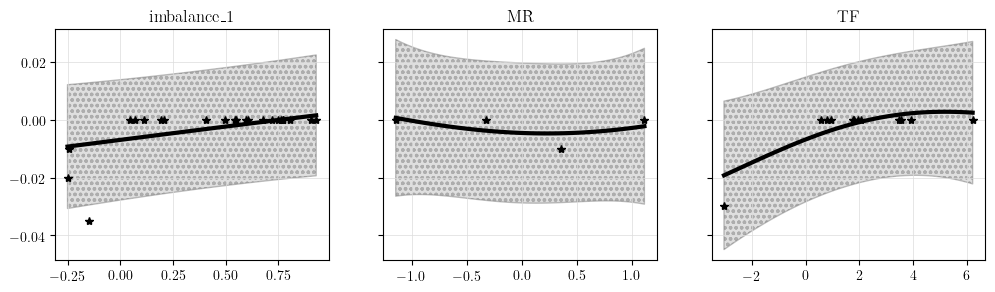

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


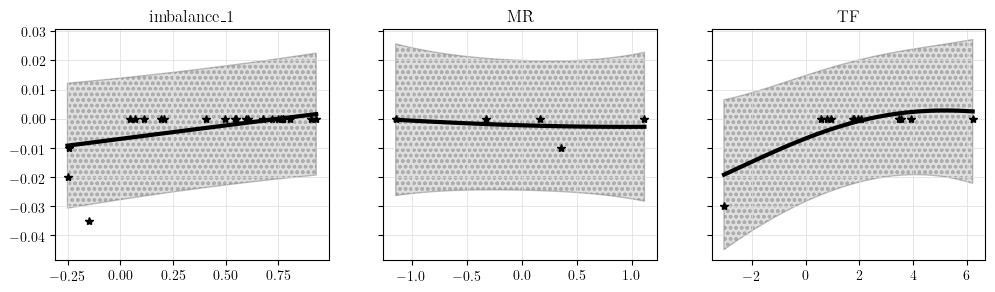

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


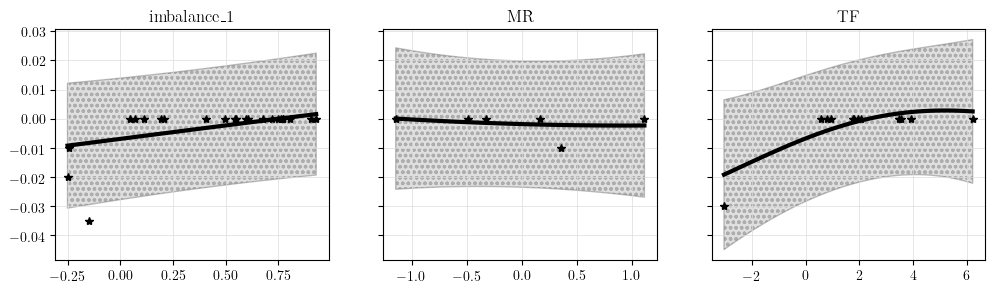

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


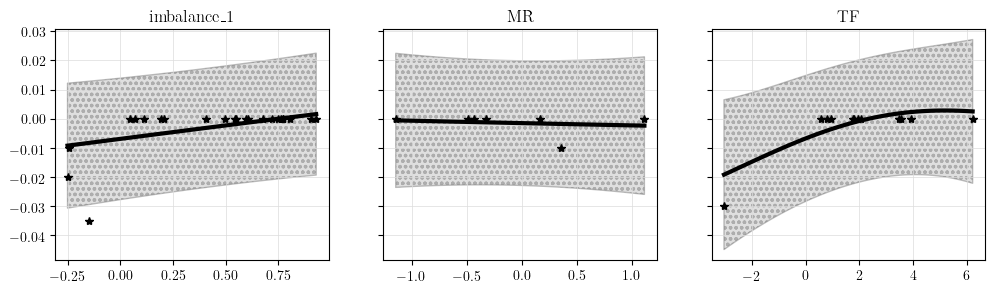

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


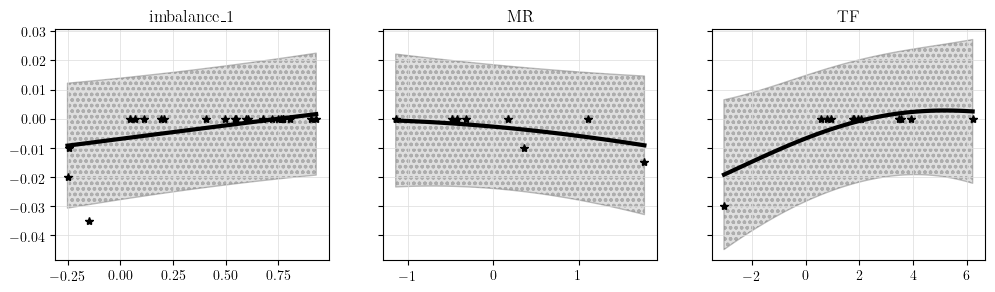

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


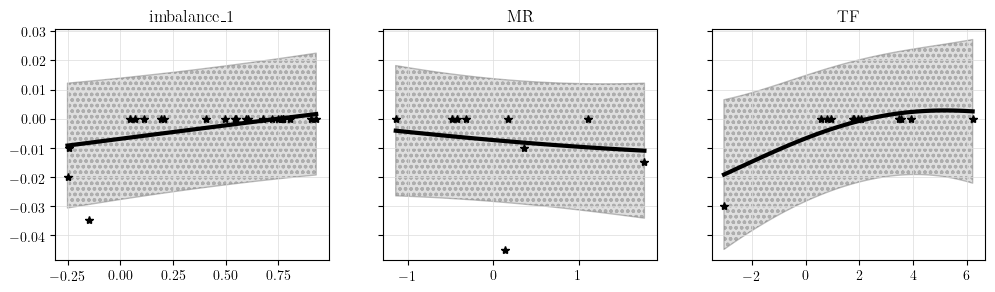

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


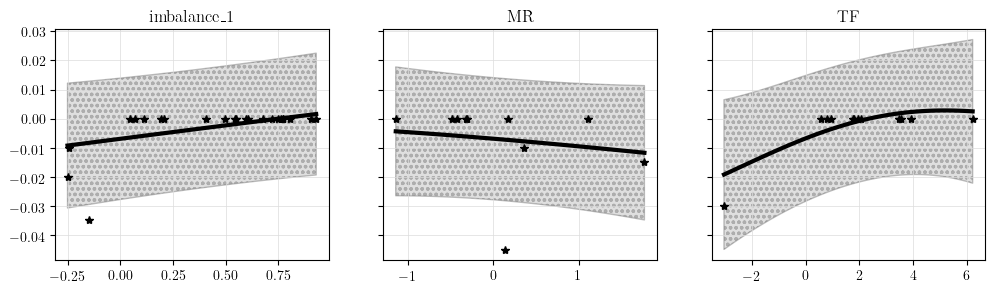

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


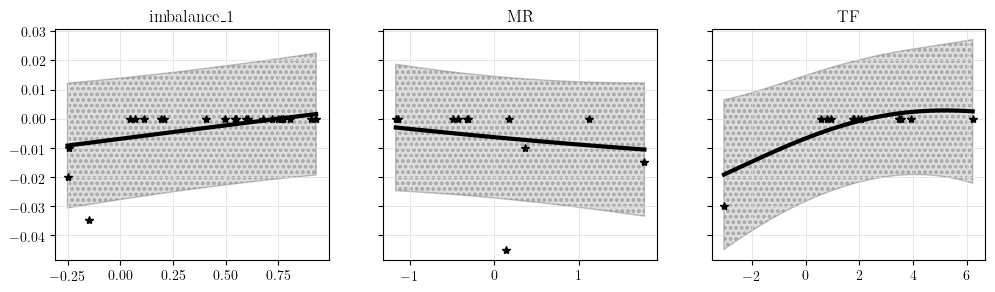

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


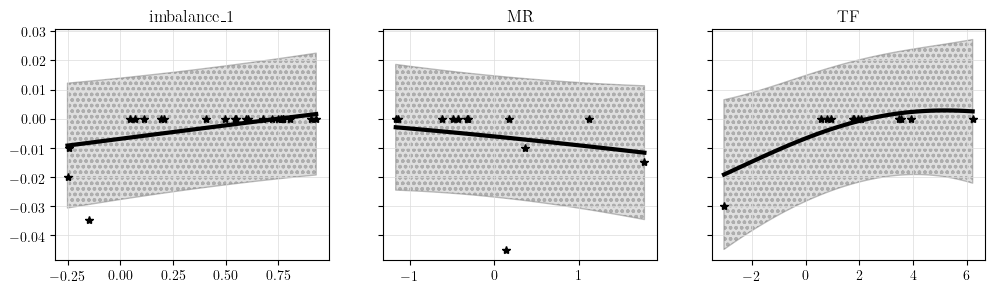

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


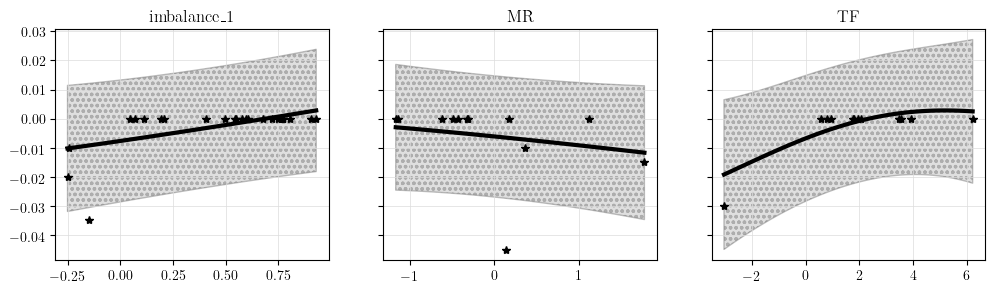

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.00012  Threshold: 0.002
Average performance GP1: tensor(-0.0025, dtype=torch.float64)
Average performance GP2: tensor(-0.0050, dtype=torch.float64)


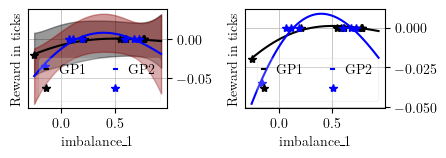

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


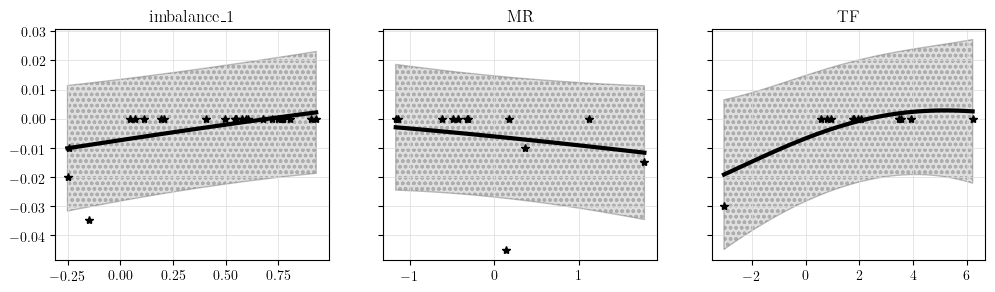

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.0004  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(-0.0079, dtype=torch.float64)


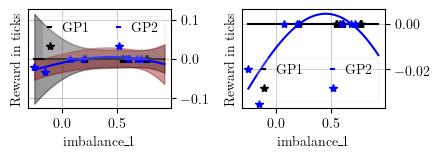

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: MR

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


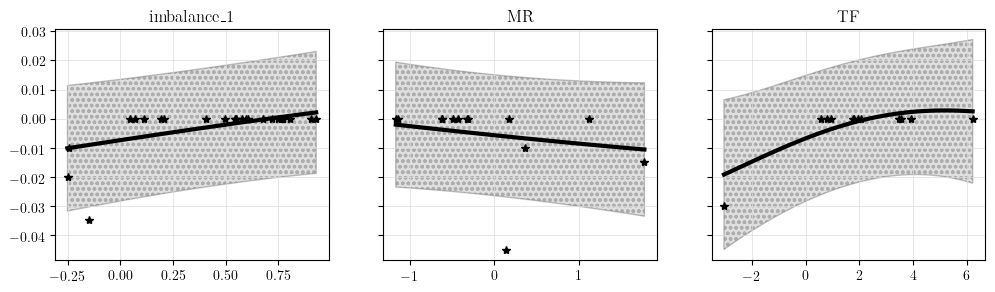

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: imbalance_1
I am deleting the change point results of  imbalance_1
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


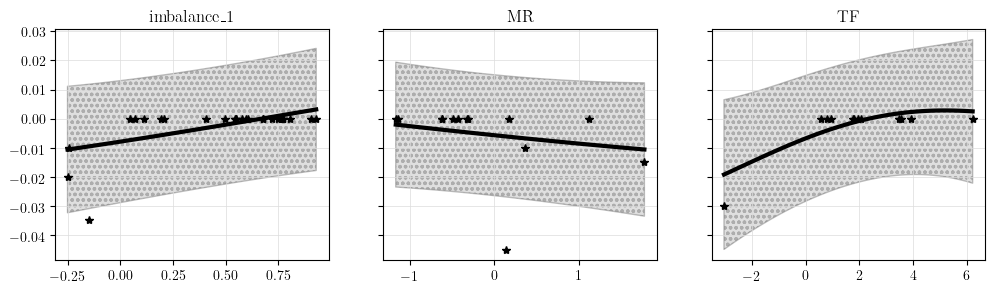

Computing UCB Waserstein for strategy: imbalance_1
** performing change point test for strategy : imbalance_1 **
Distance:  0.0004  Threshold: 0.002
Average performance GP1: tensor(0., dtype=torch.float64)
Average performance GP2: tensor(-0.0079, dtype=torch.float64)


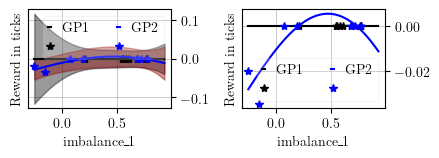

I am storing the change point test results for  imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


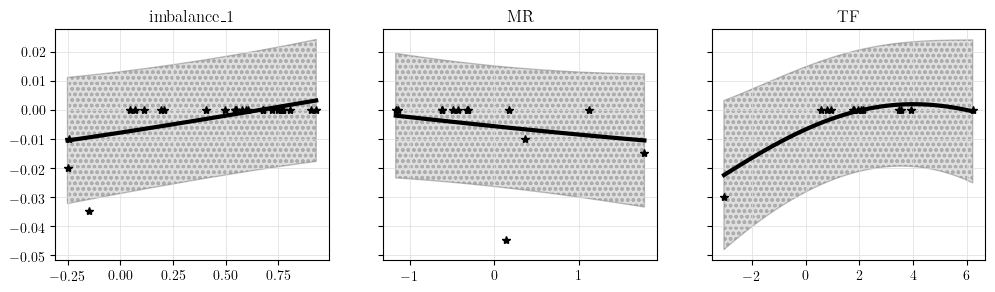

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: TF

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


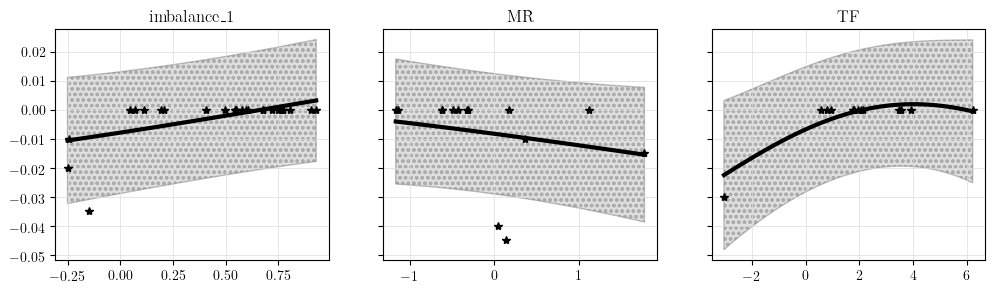

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: TF
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


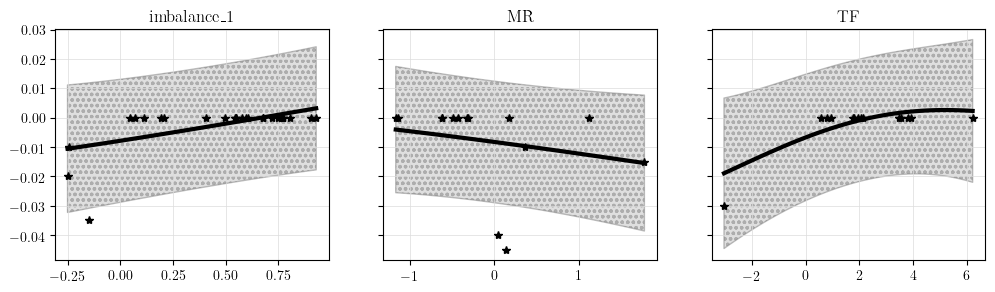

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


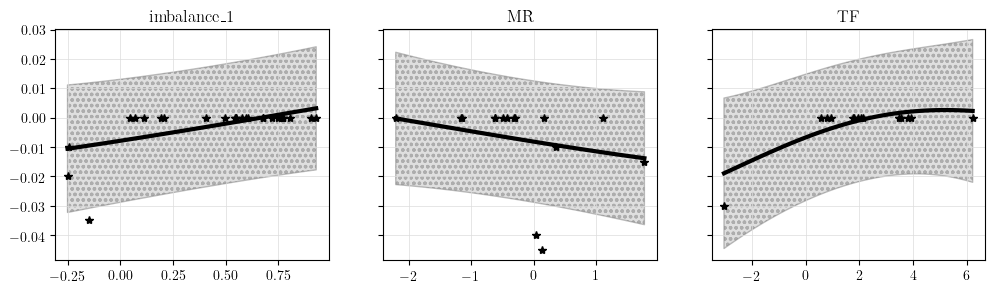

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


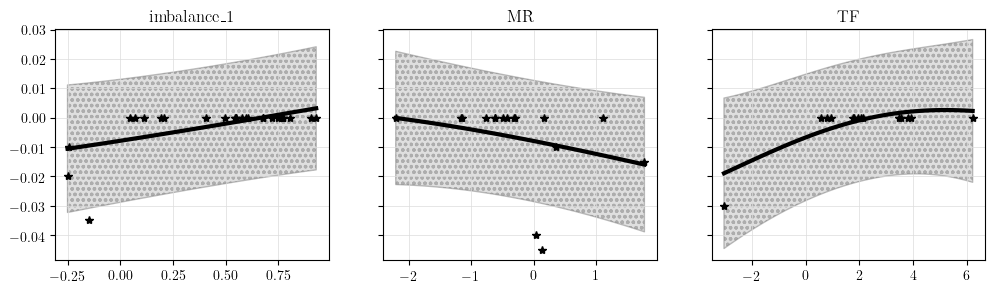

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
** performing change point test for strategy : MR **
Distance:  0.04417  Threshold: 0.002
Average performance GP1: tensor(-0.0106, dtype=torch.float64)
Average performance GP2: tensor(-0.0036, dtype=torch.float64)


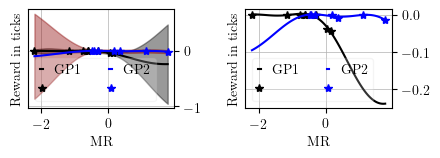

I am storing the change point test results for  MR
REGIME CHANGE! Plotting the GPs of strategies for the bandit:  UCB_WAS


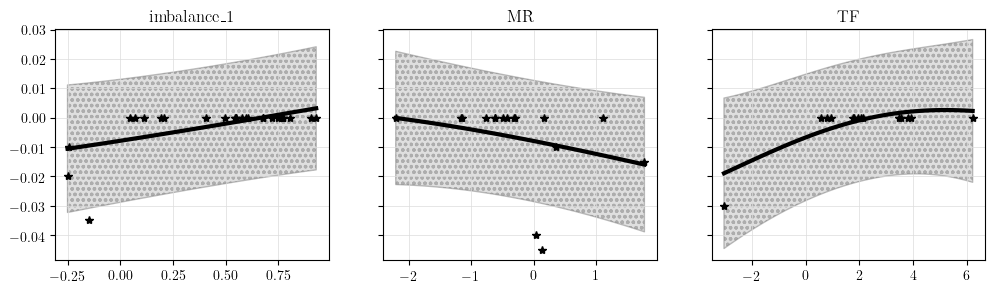

Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


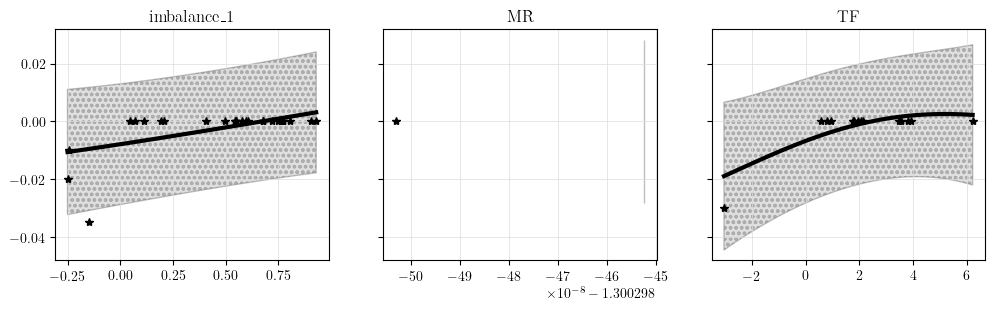

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


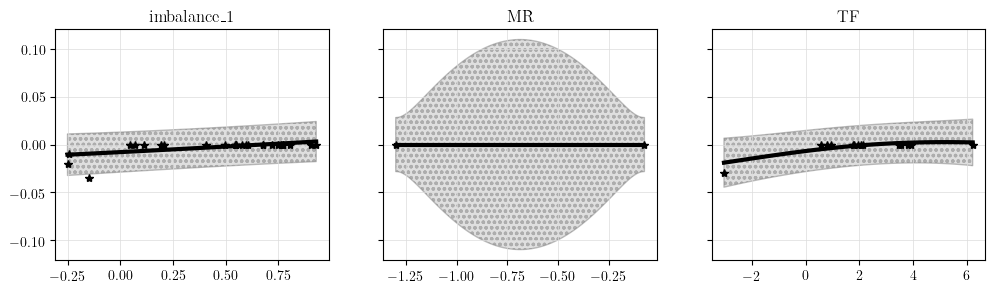

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


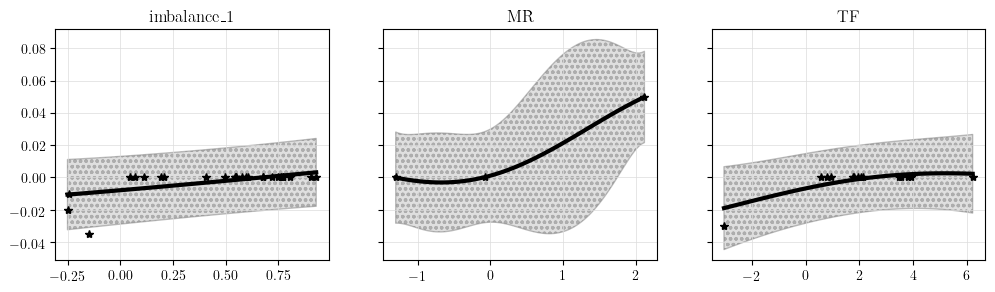

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1

 ** Bandit UCB_WAS: Selecting strategies ...
Plotting the GPs of strategies for the bandit:  UCB_WAS


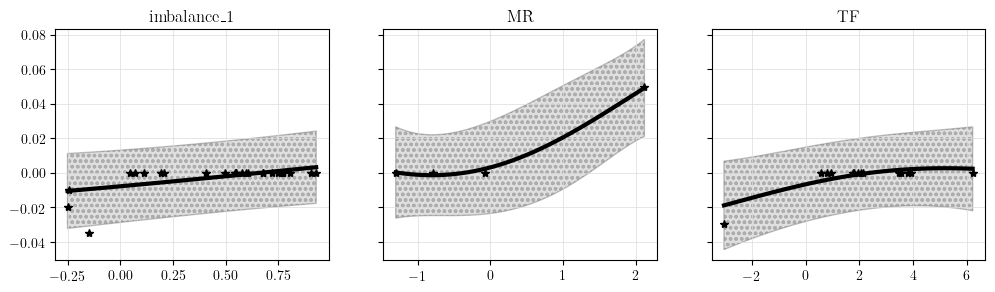

Computing UCB Waserstein for strategy: imbalance_1
Computing UCB Waserstein for strategy: MR
Computing UCB Waserstein for strategy: TF
Selected strategy: MR
Oracle strategy: imbalance_1


In [17]:
verbose_print(verbose_level, None, f'I received an order at {None} with quantity {buysell}', True)

q0     = 100*buysell
q      = np.zeros(len(batch_times)+1)
q[0]   = q0
dt     = T/len(batch_times)
bandit_k  = 'UCB_WAS'

rescale_plot(W=4.5, l=8, w=3)

for (i_time, batch_time) in enumerate(batch_times): # leave a few minutes
    sigma       = 5
    q_cible     = q_star(T * i_time/len(batch_times), q0, T, 10**-3, sigma, V, nu, dt)
    trade_size  = int(q_cible - q[i_time])     
    q[i_time+1] = q[i_time]+trade_size
    V           = 15000000 #TransactionTape.set_index('time').traded_quantity.rolling('1h').sum().mean()
    nb_orders   += 1

    trade_date = str(batch_time).split(' ')[0]
    
    ###############################################
    # retrain GPs hyperparameters every N orders 
    ###############################################
    retrain_hyperparameters = True

    ##################################################
    # if an order arrives: decide if buy & sell
    ##################################################
    i_order          += 1

    ######################
    # get feature values
    ######################
    feature_values = features.loc[batch_time, :]

    ######################################
    # select the strategy for all bandits
    ######################################

    best_strategies_bandits = {}
    #for bandit_k in bandits.keys():
    verbose_print(verbose_level, batch_time, f'\n ** Bandit {bandit_k}: Selecting strategies ...')
    if i_time < 5*len(strategies): # at least 5 rewards before sampling
        best_strategies_bandits[bandit_k]  = random.choice(list(strategies.keys()))
    else:
        best_strategies_bandits[bandit_k]  = o_bandit.select_best_strategy(feature_values)
    verbose_print(verbose_level, batch_time, f'Selected strategy: {best_strategies_bandits[bandit_k]}')
    
    ######################################
    # Update & Retrain the GPs
    # & Non stationarity test
    ######################################
    tmp_pnls = {bandit_k:np.nan}
    
    #for bandit_k in bandits.keys():
    if buysell == 1:
        tmp_pnls[bandit_k] = -programme_data.loc[batch_time, f'buyPrice_{best_strategies_bandits[bandit_k]}'] + \
                    programme_data.loc[batch_time, ref_price]
    else:
        tmp_pnls[bandit_k] = programme_data.loc[batch_time, f'sellPrice_{best_strategies_bandits[bandit_k]}'] - \
                    programme_data.loc[batch_time, ref_price]

    #for bandit_k in bandits.keys():
        #print('Adding bandit : ', bandit_k, 'values are:', feature_values.MR, best_strategies_bandits[bandit_k], tmp_pnls[bandit_k])
    try:
        o_bandit.update_data(features  = feature_values, 
                              strat     = best_strategies_bandits[bandit_k], 
                              reward    = tmp_pnls[bandit_k],
                              retrain_hyperparameters = retrain_hyperparameters)
    except Exception as e:
        retrain_hyperparameters = True
        print('Error while updating the bandit ', bandit_k ,': ', str(e), '\n', tmp_pnls[bandit_k])
        o_bandit.update_data(features  = feature_values, 
                                      strat     = best_strategies_bandits[bandit_k], 
                                      reward    = tmp_pnls[bandit_k],
                                      retrain_hyperparameters = False)
            #bandits[bandit_k].strat_gp_dict[best_strategies_bandits[bandit_k]].train()

    ######################################
    # Record rewards
    ######################################
    #for bandit_k in bandits.keys():
    if buysell == 1:
        bandits_fin_info[bandit_k].loc[batch_time,'execPrice']  = \
                        programme_data.loc[batch_time, f'buyPrice_{best_strategies_bandits[bandit_k]}'] 
    else:
        bandits_fin_info[bandit_k].loc[batch_time,'execPrice']  = \
                        programme_data.loc[batch_time, f'sellPrice_{best_strategies_bandits[bandit_k]}'] 
    
    bandit_rewards.loc[batch_time, bandit_k]               = tmp_pnls[bandit_k]
    bandits_fin_info[bandit_k].loc[batch_time,'S0']        = programme_data.loc[batch_time, 'S0'] 
    bandits_fin_info[bandit_k].loc[batch_time,'ST']        = programme_data.loc[batch_time, 'ST'] 
    bandits_fin_info[bandit_k].loc[batch_time,'twapPrice'] = programme_data.loc[batch_time, 'twapPrice'] 

    for strat in strategies.keys():
        if buysell == 1:
            bandit_rewards.loc[batch_time, strat] = \
                        -programme_data.loc[batch_time, f'buyPrice_{strat}'] + \
                        programme_data.loc[batch_time, ref_price]
        else:
            bandit_rewards.loc[batch_time, strat] = \
                        programme_data.loc[batch_time, f'sellPrice_{strat}'] - \
                        programme_data.loc[batch_time, ref_price]


    ##############################
    # Record oracle info
    ##############################
    oracle_strategy = bandit_rewards.loc[batch_time, strategies.keys()].idxmax() #(pnls_buy.loc[batch_time]).idxmax()
    bandit_rewards.loc[batch_time, 'oracle'] = bandit_rewards.loc[batch_time, f'{oracle_strategy}']
    verbose_print(verbose_level, batch_time, f"Oracle strategy: {oracle_strategy}")

# multiply pnls by trading speed
v = np.diff(q)
for i in range(len(bandit_rewards)):
    bandit_rewards.iloc[i,:] = np.abs(v[i]) * bandit_rewards.iloc[i,:]
    # regret_plots(strategies, rewards_to_plot.dropna(), programme_data,  bandits, W=5.5, figure_name = None)

,count,mean,std,min,25%,50%,75%,max
0,249.0,0.004565,0.01778,0.000025,0.000084,0.000132,0.000366,0.139742


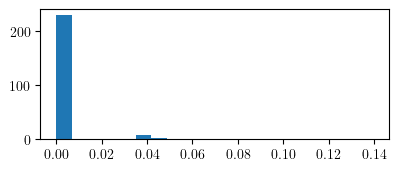

In [18]:
all_dists = []
for strat_name in o_bandit.records['was_distances'].keys(): all_dists += o_bandit.records['was_distances'][strat_name]
_=plt.hist(all_dists,bins=20)
pd.DataFrame(all_dists).describe().T

In [19]:
rewards_to_plot

NameError: name 'rewards_to_plot' is not defined

In [ ]:
res_simulations = buysell, bandit_rewards, bandits_fin_info, q

# prepare the plot
rescale_plot(8, 10, 3)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, constrained_layout=True)

# plot programme prices
ax1.plot(programme_data.index, programme_data.mid_price, color='k', lw=2)

# get regrets & rewards
rewards_to_plot = pd.DataFrame(index=programme_data.index)

rewards_to_plot[bandit_k] = np.array(bandit_rewards[bandit_k])

for (i_strat, strat) in enumerate(strategies.keys()):
    rewards_to_plot[strat]    = np.array(bandit_rewards[strat])
    
rewards_to_plot = rewards_to_plot.sort_index()
ax2.plot(rewards_to_plot.index, rewards_to_plot.dropna().cumsum(), lw=2)
ax2.legend(list(rewards_to_plot.columns), 
       loc='best', fancybox=True, framealpha=0.1, handlelength=0.1)
df_sim_results = res_simulations[1].dropna().cumsum().iloc[-1]  #pd.concat( (for i in res_simulations.keys()), axis=1).T
stats_sim = df_sim_results.describe().T
stats_sim['sharpe'] = stats_sim['mean']/stats_sim['std']

# Some printing
print( bandit_k, ':', round(10000 * stats_sim.loc['mean']/bandits_fin_info[bandit_k].execPrice.mean(), 2), "bps" )
ax3.plot(res_simulations[1].dropna().index, q[1:], color='k', lw=2) #np.linspace(len(res_simulations[i_simul][1].dropna()), 0, len(res_simulations[i_simul][1].dropna()))
for ax in (ax1, ax2, ax3): ax.grid(axis='both'); ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha='right')
plt.show()

In [ ]:
rewards_to_plot.dropna()

In [ ]:
# was distance distribution
alldistances = []
for k in o_bandit.records['was_distances'].keys(): alldistances += o_bandit.records['was_distances'][k]
display(pd.DataFrame(alldistances).describe())
plt.hist(alldistances, bins=100)
plt.grid('both')
plt.xlim(None,0.1)
plt.show()

In [ ]:
plt.plot(q[1:50])
plt.grid('both')

In [ ]:
benchs    = ('twapPrice', 'S0', 'ST')

print('\n', '***********', bandit_k, '***********')
n          = len(res_simulations)
for bench in benchs:
    pnl_bandit = 0
    pnl_twap   = 0
    pnl_execS0 = 0
    pnl_execST = 0
    for i in range(n):
        tmp_bandit   = res_simulations[2][bandit_k].dropna()
        pnl_bandit   += res_simulations[0] * (-tmp_bandit.execPrice.mean() + tmp_bandit[bench].mean())
        #tmp_bandit.execPrice.sum() - tmp_bandit[bench].sum()
        # pnl_twap     += tmp_bandit.twapPrice.sum() - len(tmp_bandit)*tmp_bandit.iloc[0][bench]
        # pnl_execS0   += tmp_bandit.S0.sum()        - len(tmp_bandit)*tmp_bandit.iloc[0][bench]
        # pnl_execST   += tmp_bandit.ST.sum()        - len(tmp_bandit)*tmp_bandit.iloc[0][bench]

    print('PNL when bench =', bench, ':', round(pnl_bandit, 3))
# res_simulations[i][1]['TS_WAS'].dropna().S0.sum()

In [ ]:
# fig, axes = plt.subplots(2, 3, sharey=True)
# for (i_i, bandit_k) in enumerate(bandits.keys()):
#     for (i_j, strat) in enumerate(strategies):
#         axes[i_i, i_j].plot(distances[bandit_k][strat])
#         axes[i_i, i_j].set_title(f'bandit {bandit_k}\n strat {strat}')
#         axes[i_i, i_j].grid(axis='both')
# plt.tight_layout()

# Regret analysis

In [ ]:
# get historical rewards and regret
rewards_to_plot = pd.DataFrame(index=all_data.index)
regrets_to_plot = pd.DataFrame(index=all_data.index)

for bandit_k in bandits.keys():
    regrets_to_plot[bandit_k] = - np.array(bandit_rewards[bandit_k]) + np.array(bandit_rewards['oracle'])
for (i_strat, strat) in enumerate(strategies.keys()):
    regrets_to_plot[strat]    = - np.array(bandit_rewards[strat]) + np.array(bandit_rewards['oracle'])

for bandit_k in bandits.keys():
    rewards_to_plot[bandit_k] = np.array(bandit_rewards[bandit_k])
for (i_strat, strat) in enumerate(strategies.keys()):
    rewards_to_plot[strat]    = np.array(bandit_rewards[strat])

regrets_to_plot = regrets_to_plot.sort_index()
rewards_to_plot = rewards_to_plot.sort_index()

### Hit ratio

In [ ]:
# (bandit_rewards.dropna()['UCB']==bandit_rewards.dropna()['oracle']).sum()/len(bandit_rewards.dropna())

In [ ]:
hit_ratio_analysis(rewards_to_plot, bandit_rewards['oracle'], bandits, _W = 5.5)

### Reward distributions

In [ ]:
for (clr, bandit_k) in zip(('k', 'tan', 'blue'), bandits.keys()):
    rewards_to_plot[bandit_k].hist(bins=30,  color=clr, alpha=0.4, density=True)

plt.legend(bandits.keys())

### Reward distributions in time

In [ ]:
period_est  = 20 # in number of rewards, can be "10min"
bandit_name = 'TS_WAS'

reward_distribution_analysis(bandit_name, bandits, period_est, all_data, rewards_to_plot.dropna(), bandit_rewards.dropna(),
                              strategies, W = 7, figure_name = None)

### Regret plots

In [ ]:
regret_plots(strategies, regrets_to_plot.dropna(), all_data,  bandits, W=5.5, figure_name = None)

In [ ]:
regret_plots(strategies, rewards_to_plot.dropna(), all_data,  bandits, W=5.5, figure_name = None)

### GP plot

In [ ]:
bandit_name  = 'TS_WAS'
bandits[bandit_name].plot_strategies()

In [ ]:
bandit_name  = 'UCB_WAS'
bandits[bandit_name].plot_strategies()

In [ ]:
rewards_to_plot